In [1]:
import os

os.chdir("..")

In [ ]:
from datasetsforecast.m3 import M3
from utilsforecast.plotting import plot_series
import pandas as pd
from models.NBeatsStackMoe import NBeatsStackMoe
from models.NBeatsMoeLags import NBeatsMoeLags
from neuralforecast import NeuralForecast
from utils import load_dataset, train_test_split
from models.callbacks.probs_collector import GateValuesCollectorCallback
from neuralforecast.losses.numpy import smape
from neuralforecast.models import NBEATS
from neuralforecast.tsdataset import TimeSeriesDataset
import matplotlib.pyplot as plt
from datasets.load_data.gluonts_dataset import GluontsDataset
from models.hyper import config
import numpy as np

# Load the M3 dataset
# m3 = M3.load(directory='C:\\Users\\ricar\\mixture_of_experts_time_series\\data\\m3\\', group='Monthly')[0]
m1, horizon, n_lags, freq_str, freq_int = GluontsDataset.load_everything("m1_monthly")

m1['y'] = m1['y'].astype(float)

# m4['ds'] = pd.to_datetime(m4['ds']).astype(int)

c:\Users\ricar\mixture_of_experts_time_series\venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
2025-05-27 03:40:02,343	INFO util.py:154 -- Missing packages: ['ipywidgets']. Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.
2025-05-27 03:40:02,519	INFO util.py:154 -- Missing packages: ['ipywidgets']. Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.
c:\Users\ricar\mixture_of_experts_time_series\venv\Lib\site-packages\gluonts\json.py:102: UserWarning: Using `json`-module for json-handling. Consider installing one of `orjson`, `ujson` to speed up serialization and deserialization.
  warnings.warn(
INFO:root:using dataset already processed in path C:\Users\ricar\.gluonts\datasets\tourism_monthly.


In [3]:
horizon = horizon
input_size = n_lags

In [4]:
def calculate_smape(Y_test_df, Y_hat_df, forecast_col):
    """Calculate the sMAPE."""
    y_true = Y_test_df['y'].values
    try:
        y_hat = Y_hat_df[forecast_col].values
    except Exception as exc:
        y_hat = Y_hat_df
   
    n_series = Y_test_df['unique_id'].nunique()
    try:
        y_true = y_true.reshape(n_series, -1)
        y_hat = y_hat.reshape(n_series, -1)
    except Exception as e:
        raise ValueError("Error reshaping arrays") from e

    return smape(y_true, y_hat)

INFO:lightning_fabric.utilities.seed:Seed set to 1
INFO:lightning_fabric.utilities.seed:Seed set to 1
INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name         | Type          | Params | Mode 
-------------------------------------------------------
0 | loss         | MAE           | 0      | train
1 | padder_train | ConstantPad1d | 0      | train
2 | scaler       | TemporalNorm  | 0      | train
3 | blocks       | ModuleList    | 51.3 K | train
4 | gate         | Sequential    | 123    | train
-------------------------------------------------------
49.9 K    Trainable params
1.6 K     Non-trainable params
51.5 K    Total params
0.206     Total estimated mod

Epoch 83:  33%|███▎      | 4/12 [00:00<00:00, 20.12it/s, v_num=273, train_loss_step=1.31e+3, train_loss_epoch=1e+3, valid_loss=2.78e+3]    

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_steps=1000` reached.


Epoch 83:  33%|███▎      | 4/12 [00:00<00:00, 19.82it/s, v_num=273, train_loss_step=1.31e+3, train_loss_epoch=1e+3, valid_loss=2.78e+3]


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
INFO:pytorch_lightning.callbacks.model_summary:
  | Name         | Type          | Params | Mode 
-------------------------------------------------------
0 | loss         | MAE           | 0      | train
1 | padder_train | ConstantPad1d | 0      | train
2 | scaler       | TemporalNorm  | 0      | train
3 | blocks       | ModuleList    | 2.5 M  | train
-------------------------------------------------------
2.5 M     Trainable params
1.6 K     Non-trainable params
2.5 M     Total params
9.853     Total estimated model params size (MB)
31        Modules in train mode
0         Modules in eval mode


Epoch 83:  33%|███▎      | 4/12 [00:00<00:00, 14.12it/s, v_num=274, train_loss_step=1.15e+3, train_loss_epoch=893.0, valid_loss=2.65e+3]   

INFO:pytorch_lightning.utilities.rank_zero:`Trainer.fit` stopped: `max_steps=1000` reached.


Epoch 83:  33%|███▎      | 4/12 [00:00<00:00, 14.02it/s, v_num=274, train_loss_step=1.15e+3, train_loss_epoch=893.0, valid_loss=2.65e+3]


INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 12/12 [00:00<00:00, 125.74it/s]
all_gates_cat shape: torch.Size([366, 3])

mean inputs_cat:  tensor([0.3104, 0.2542, 0.4355], device='cuda:0')

num_experts: tensor([ 1,  2, 82], device='cuda:0')

Best expert counts: tensor([ 76,  16, 274], device='cuda:0')


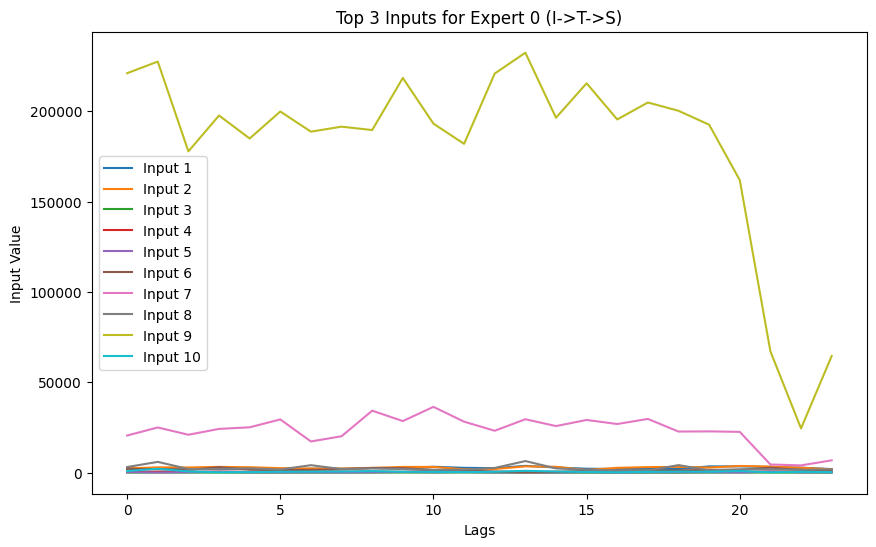

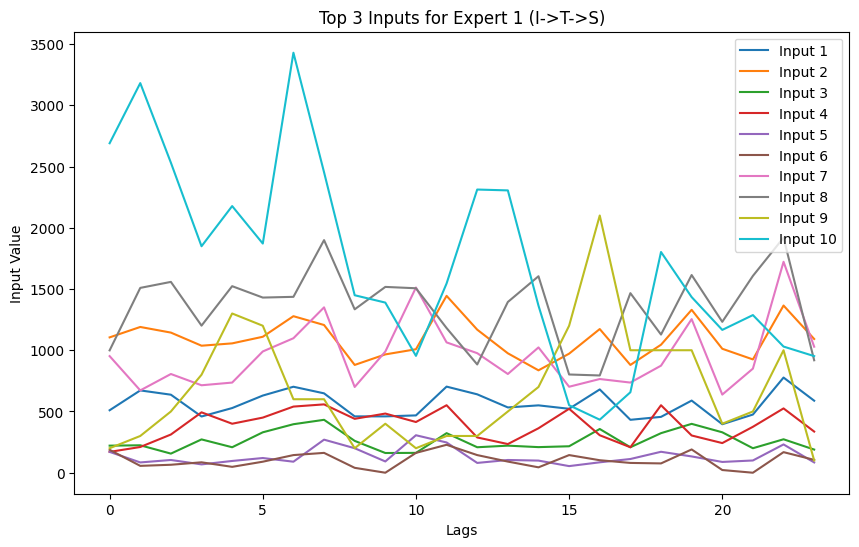

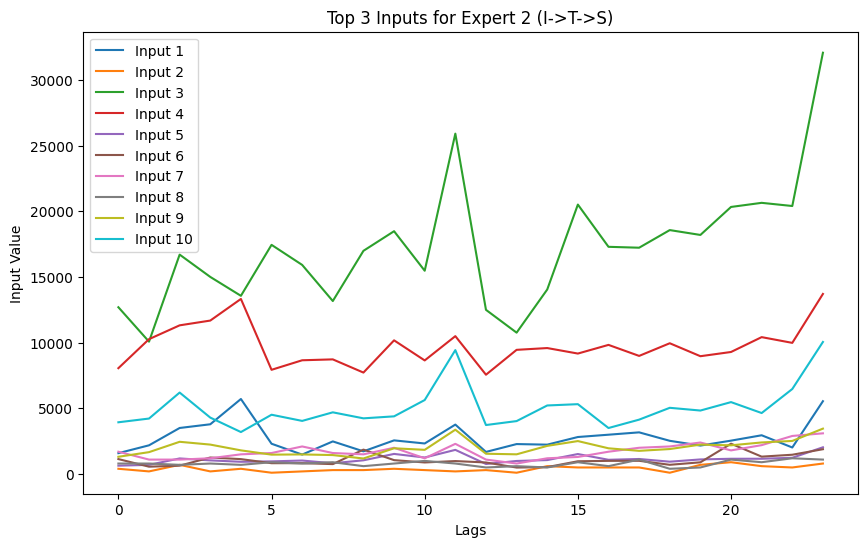

Resetting gate values for next epoch.
Predicting DataLoader 0: 100%|██████████| 12/12 [00:00<00:00, 17.37it/s] 

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Predicting DataLoader 0: 100%|██████████| 12/12 [00:00<00:00, 150.12it/s]
sMAPE for stack: 0.2456715286203004
sMAPE for NBEATS: 0.24402993926027292


In [ ]:
y_train, y_test = train_test_split(m1, horizon)
# config['gluonts']['m1_monthly']['NBeatsStackMoe']['n_blocks'] = [1,1,1]
# config['gluonts']['m1_monthly']['NBEATS']['n_blocks'] = [1,1,1]


prob_collector = GateValuesCollectorCallback(is_stack=True, reset_on_epoch=True)
nf = NeuralForecast(
    models=[
        NBeatsStackMoe( 
            h=horizon,
            input_size=input_size,
            callbacks=prob_collector,
            # **config['gluonts']['m1_monthly']['NBeatsStackMoe'],
        ),
        NBEATS(
            h=horizon,
            input_size=input_size,
            # **config['gluonts']['m1_monthly']['NBEATS'],
        ),
    ], 
    freq='M',
)
nf.fit(df=y_train, static_df=None, val_size=horizon)
predictions = nf.predict(futr_df=y_test)

smape_stack= calculate_smape(y_test, predictions, 'NBeatsStackMoe')
print(f'sMAPE for stack: {smape_stack}')
smape_nbeats= calculate_smape(y_test, predictions, 'NBEATS')
print(f'sMAPE for NBEATS: {smape_nbeats}')

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Predicting DataLoader 0: 100%|██████████| 12/12 [00:00<00:00, 115.47it/s]
all_gates_cat shape: torch.Size([366, 3])

mean inputs_cat:  tensor([0.3104, 0.2542, 0.4355], device='cuda:0')

num_experts: tensor([ 1,  2, 82], device='cuda:0')

Best expert counts: tensor([ 76,  16, 274], device='cuda:0')


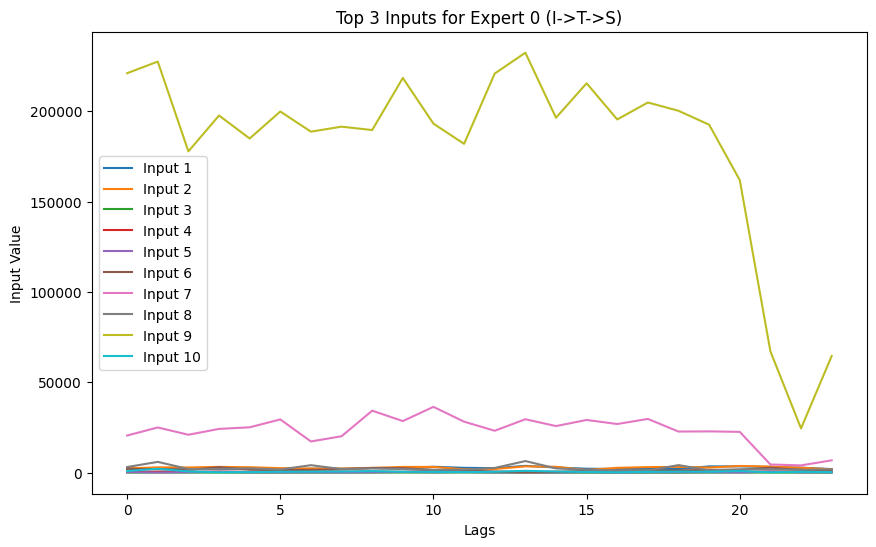

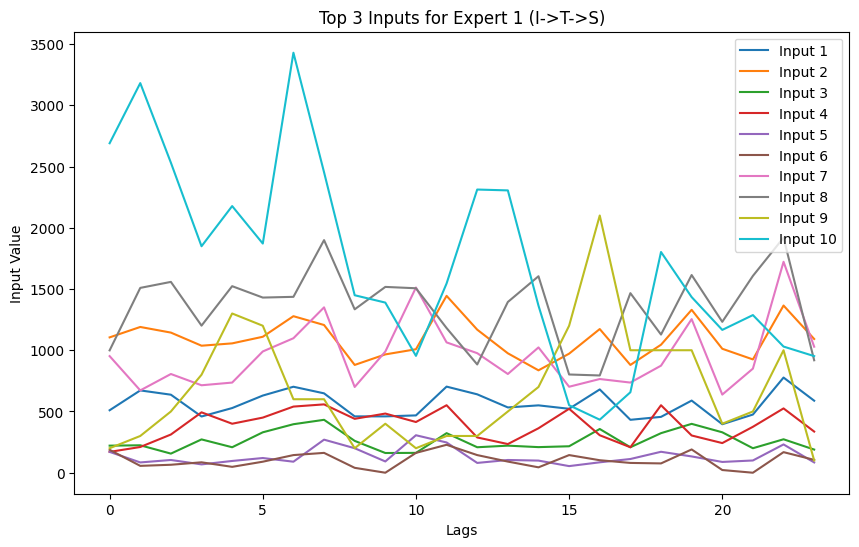

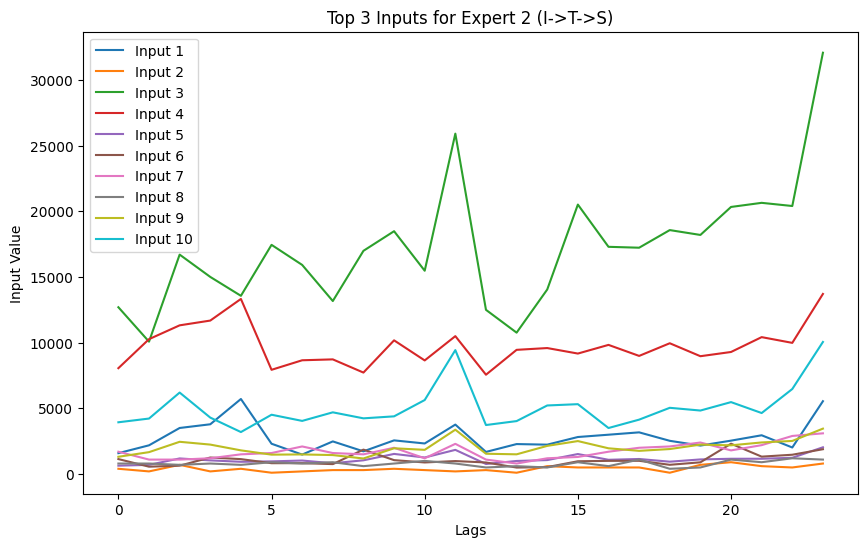

Resetting gate values for next epoch.
Predicting DataLoader 0: 100%|██████████| 12/12 [00:00<00:00, 14.44it/s] 

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]



Predicting DataLoader 0: 100%|██████████| 12/12 [00:00<00:00, 110.05it/s]


In [6]:
y_hats = []

for i, model in enumerate(nf.models):
    dataset, *_ = TimeSeriesDataset.from_df(df = y_train)
    y_hat = model.decompose(dataset=dataset)

    y_hats.append(y_hat)

In [7]:
gate_values = nf.models[0].all_gate_logits
print(len(gate_values))


0


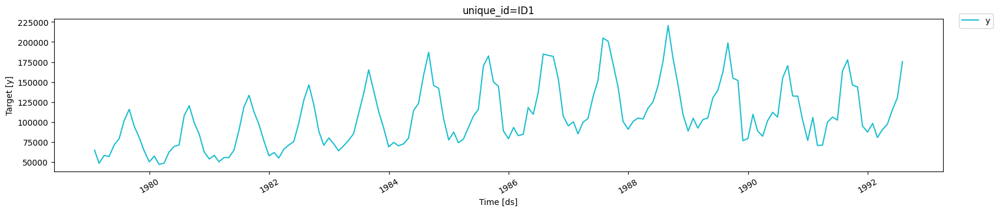

In [8]:
# plot series ID1
plot_series(
    m1, 
    id_col='unique_id', 
    ids=['ID1'],
)

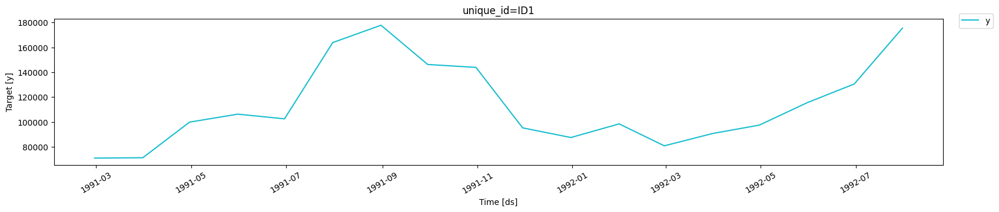

In [9]:
# Plot the last 18 months for series ID1
id1_data = m1[m1['unique_id'] == 'ID1'].copy()
id1_last18 = id1_data.tail(18)

plot_series(
    id1_last18,
    id_col='unique_id',
    ids=['ID1'],
)

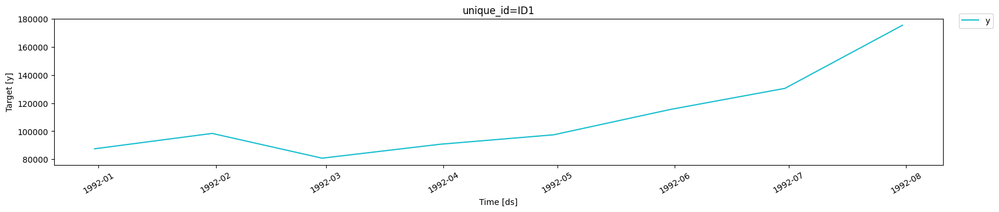

In [10]:
id1_last8 = id1_last18.tail(8)

plot_series(
    id1_last8,
    id_col='unique_id',
    ids=['ID1'],
)

Gate values for ID0: [0.2575894  0.3267541  0.41565654]
sMAPE for MoEStack: 0.086784928584117
sMAPE for NBEATS: 0.0628428937687046


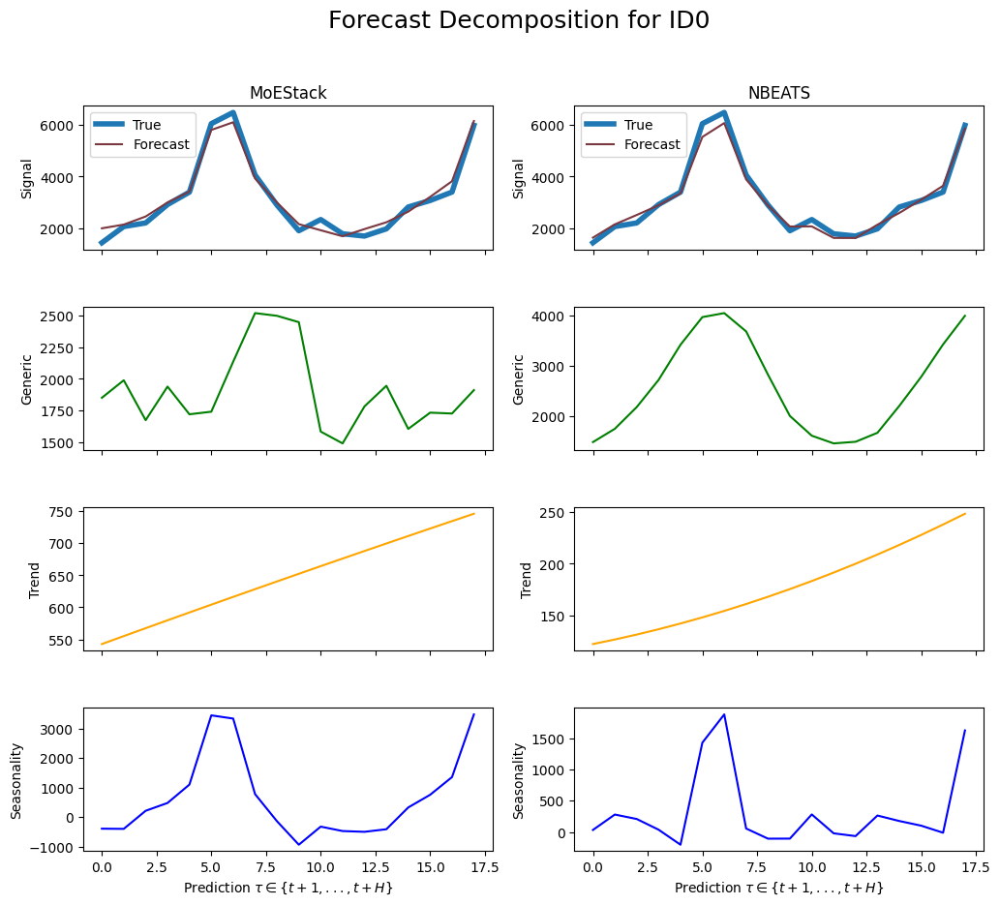

   unique_id         ds            y
0        ID0 1991-02-28  1441.330078
1        ID0 1991-03-31  2068.235107
2        ID0 1991-04-30  2207.610107
3        ID0 1991-05-31  2918.409912
4        ID0 1991-06-30  3400.817871
5        ID0 1991-07-31  6048.742188
6        ID0 1991-08-31  6483.140137
7        ID0 1991-09-30  4063.502686
8        ID0 1991-10-31  2900.229980
9        ID0 1991-11-30  1907.094971
10       ID0 1991-12-31  2338.510010
11       ID0 1992-01-31  1787.165039
12       ID0 1992-02-29  1699.645142
13       ID0 1992-03-31  1979.105225
14       ID0 1992-04-30  2824.260010
15       ID0 1992-05-31  3076.504883
16       ID0 1992-06-30  3402.584961
17       ID0 1992-07-31  5985.830078
Gate values for ID1: [0.2796487  0.29061797 0.42973334]
sMAPE for MoEStack: 0.1087606689496776
sMAPE for NBEATS: 0.13232516787189055


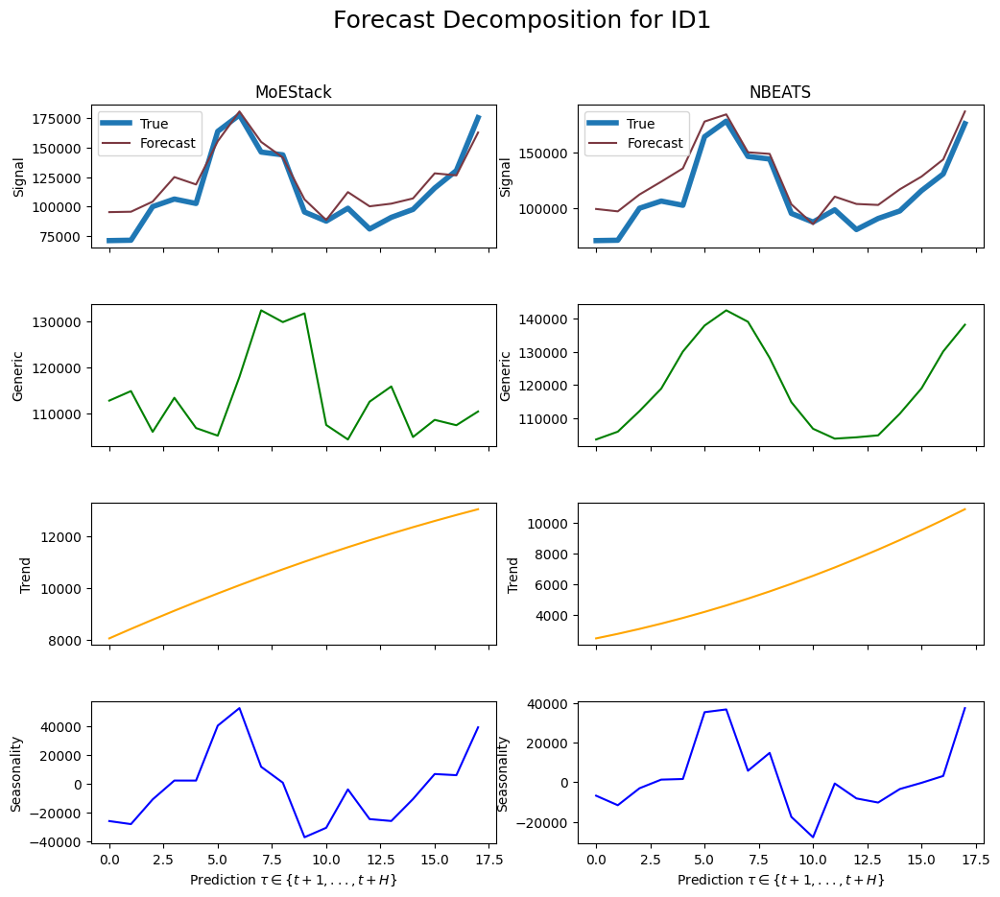

   unique_id         ds              y
18       ID1 1991-02-28   70909.859375
19       ID1 1991-03-31   71229.468750
20       ID1 1991-04-30   99842.437500
21       ID1 1991-05-31  106268.898438
22       ID1 1991-06-30  102494.398438
23       ID1 1991-07-31  163841.796875
24       ID1 1991-08-31  177779.296875
25       ID1 1991-09-30  146222.296875
26       ID1 1991-10-31  143864.203125
27       ID1 1991-11-30   95231.289062
28       ID1 1991-12-31   87472.687500
29       ID1 1992-01-31   98428.953125
30       ID1 1992-02-29   80790.898438
31       ID1 1992-03-31   90682.210938
32       ID1 1992-04-30   97428.007812
33       ID1 1992-05-31  115606.601562
34       ID1 1992-06-30  130511.796875
35       ID1 1992-07-31  175490.203125
Gate values for ID10: [0.3394316  0.33380586 0.3267625 ]
sMAPE for MoEStack: 0.7161757419796426
sMAPE for NBEATS: 0.831369402239291


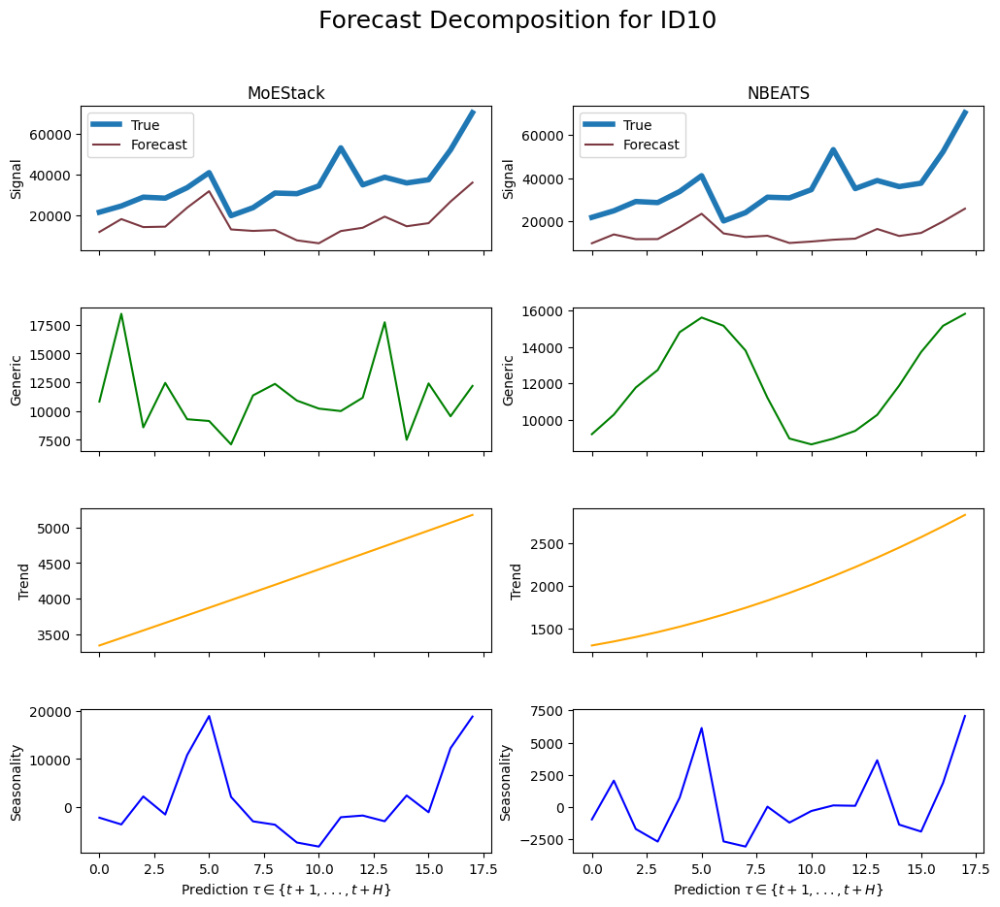

   unique_id         ds        y
36      ID10 2003-07-31  21666.0
37      ID10 2003-08-31  24720.0
38      ID10 2003-09-30  29064.0
39      ID10 2003-10-31  28564.0
40      ID10 2003-11-30  33721.0
41      ID10 2003-12-31  41106.0
42      ID10 2004-01-31  19969.0
43      ID10 2004-02-29  23875.0
44      ID10 2004-03-31  31075.0
45      ID10 2004-04-30  30758.0
46      ID10 2004-05-31  34589.0
47      ID10 2004-06-30  53278.0
48      ID10 2004-07-31  35084.0
49      ID10 2004-08-31  38853.0
50      ID10 2004-09-30  36033.0
51      ID10 2004-10-31  37599.0
52      ID10 2004-11-30  52284.0
53      ID10 2004-12-31  70523.0
Gate values for ID100: [0.32007948 0.3202599  0.35966069]
sMAPE for MoEStack: 0.14810063448347735
sMAPE for NBEATS: 0.14764274176818185


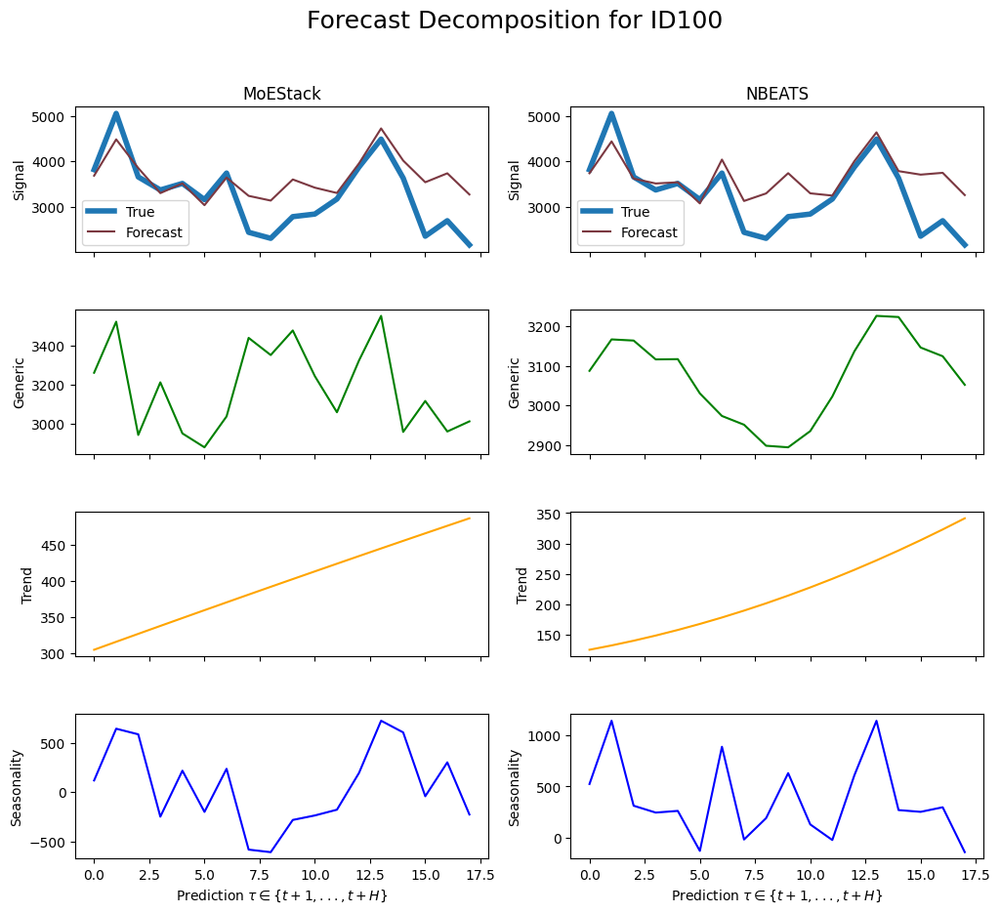

   unique_id         ds       y
54     ID100 2004-01-31  3815.0
55     ID100 2004-02-29  5050.0
56     ID100 2004-03-31  3656.0
57     ID100 2004-04-30  3370.0
58     ID100 2004-05-31  3513.0
59     ID100 2004-06-30  3158.0
60     ID100 2004-07-31  3741.0
61     ID100 2004-08-31  2440.0
62     ID100 2004-09-30  2308.0
63     ID100 2004-10-31  2784.0
64     ID100 2004-11-30  2841.0
65     ID100 2004-12-31  3171.0
66     ID100 2005-01-31  3874.0
67     ID100 2005-02-28  4487.0
68     ID100 2005-03-31  3631.0
69     ID100 2005-04-30  2355.0
70     ID100 2005-05-31  2695.0
71     ID100 2005-06-30  2164.0
Gate values for ID101: [0.30395252 0.32130098 0.37474647]
sMAPE for MoEStack: 0.2957375010055197
sMAPE for NBEATS: 0.2900039502746868


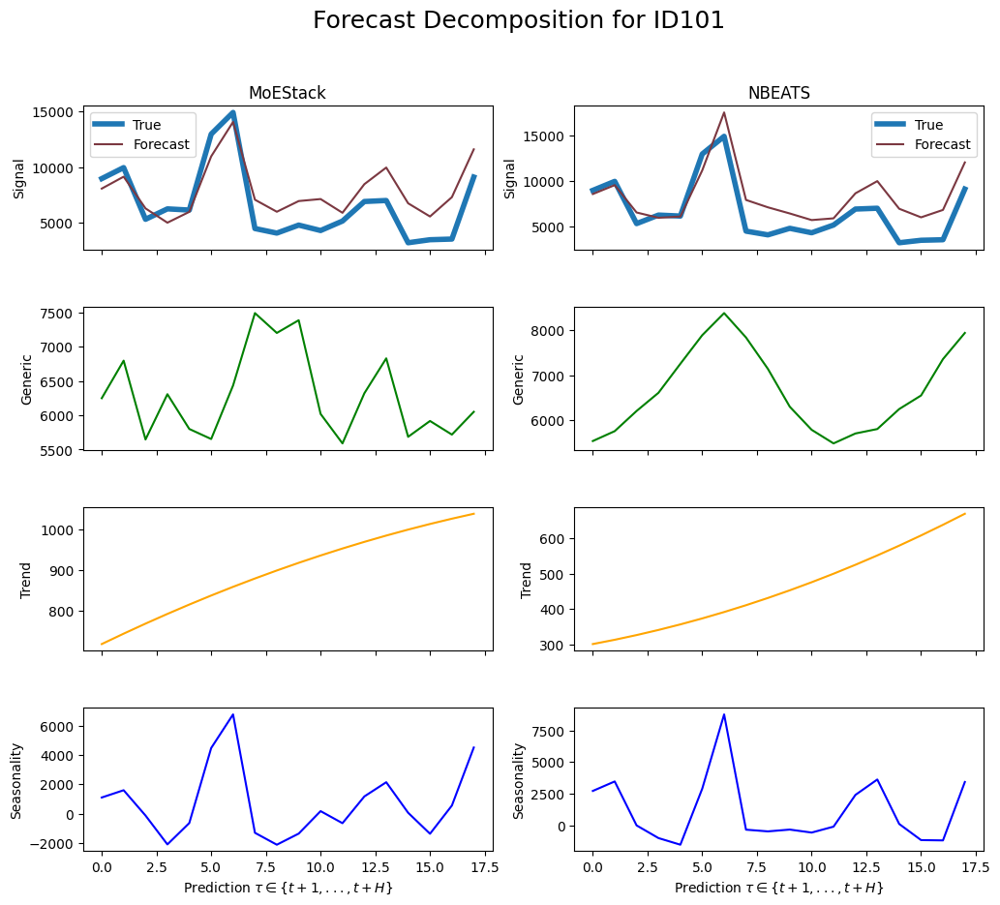

   unique_id         ds        y
72     ID101 2004-01-31   8961.0
73     ID101 2004-02-29   9950.0
74     ID101 2004-03-31   5306.0
75     ID101 2004-04-30   6243.0
76     ID101 2004-05-31   6136.0
77     ID101 2004-06-30  12957.0
78     ID101 2004-07-31  14904.0
79     ID101 2004-08-31   4477.0
80     ID101 2004-09-30   4068.0
81     ID101 2004-10-31   4786.0
82     ID101 2004-11-30   4299.0
83     ID101 2004-12-31   5149.0
84     ID101 2005-01-31   6905.0
85     ID101 2005-02-28   6995.0
86     ID101 2005-03-31   3201.0
87     ID101 2005-04-30   3472.0
88     ID101 2005-05-31   3531.0
89     ID101 2005-06-30   9100.0
Gate values for ID102: [0.34721678 0.35170698 0.30107626]
sMAPE for MoEStack: 0.2998067178438531
sMAPE for NBEATS: 0.3125601475451733


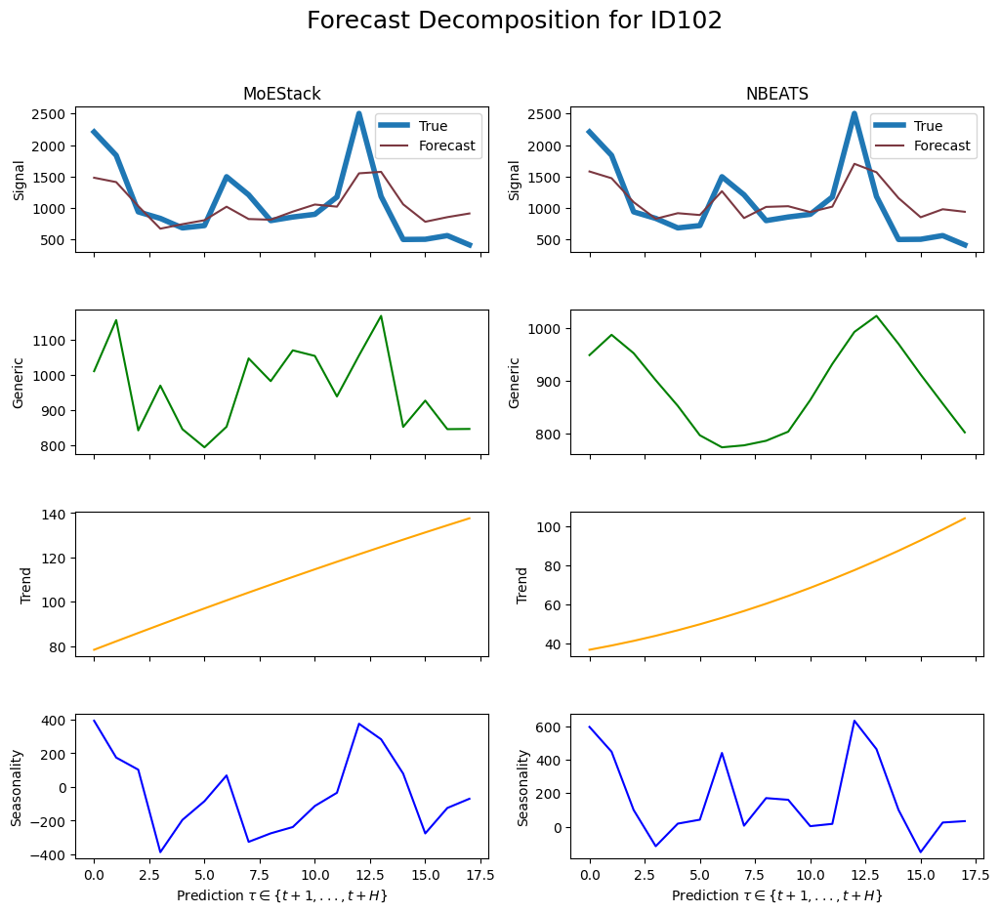

    unique_id         ds       y
90      ID102 2004-01-31  2209.0
91      ID102 2004-02-29  1837.0
92      ID102 2004-03-31   939.0
93      ID102 2004-04-30   835.0
94      ID102 2004-05-31   684.0
95      ID102 2004-06-30   721.0
96      ID102 2004-07-31  1497.0
97      ID102 2004-08-31  1210.0
98      ID102 2004-09-30   800.0
99      ID102 2004-10-31   857.0
100     ID102 2004-11-30   900.0
101     ID102 2004-12-31  1175.0
102     ID102 2005-01-31  2503.0
103     ID102 2005-02-28  1184.0
104     ID102 2005-03-31   500.0
105     ID102 2005-04-30   503.0
106     ID102 2005-05-31   562.0
107     ID102 2005-06-30   414.0
Gate values for ID103: [0.29886472 0.29770914 0.40342608]
sMAPE for MoEStack: 0.4077517184547696
sMAPE for NBEATS: 0.36233629697611275


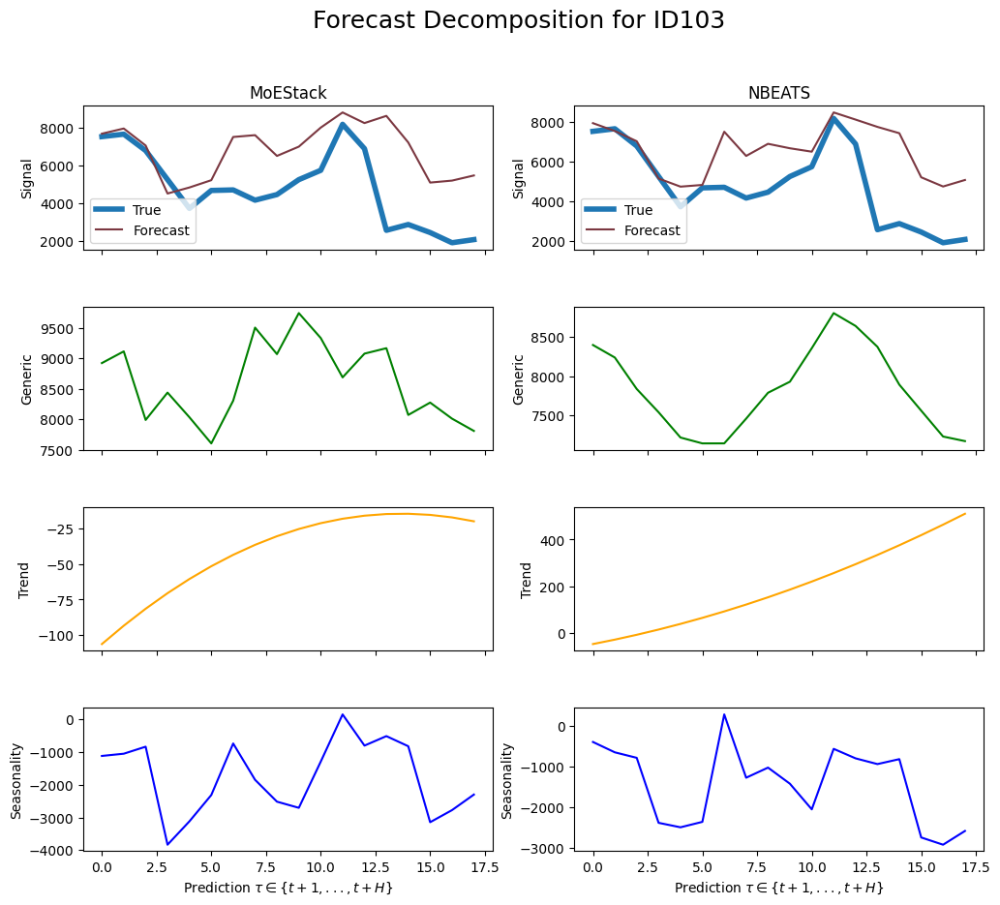

    unique_id         ds       y
108     ID103 2004-01-31  7546.0
109     ID103 2004-02-29  7676.0
110     ID103 2004-03-31  6808.0
111     ID103 2004-04-30  5273.0
112     ID103 2004-05-31  3744.0
113     ID103 2004-06-30  4697.0
114     ID103 2004-07-31  4726.0
115     ID103 2004-08-31  4183.0
116     ID103 2004-09-30  4480.0
117     ID103 2004-10-31  5269.0
118     ID103 2004-11-30  5762.0
119     ID103 2004-12-31  8198.0
120     ID103 2005-01-31  6908.0
121     ID103 2005-02-28  2588.0
122     ID103 2005-03-31  2895.0
123     ID103 2005-04-30  2470.0
124     ID103 2005-05-31  1930.0
125     ID103 2005-06-30  2096.0
Gate values for ID104: [0.35322827 0.29948664 0.3472851 ]
sMAPE for MoEStack: 0.3492850676283892
sMAPE for NBEATS: 0.33624587180013554


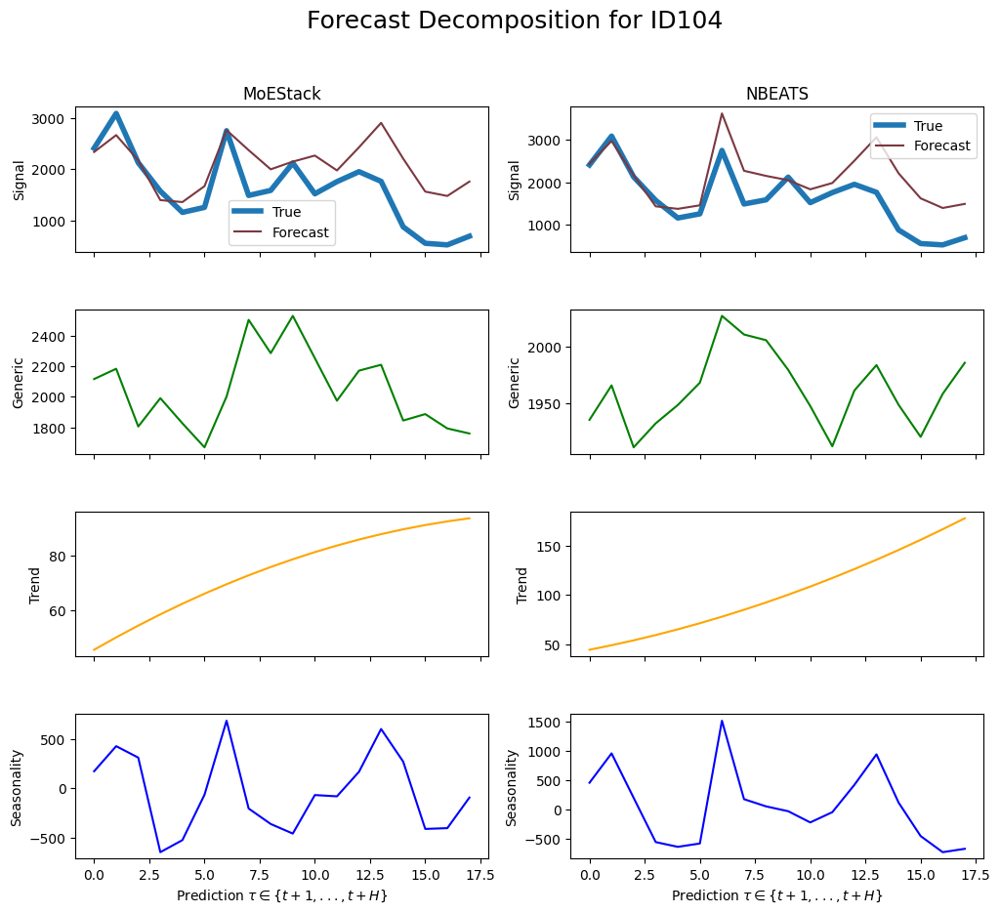

    unique_id         ds       y
126     ID104 2004-01-31  2408.0
127     ID104 2004-02-29  3084.0
128     ID104 2004-03-31  2126.0
129     ID104 2004-04-30  1574.0
130     ID104 2004-05-31  1161.0
131     ID104 2004-06-30  1258.0
132     ID104 2004-07-31  2748.0
133     ID104 2004-08-31  1490.0
134     ID104 2004-09-30  1588.0
135     ID104 2004-10-31  2121.0
136     ID104 2004-11-30  1522.0
137     ID104 2004-12-31  1758.0
138     ID104 2005-01-31  1952.0
139     ID104 2005-02-28  1764.0
140     ID104 2005-03-31   880.0
141     ID104 2005-04-30   560.0
142     ID104 2005-05-31   529.0
143     ID104 2005-06-30   698.0
Gate values for ID105: [0.390473   0.25823975 0.35128722]
sMAPE for MoEStack: 0.2987442094607879
sMAPE for NBEATS: 0.27894636888326174


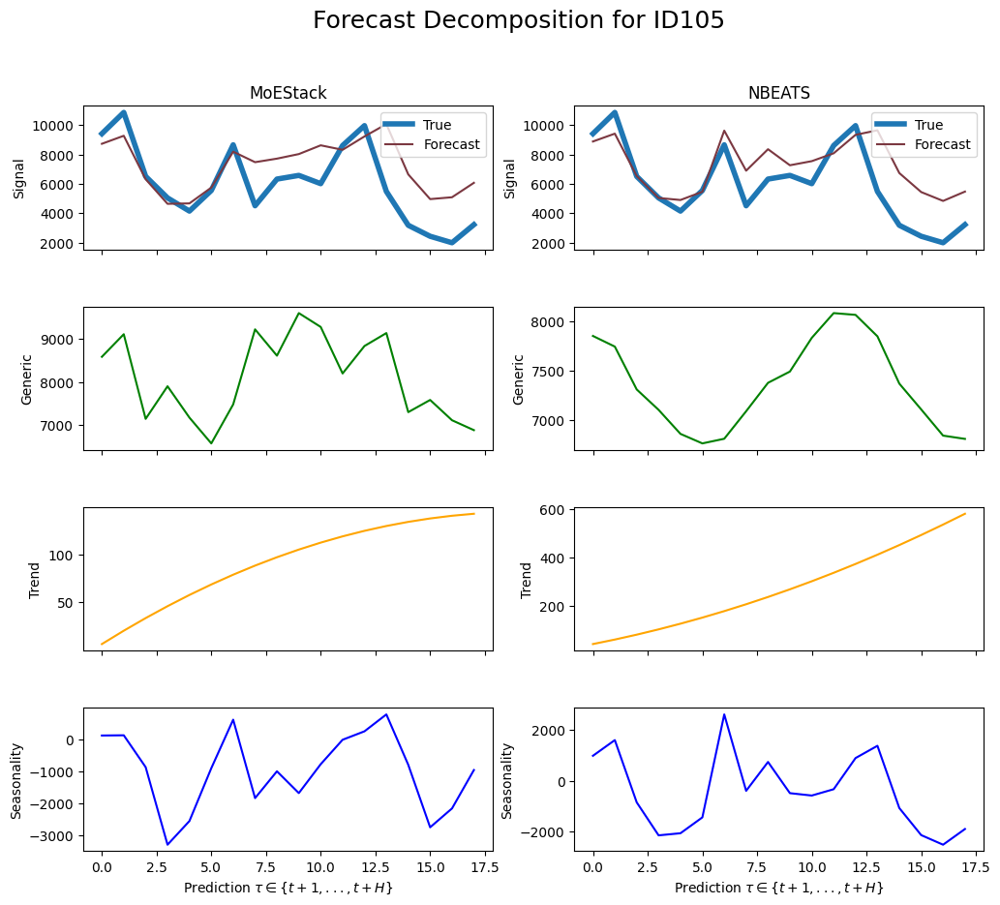

    unique_id         ds        y
144     ID105 2004-01-31   9408.0
145     ID105 2004-02-29  10853.0
146     ID105 2004-03-31   6505.0
147     ID105 2004-04-30   5042.0
148     ID105 2004-05-31   4146.0
149     ID105 2004-06-30   5547.0
150     ID105 2004-07-31   8654.0
151     ID105 2004-08-31   4508.0
152     ID105 2004-09-30   6322.0
153     ID105 2004-10-31   6573.0
154     ID105 2004-11-30   6011.0
155     ID105 2004-12-31   8604.0
156     ID105 2005-01-31   9956.0
157     ID105 2005-02-28   5482.0
158     ID105 2005-03-31   3181.0
159     ID105 2005-04-30   2434.0
160     ID105 2005-05-31   1994.0
161     ID105 2005-06-30   3224.0
Gate values for ID106: [0.34919882 0.30676103 0.34404013]
sMAPE for MoEStack: 0.130000945156186
sMAPE for NBEATS: 0.12391251971705126


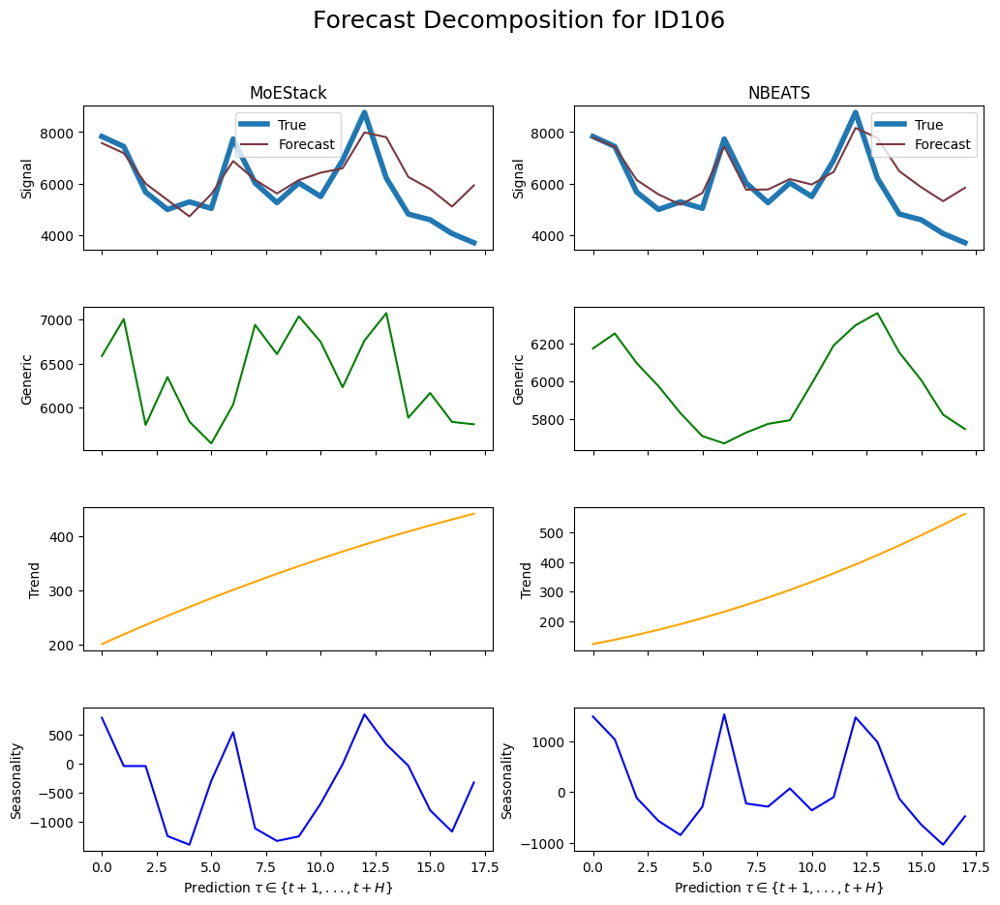

    unique_id         ds       y
162     ID106 2004-01-31  7830.0
163     ID106 2004-02-29  7441.0
164     ID106 2004-03-31  5666.0
165     ID106 2004-04-30  4993.0
166     ID106 2004-05-31  5290.0
167     ID106 2004-06-30  5035.0
168     ID106 2004-07-31  7733.0
169     ID106 2004-08-31  6024.0
170     ID106 2004-09-30  5258.0
171     ID106 2004-10-31  6027.0
172     ID106 2004-11-30  5497.0
173     ID106 2004-12-31  6909.0
174     ID106 2005-01-31  8764.0
175     ID106 2005-02-28  6208.0
176     ID106 2005-03-31  4816.0
177     ID106 2005-04-30  4593.0
178     ID106 2005-05-31  4058.0
179     ID106 2005-06-30  3701.0
Gate values for ID107: [0.3523512  0.34467012 0.30297872]
sMAPE for MoEStack: 0.19191024224054642
sMAPE for NBEATS: 0.169652504176589


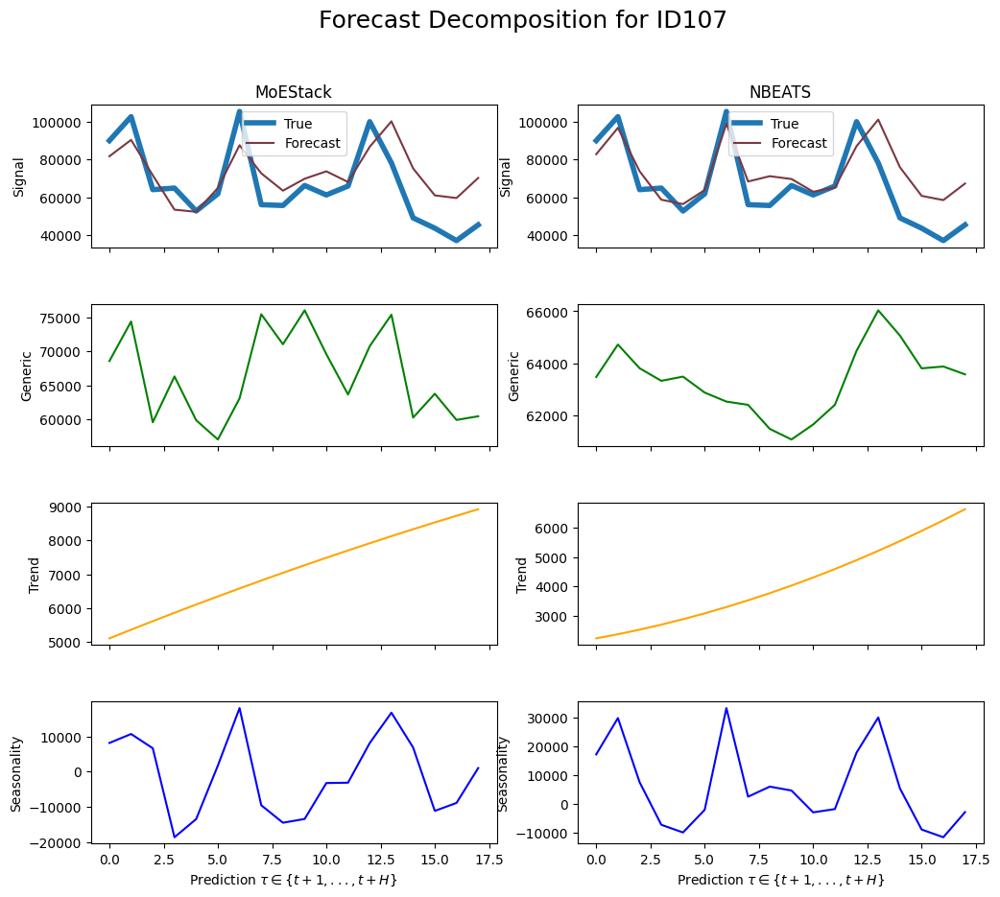

    unique_id         ds         y
180     ID107 2004-01-31   90057.0
181     ID107 2004-02-29  102730.0
182     ID107 2004-03-31   64164.0
183     ID107 2004-04-30   64986.0
184     ID107 2004-05-31   52867.0
185     ID107 2004-06-30   61968.0
186     ID107 2004-07-31  105471.0
187     ID107 2004-08-31   56220.0
188     ID107 2004-09-30   55790.0
189     ID107 2004-10-31   66366.0
190     ID107 2004-11-30   61354.0
191     ID107 2004-12-31   66053.0
192     ID107 2005-01-31  100086.0
193     ID107 2005-02-28   78274.0
194     ID107 2005-03-31   49240.0
195     ID107 2005-04-30   43800.0
196     ID107 2005-05-31   37248.0
197     ID107 2005-06-30   45566.0
Gate values for ID108: [0.36164933 0.26865155 0.3696991 ]
sMAPE for MoEStack: 0.28934917373827856
sMAPE for NBEATS: 0.3018966353732853


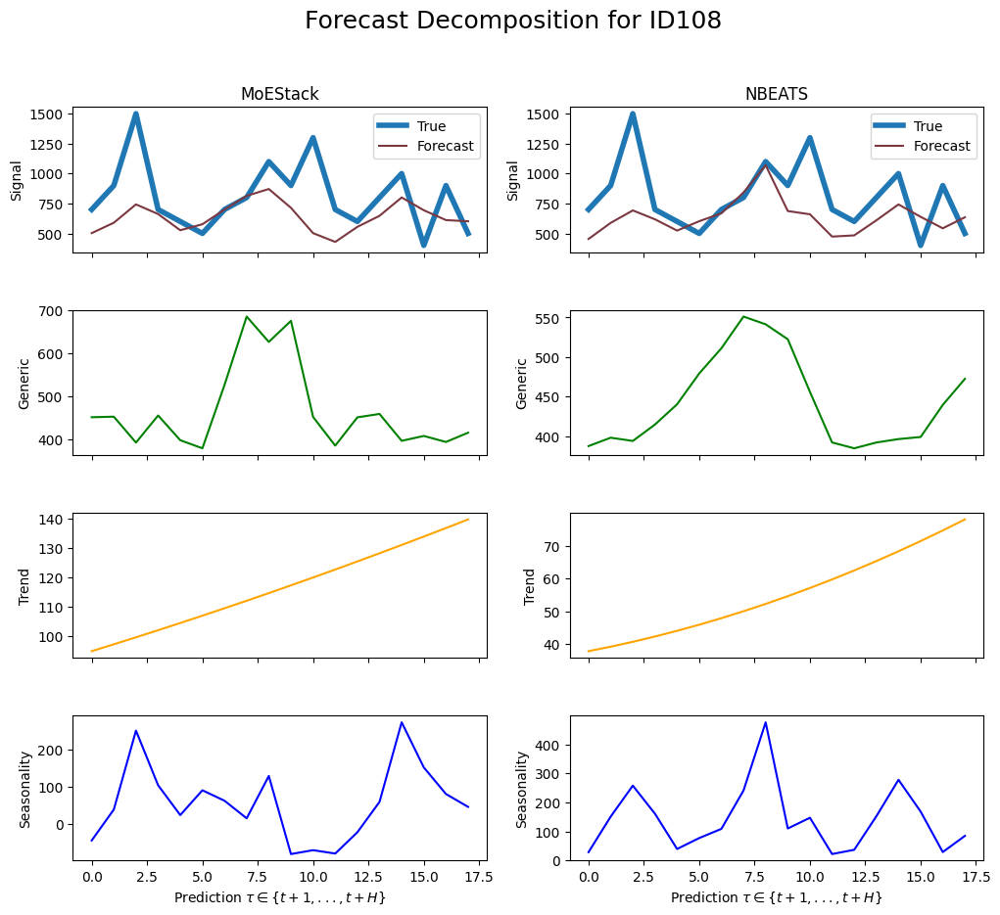

    unique_id         ds       y
198     ID108 2004-02-29   700.0
199     ID108 2004-03-31   900.0
200     ID108 2004-04-30  1500.0
201     ID108 2004-05-31   700.0
202     ID108 2004-06-30   600.0
203     ID108 2004-07-31   500.0
204     ID108 2004-08-31   700.0
205     ID108 2004-09-30   800.0
206     ID108 2004-10-31  1100.0
207     ID108 2004-11-30   900.0
208     ID108 2004-12-31  1300.0
209     ID108 2005-01-31   700.0
210     ID108 2005-02-28   600.0
211     ID108 2005-03-31   800.0
212     ID108 2005-04-30  1000.0
213     ID108 2005-05-31   400.0
214     ID108 2005-06-30   900.0
215     ID108 2005-07-31   500.0
Gate values for ID109: [0.26429373 0.22023468 0.5154716 ]
sMAPE for MoEStack: 0.12068971376191917
sMAPE for NBEATS: 0.15825572230923363


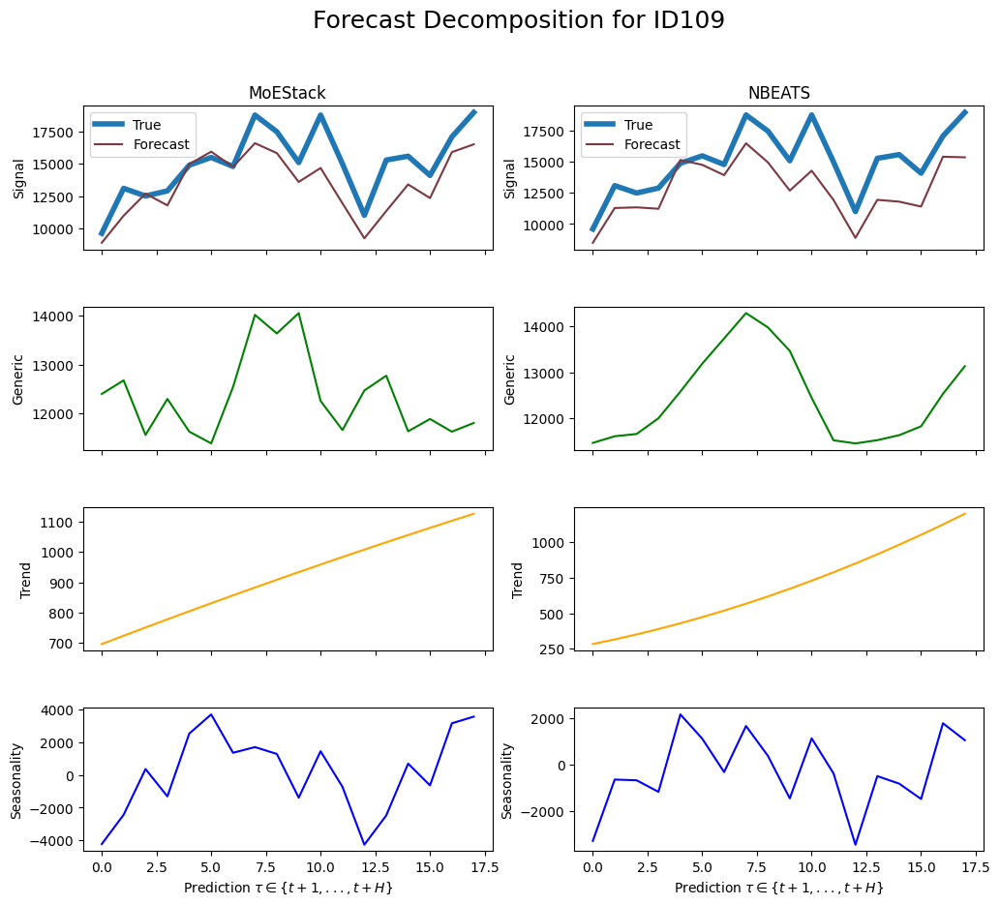

    unique_id         ds        y
216     ID109 2004-02-29   9600.0
217     ID109 2004-03-31  13100.0
218     ID109 2004-04-30  12500.0
219     ID109 2004-05-31  12900.0
220     ID109 2004-06-30  14900.0
221     ID109 2004-07-31  15500.0
222     ID109 2004-08-31  14800.0
223     ID109 2004-09-30  18800.0
224     ID109 2004-10-31  17500.0
225     ID109 2004-11-30  15100.0
226     ID109 2004-12-31  18800.0
227     ID109 2005-01-31  15000.0
228     ID109 2005-02-28  11000.0
229     ID109 2005-03-31  15300.0
230     ID109 2005-04-30  15600.0
231     ID109 2005-05-31  14100.0
232     ID109 2005-06-30  17100.0
233     ID109 2005-07-31  19000.0
Gate values for ID11: [0.38652    0.2474486  0.36603138]
sMAPE for MoEStack: 0.7031412871255941
sMAPE for NBEATS: 1.0493942946692516


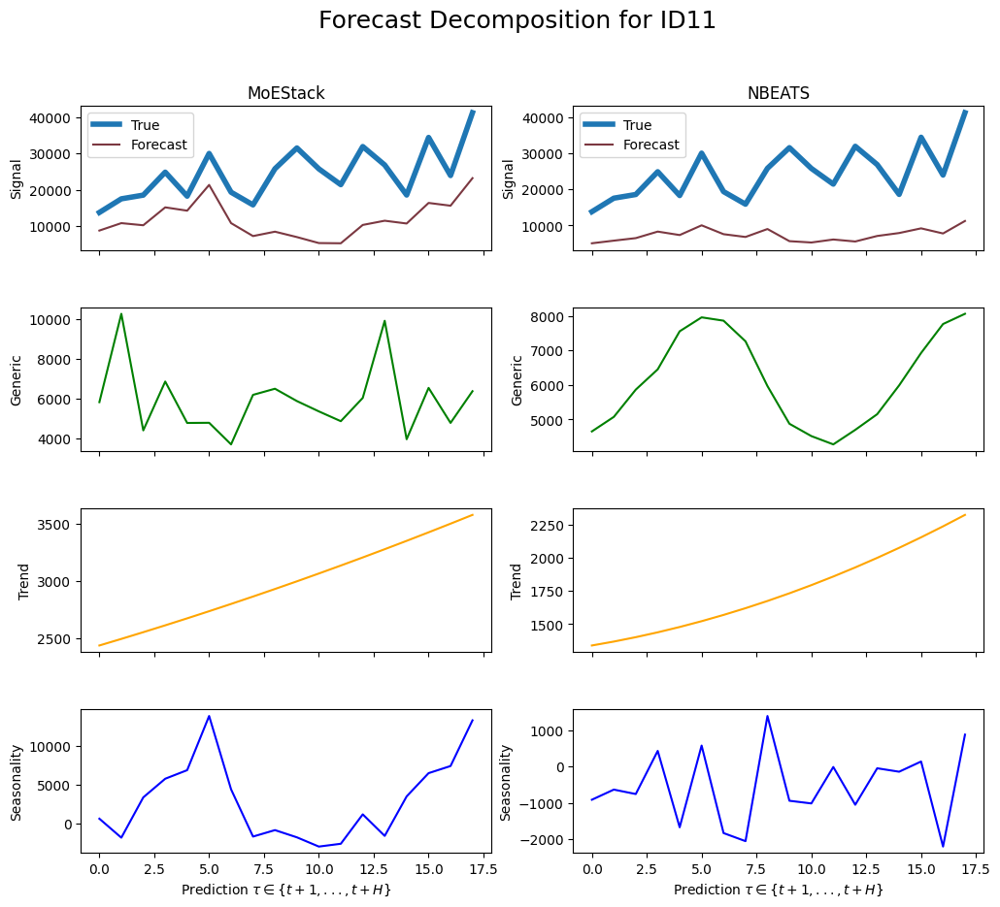

    unique_id         ds        y
234      ID11 2003-07-31  13817.0
235      ID11 2003-08-31  17564.0
236      ID11 2003-09-30  18582.0
237      ID11 2003-10-31  24889.0
238      ID11 2003-11-30  18295.0
239      ID11 2003-12-31  30031.0
240      ID11 2004-01-31  19380.0
241      ID11 2004-02-29  15897.0
242      ID11 2004-03-31  25831.0
243      ID11 2004-04-30  31544.0
244      ID11 2004-05-31  25794.0
245      ID11 2004-06-30  21450.0
246      ID11 2004-07-31  31933.0
247      ID11 2004-08-31  26861.0
248      ID11 2004-09-30  18603.0
249      ID11 2004-10-31  34432.0
250      ID11 2004-11-30  23957.0
251      ID11 2004-12-31  41228.0
Gate values for ID110: [0.15524936 0.11027747 0.7344732 ]
sMAPE for MoEStack: 0.4645378990759573
sMAPE for NBEATS: 0.4087071208274898


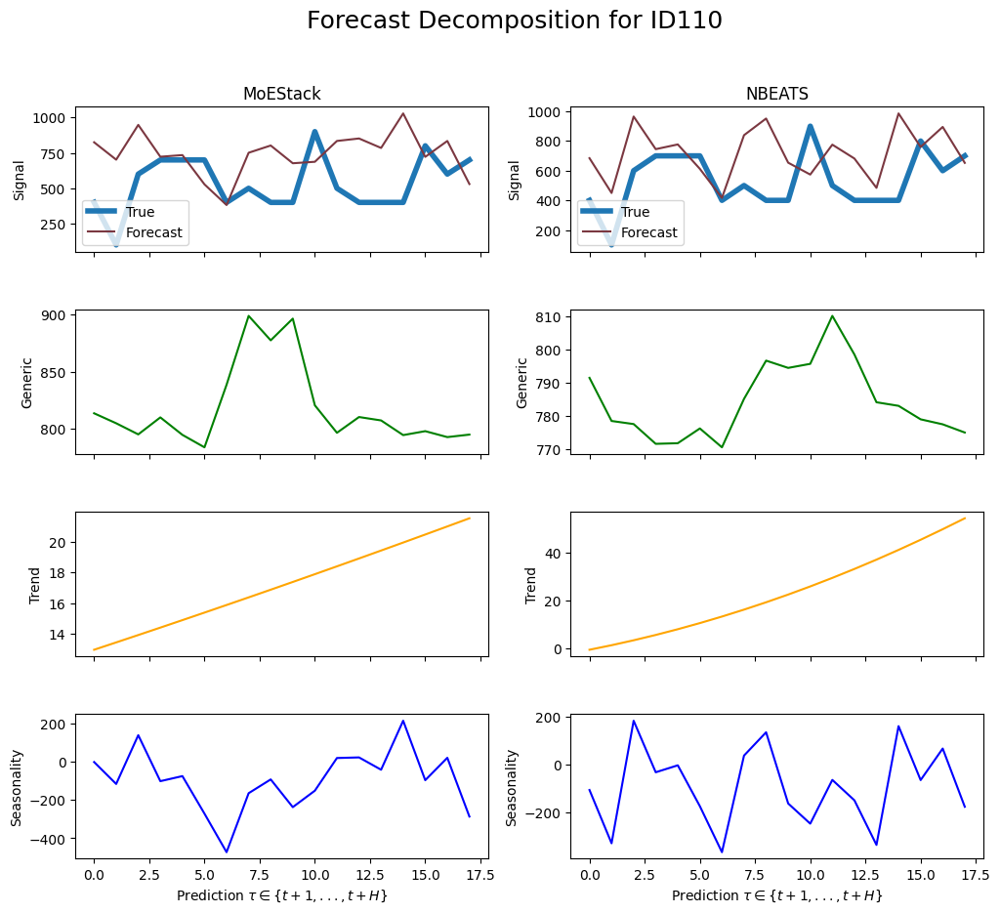

    unique_id         ds      y
252     ID110 2004-02-29  400.0
253     ID110 2004-03-31  100.0
254     ID110 2004-04-30  600.0
255     ID110 2004-05-31  700.0
256     ID110 2004-06-30  700.0
257     ID110 2004-07-31  700.0
258     ID110 2004-08-31  400.0
259     ID110 2004-09-30  500.0
260     ID110 2004-10-31  400.0
261     ID110 2004-11-30  400.0
262     ID110 2004-12-31  900.0
263     ID110 2005-01-31  500.0
264     ID110 2005-02-28  400.0
265     ID110 2005-03-31  400.0
266     ID110 2005-04-30  400.0
267     ID110 2005-05-31  800.0
268     ID110 2005-06-30  600.0
269     ID110 2005-07-31  700.0
Gate values for ID111: [0.34018078 0.31511816 0.34470108]
sMAPE for MoEStack: 0.1840139202729022
sMAPE for NBEATS: 0.1983346449613598


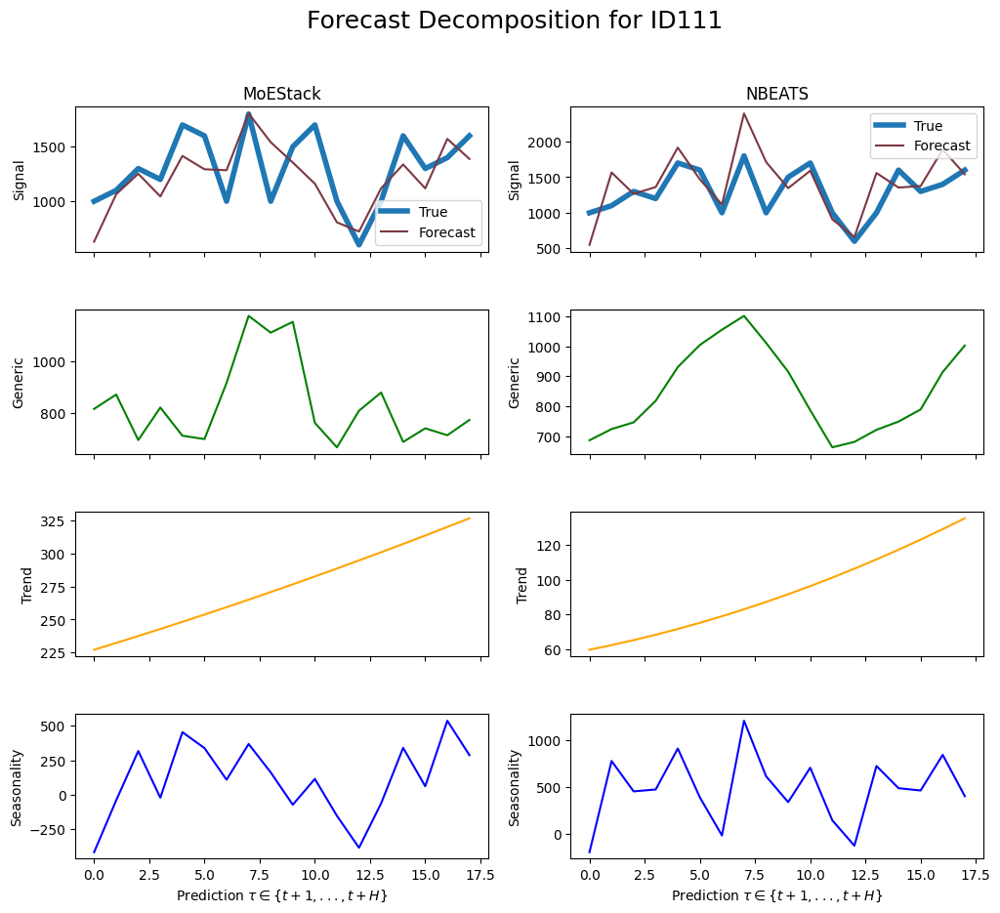

    unique_id         ds       y
270     ID111 2004-02-29  1000.0
271     ID111 2004-03-31  1100.0
272     ID111 2004-04-30  1300.0
273     ID111 2004-05-31  1200.0
274     ID111 2004-06-30  1700.0
275     ID111 2004-07-31  1600.0
276     ID111 2004-08-31  1000.0
277     ID111 2004-09-30  1800.0
278     ID111 2004-10-31  1000.0
279     ID111 2004-11-30  1500.0
280     ID111 2004-12-31  1700.0
281     ID111 2005-01-31  1000.0
282     ID111 2005-02-28   600.0
283     ID111 2005-03-31  1000.0
284     ID111 2005-04-30  1600.0
285     ID111 2005-05-31  1300.0
286     ID111 2005-06-30  1400.0
287     ID111 2005-07-31  1600.0
Gate values for ID112: [0.25694254 0.29599643 0.447061  ]
sMAPE for MoEStack: 0.08219995114184381
sMAPE for NBEATS: 0.09965702998109602


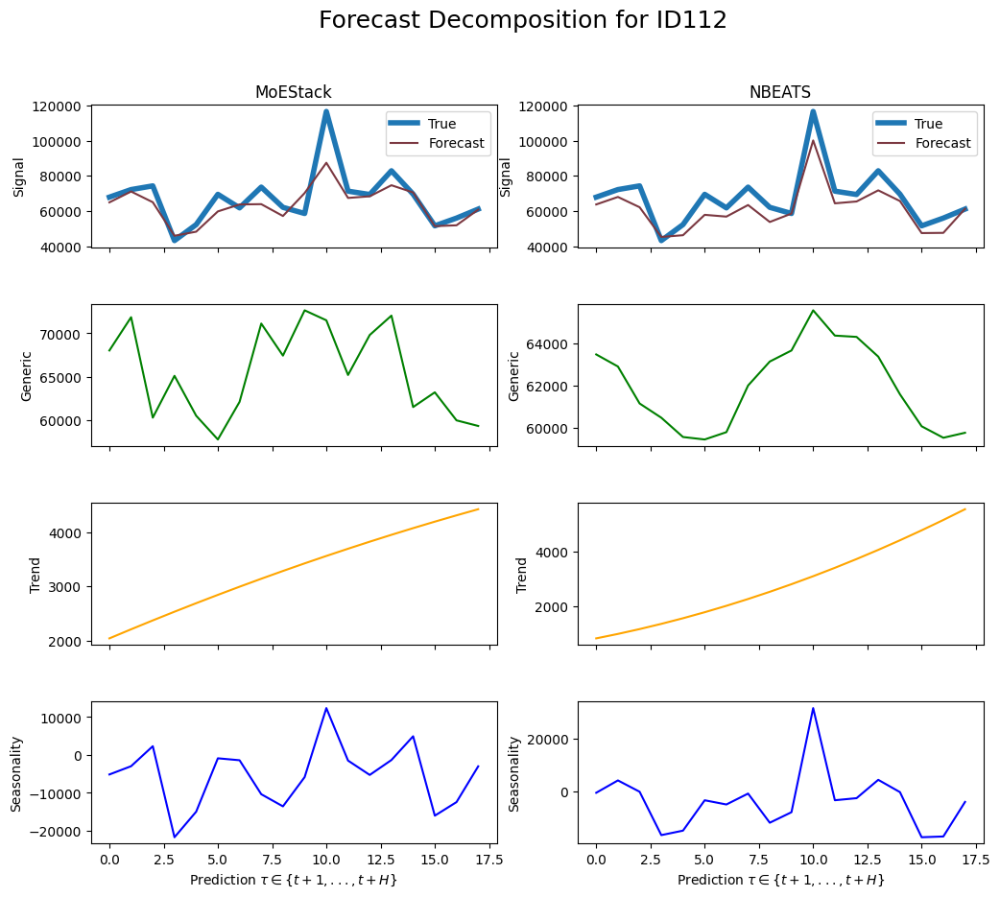

    unique_id         ds         y
288     ID112 2004-02-29   67900.0
289     ID112 2004-03-31   72200.0
290     ID112 2004-04-30   74300.0
291     ID112 2004-05-31   43200.0
292     ID112 2004-06-30   52300.0
293     ID112 2004-07-31   69500.0
294     ID112 2004-08-31   61800.0
295     ID112 2004-09-30   73600.0
296     ID112 2004-10-31   62100.0
297     ID112 2004-11-30   58600.0
298     ID112 2004-12-31  116600.0
299     ID112 2005-01-31   71300.0
300     ID112 2005-02-28   69400.0
301     ID112 2005-03-31   82900.0
302     ID112 2005-04-30   69600.0
303     ID112 2005-05-31   51600.0
304     ID112 2005-06-30   56000.0
305     ID112 2005-07-31   61100.0
Gate values for ID113: [0.53464353 0.21511963 0.2502368 ]
sMAPE for MoEStack: 0.28358155856150247
sMAPE for NBEATS: 0.36495064625130214


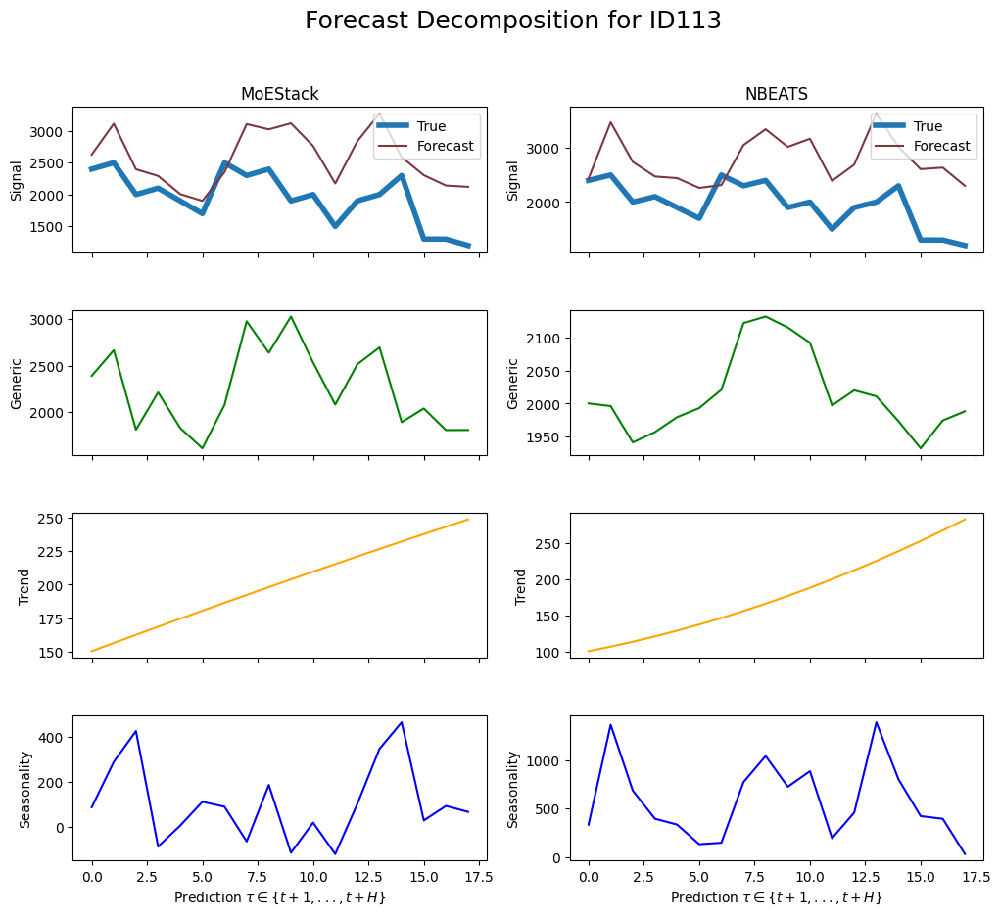

    unique_id         ds       y
306     ID113 2004-02-29  2400.0
307     ID113 2004-03-31  2500.0
308     ID113 2004-04-30  2000.0
309     ID113 2004-05-31  2100.0
310     ID113 2004-06-30  1900.0
311     ID113 2004-07-31  1700.0
312     ID113 2004-08-31  2500.0
313     ID113 2004-09-30  2300.0
314     ID113 2004-10-31  2400.0
315     ID113 2004-11-30  1900.0
316     ID113 2004-12-31  2000.0
317     ID113 2005-01-31  1500.0
318     ID113 2005-02-28  1900.0
319     ID113 2005-03-31  2000.0
320     ID113 2005-04-30  2300.0
321     ID113 2005-05-31  1300.0
322     ID113 2005-06-30  1300.0
323     ID113 2005-07-31  1200.0
Gate values for ID114: [0.34677252 0.27026123 0.38296628]
sMAPE for MoEStack: 0.14119966304264475
sMAPE for NBEATS: 0.13077924649856654


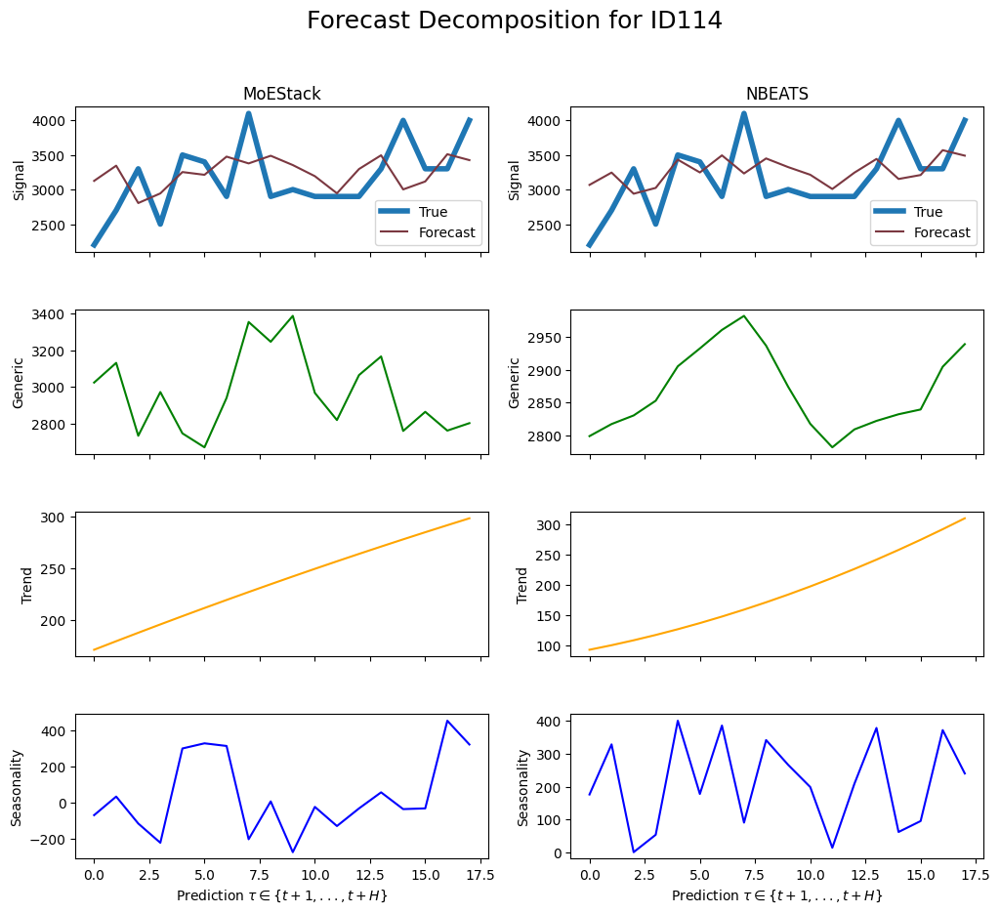

    unique_id         ds       y
324     ID114 2004-02-29  2200.0
325     ID114 2004-03-31  2700.0
326     ID114 2004-04-30  3300.0
327     ID114 2004-05-31  2500.0
328     ID114 2004-06-30  3500.0
329     ID114 2004-07-31  3400.0
330     ID114 2004-08-31  2900.0
331     ID114 2004-09-30  4100.0
332     ID114 2004-10-31  2900.0
333     ID114 2004-11-30  3000.0
334     ID114 2004-12-31  2900.0
335     ID114 2005-01-31  2900.0
336     ID114 2005-02-28  2900.0
337     ID114 2005-03-31  3300.0
338     ID114 2005-04-30  4000.0
339     ID114 2005-05-31  3300.0
340     ID114 2005-06-30  3300.0
341     ID114 2005-07-31  4000.0
Gate values for ID115: [0.1848139  0.28416905 0.531017  ]
sMAPE for MoEStack: 0.25063843224781046
sMAPE for NBEATS: 0.18668437298773244


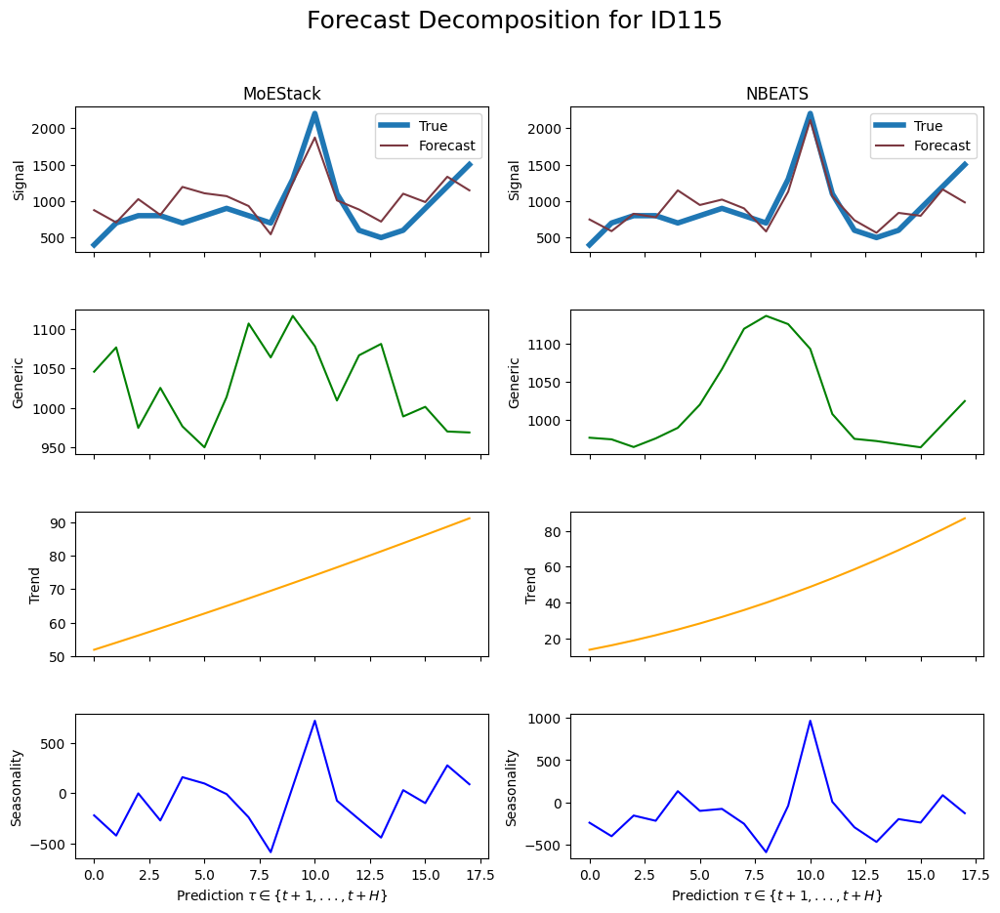

    unique_id         ds       y
342     ID115 2004-02-29   400.0
343     ID115 2004-03-31   700.0
344     ID115 2004-04-30   800.0
345     ID115 2004-05-31   800.0
346     ID115 2004-06-30   700.0
347     ID115 2004-07-31   800.0
348     ID115 2004-08-31   900.0
349     ID115 2004-09-30   800.0
350     ID115 2004-10-31   700.0
351     ID115 2004-11-30  1300.0
352     ID115 2004-12-31  2200.0
353     ID115 2005-01-31  1100.0
354     ID115 2005-02-28   600.0
355     ID115 2005-03-31   500.0
356     ID115 2005-04-30   600.0
357     ID115 2005-05-31   900.0
358     ID115 2005-06-30  1200.0
359     ID115 2005-07-31  1500.0
Gate values for ID116: [0.2078494  0.24978438 0.54236627]
sMAPE for MoEStack: 0.4463374050595255
sMAPE for NBEATS: 0.39252366245424886


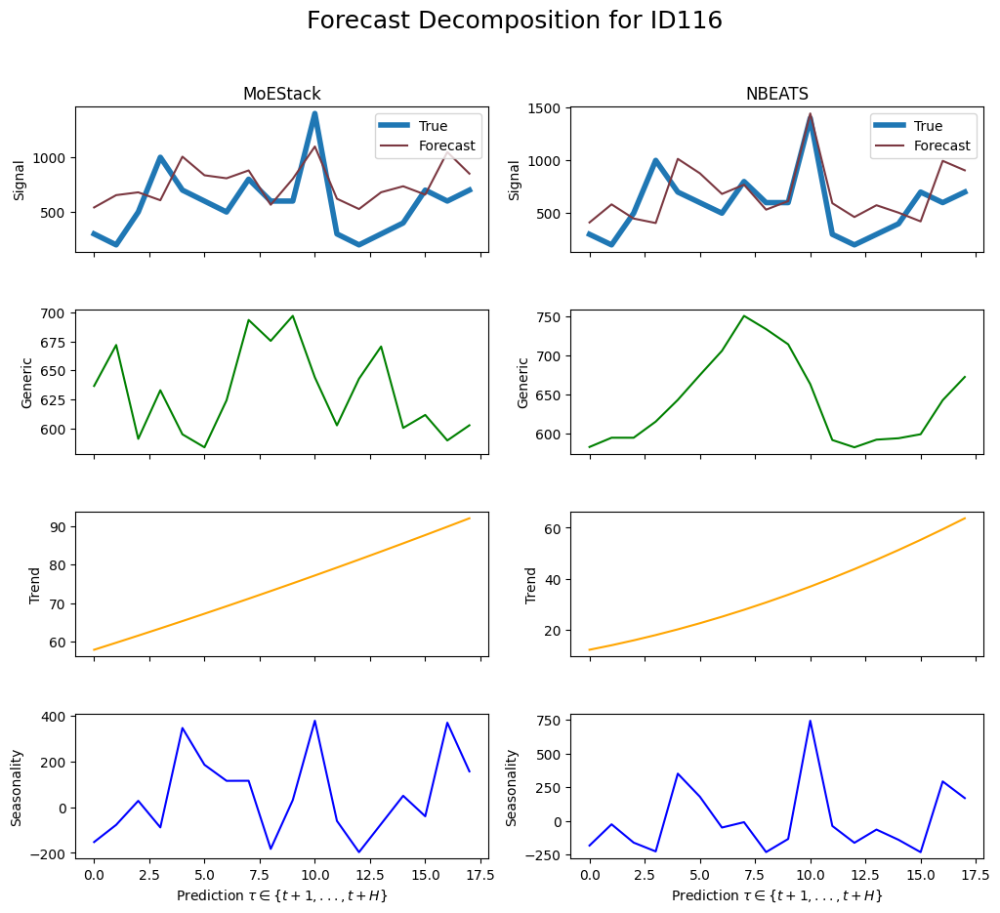

    unique_id         ds       y
360     ID116 2004-02-29   300.0
361     ID116 2004-03-31   200.0
362     ID116 2004-04-30   500.0
363     ID116 2004-05-31  1000.0
364     ID116 2004-06-30   700.0
365     ID116 2004-07-31   600.0
366     ID116 2004-08-31   500.0
367     ID116 2004-09-30   800.0
368     ID116 2004-10-31   600.0
369     ID116 2004-11-30   600.0
370     ID116 2004-12-31  1400.0
371     ID116 2005-01-31   300.0
372     ID116 2005-02-28   200.0
373     ID116 2005-03-31   300.0
374     ID116 2005-04-30   400.0
375     ID116 2005-05-31   700.0
376     ID116 2005-06-30   600.0
377     ID116 2005-07-31   700.0
Gate values for ID117: [0.2763091  0.2967329  0.42695805]
sMAPE for MoEStack: 0.23085177276065785
sMAPE for NBEATS: 0.24858730922070574


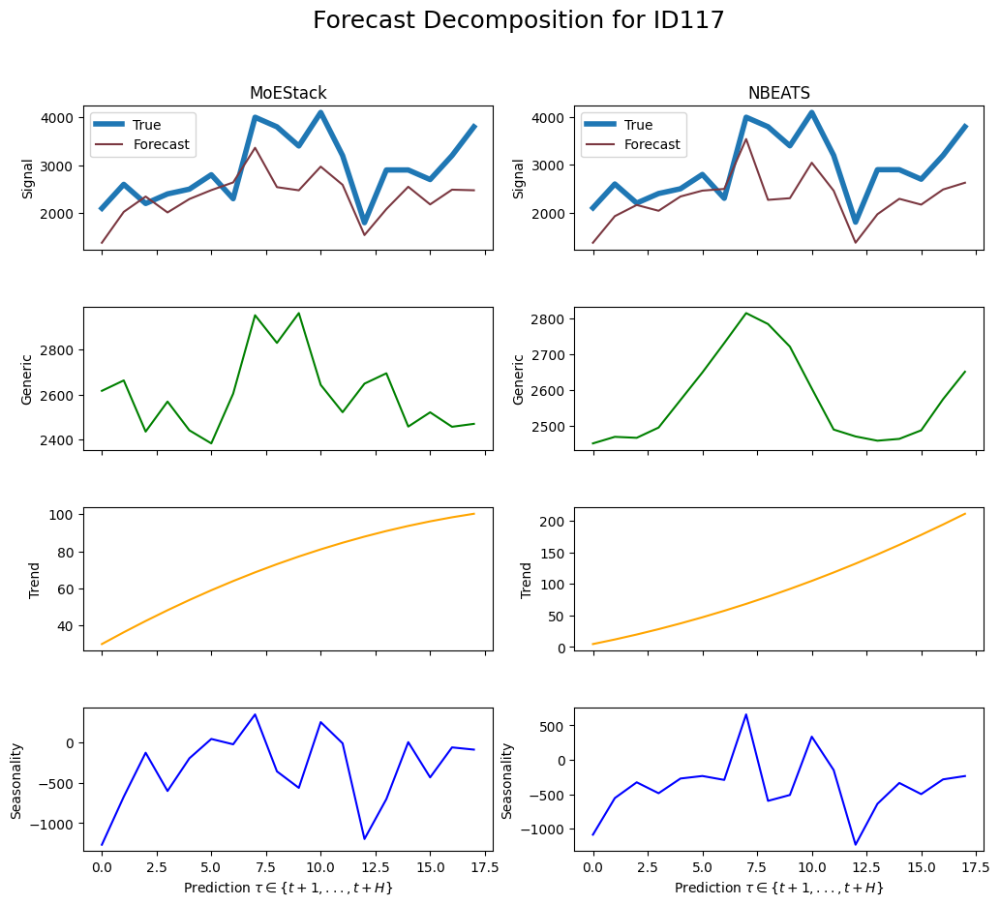

    unique_id         ds       y
378     ID117 2004-02-29  2100.0
379     ID117 2004-03-31  2600.0
380     ID117 2004-04-30  2200.0
381     ID117 2004-05-31  2400.0
382     ID117 2004-06-30  2500.0
383     ID117 2004-07-31  2800.0
384     ID117 2004-08-31  2300.0
385     ID117 2004-09-30  4000.0
386     ID117 2004-10-31  3800.0
387     ID117 2004-11-30  3400.0
388     ID117 2004-12-31  4100.0
389     ID117 2005-01-31  3200.0
390     ID117 2005-02-28  1800.0
391     ID117 2005-03-31  2900.0
392     ID117 2005-04-30  2900.0
393     ID117 2005-05-31  2700.0
394     ID117 2005-06-30  3200.0
395     ID117 2005-07-31  3800.0
Gate values for ID118: [0.2141069  0.13754201 0.6483511 ]
sMAPE for MoEStack: 0.21590881634815073
sMAPE for NBEATS: 0.16619521237174534


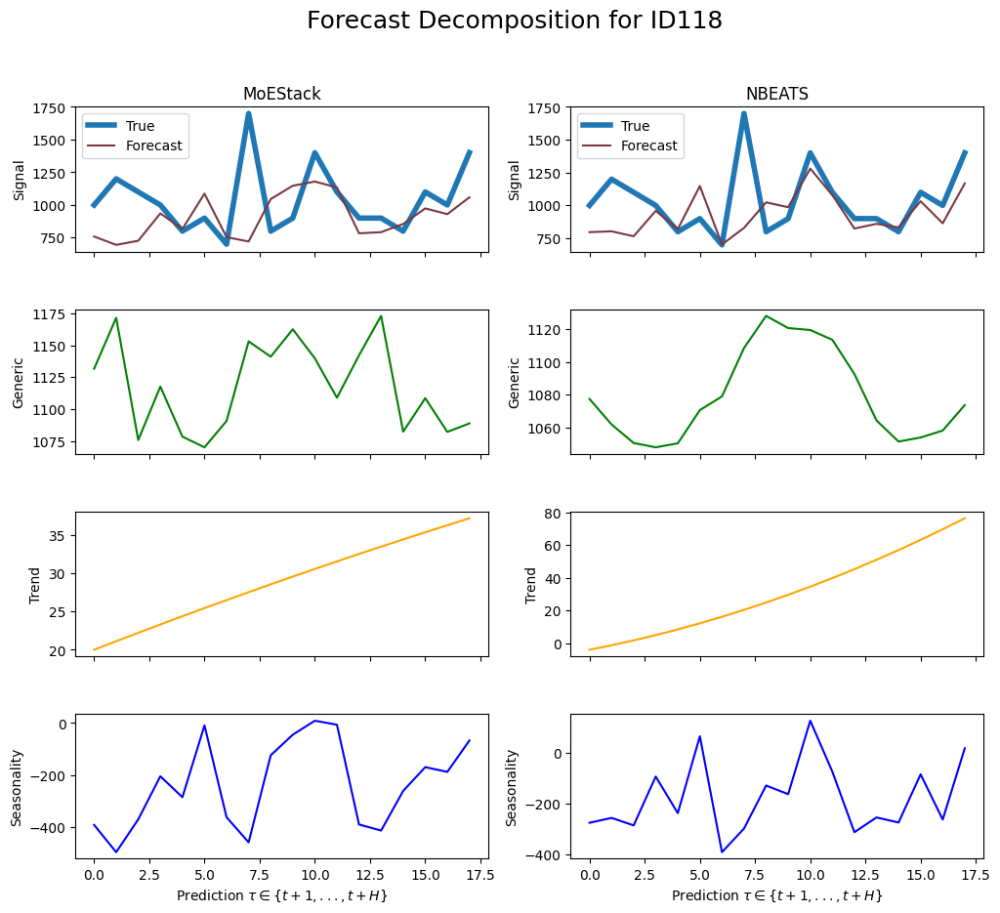

    unique_id         ds       y
396     ID118 2004-02-29  1000.0
397     ID118 2004-03-31  1200.0
398     ID118 2004-04-30  1100.0
399     ID118 2004-05-31  1000.0
400     ID118 2004-06-30   800.0
401     ID118 2004-07-31   900.0
402     ID118 2004-08-31   700.0
403     ID118 2004-09-30  1700.0
404     ID118 2004-10-31   800.0
405     ID118 2004-11-30   900.0
406     ID118 2004-12-31  1400.0
407     ID118 2005-01-31  1100.0
408     ID118 2005-02-28   900.0
409     ID118 2005-03-31   900.0
410     ID118 2005-04-30   800.0
411     ID118 2005-05-31  1100.0
412     ID118 2005-06-30  1000.0
413     ID118 2005-07-31  1400.0
Gate values for ID119: [0.26067045 0.27998748 0.4593421 ]
sMAPE for MoEStack: 0.06593137830780467
sMAPE for NBEATS: 0.09254783333577847


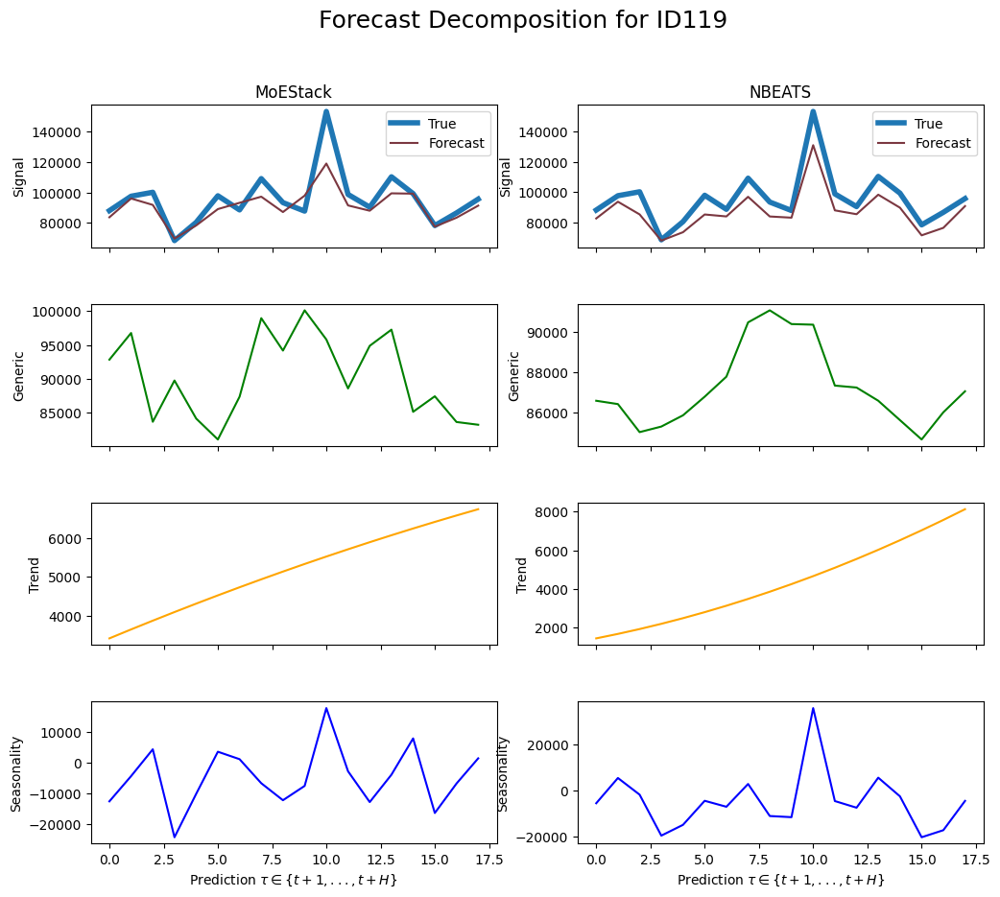

    unique_id         ds         y
414     ID119 2004-02-29   88000.0
415     ID119 2004-03-31   97500.0
416     ID119 2004-04-30  100100.0
417     ID119 2004-05-31   68300.0
418     ID119 2004-06-30   80300.0
419     ID119 2004-07-31   97800.0
420     ID119 2004-08-31   88500.0
421     ID119 2004-09-30  109100.0
422     ID119 2004-10-31   93300.0
423     ID119 2004-11-30   87700.0
424     ID119 2004-12-31  153300.0
425     ID119 2005-01-31   98700.0
426     ID119 2005-02-28   90300.0
427     ID119 2005-03-31  110300.0
428     ID119 2005-04-30   99200.0
429     ID119 2005-05-31   78200.0
430     ID119 2005-06-30   86500.0
431     ID119 2005-07-31   95600.0
Gate values for ID12: [0.43588325 0.31863382 0.24548295]
sMAPE for MoEStack: 0.4300639955532371
sMAPE for NBEATS: 0.6327412913697139


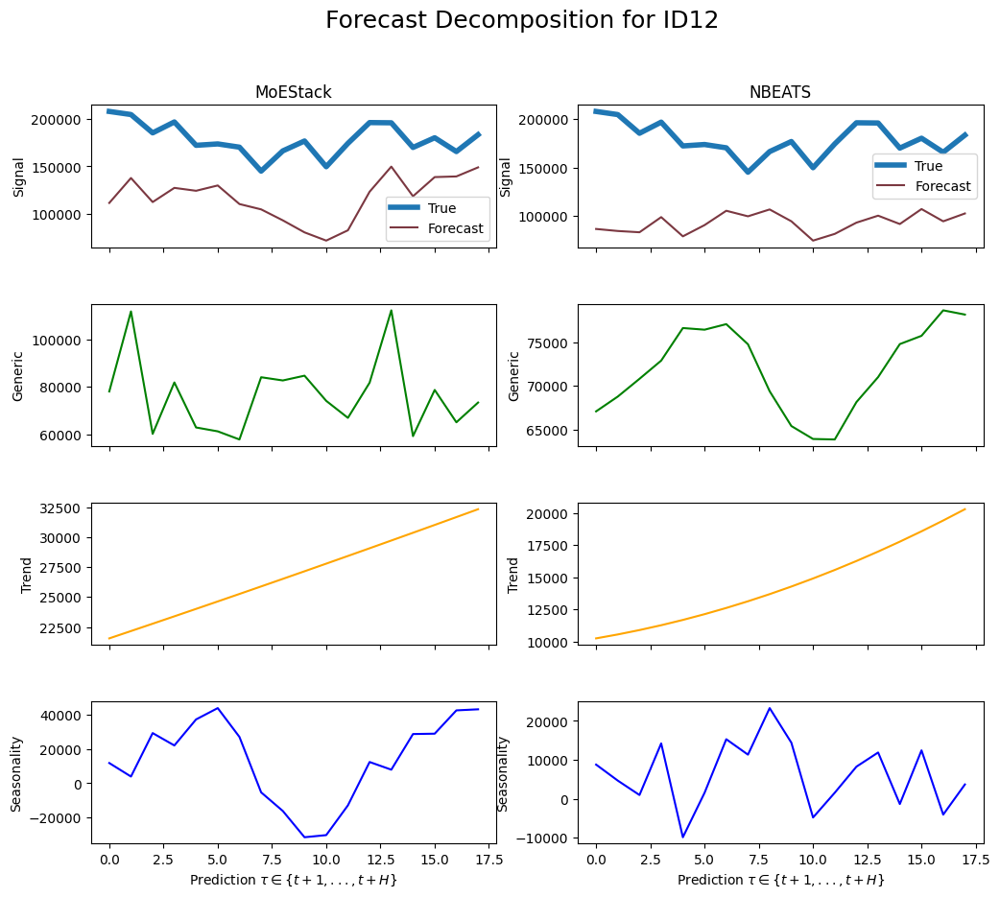

    unique_id         ds         y
432      ID12 2003-07-31  208083.0
433      ID12 2003-08-31  204828.0
434      ID12 2003-09-30  185448.0
435      ID12 2003-10-31  196983.0
436      ID12 2003-11-30  172313.0
437      ID12 2003-12-31  173776.0
438      ID12 2004-01-31  170348.0
439      ID12 2004-02-29  145026.0
440      ID12 2004-03-31  166438.0
441      ID12 2004-04-30  176879.0
442      ID12 2004-05-31  149681.0
443      ID12 2004-06-30  174396.0
444      ID12 2004-07-31  196330.0
445      ID12 2004-08-31  196099.0
446      ID12 2004-09-30  170047.0
447      ID12 2004-10-31  180311.0
448      ID12 2004-11-30  165713.0
449      ID12 2004-12-31  183527.0
Gate values for ID120: [0.27831048 0.28231254 0.4393769 ]
sMAPE for MoEStack: 0.3136650456234923
sMAPE for NBEATS: 0.3040965884500093


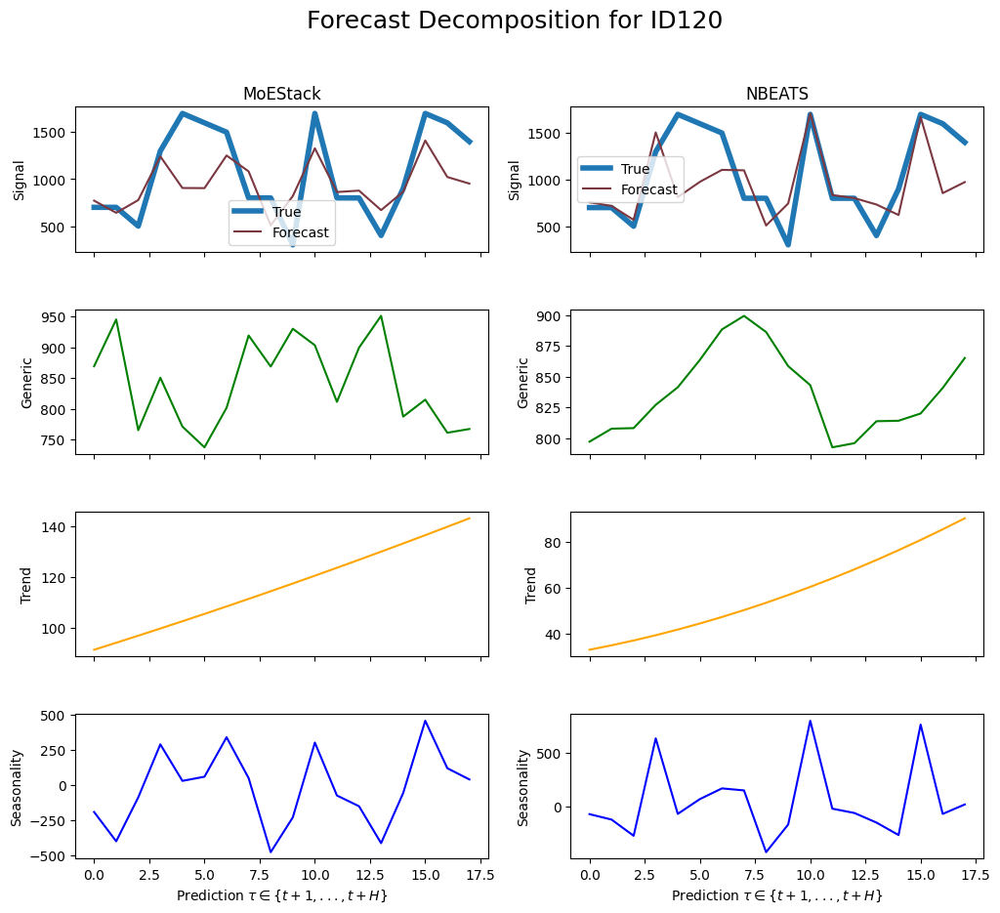

    unique_id         ds       y
450     ID120 2004-02-29   700.0
451     ID120 2004-03-31   700.0
452     ID120 2004-04-30   500.0
453     ID120 2004-05-31  1300.0
454     ID120 2004-06-30  1700.0
455     ID120 2004-07-31  1600.0
456     ID120 2004-08-31  1500.0
457     ID120 2004-09-30   800.0
458     ID120 2004-10-31   800.0
459     ID120 2004-11-30   300.0
460     ID120 2004-12-31  1700.0
461     ID120 2005-01-31   800.0
462     ID120 2005-02-28   800.0
463     ID120 2005-03-31   400.0
464     ID120 2005-04-30   900.0
465     ID120 2005-05-31  1700.0
466     ID120 2005-06-30  1600.0
467     ID120 2005-07-31  1400.0
Gate values for ID121: [0.24546373 0.34459248 0.40994376]
sMAPE for MoEStack: 0.26744229871643604
sMAPE for NBEATS: 0.22035268703239633


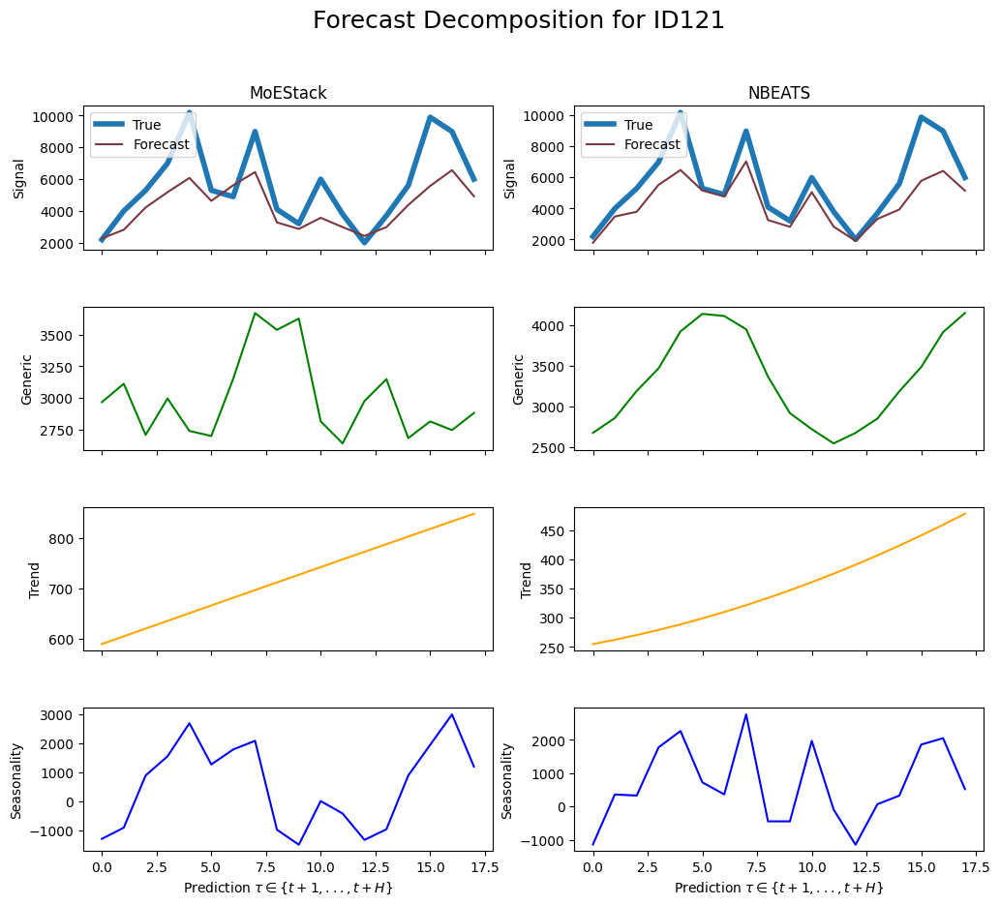

    unique_id         ds        y
468     ID121 2004-02-29   2200.0
469     ID121 2004-03-31   4000.0
470     ID121 2004-04-30   5300.0
471     ID121 2004-05-31   7000.0
472     ID121 2004-06-30  10200.0
473     ID121 2004-07-31   5300.0
474     ID121 2004-08-31   4900.0
475     ID121 2004-09-30   9000.0
476     ID121 2004-10-31   4100.0
477     ID121 2004-11-30   3200.0
478     ID121 2004-12-31   6000.0
479     ID121 2005-01-31   3800.0
480     ID121 2005-02-28   2000.0
481     ID121 2005-03-31   3700.0
482     ID121 2005-04-30   5600.0
483     ID121 2005-05-31   9900.0
484     ID121 2005-06-30   9000.0
485     ID121 2005-07-31   6000.0
Gate values for ID122: [0.23359583 0.29195106 0.47445315]
sMAPE for MoEStack: 0.19246154876931212
sMAPE for NBEATS: 0.19136212497901683


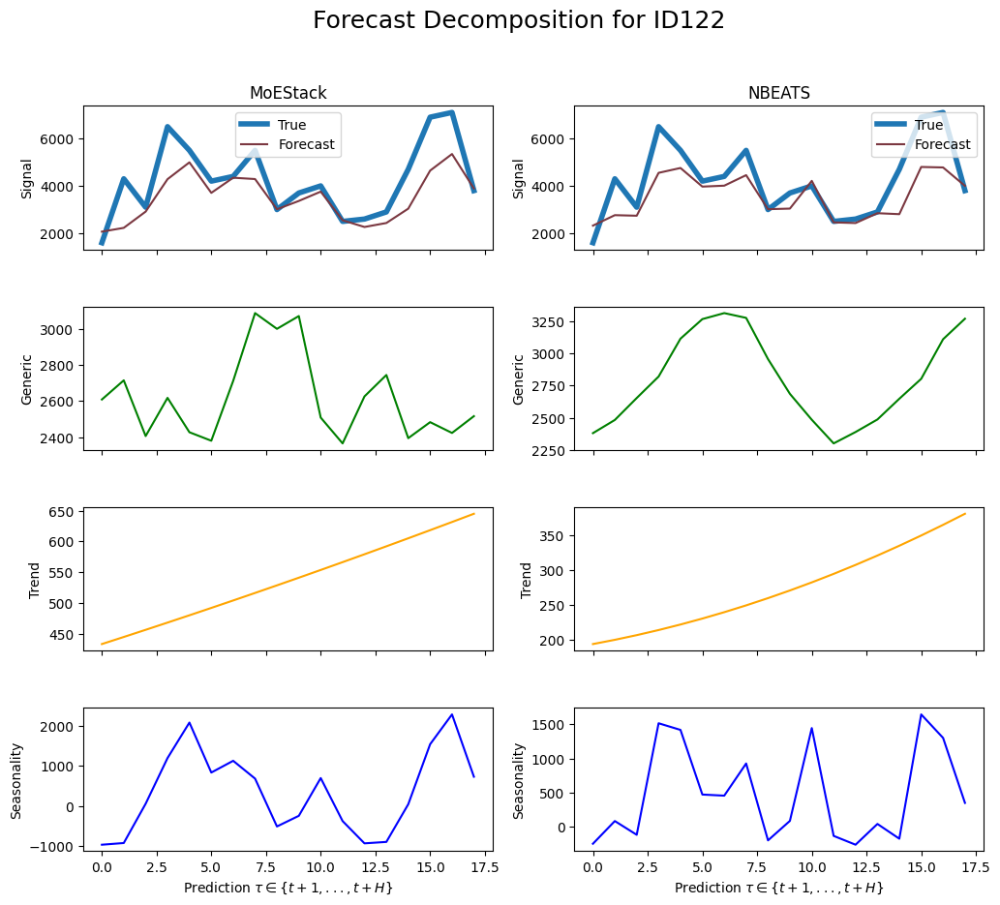

    unique_id         ds       y
486     ID122 2004-02-29  1600.0
487     ID122 2004-03-31  4300.0
488     ID122 2004-04-30  3100.0
489     ID122 2004-05-31  6500.0
490     ID122 2004-06-30  5500.0
491     ID122 2004-07-31  4200.0
492     ID122 2004-08-31  4400.0
493     ID122 2004-09-30  5500.0
494     ID122 2004-10-31  3000.0
495     ID122 2004-11-30  3700.0
496     ID122 2004-12-31  4000.0
497     ID122 2005-01-31  2500.0
498     ID122 2005-02-28  2600.0
499     ID122 2005-03-31  2900.0
500     ID122 2005-04-30  4700.0
501     ID122 2005-05-31  6900.0
502     ID122 2005-06-30  7100.0
503     ID122 2005-07-31  3800.0
Gate values for ID123: [0.21751893 0.36850393 0.41397712]
sMAPE for MoEStack: 0.1986810604214014
sMAPE for NBEATS: 0.14251862955341346


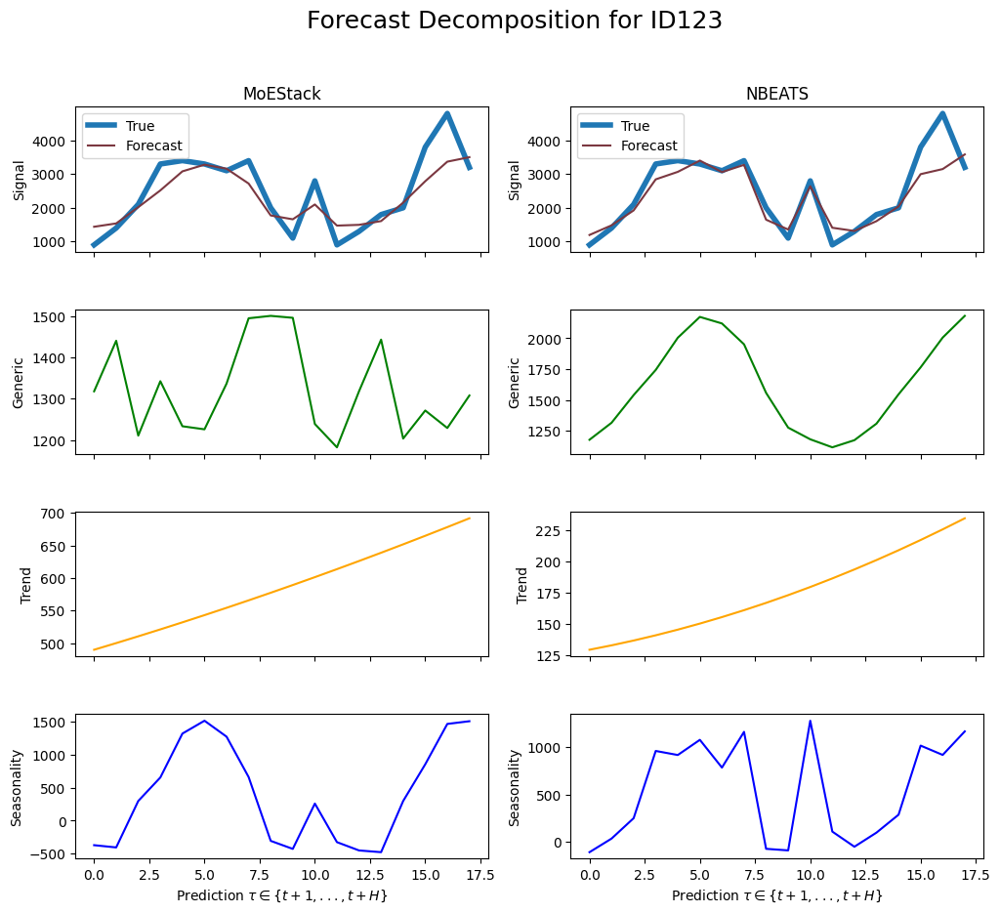

    unique_id         ds       y
504     ID123 2004-02-29   900.0
505     ID123 2004-03-31  1400.0
506     ID123 2004-04-30  2100.0
507     ID123 2004-05-31  3300.0
508     ID123 2004-06-30  3400.0
509     ID123 2004-07-31  3300.0
510     ID123 2004-08-31  3100.0
511     ID123 2004-09-30  3400.0
512     ID123 2004-10-31  2000.0
513     ID123 2004-11-30  1100.0
514     ID123 2004-12-31  2800.0
515     ID123 2005-01-31   900.0
516     ID123 2005-02-28  1300.0
517     ID123 2005-03-31  1800.0
518     ID123 2005-04-30  2000.0
519     ID123 2005-05-31  3800.0
520     ID123 2005-06-30  4800.0
521     ID123 2005-07-31  3200.0
Gate values for ID124: [0.24282679 0.3358361  0.42133704]
sMAPE for MoEStack: 0.25663802615159087
sMAPE for NBEATS: 0.33195117002226915


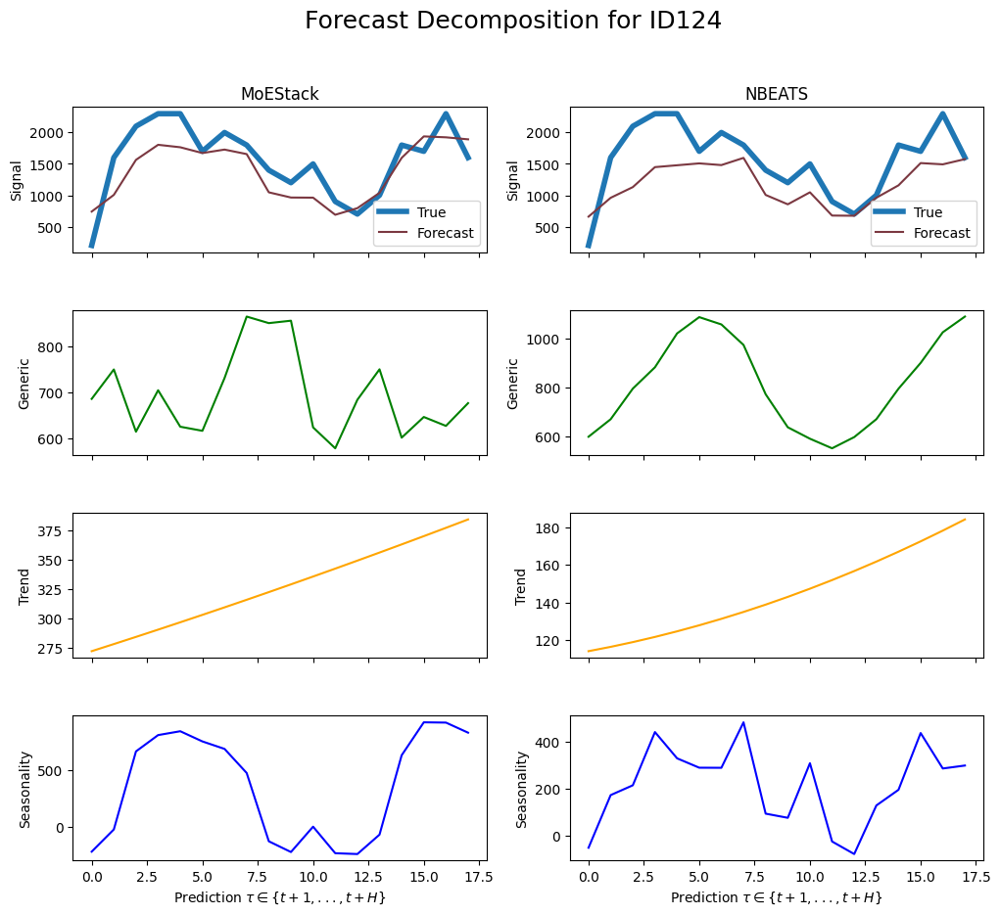

    unique_id         ds       y
522     ID124 2004-02-29   200.0
523     ID124 2004-03-31  1600.0
524     ID124 2004-04-30  2100.0
525     ID124 2004-05-31  2300.0
526     ID124 2004-06-30  2300.0
527     ID124 2004-07-31  1700.0
528     ID124 2004-08-31  2000.0
529     ID124 2004-09-30  1800.0
530     ID124 2004-10-31  1400.0
531     ID124 2004-11-30  1200.0
532     ID124 2004-12-31  1500.0
533     ID124 2005-01-31   900.0
534     ID124 2005-02-28   700.0
535     ID124 2005-03-31  1000.0
536     ID124 2005-04-30  1800.0
537     ID124 2005-05-31  1700.0
538     ID124 2005-06-30  2300.0
539     ID124 2005-07-31  1600.0
Gate values for ID125: [0.25711176 0.3325218  0.41036645]
sMAPE for MoEStack: 0.7120823579095519
sMAPE for NBEATS: 0.5302106623260372


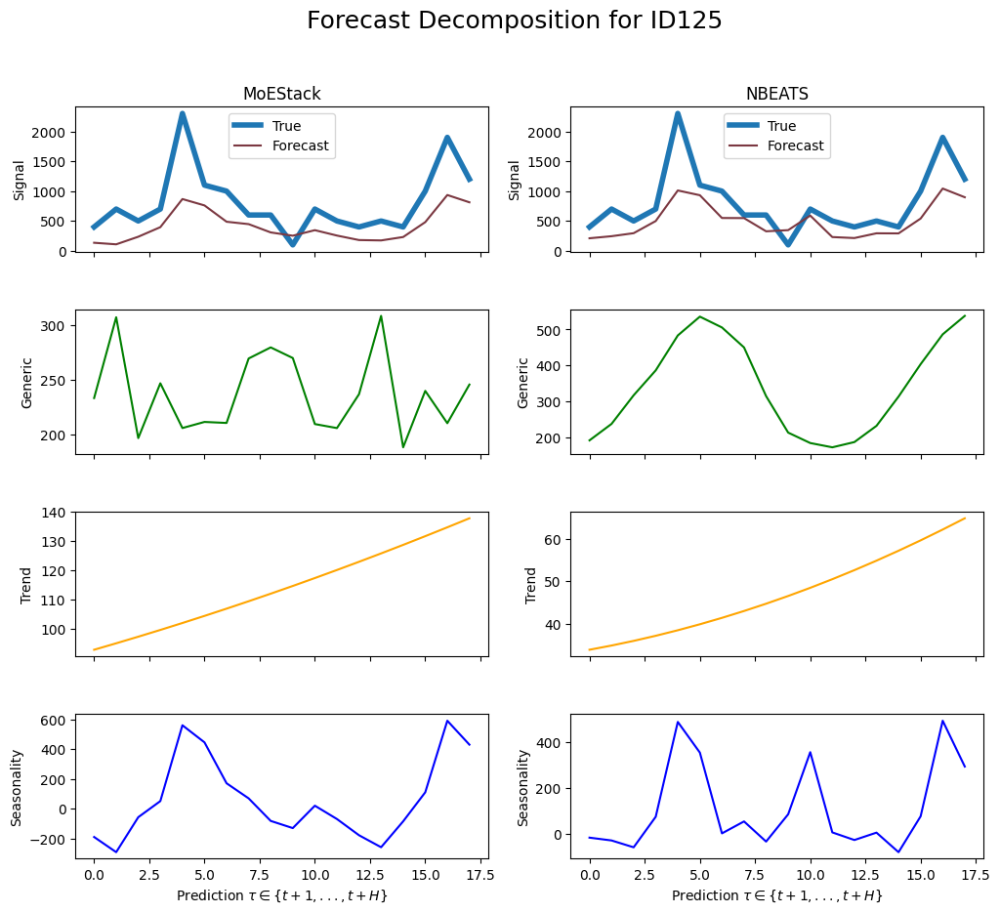

    unique_id         ds       y
540     ID125 2004-02-29   400.0
541     ID125 2004-03-31   700.0
542     ID125 2004-04-30   500.0
543     ID125 2004-05-31   700.0
544     ID125 2004-06-30  2300.0
545     ID125 2004-07-31  1100.0
546     ID125 2004-08-31  1000.0
547     ID125 2004-09-30   600.0
548     ID125 2004-10-31   600.0
549     ID125 2004-11-30   100.0
550     ID125 2004-12-31   700.0
551     ID125 2005-01-31   500.0
552     ID125 2005-02-28   400.0
553     ID125 2005-03-31   500.0
554     ID125 2005-04-30   400.0
555     ID125 2005-05-31  1000.0
556     ID125 2005-06-30  1900.0
557     ID125 2005-07-31  1200.0
Gate values for ID126: [0.19971587 0.18233375 0.61795044]
sMAPE for MoEStack: 0.2322627412131604
sMAPE for NBEATS: 0.20485843574690427


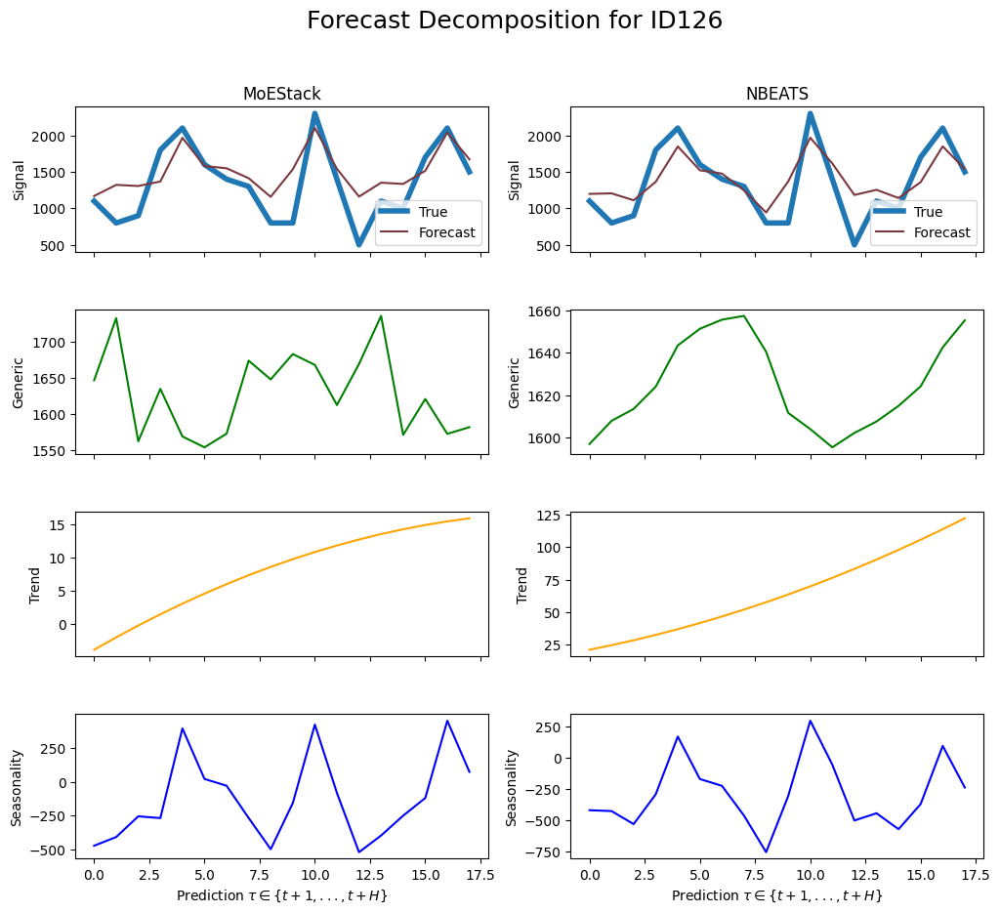

    unique_id         ds       y
558     ID126 2004-02-29  1100.0
559     ID126 2004-03-31   800.0
560     ID126 2004-04-30   900.0
561     ID126 2004-05-31  1800.0
562     ID126 2004-06-30  2100.0
563     ID126 2004-07-31  1600.0
564     ID126 2004-08-31  1400.0
565     ID126 2004-09-30  1300.0
566     ID126 2004-10-31   800.0
567     ID126 2004-11-30   800.0
568     ID126 2004-12-31  2300.0
569     ID126 2005-01-31  1400.0
570     ID126 2005-02-28   500.0
571     ID126 2005-03-31  1100.0
572     ID126 2005-04-30  1000.0
573     ID126 2005-05-31  1700.0
574     ID126 2005-06-30  2100.0
575     ID126 2005-07-31  1500.0
Gate values for ID127: [0.232337   0.33510745 0.43255562]
sMAPE for MoEStack: 0.16565115499926852
sMAPE for NBEATS: 0.14268892468884836


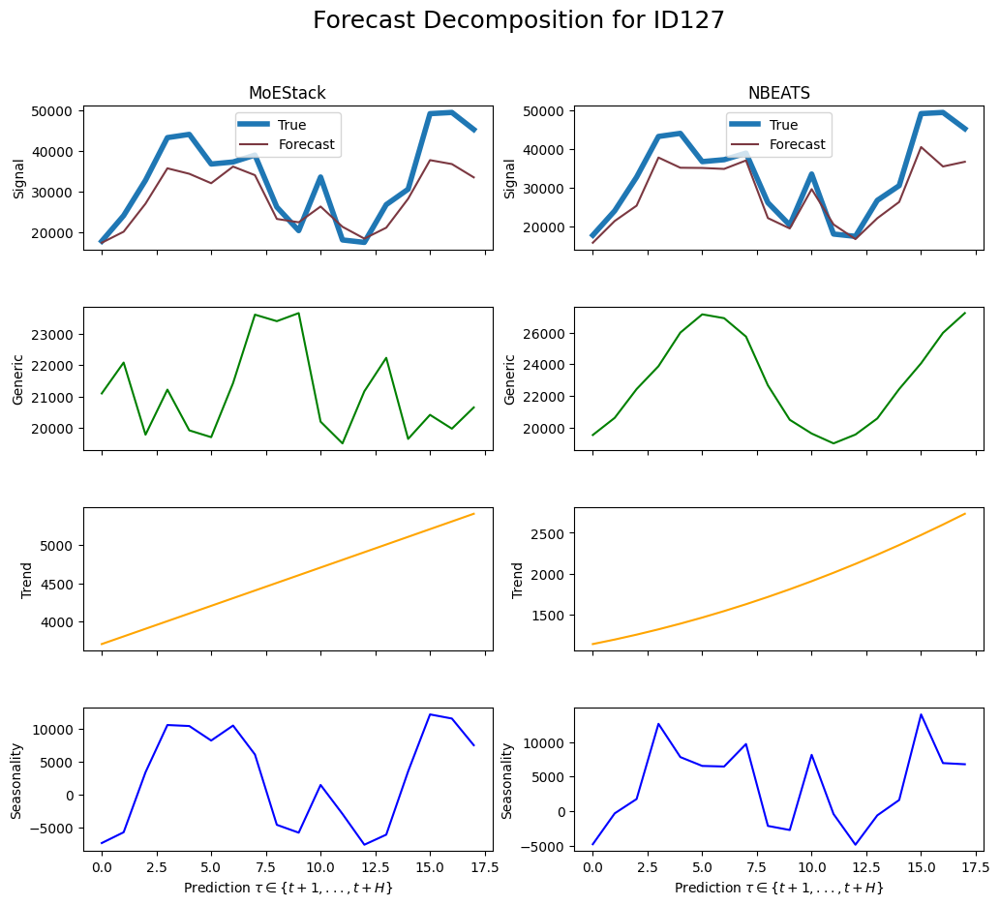

    unique_id         ds        y
576     ID127 2004-02-29  17800.0
577     ID127 2004-03-31  24100.0
578     ID127 2004-04-30  32800.0
579     ID127 2004-05-31  43300.0
580     ID127 2004-06-30  44100.0
581     ID127 2004-07-31  36800.0
582     ID127 2004-08-31  37300.0
583     ID127 2004-09-30  39000.0
584     ID127 2004-10-31  26200.0
585     ID127 2004-11-30  20400.0
586     ID127 2004-12-31  33600.0
587     ID127 2005-01-31  18100.0
588     ID127 2005-02-28  17500.0
589     ID127 2005-03-31  26800.0
590     ID127 2005-04-30  30600.0
591     ID127 2005-05-31  49200.0
592     ID127 2005-06-30  49500.0
593     ID127 2005-07-31  45300.0
Gate values for ID128: [0.24565664 0.32791397 0.42642942]
sMAPE for MoEStack: 0.3902885283327608
sMAPE for NBEATS: 0.3770591962265821


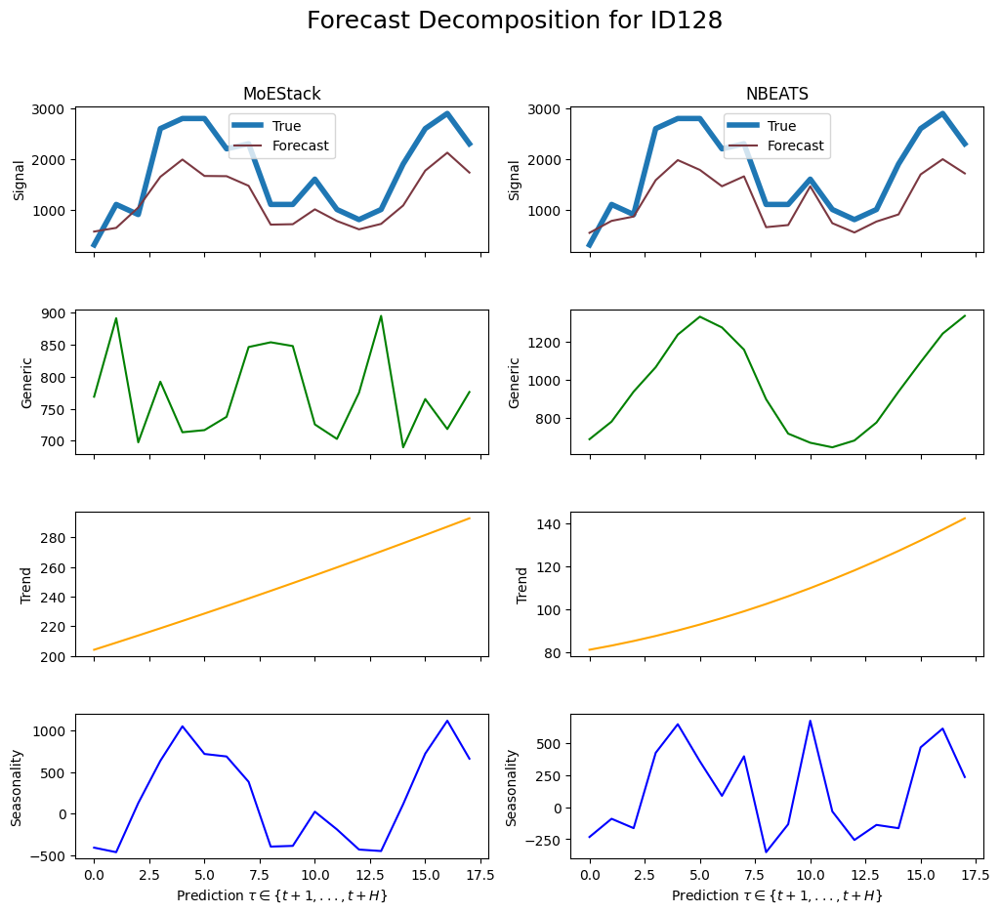

    unique_id         ds       y
594     ID128 2004-02-29   300.0
595     ID128 2004-03-31  1100.0
596     ID128 2004-04-30   900.0
597     ID128 2004-05-31  2600.0
598     ID128 2004-06-30  2800.0
599     ID128 2004-07-31  2800.0
600     ID128 2004-08-31  2200.0
601     ID128 2004-09-30  2300.0
602     ID128 2004-10-31  1100.0
603     ID128 2004-11-30  1100.0
604     ID128 2004-12-31  1600.0
605     ID128 2005-01-31  1000.0
606     ID128 2005-02-28   800.0
607     ID128 2005-03-31  1000.0
608     ID128 2005-04-30  1900.0
609     ID128 2005-05-31  2600.0
610     ID128 2005-06-30  2900.0
611     ID128 2005-07-31  2300.0
Gate values for ID129: [0.23170288 0.3329585  0.43533865]
sMAPE for MoEStack: 0.1734504317130022
sMAPE for NBEATS: 0.1546601957534673


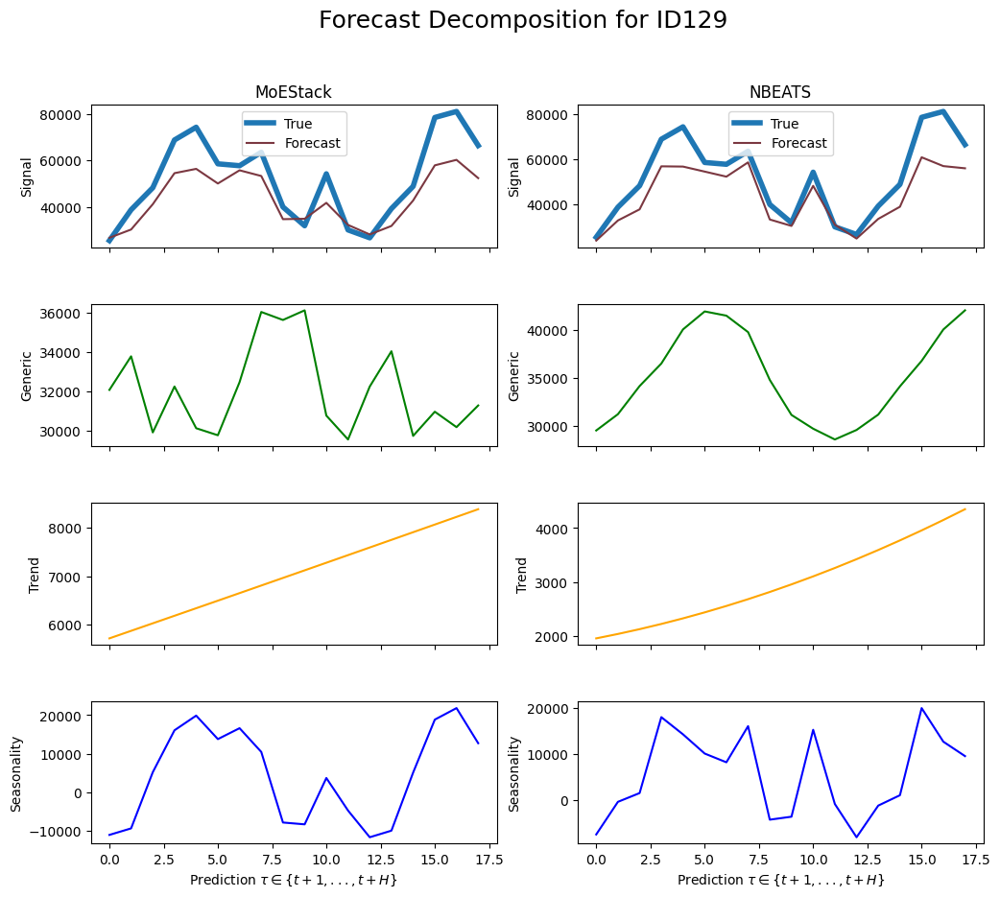

    unique_id         ds        y
612     ID129 2004-02-29  25400.0
613     ID129 2004-03-31  38700.0
614     ID129 2004-04-30  48200.0
615     ID129 2004-05-31  68800.0
616     ID129 2004-06-30  74300.0
617     ID129 2004-07-31  58500.0
618     ID129 2004-08-31  57700.0
619     ID129 2004-09-30  63500.0
620     ID129 2004-10-31  39900.0
621     ID129 2004-11-30  31800.0
622     ID129 2004-12-31  54200.0
623     ID129 2005-01-31  30000.0
624     ID129 2005-02-28  26600.0
625     ID129 2005-03-31  39200.0
626     ID129 2005-04-30  48800.0
627     ID129 2005-05-31  78500.0
628     ID129 2005-06-30  81100.0
629     ID129 2005-07-31  66400.0
Gate values for ID13: [0.31510654 0.20611505 0.4787784 ]
sMAPE for MoEStack: 0.43000464180977427
sMAPE for NBEATS: 0.5847329595515685


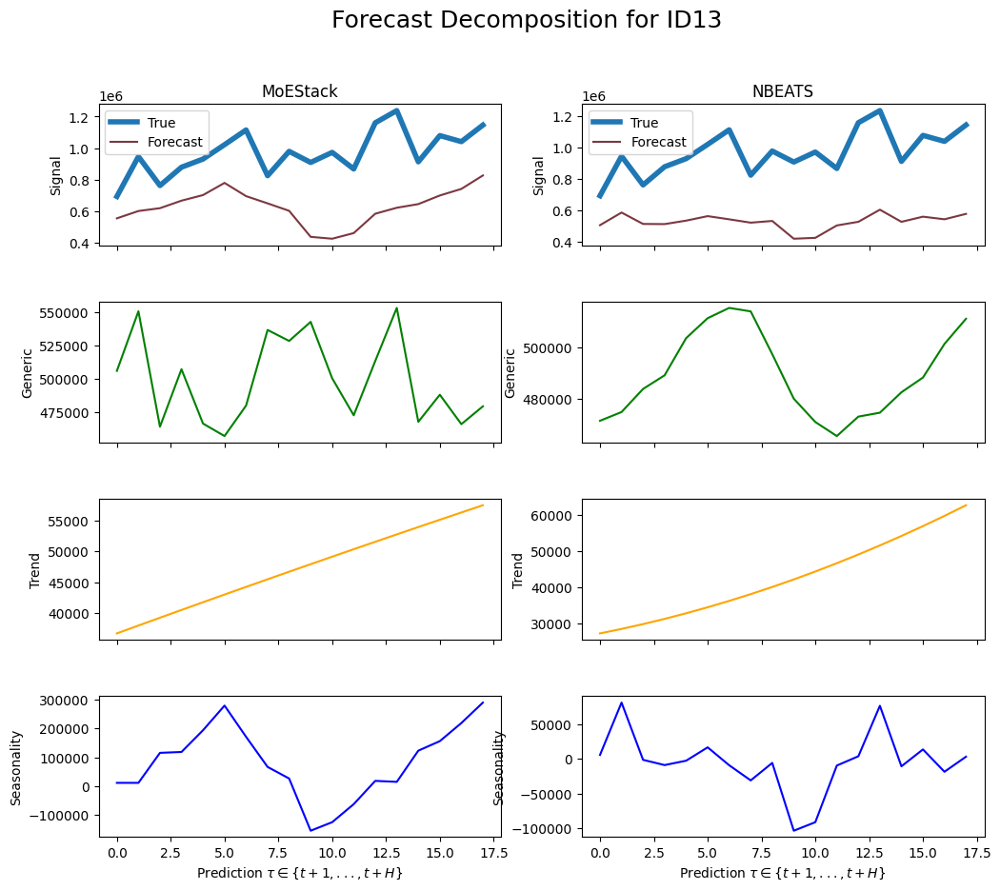

    unique_id         ds          y
630      ID13 2003-07-31   693008.0
631      ID13 2003-08-31   946122.0
632      ID13 2003-09-30   762001.0
633      ID13 2003-10-31   878581.0
634      ID13 2003-11-30   930432.0
635      ID13 2003-12-31  1021707.0
636      ID13 2004-01-31  1115151.0
637      ID13 2004-02-29   824619.0
638      ID13 2004-03-31   979338.0
639      ID13 2004-04-30   908741.0
640      ID13 2004-05-31   972837.0
641      ID13 2004-06-30   867445.0
642      ID13 2004-07-31  1160530.0
643      ID13 2004-08-31  1238091.0
644      ID13 2004-09-30   912723.0
645      ID13 2004-10-31  1079392.0
646      ID13 2004-11-30  1040982.0
647      ID13 2004-12-31  1146013.0
Gate values for ID130: [0.22318687 0.29008228 0.48673087]
sMAPE for MoEStack: 0.20685254766512098
sMAPE for NBEATS: 0.1904456888248304


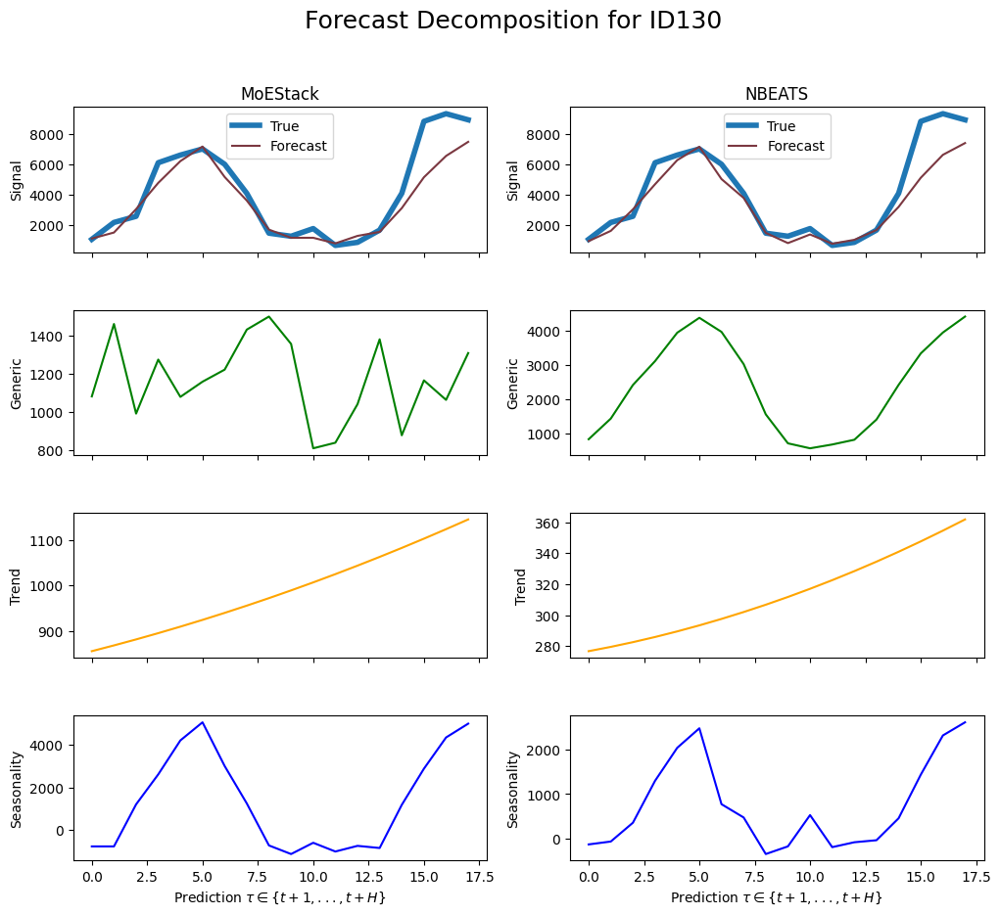

    unique_id         ds       y
648     ID130 2004-02-29  1100.0
649     ID130 2004-03-31  2200.0
650     ID130 2004-04-30  2600.0
651     ID130 2004-05-31  6100.0
652     ID130 2004-06-30  6600.0
653     ID130 2004-07-31  7000.0
654     ID130 2004-08-31  6000.0
655     ID130 2004-09-30  4100.0
656     ID130 2004-10-31  1500.0
657     ID130 2004-11-30  1300.0
658     ID130 2004-12-31  1800.0
659     ID130 2005-01-31   700.0
660     ID130 2005-02-28   900.0
661     ID130 2005-03-31  1700.0
662     ID130 2005-04-30  4100.0
663     ID130 2005-05-31  8800.0
664     ID130 2005-06-30  9300.0
665     ID130 2005-07-31  8900.0
Gate values for ID131: [0.24415003 0.35028872 0.4055612 ]
sMAPE for MoEStack: 0.24226919988553774
sMAPE for NBEATS: 0.20640431476076615


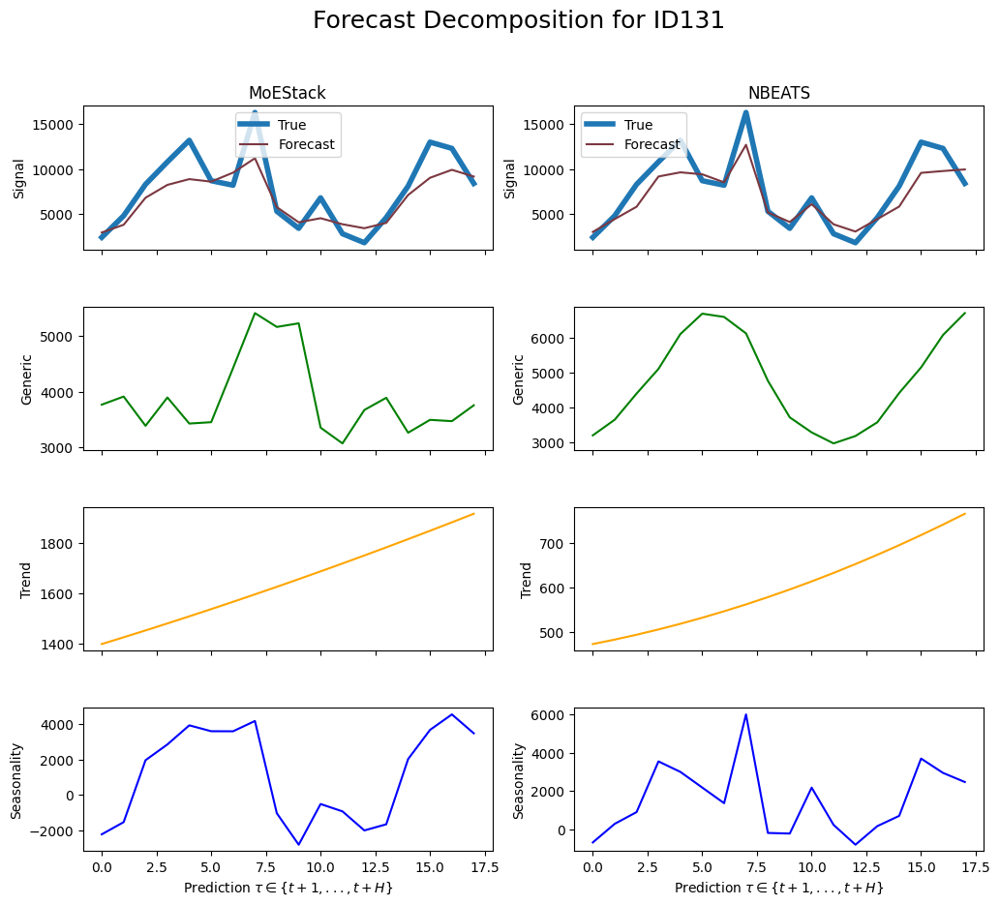

    unique_id         ds        y
666     ID131 2004-02-29   2400.0
667     ID131 2004-03-31   4800.0
668     ID131 2004-04-30   8300.0
669     ID131 2004-05-31  10800.0
670     ID131 2004-06-30  13200.0
671     ID131 2004-07-31   8700.0
672     ID131 2004-08-31   8200.0
673     ID131 2004-09-30  16300.0
674     ID131 2004-10-31   5300.0
675     ID131 2004-11-30   3400.0
676     ID131 2004-12-31   6800.0
677     ID131 2005-01-31   2800.0
678     ID131 2005-02-28   1800.0
679     ID131 2005-03-31   4600.0
680     ID131 2005-04-30   8100.0
681     ID131 2005-05-31  13000.0
682     ID131 2005-06-30  12300.0
683     ID131 2005-07-31   8400.0
Gate values for ID132: [0.25992972 0.27536318 0.46470708]
sMAPE for MoEStack: 0.30912211240343157
sMAPE for NBEATS: 0.2969184330095942


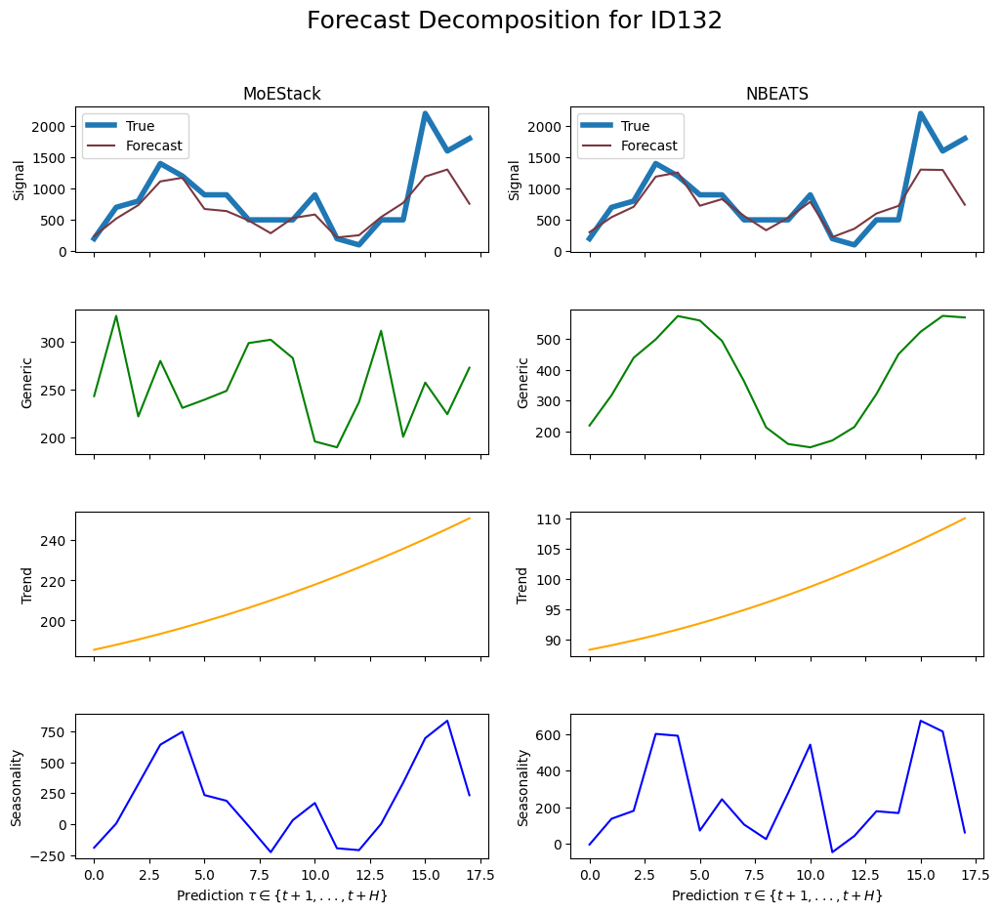

    unique_id         ds       y
684     ID132 2004-02-29   200.0
685     ID132 2004-03-31   700.0
686     ID132 2004-04-30   800.0
687     ID132 2004-05-31  1400.0
688     ID132 2004-06-30  1200.0
689     ID132 2004-07-31   900.0
690     ID132 2004-08-31   900.0
691     ID132 2004-09-30   500.0
692     ID132 2004-10-31   500.0
693     ID132 2004-11-30   500.0
694     ID132 2004-12-31   900.0
695     ID132 2005-01-31   200.0
696     ID132 2005-02-28   100.0
697     ID132 2005-03-31   500.0
698     ID132 2005-04-30   500.0
699     ID132 2005-05-31  2200.0
700     ID132 2005-06-30  1600.0
701     ID132 2005-07-31  1800.0
Gate values for ID133: [0.18688656 0.38552713 0.42758632]
sMAPE for MoEStack: 0.39224931550119674
sMAPE for NBEATS: 0.36843845019156657


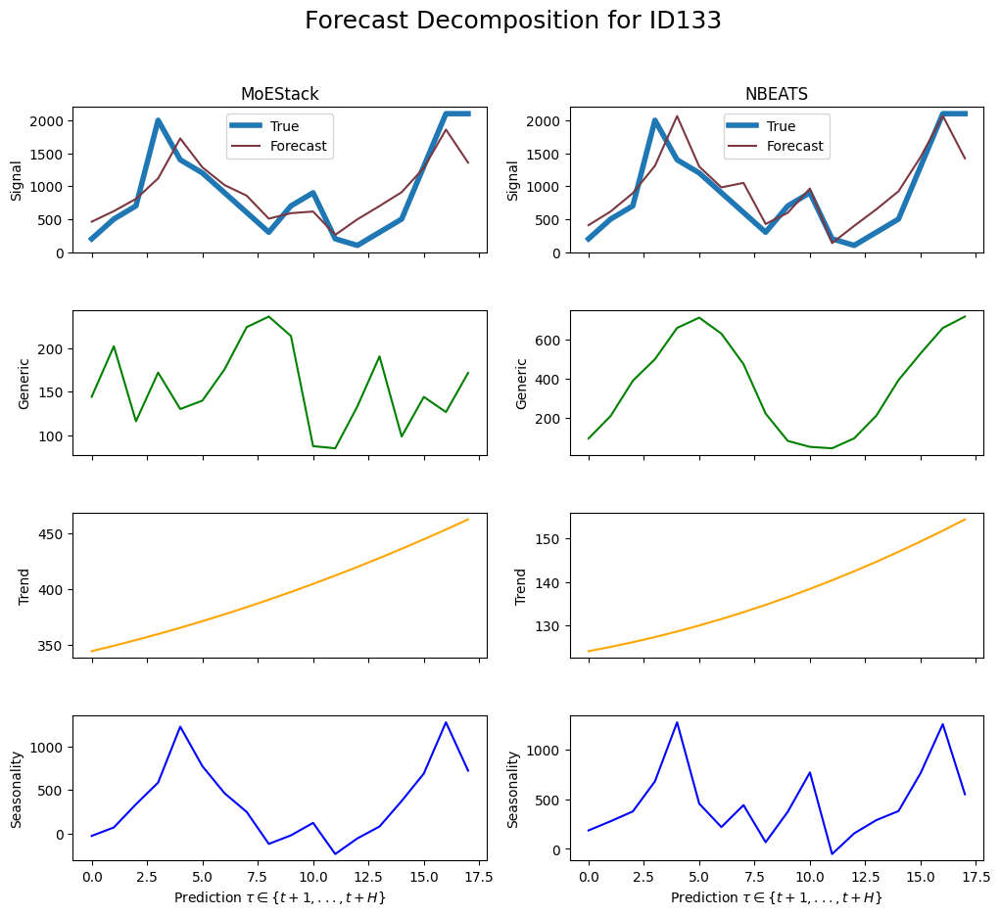

    unique_id         ds       y
702     ID133 2004-02-29   200.0
703     ID133 2004-03-31   500.0
704     ID133 2004-04-30   700.0
705     ID133 2004-05-31  2000.0
706     ID133 2004-06-30  1400.0
707     ID133 2004-07-31  1200.0
708     ID133 2004-08-31   900.0
709     ID133 2004-09-30   600.0
710     ID133 2004-10-31   300.0
711     ID133 2004-11-30   700.0
712     ID133 2004-12-31   900.0
713     ID133 2005-01-31   200.0
714     ID133 2005-02-28   100.0
715     ID133 2005-03-31   300.0
716     ID133 2005-04-30   500.0
717     ID133 2005-05-31  1300.0
718     ID133 2005-06-30  2100.0
719     ID133 2005-07-31  2100.0
Gate values for ID134: [0.3012577  0.36869887 0.3300434 ]
sMAPE for MoEStack: 0.23015021985654519
sMAPE for NBEATS: 0.23116302570859626


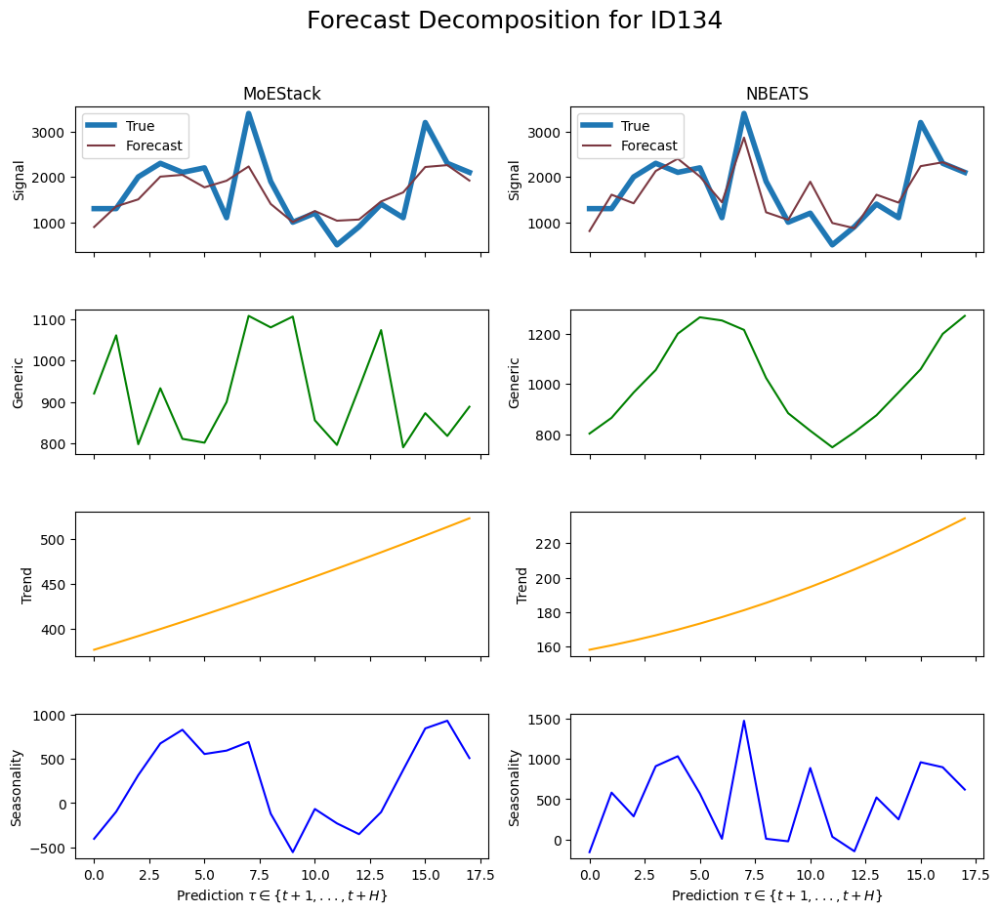

    unique_id         ds       y
720     ID134 2004-02-29  1300.0
721     ID134 2004-03-31  1300.0
722     ID134 2004-04-30  2000.0
723     ID134 2004-05-31  2300.0
724     ID134 2004-06-30  2100.0
725     ID134 2004-07-31  2200.0
726     ID134 2004-08-31  1100.0
727     ID134 2004-09-30  3400.0
728     ID134 2004-10-31  1900.0
729     ID134 2004-11-30  1000.0
730     ID134 2004-12-31  1200.0
731     ID134 2005-01-31   500.0
732     ID134 2005-02-28   900.0
733     ID134 2005-03-31  1400.0
734     ID134 2005-04-30  1100.0
735     ID134 2005-05-31  3200.0
736     ID134 2005-06-30  2300.0
737     ID134 2005-07-31  2100.0
Gate values for ID135: [0.22370377 0.2854495  0.49084666]
sMAPE for MoEStack: 0.18825921811871935
sMAPE for NBEATS: 0.20178650374782472


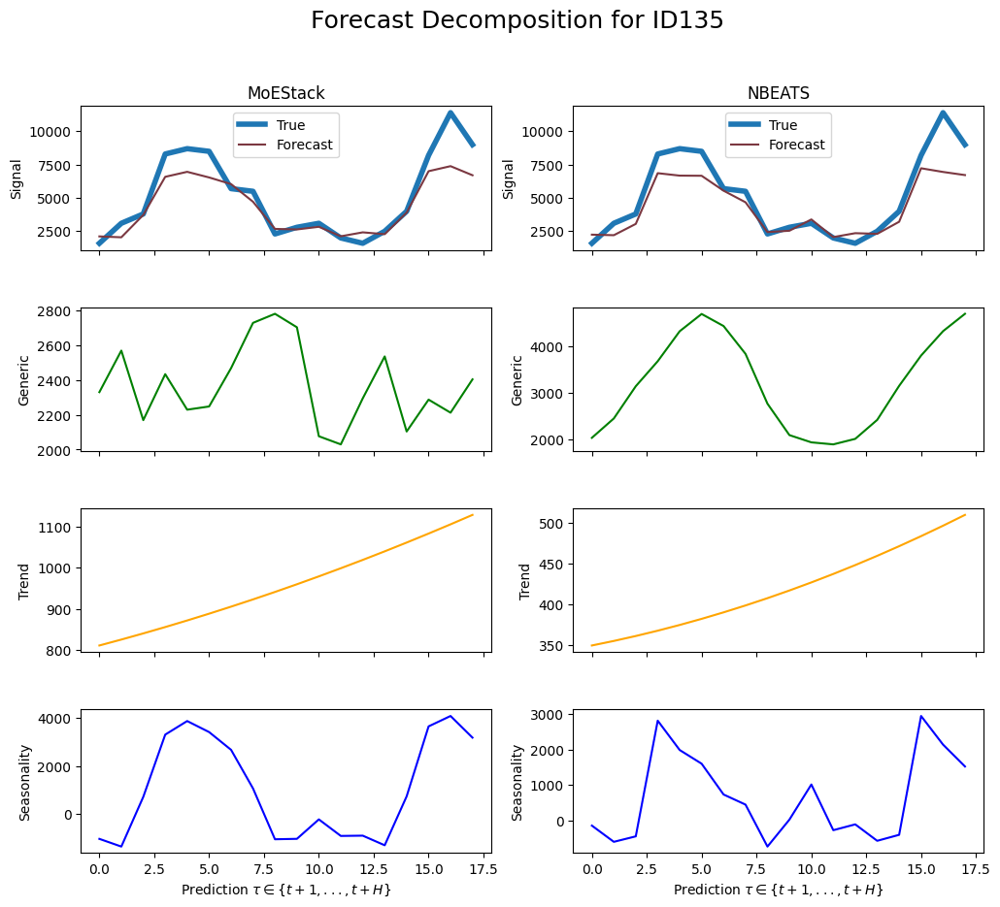

    unique_id         ds        y
738     ID135 2004-02-29   1600.0
739     ID135 2004-03-31   3100.0
740     ID135 2004-04-30   3800.0
741     ID135 2004-05-31   8300.0
742     ID135 2004-06-30   8700.0
743     ID135 2004-07-31   8500.0
744     ID135 2004-08-31   5700.0
745     ID135 2004-09-30   5500.0
746     ID135 2004-10-31   2300.0
747     ID135 2004-11-30   2800.0
748     ID135 2004-12-31   3100.0
749     ID135 2005-01-31   2000.0
750     ID135 2005-02-28   1600.0
751     ID135 2005-03-31   2500.0
752     ID135 2005-04-30   4000.0
753     ID135 2005-05-31   8200.0
754     ID135 2005-06-30  11400.0
755     ID135 2005-07-31   9000.0
Gate values for ID136: [0.23335728 0.32466865 0.44197407]
sMAPE for MoEStack: 0.19070099623575668
sMAPE for NBEATS: 0.14667972488254463


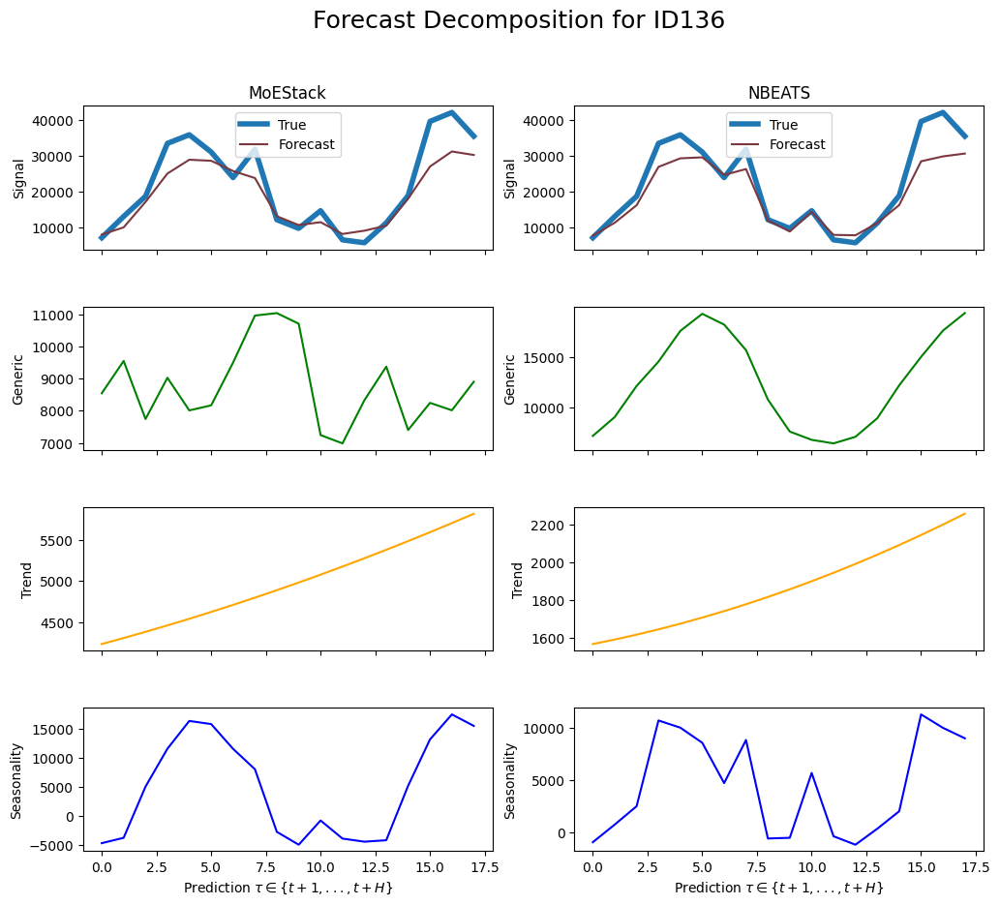

    unique_id         ds        y
756     ID136 2004-02-29   7200.0
757     ID136 2004-03-31  13100.0
758     ID136 2004-04-30  18700.0
759     ID136 2004-05-31  33400.0
760     ID136 2004-06-30  35800.0
761     ID136 2004-07-31  31000.0
762     ID136 2004-08-31  23900.0
763     ID136 2004-09-30  31800.0
764     ID136 2004-10-31  12200.0
765     ID136 2004-11-30   9800.0
766     ID136 2004-12-31  14700.0
767     ID136 2005-01-31   6600.0
768     ID136 2005-02-28   5800.0
769     ID136 2005-03-31  11300.0
770     ID136 2005-04-30  18900.0
771     ID136 2005-05-31  39500.0
772     ID136 2005-06-30  42000.0
773     ID136 2005-07-31  35400.0
Gate values for ID137: [0.25632757 0.25631633 0.4873561 ]
sMAPE for MoEStack: 0.3179379284967136
sMAPE for NBEATS: 0.3286249719795801


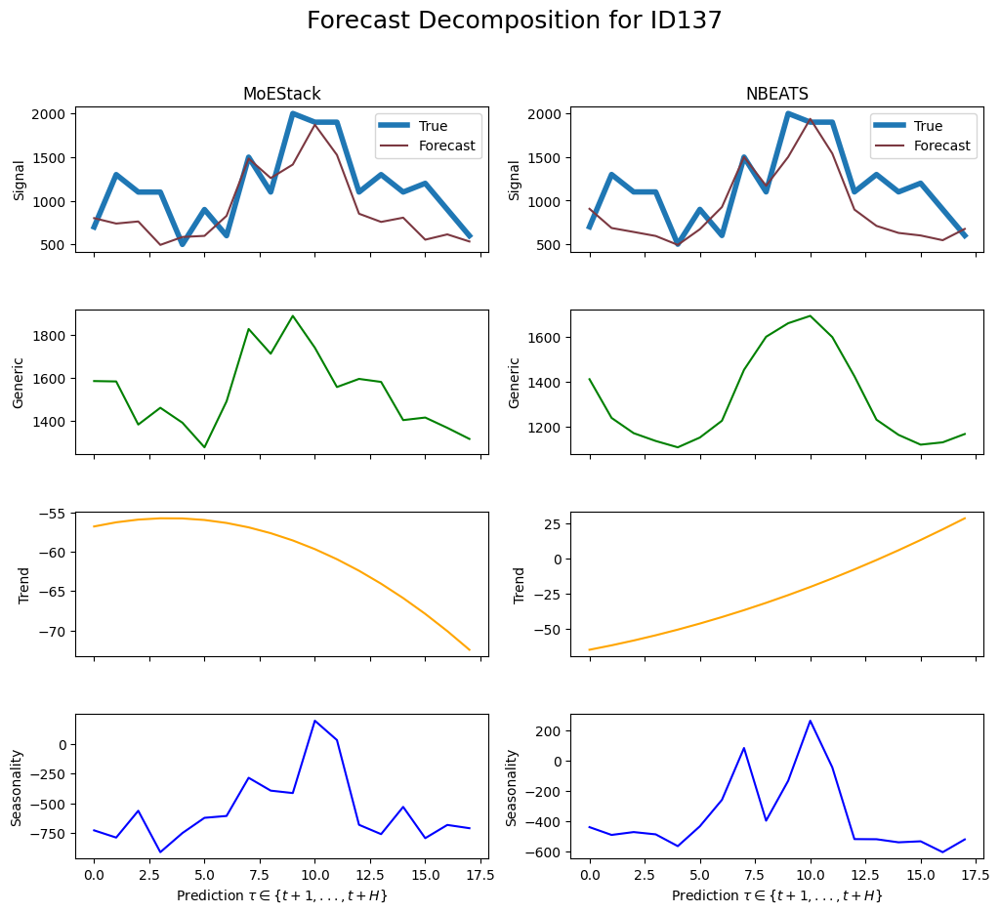

    unique_id         ds       y
774     ID137 2004-02-29   700.0
775     ID137 2004-03-31  1300.0
776     ID137 2004-04-30  1100.0
777     ID137 2004-05-31  1100.0
778     ID137 2004-06-30   500.0
779     ID137 2004-07-31   900.0
780     ID137 2004-08-31   600.0
781     ID137 2004-09-30  1500.0
782     ID137 2004-10-31  1100.0
783     ID137 2004-11-30  2000.0
784     ID137 2004-12-31  1900.0
785     ID137 2005-01-31  1900.0
786     ID137 2005-02-28  1100.0
787     ID137 2005-03-31  1300.0
788     ID137 2005-04-30  1100.0
789     ID137 2005-05-31  1200.0
790     ID137 2005-06-30   900.0
791     ID137 2005-07-31   600.0
Gate values for ID138: [0.21367067 0.23437989 0.55194944]
sMAPE for MoEStack: 0.2852333667558765
sMAPE for NBEATS: 0.3467827909806668


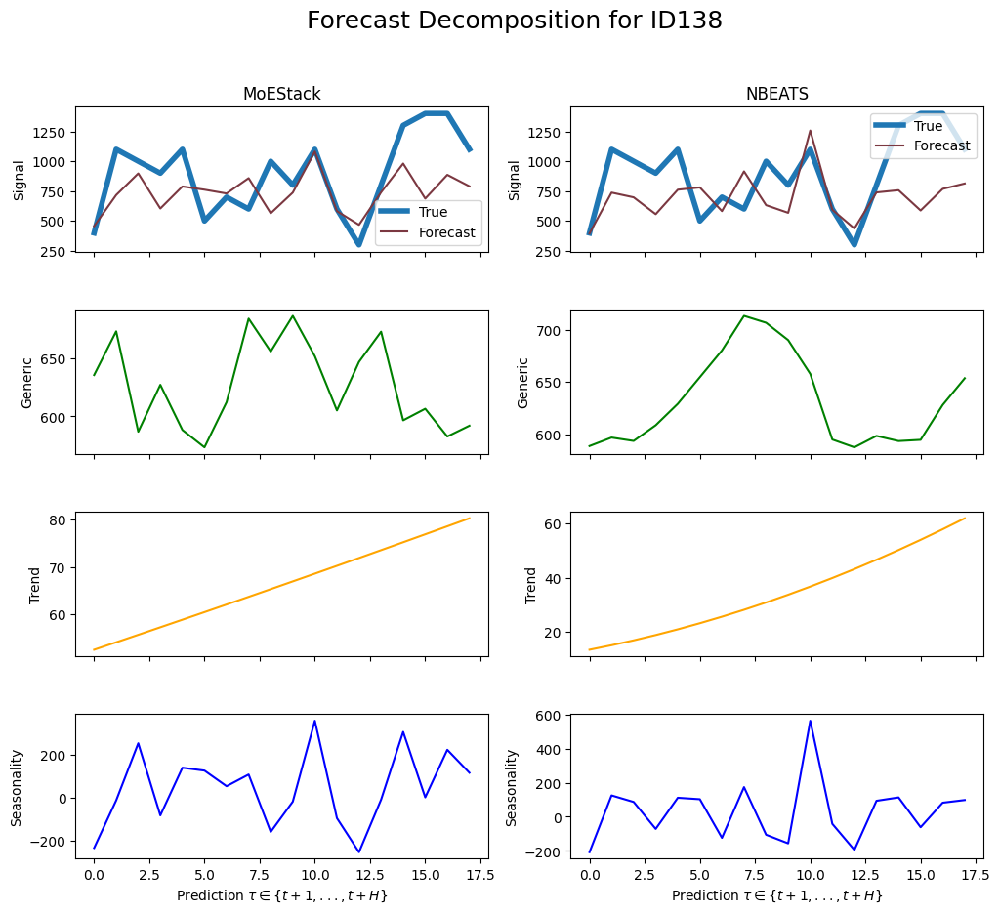

    unique_id         ds       y
792     ID138 2004-02-29   400.0
793     ID138 2004-03-31  1100.0
794     ID138 2004-04-30  1000.0
795     ID138 2004-05-31   900.0
796     ID138 2004-06-30  1100.0
797     ID138 2004-07-31   500.0
798     ID138 2004-08-31   700.0
799     ID138 2004-09-30   600.0
800     ID138 2004-10-31  1000.0
801     ID138 2004-11-30   800.0
802     ID138 2004-12-31  1100.0
803     ID138 2005-01-31   600.0
804     ID138 2005-02-28   300.0
805     ID138 2005-03-31   800.0
806     ID138 2005-04-30  1300.0
807     ID138 2005-05-31  1400.0
808     ID138 2005-06-30  1400.0
809     ID138 2005-07-31  1100.0
Gate values for ID139: [0.24221759 0.29292494 0.46485752]
sMAPE for MoEStack: 0.2733105383495069
sMAPE for NBEATS: 0.30013361028847324


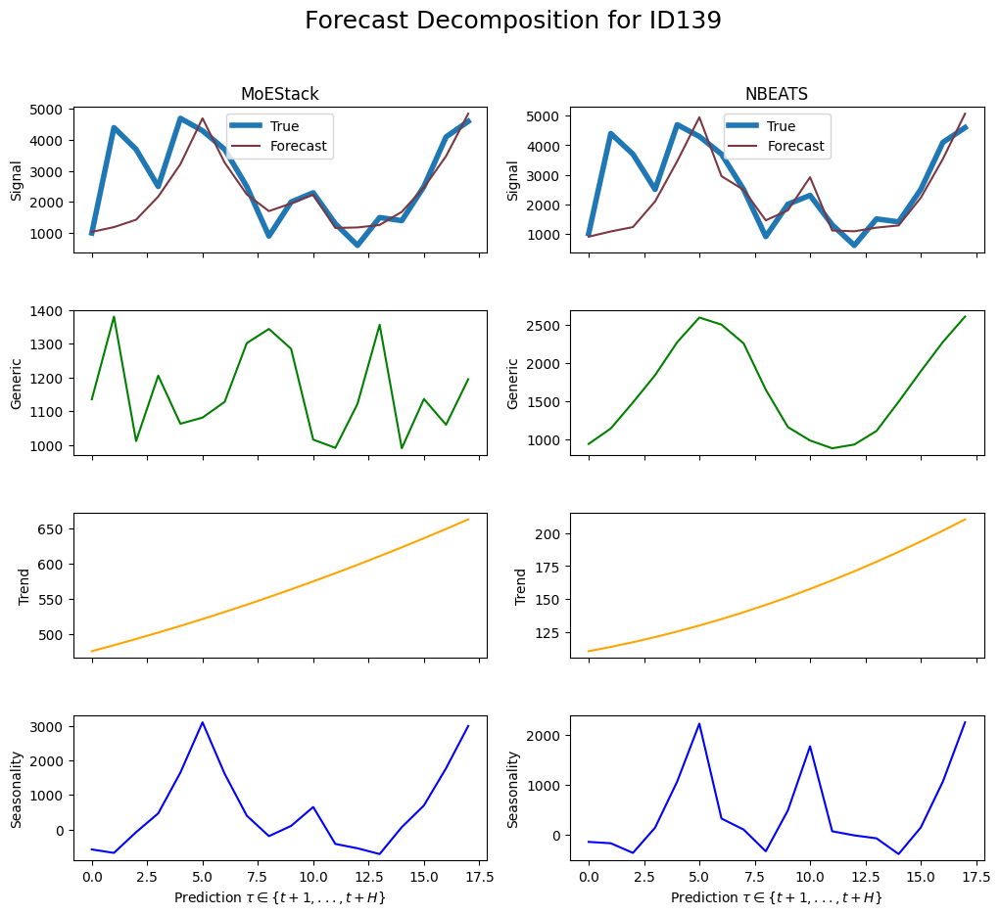

    unique_id         ds       y
810     ID139 2004-02-29  1000.0
811     ID139 2004-03-31  4400.0
812     ID139 2004-04-30  3700.0
813     ID139 2004-05-31  2500.0
814     ID139 2004-06-30  4700.0
815     ID139 2004-07-31  4300.0
816     ID139 2004-08-31  3700.0
817     ID139 2004-09-30  2500.0
818     ID139 2004-10-31   900.0
819     ID139 2004-11-30  2000.0
820     ID139 2004-12-31  2300.0
821     ID139 2005-01-31  1300.0
822     ID139 2005-02-28   600.0
823     ID139 2005-03-31  1500.0
824     ID139 2005-04-30  1400.0
825     ID139 2005-05-31  2500.0
826     ID139 2005-06-30  4100.0
827     ID139 2005-07-31  4600.0
Gate values for ID14: [0.35862514 0.3022614  0.33911347]
sMAPE for MoEStack: 0.4889706654652597
sMAPE for NBEATS: 0.6650895655661986


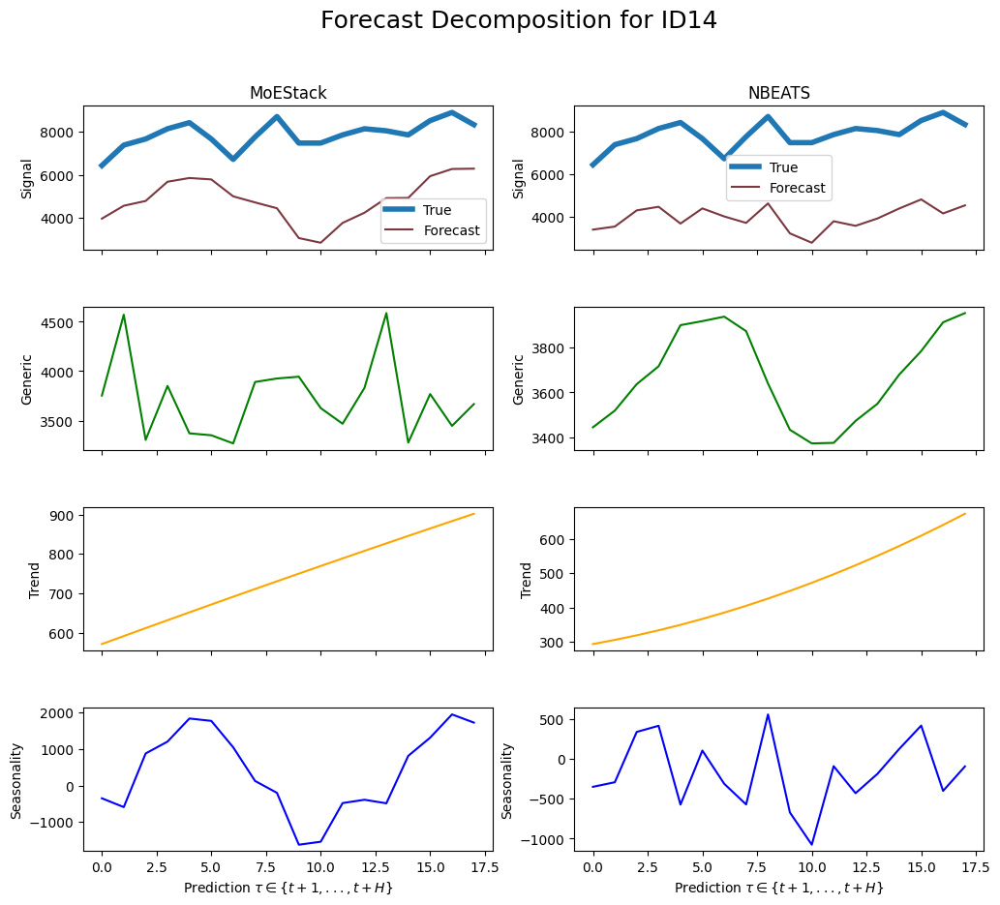

    unique_id         ds            y
828      ID14 2003-07-31  6441.640137
829      ID14 2003-08-31  7388.939941
830      ID14 2003-09-30  7673.129883
831      ID14 2003-10-31  8146.779785
832      ID14 2003-11-30  8430.969727
833      ID14 2003-12-31  7673.129883
834      ID14 2004-01-31  6725.830078
835      ID14 2004-02-29  7767.859863
836      ID14 2004-03-31  8715.160156
837      ID14 2004-04-30  7483.669922
838      ID14 2004-05-31  7483.669922
839      ID14 2004-06-30  7862.589844
840      ID14 2004-07-31  8146.779785
841      ID14 2004-08-31  8052.049805
842      ID14 2004-09-30  7862.589844
843      ID14 2004-10-31  8525.700195
844      ID14 2004-11-30  8904.620117
845      ID14 2004-12-31  8336.240234
Gate values for ID140: [0.26221743 0.2583121  0.4794704 ]
sMAPE for MoEStack: 0.38478669267224513
sMAPE for NBEATS: 0.3283223123452302


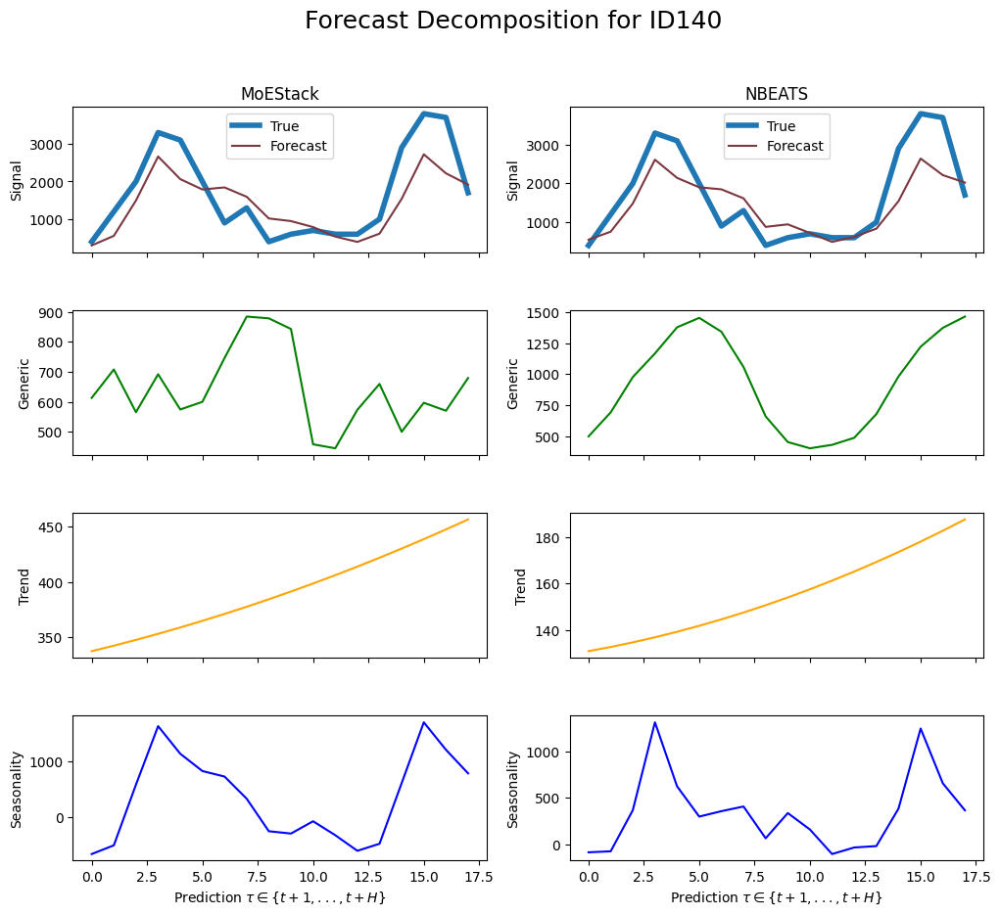

    unique_id         ds       y
846     ID140 2004-02-29   400.0
847     ID140 2004-03-31  1200.0
848     ID140 2004-04-30  2000.0
849     ID140 2004-05-31  3300.0
850     ID140 2004-06-30  3100.0
851     ID140 2004-07-31  2000.0
852     ID140 2004-08-31   900.0
853     ID140 2004-09-30  1300.0
854     ID140 2004-10-31   400.0
855     ID140 2004-11-30   600.0
856     ID140 2004-12-31   700.0
857     ID140 2005-01-31   600.0
858     ID140 2005-02-28   600.0
859     ID140 2005-03-31  1000.0
860     ID140 2005-04-30  2900.0
861     ID140 2005-05-31  3800.0
862     ID140 2005-06-30  3700.0
863     ID140 2005-07-31  1700.0
Gate values for ID141: [0.2472883  0.21725896 0.5354528 ]
sMAPE for MoEStack: 0.2575342407642589
sMAPE for NBEATS: 0.2571525497590353


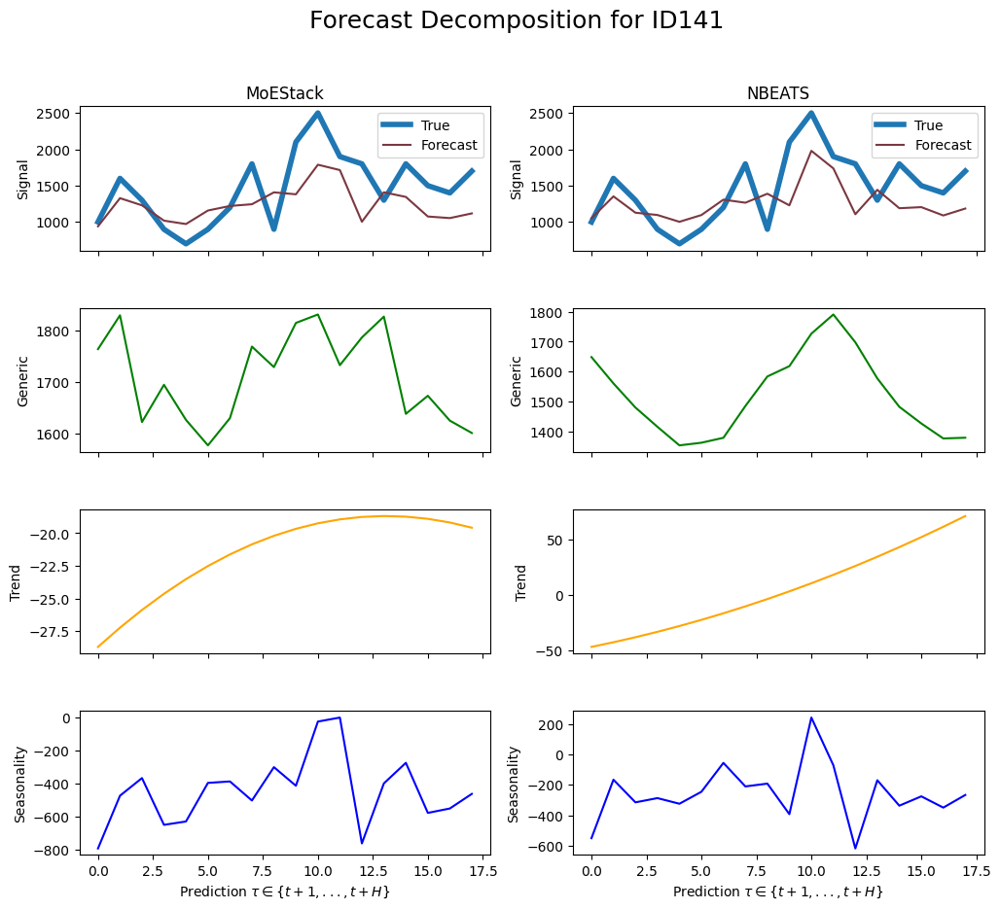

    unique_id         ds       y
864     ID141 2004-02-29  1000.0
865     ID141 2004-03-31  1600.0
866     ID141 2004-04-30  1300.0
867     ID141 2004-05-31   900.0
868     ID141 2004-06-30   700.0
869     ID141 2004-07-31   900.0
870     ID141 2004-08-31  1200.0
871     ID141 2004-09-30  1800.0
872     ID141 2004-10-31   900.0
873     ID141 2004-11-30  2100.0
874     ID141 2004-12-31  2500.0
875     ID141 2005-01-31  1900.0
876     ID141 2005-02-28  1800.0
877     ID141 2005-03-31  1300.0
878     ID141 2005-04-30  1800.0
879     ID141 2005-05-31  1500.0
880     ID141 2005-06-30  1400.0
881     ID141 2005-07-31  1700.0
Gate values for ID142: [0.1628614  0.18567203 0.65146655]
sMAPE for MoEStack: 0.25668217207649596
sMAPE for NBEATS: 0.19946589177899426


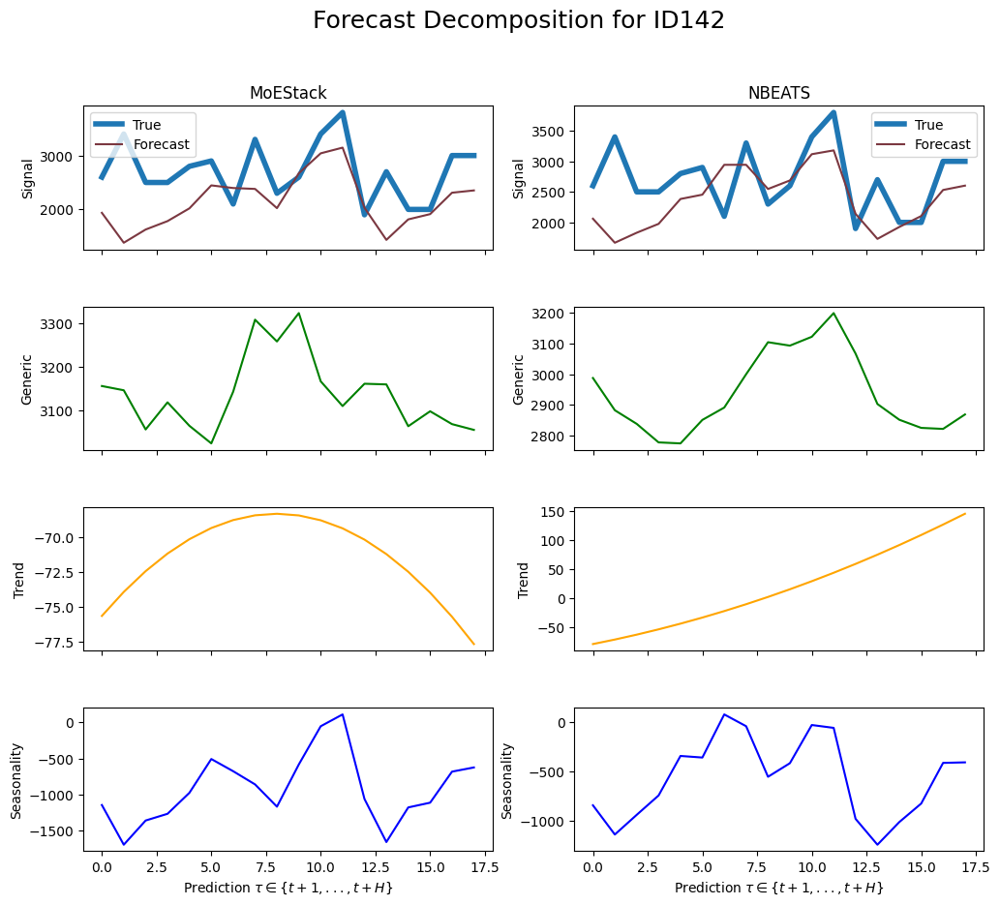

    unique_id         ds       y
882     ID142 2004-02-29  2600.0
883     ID142 2004-03-31  3400.0
884     ID142 2004-04-30  2500.0
885     ID142 2004-05-31  2500.0
886     ID142 2004-06-30  2800.0
887     ID142 2004-07-31  2900.0
888     ID142 2004-08-31  2100.0
889     ID142 2004-09-30  3300.0
890     ID142 2004-10-31  2300.0
891     ID142 2004-11-30  2600.0
892     ID142 2004-12-31  3400.0
893     ID142 2005-01-31  3800.0
894     ID142 2005-02-28  1900.0
895     ID142 2005-03-31  2700.0
896     ID142 2005-04-30  2000.0
897     ID142 2005-05-31  2000.0
898     ID142 2005-06-30  3000.0
899     ID142 2005-07-31  3000.0
Gate values for ID143: [0.19327563 0.22921328 0.5775111 ]
sMAPE for MoEStack: 0.19714686126804892
sMAPE for NBEATS: 0.1999294743055509


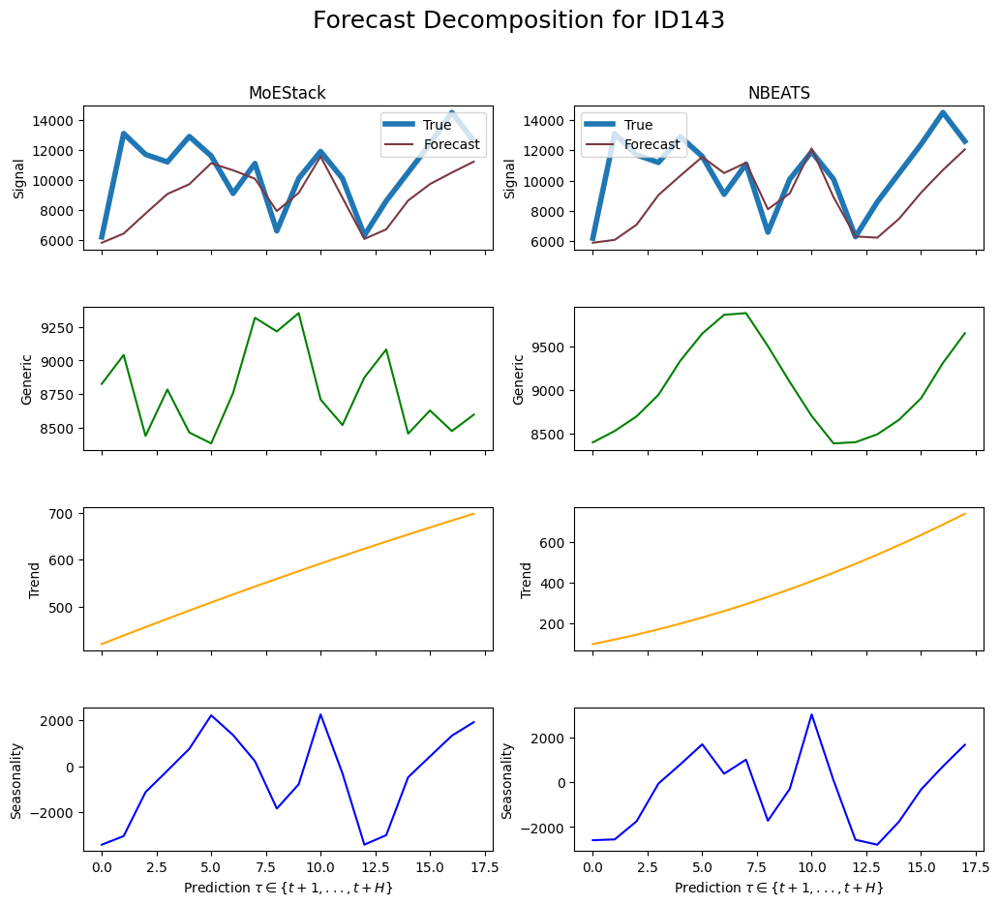

    unique_id         ds        y
900     ID143 2004-02-29   6200.0
901     ID143 2004-03-31  13100.0
902     ID143 2004-04-30  11700.0
903     ID143 2004-05-31  11200.0
904     ID143 2004-06-30  12900.0
905     ID143 2004-07-31  11600.0
906     ID143 2004-08-31   9100.0
907     ID143 2004-09-30  11100.0
908     ID143 2004-10-31   6600.0
909     ID143 2004-11-30  10100.0
910     ID143 2004-12-31  11900.0
911     ID143 2005-01-31  10100.0
912     ID143 2005-02-28   6300.0
913     ID143 2005-03-31   8600.0
914     ID143 2005-04-30  10500.0
915     ID143 2005-05-31  12400.0
916     ID143 2005-06-30  14500.0
917     ID143 2005-07-31  12600.0
Gate values for ID144: [0.30570152 0.3401981  0.3541004 ]
sMAPE for MoEStack: 0.4547989253628495
sMAPE for NBEATS: 0.47809880249121683


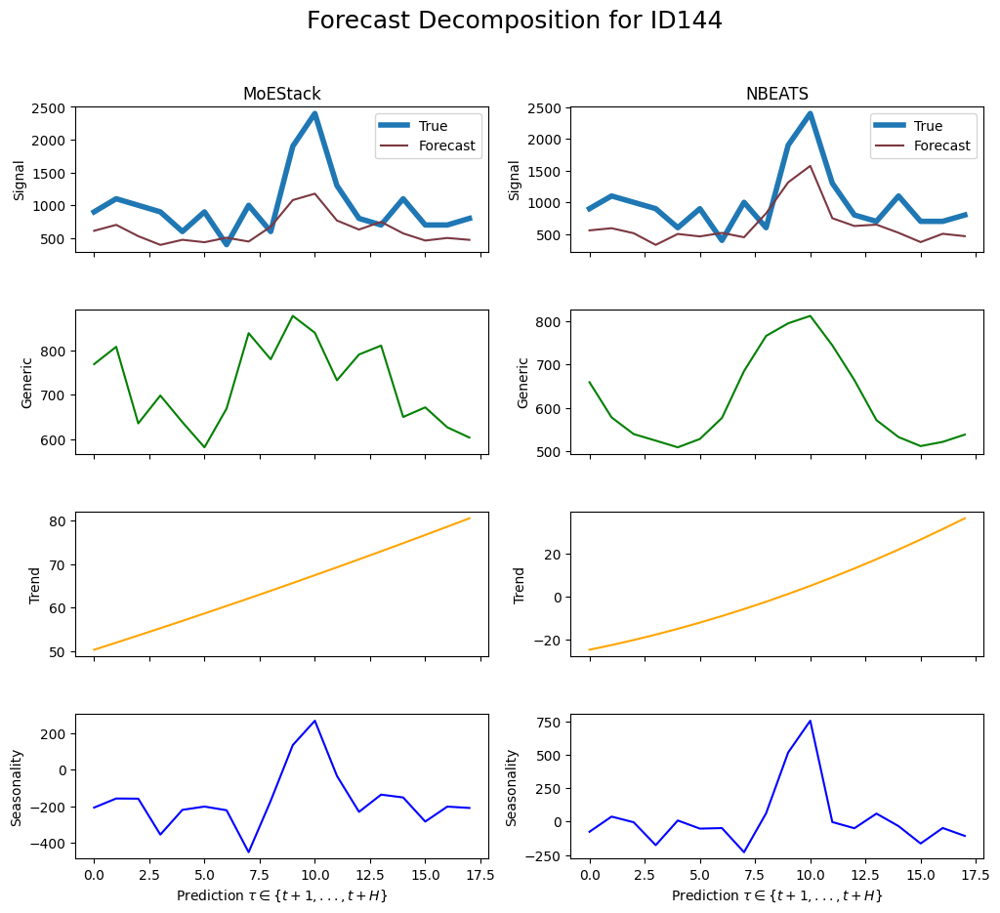

    unique_id         ds       y
918     ID144 2004-02-29   900.0
919     ID144 2004-03-31  1100.0
920     ID144 2004-04-30  1000.0
921     ID144 2004-05-31   900.0
922     ID144 2004-06-30   600.0
923     ID144 2004-07-31   900.0
924     ID144 2004-08-31   400.0
925     ID144 2004-09-30  1000.0
926     ID144 2004-10-31   600.0
927     ID144 2004-11-30  1900.0
928     ID144 2004-12-31  2400.0
929     ID144 2005-01-31  1300.0
930     ID144 2005-02-28   800.0
931     ID144 2005-03-31   700.0
932     ID144 2005-04-30  1100.0
933     ID144 2005-05-31   700.0
934     ID144 2005-06-30   700.0
935     ID144 2005-07-31   800.0
Gate values for ID145: [0.29803216 0.2953671  0.40660077]
sMAPE for MoEStack: 0.3516712020437769
sMAPE for NBEATS: 0.37230012056745765


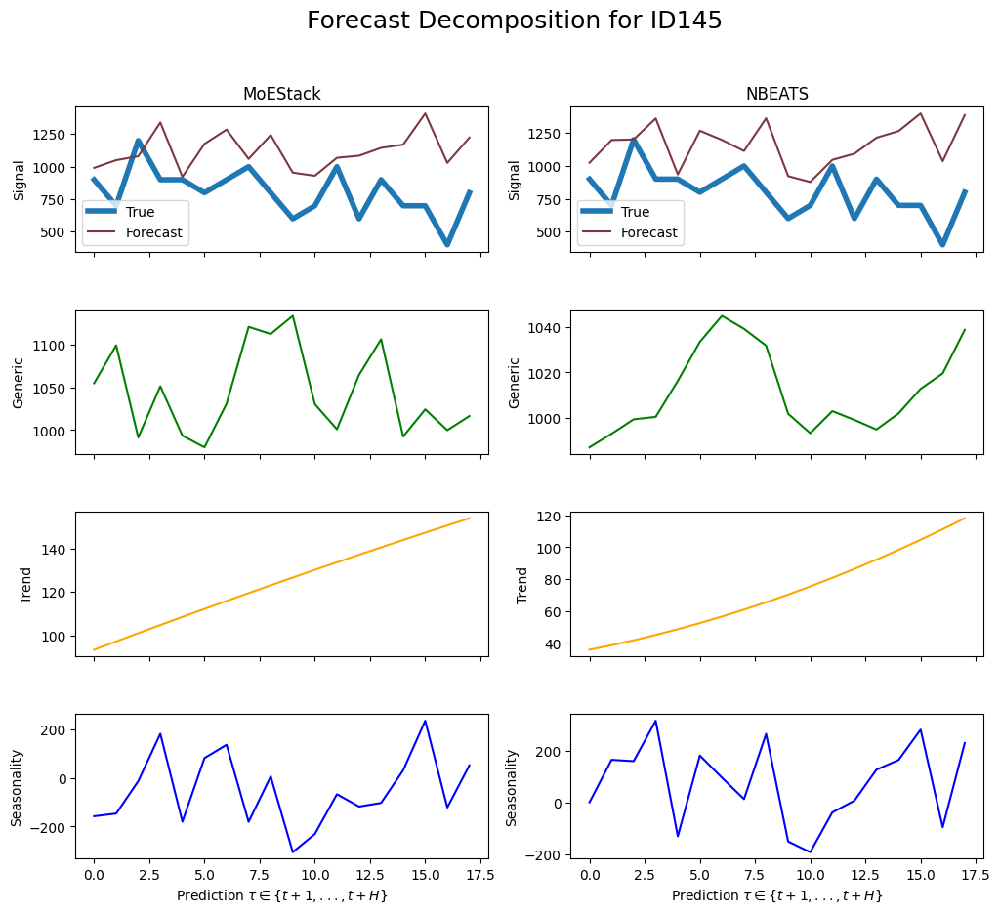

    unique_id         ds       y
936     ID145 2004-02-29   900.0
937     ID145 2004-03-31   700.0
938     ID145 2004-04-30  1200.0
939     ID145 2004-05-31   900.0
940     ID145 2004-06-30   900.0
941     ID145 2004-07-31   800.0
942     ID145 2004-08-31   900.0
943     ID145 2004-09-30  1000.0
944     ID145 2004-10-31   800.0
945     ID145 2004-11-30   600.0
946     ID145 2004-12-31   700.0
947     ID145 2005-01-31  1000.0
948     ID145 2005-02-28   600.0
949     ID145 2005-03-31   900.0
950     ID145 2005-04-30   700.0
951     ID145 2005-05-31   700.0
952     ID145 2005-06-30   400.0
953     ID145 2005-07-31   800.0
Gate values for ID146: [0.18602265 0.25693634 0.557041  ]
sMAPE for MoEStack: 0.2081016078696752
sMAPE for NBEATS: 0.24094076794949157


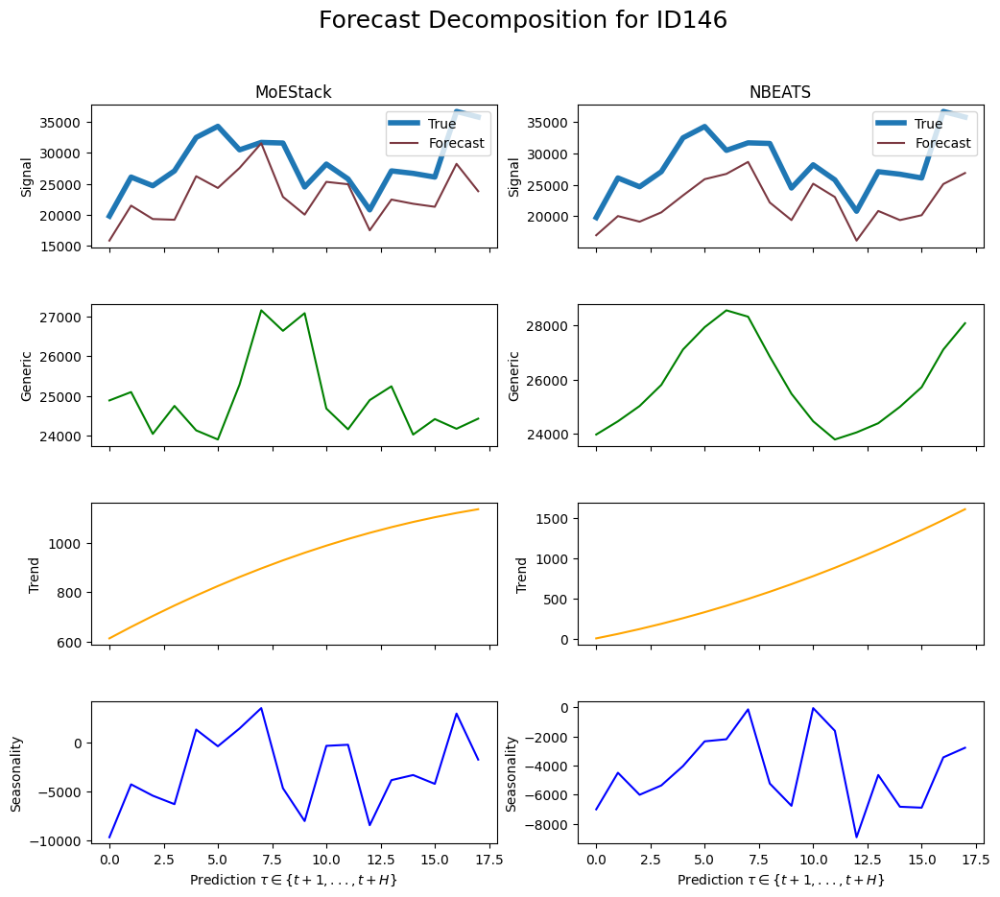

    unique_id         ds        y
954     ID146 2004-02-29  19800.0
955     ID146 2004-03-31  26100.0
956     ID146 2004-04-30  24700.0
957     ID146 2004-05-31  27100.0
958     ID146 2004-06-30  32500.0
959     ID146 2004-07-31  34300.0
960     ID146 2004-08-31  30500.0
961     ID146 2004-09-30  31700.0
962     ID146 2004-10-31  31600.0
963     ID146 2004-11-30  24500.0
964     ID146 2004-12-31  28200.0
965     ID146 2005-01-31  25800.0
966     ID146 2005-02-28  20800.0
967     ID146 2005-03-31  27100.0
968     ID146 2005-04-30  26700.0
969     ID146 2005-05-31  26100.0
970     ID146 2005-06-30  36700.0
971     ID146 2005-07-31  35800.0
Gate values for ID147: [0.25982344 0.21894659 0.52123   ]
sMAPE for MoEStack: 0.24816074256981338
sMAPE for NBEATS: 0.2480380511469564


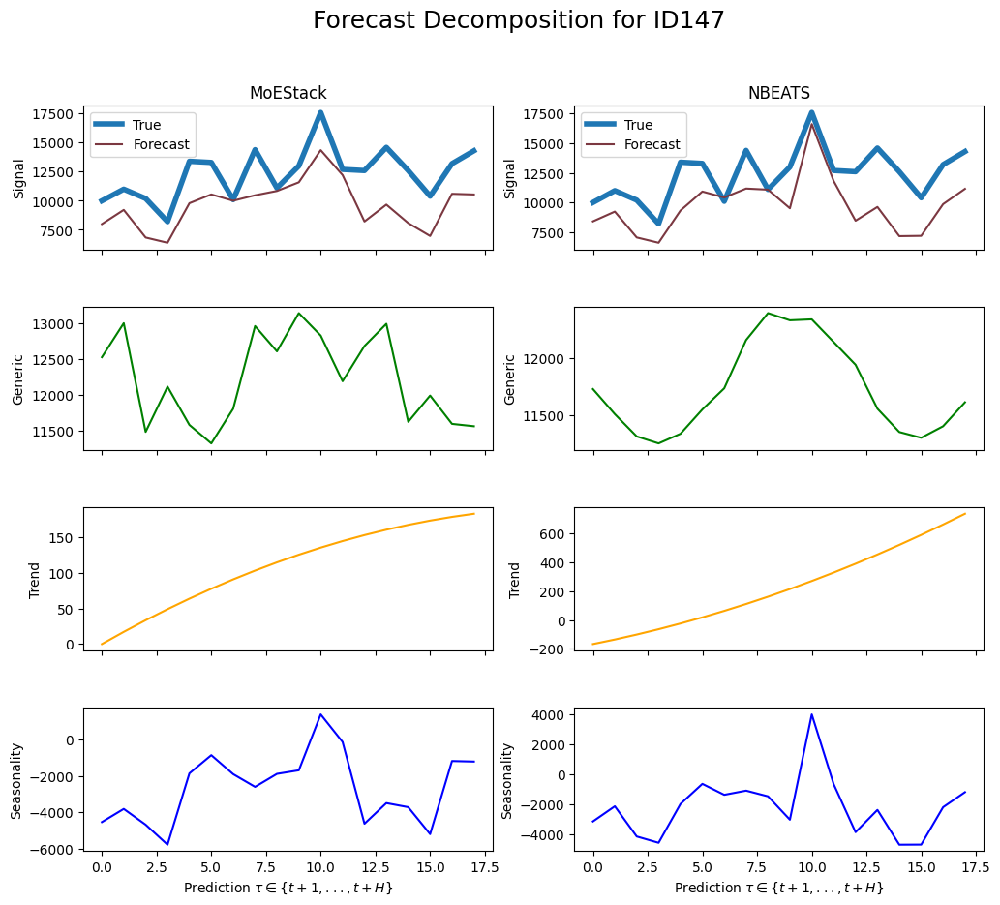

    unique_id         ds        y
972     ID147 2004-02-29  10000.0
973     ID147 2004-03-31  11000.0
974     ID147 2004-04-30  10200.0
975     ID147 2004-05-31   8200.0
976     ID147 2004-06-30  13400.0
977     ID147 2004-07-31  13300.0
978     ID147 2004-08-31  10100.0
979     ID147 2004-09-30  14400.0
980     ID147 2004-10-31  11100.0
981     ID147 2004-11-30  13000.0
982     ID147 2004-12-31  17600.0
983     ID147 2005-01-31  12700.0
984     ID147 2005-02-28  12600.0
985     ID147 2005-03-31  14600.0
986     ID147 2005-04-30  12600.0
987     ID147 2005-05-31  10400.0
988     ID147 2005-06-30  13200.0
989     ID147 2005-07-31  14300.0
Gate values for ID148: [0.25842986 0.23624128 0.50532883]
sMAPE for MoEStack: 0.11517271109718297
sMAPE for NBEATS: 0.11970055585535547


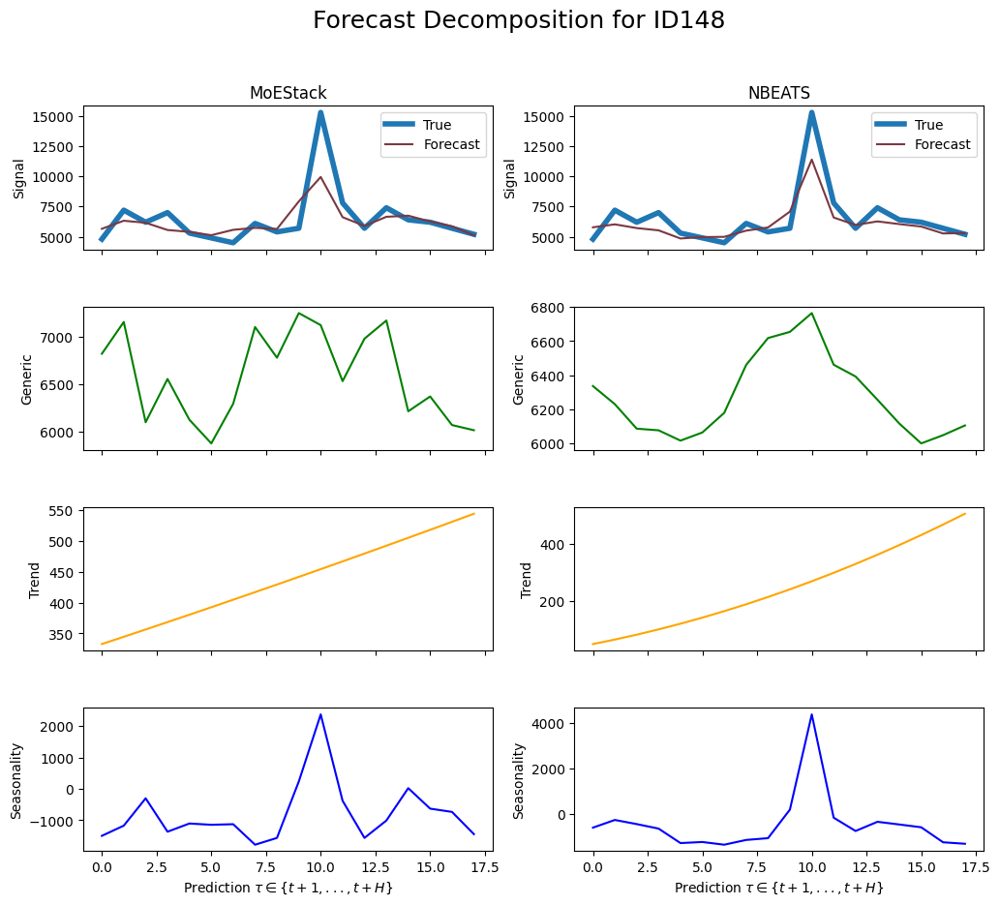

     unique_id         ds        y
990      ID148 2004-02-29   4800.0
991      ID148 2004-03-31   7200.0
992      ID148 2004-04-30   6200.0
993      ID148 2004-05-31   7000.0
994      ID148 2004-06-30   5300.0
995      ID148 2004-07-31   4900.0
996      ID148 2004-08-31   4500.0
997      ID148 2004-09-30   6100.0
998      ID148 2004-10-31   5400.0
999      ID148 2004-11-30   5700.0
1000     ID148 2004-12-31  15300.0
1001     ID148 2005-01-31   7800.0
1002     ID148 2005-02-28   5700.0
1003     ID148 2005-03-31   7400.0
1004     ID148 2005-04-30   6400.0
1005     ID148 2005-05-31   6200.0
1006     ID148 2005-06-30   5700.0
1007     ID148 2005-07-31   5200.0
Gate values for ID149: [0.33342177 0.24822682 0.41835144]
sMAPE for MoEStack: 0.2053294924014226
sMAPE for NBEATS: 0.18840833223814168


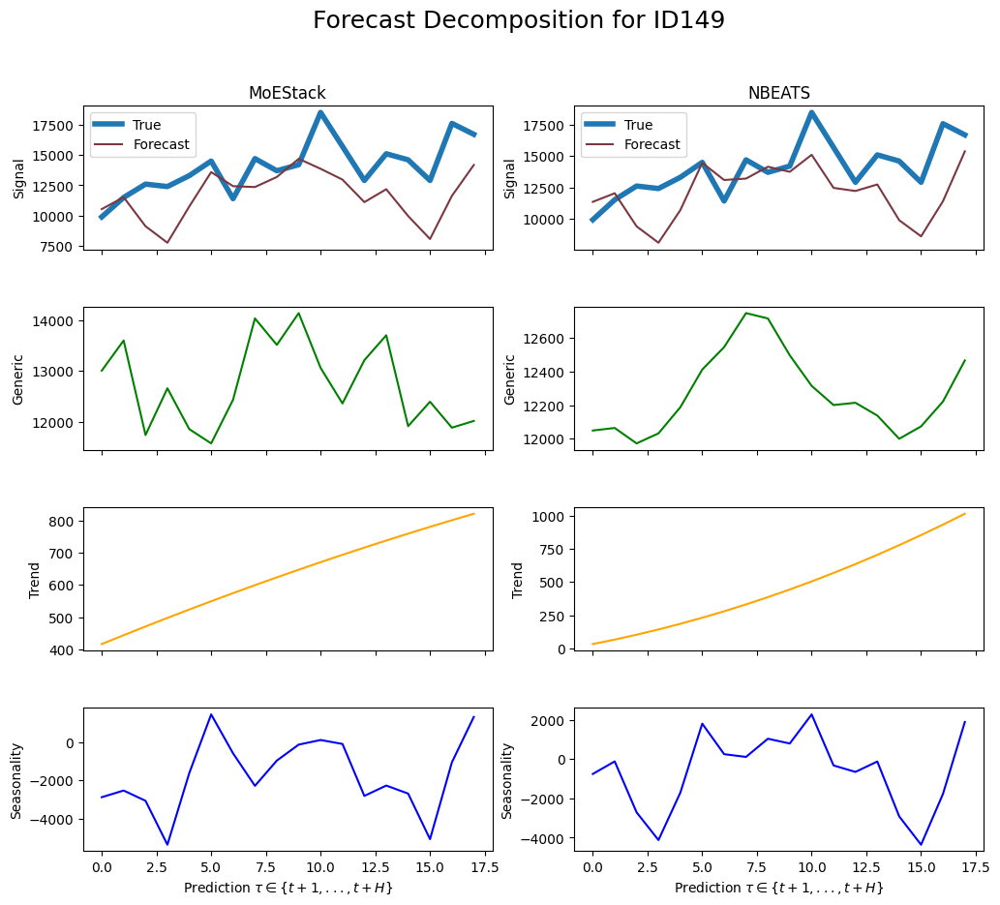

     unique_id         ds        y
1008     ID149 2004-02-29   9900.0
1009     ID149 2004-03-31  11500.0
1010     ID149 2004-04-30  12600.0
1011     ID149 2004-05-31  12400.0
1012     ID149 2004-06-30  13300.0
1013     ID149 2004-07-31  14500.0
1014     ID149 2004-08-31  11400.0
1015     ID149 2004-09-30  14700.0
1016     ID149 2004-10-31  13700.0
1017     ID149 2004-11-30  14200.0
1018     ID149 2004-12-31  18500.0
1019     ID149 2005-01-31  15700.0
1020     ID149 2005-02-28  12900.0
1021     ID149 2005-03-31  15100.0
1022     ID149 2005-04-30  14600.0
1023     ID149 2005-05-31  12900.0
1024     ID149 2005-06-30  17600.0
1025     ID149 2005-07-31  16700.0
Gate values for ID15: [0.390306   0.31844455 0.29124942]
sMAPE for MoEStack: 0.4946788255406409
sMAPE for NBEATS: 0.687545276659327


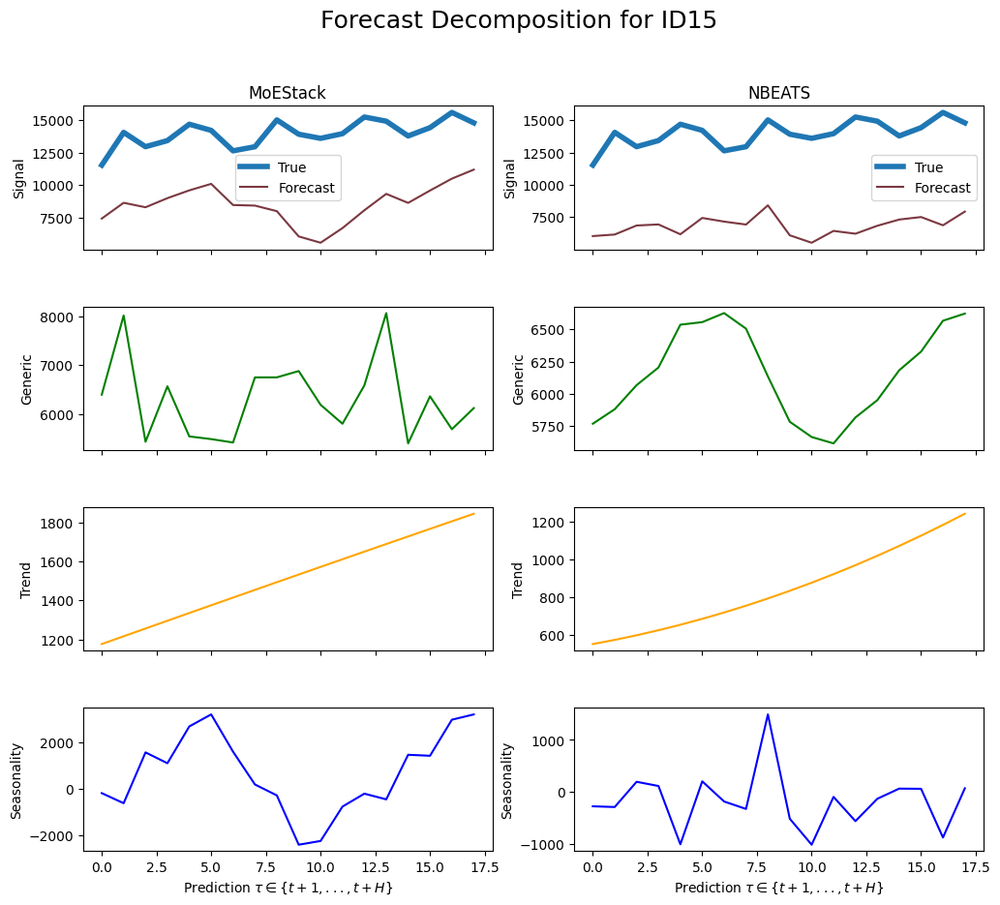

     unique_id         ds             y
1026      ID15 2003-07-31  11526.700195
1027      ID15 2003-08-31  14053.099609
1028      ID15 2003-09-30  12947.799805
1029      ID15 2003-10-31  13418.099609
1030      ID15 2003-11-30  14680.980469
1031      ID15 2003-12-31  14207.400391
1032      ID15 2004-01-31  12628.799805
1033      ID15 2004-02-29  12944.519531
1034      ID15 2004-03-31  15015.700195
1035      ID15 2004-04-30  13909.280273
1036      ID15 2004-05-31  13593.160156
1037      ID15 2004-06-30  13953.929688
1038      ID15 2004-07-31  15237.049805
1039      ID15 2004-08-31  14916.269531
1040      ID15 2004-09-30  13776.339844
1041      ID15 2004-10-31  14417.099609
1042      ID15 2004-11-30  15590.809570
1043      ID15 2004-12-31  14787.160156
Gate values for ID150: [0.2848104  0.29823372 0.41695586]
sMAPE for MoEStack: 0.19192340607877062
sMAPE for NBEATS: 0.16421505360468372


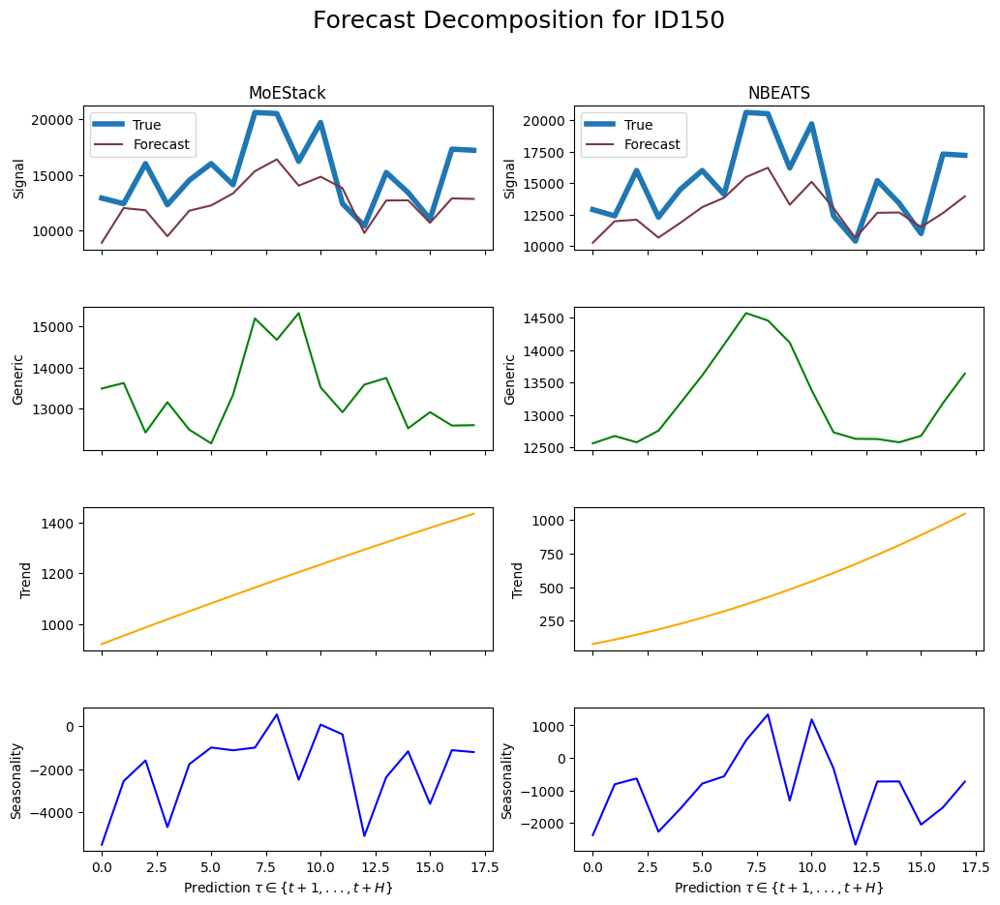

     unique_id         ds        y
1044     ID150 2004-02-29  12900.0
1045     ID150 2004-03-31  12400.0
1046     ID150 2004-04-30  16000.0
1047     ID150 2004-05-31  12300.0
1048     ID150 2004-06-30  14500.0
1049     ID150 2004-07-31  16000.0
1050     ID150 2004-08-31  14100.0
1051     ID150 2004-09-30  20600.0
1052     ID150 2004-10-31  20500.0
1053     ID150 2004-11-30  16200.0
1054     ID150 2004-12-31  19700.0
1055     ID150 2005-01-31  12400.0
1056     ID150 2005-02-28  10400.0
1057     ID150 2005-03-31  15200.0
1058     ID150 2005-04-30  13400.0
1059     ID150 2005-05-31  11000.0
1060     ID150 2005-06-30  17300.0
1061     ID150 2005-07-31  17200.0
Gate values for ID151: [0.26050255 0.21622828 0.5232692 ]
sMAPE for MoEStack: 0.23515239864410672
sMAPE for NBEATS: 0.2226007931474315


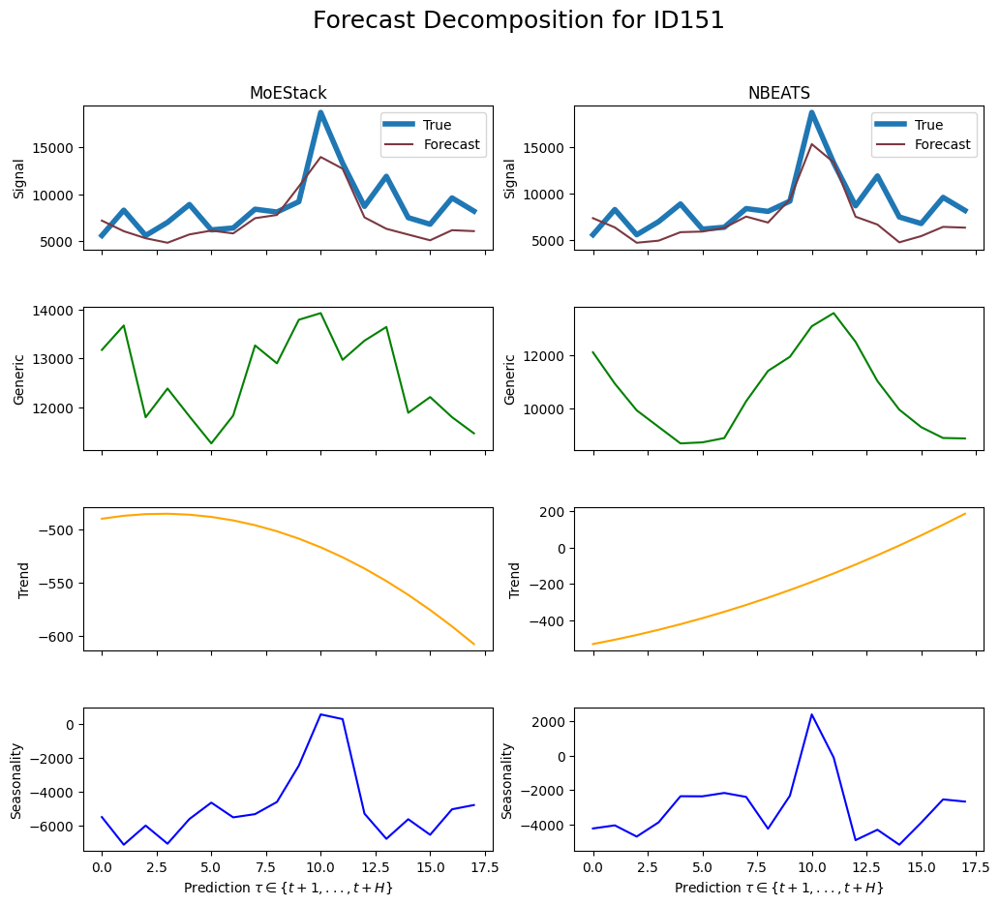

     unique_id         ds        y
1062     ID151 2004-02-29   5600.0
1063     ID151 2004-03-31   8300.0
1064     ID151 2004-04-30   5600.0
1065     ID151 2004-05-31   7000.0
1066     ID151 2004-06-30   8900.0
1067     ID151 2004-07-31   6200.0
1068     ID151 2004-08-31   6400.0
1069     ID151 2004-09-30   8400.0
1070     ID151 2004-10-31   8100.0
1071     ID151 2004-11-30   9200.0
1072     ID151 2004-12-31  18700.0
1073     ID151 2005-01-31  13300.0
1074     ID151 2005-02-28   8700.0
1075     ID151 2005-03-31  11900.0
1076     ID151 2005-04-30   7500.0
1077     ID151 2005-05-31   6800.0
1078     ID151 2005-06-30   9600.0
1079     ID151 2005-07-31   8200.0
Gate values for ID152: [0.25058967 0.205393   0.5440173 ]
sMAPE for MoEStack: 0.24963702704842683
sMAPE for NBEATS: 0.29958907092099996


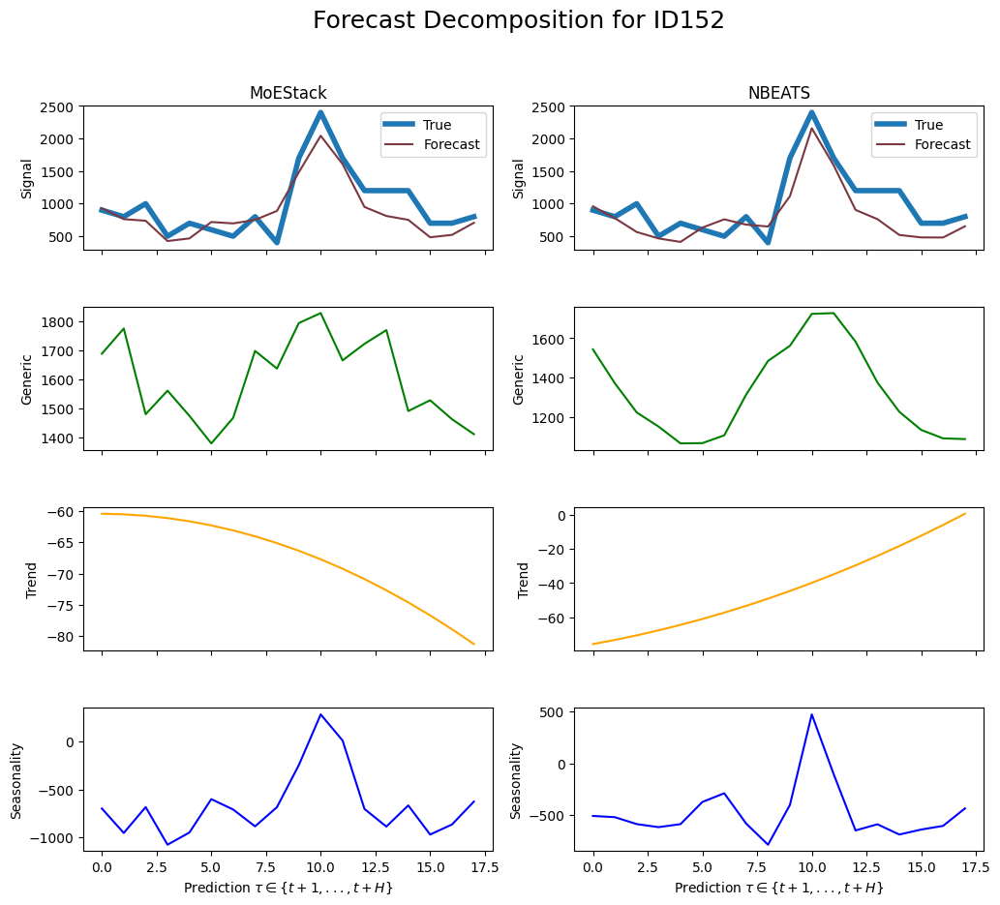

     unique_id         ds       y
1080     ID152 2004-02-29   900.0
1081     ID152 2004-03-31   800.0
1082     ID152 2004-04-30  1000.0
1083     ID152 2004-05-31   500.0
1084     ID152 2004-06-30   700.0
1085     ID152 2004-07-31   600.0
1086     ID152 2004-08-31   500.0
1087     ID152 2004-09-30   800.0
1088     ID152 2004-10-31   400.0
1089     ID152 2004-11-30  1700.0
1090     ID152 2004-12-31  2400.0
1091     ID152 2005-01-31  1700.0
1092     ID152 2005-02-28  1200.0
1093     ID152 2005-03-31  1200.0
1094     ID152 2005-04-30  1200.0
1095     ID152 2005-05-31   700.0
1096     ID152 2005-06-30   700.0
1097     ID152 2005-07-31   800.0
Gate values for ID153: [0.23073906 0.243114   0.5261469 ]
sMAPE for MoEStack: 0.20618132795236122
sMAPE for NBEATS: 0.18578583852018532


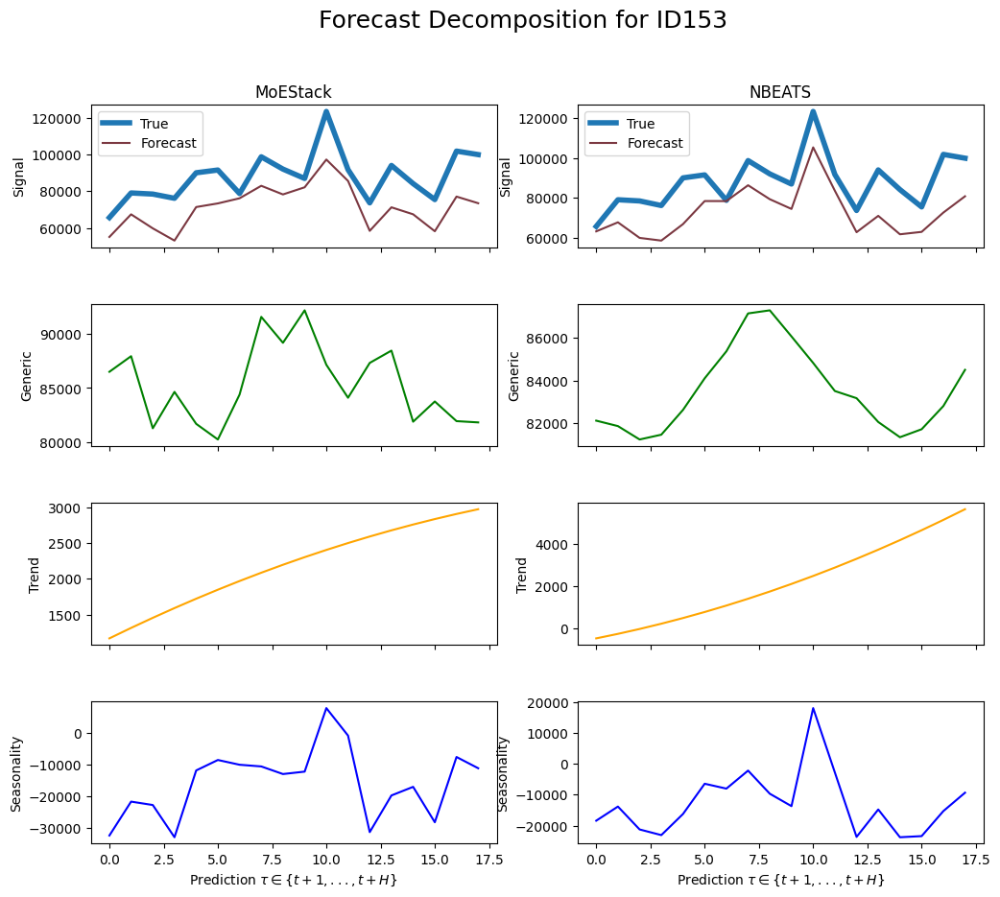

     unique_id         ds         y
1098     ID153 2004-02-29   65700.0
1099     ID153 2004-03-31   79100.0
1100     ID153 2004-04-30   78500.0
1101     ID153 2004-05-31   76200.0
1102     ID153 2004-06-30   90100.0
1103     ID153 2004-07-31   91600.0
1104     ID153 2004-08-31   78800.0
1105     ID153 2004-09-30   98800.0
1106     ID153 2004-10-31   92100.0
1107     ID153 2004-11-30   87000.0
1108     ID153 2004-12-31  123500.0
1109     ID153 2005-01-31   91800.0
1110     ID153 2005-02-28   73700.0
1111     ID153 2005-03-31   94100.0
1112     ID153 2005-04-30   84200.0
1113     ID153 2005-05-31   75500.0
1114     ID153 2005-06-30  101900.0
1115     ID153 2005-07-31  100000.0
Gate values for ID154: [0.38827705 0.25405505 0.35766786]
sMAPE for MoEStack: 0.45290593616104924
sMAPE for NBEATS: 0.48696791039925763


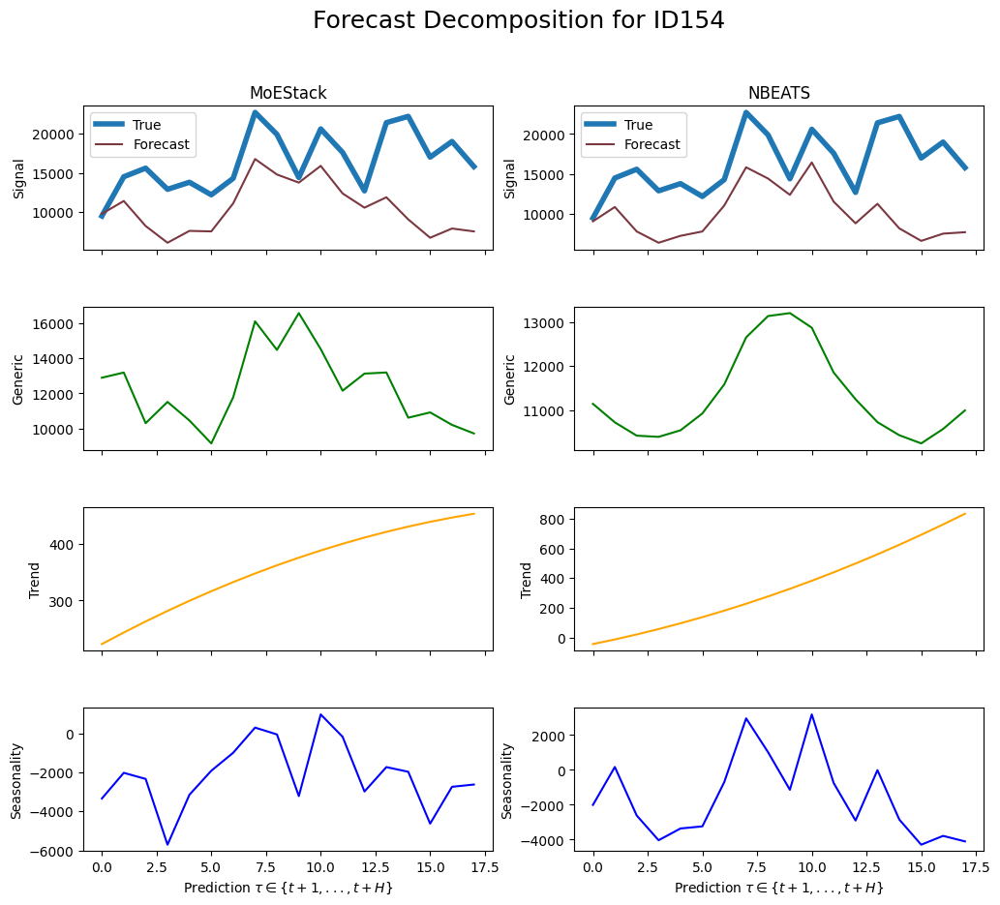

     unique_id         ds        y
1116     ID154 2004-02-29   9500.0
1117     ID154 2004-03-31  14500.0
1118     ID154 2004-04-30  15600.0
1119     ID154 2004-05-31  12900.0
1120     ID154 2004-06-30  13800.0
1121     ID154 2004-07-31  12200.0
1122     ID154 2004-08-31  14300.0
1123     ID154 2004-09-30  22700.0
1124     ID154 2004-10-31  19900.0
1125     ID154 2004-11-30  14400.0
1126     ID154 2004-12-31  20600.0
1127     ID154 2005-01-31  17600.0
1128     ID154 2005-02-28  12700.0
1129     ID154 2005-03-31  21400.0
1130     ID154 2005-04-30  22200.0
1131     ID154 2005-05-31  17000.0
1132     ID154 2005-06-30  19000.0
1133     ID154 2005-07-31  15800.0
Gate values for ID155: [0.37541273 0.26643518 0.35815203]
sMAPE for MoEStack: 0.30331065829697823
sMAPE for NBEATS: 0.27378903089448503


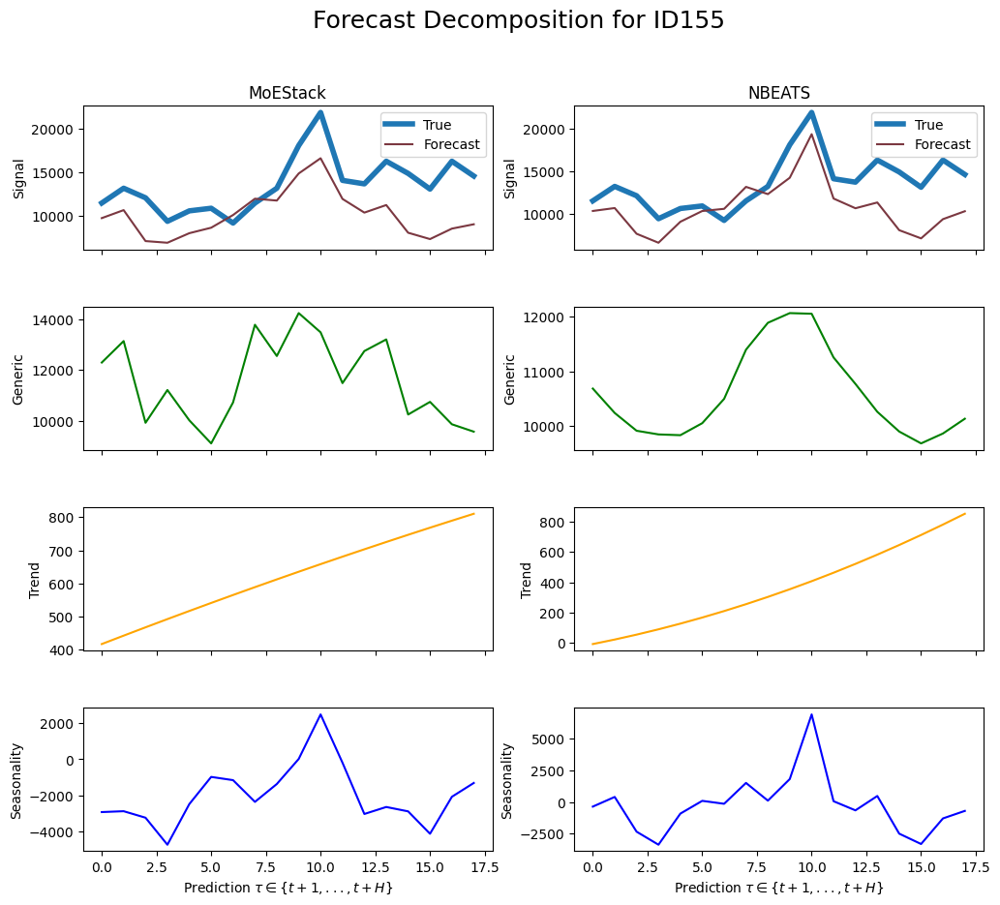

     unique_id         ds        y
1134     ID155 2004-02-29  11500.0
1135     ID155 2004-03-31  13200.0
1136     ID155 2004-04-30  12100.0
1137     ID155 2004-05-31   9400.0
1138     ID155 2004-06-30  10600.0
1139     ID155 2004-07-31  10900.0
1140     ID155 2004-08-31   9200.0
1141     ID155 2004-09-30  11500.0
1142     ID155 2004-10-31  13200.0
1143     ID155 2004-11-30  18100.0
1144     ID155 2004-12-31  21900.0
1145     ID155 2005-01-31  14100.0
1146     ID155 2005-02-28  13700.0
1147     ID155 2005-03-31  16300.0
1148     ID155 2005-04-30  14900.0
1149     ID155 2005-05-31  13100.0
1150     ID155 2005-06-30  16300.0
1151     ID155 2005-07-31  14600.0
Gate values for ID156: [0.26092324 0.35737956 0.38169727]
sMAPE for MoEStack: 0.13429161902577744
sMAPE for NBEATS: 0.13490081509643878


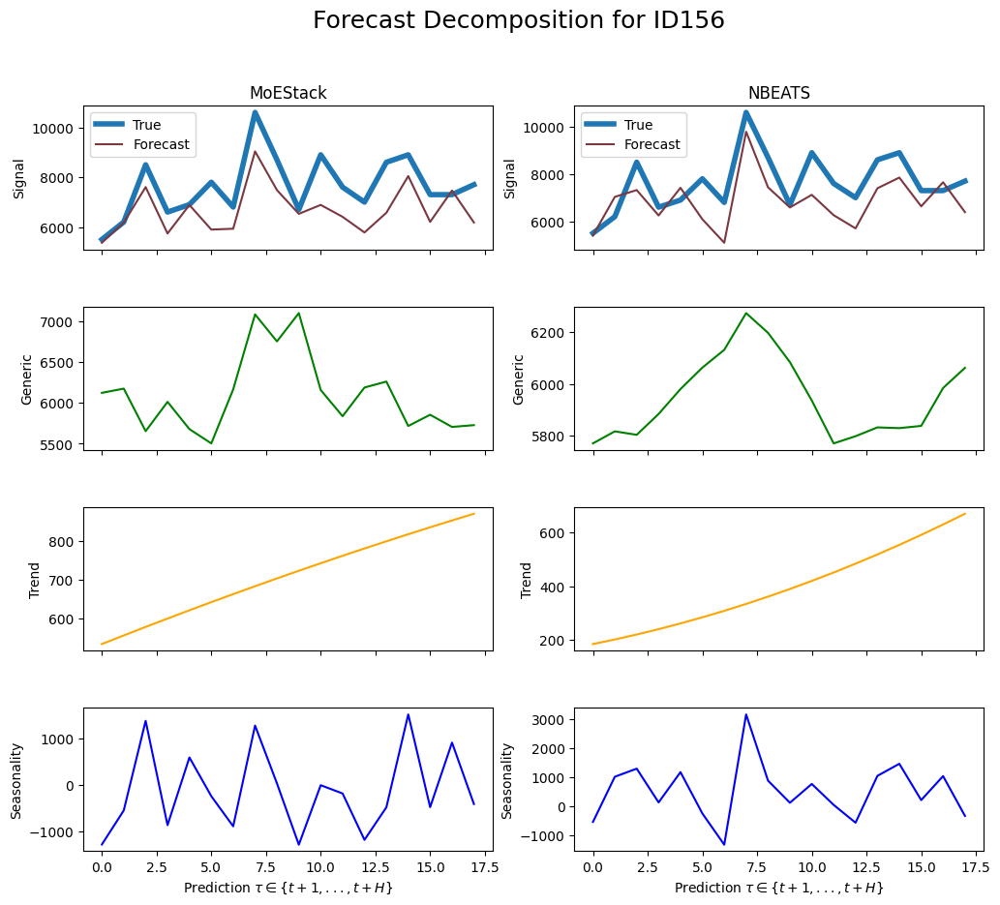

     unique_id         ds        y
1152     ID156 2004-02-29   5500.0
1153     ID156 2004-03-31   6200.0
1154     ID156 2004-04-30   8500.0
1155     ID156 2004-05-31   6600.0
1156     ID156 2004-06-30   6900.0
1157     ID156 2004-07-31   7800.0
1158     ID156 2004-08-31   6800.0
1159     ID156 2004-09-30  10600.0
1160     ID156 2004-10-31   8700.0
1161     ID156 2004-11-30   6700.0
1162     ID156 2004-12-31   8900.0
1163     ID156 2005-01-31   7600.0
1164     ID156 2005-02-28   7000.0
1165     ID156 2005-03-31   8600.0
1166     ID156 2005-04-30   8900.0
1167     ID156 2005-05-31   7300.0
1168     ID156 2005-06-30   7300.0
1169     ID156 2005-07-31   7700.0
Gate values for ID157: [0.26841974 0.30806565 0.42351457]
sMAPE for MoEStack: 0.1602343606486296
sMAPE for NBEATS: 0.1869412371038474


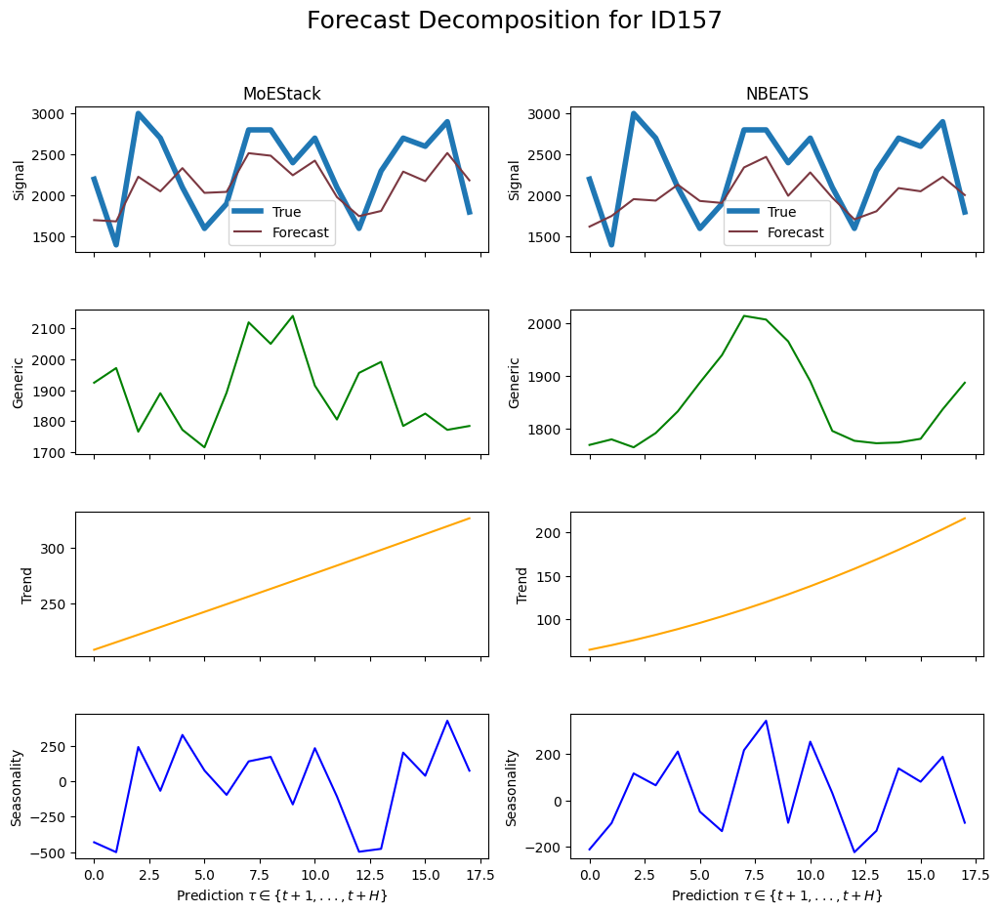

     unique_id         ds       y
1170     ID157 2004-02-29  2200.0
1171     ID157 2004-03-31  1400.0
1172     ID157 2004-04-30  3000.0
1173     ID157 2004-05-31  2700.0
1174     ID157 2004-06-30  2100.0
1175     ID157 2004-07-31  1600.0
1176     ID157 2004-08-31  1900.0
1177     ID157 2004-09-30  2800.0
1178     ID157 2004-10-31  2800.0
1179     ID157 2004-11-30  2400.0
1180     ID157 2004-12-31  2700.0
1181     ID157 2005-01-31  2100.0
1182     ID157 2005-02-28  1600.0
1183     ID157 2005-03-31  2300.0
1184     ID157 2005-04-30  2700.0
1185     ID157 2005-05-31  2600.0
1186     ID157 2005-06-30  2900.0
1187     ID157 2005-07-31  1800.0
Gate values for ID158: [0.3883337  0.25644478 0.35522154]
sMAPE for MoEStack: 0.17792482999990955
sMAPE for NBEATS: 0.18301155652257878


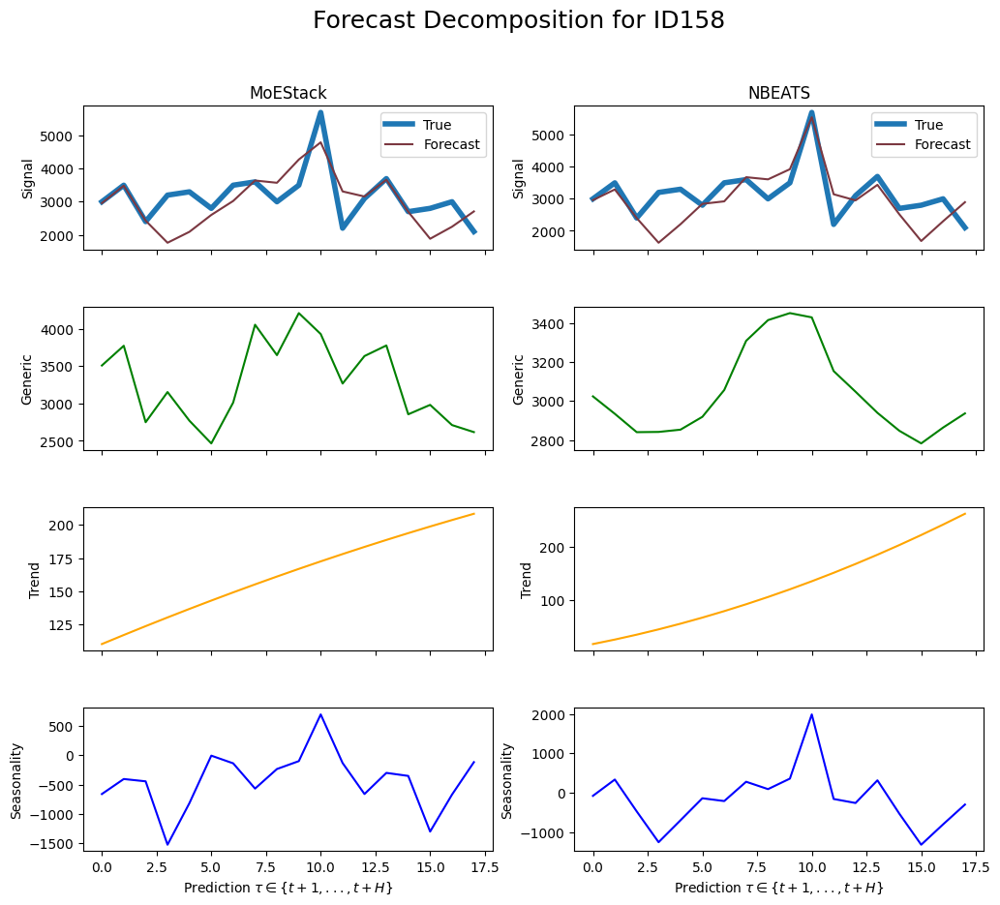

     unique_id         ds       y
1188     ID158 2004-02-29  3000.0
1189     ID158 2004-03-31  3500.0
1190     ID158 2004-04-30  2400.0
1191     ID158 2004-05-31  3200.0
1192     ID158 2004-06-30  3300.0
1193     ID158 2004-07-31  2800.0
1194     ID158 2004-08-31  3500.0
1195     ID158 2004-09-30  3600.0
1196     ID158 2004-10-31  3000.0
1197     ID158 2004-11-30  3500.0
1198     ID158 2004-12-31  5700.0
1199     ID158 2005-01-31  2200.0
1200     ID158 2005-02-28  3100.0
1201     ID158 2005-03-31  3700.0
1202     ID158 2005-04-30  2700.0
1203     ID158 2005-05-31  2800.0
1204     ID158 2005-06-30  3000.0
1205     ID158 2005-07-31  2100.0
Gate values for ID159: [0.3033515  0.18849164 0.5081569 ]
sMAPE for MoEStack: 0.4816924453521809
sMAPE for NBEATS: 0.44149720743104554


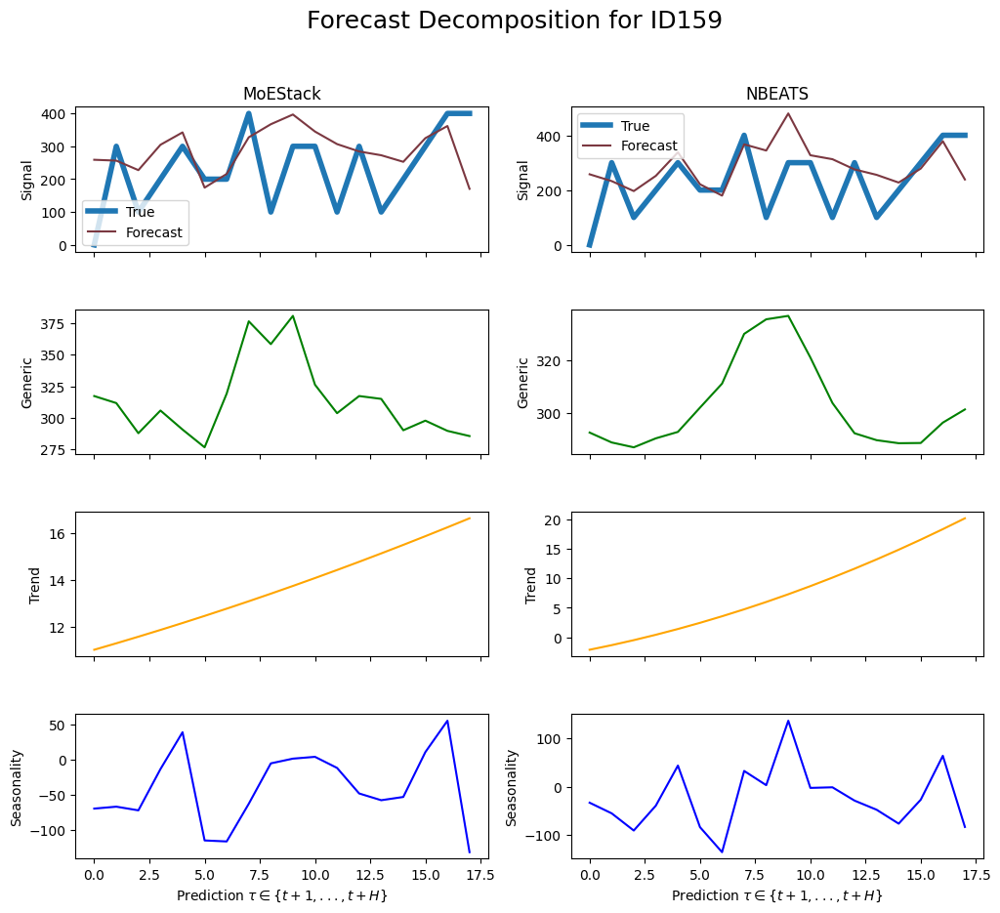

     unique_id         ds      y
1206     ID159 2004-02-29    0.0
1207     ID159 2004-03-31  300.0
1208     ID159 2004-04-30  100.0
1209     ID159 2004-05-31  200.0
1210     ID159 2004-06-30  300.0
1211     ID159 2004-07-31  200.0
1212     ID159 2004-08-31  200.0
1213     ID159 2004-09-30  400.0
1214     ID159 2004-10-31  100.0
1215     ID159 2004-11-30  300.0
1216     ID159 2004-12-31  300.0
1217     ID159 2005-01-31  100.0
1218     ID159 2005-02-28  300.0
1219     ID159 2005-03-31  100.0
1220     ID159 2005-04-30  200.0
1221     ID159 2005-05-31  300.0
1222     ID159 2005-06-30  400.0
1223     ID159 2005-07-31  400.0
Gate values for ID16: [0.39652532 0.32002816 0.28344652]
sMAPE for MoEStack: 0.5299606265753611
sMAPE for NBEATS: 0.7626517310566983


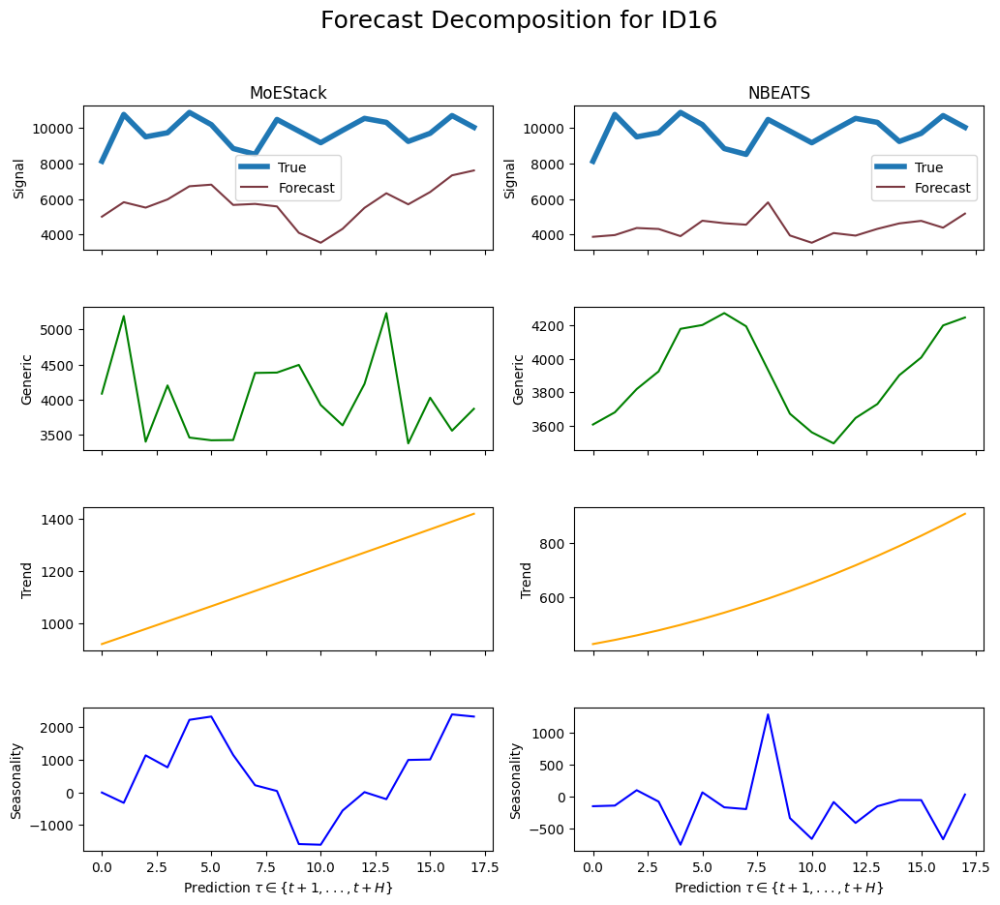

     unique_id         ds             y
1224      ID16 2003-07-31   8133.759766
1225      ID16 2003-08-31  10768.639648
1226      ID16 2003-09-30   9508.480469
1227      ID16 2003-10-31   9737.599609
1228      ID16 2003-11-30  10883.200195
1229      ID16 2003-12-31  10195.839844
1230      ID16 2004-01-31   8848.440430
1231      ID16 2004-02-29   8520.719727
1232      ID16 2004-03-31  10487.040039
1233      ID16 2004-04-30   9831.599609
1234      ID16 2004-05-31   9176.160156
1235      ID16 2004-06-30   9874.480469
1236      ID16 2004-07-31  10547.740234
1237      ID16 2004-08-31  10323.320312
1238      ID16 2004-09-30   9249.240234
1239      ID16 2004-10-31   9707.280273
1240      ID16 2004-11-30  10706.860352
1241      ID16 2004-12-31  10044.580078
Gate values for ID160: [0.372282   0.27240783 0.35531017]
sMAPE for MoEStack: 0.28381692851966245
sMAPE for NBEATS: 0.26491659153831615


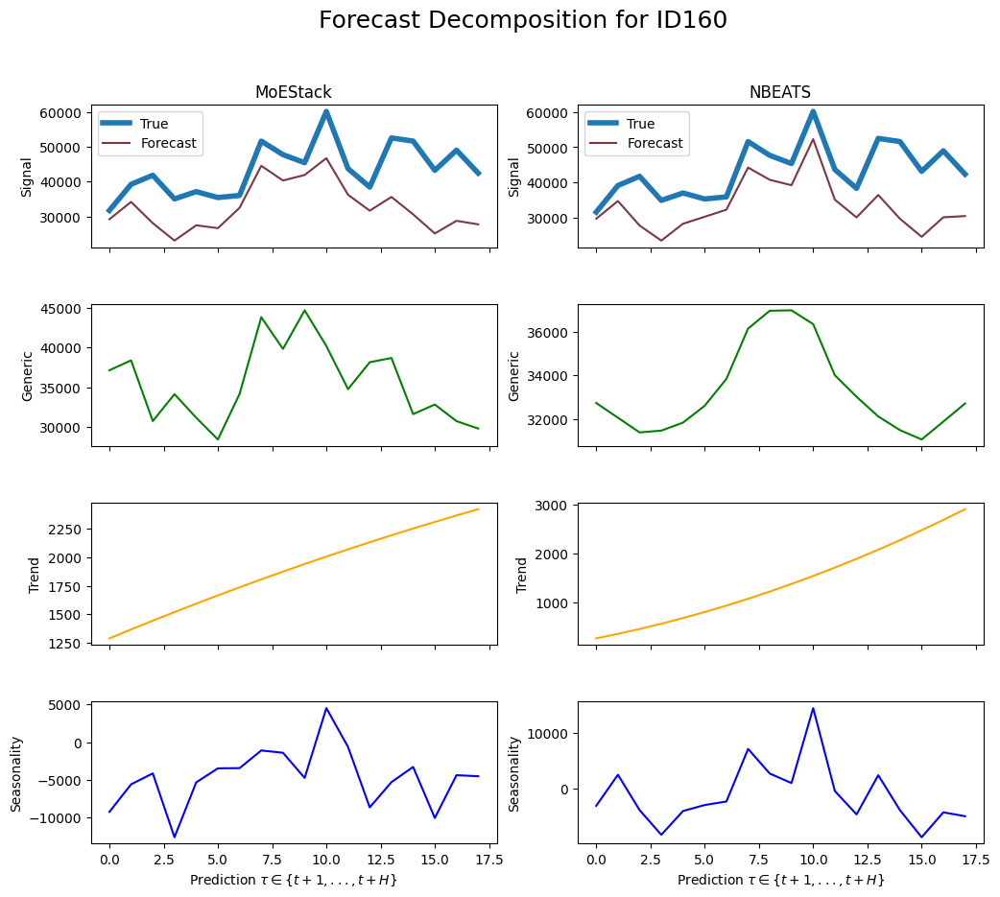

     unique_id         ds        y
1242     ID160 2004-02-29  31700.0
1243     ID160 2004-03-31  39200.0
1244     ID160 2004-04-30  41800.0
1245     ID160 2004-05-31  35000.0
1246     ID160 2004-06-30  37100.0
1247     ID160 2004-07-31  35400.0
1248     ID160 2004-08-31  36000.0
1249     ID160 2004-09-30  51600.0
1250     ID160 2004-10-31  47700.0
1251     ID160 2004-11-30  45400.0
1252     ID160 2004-12-31  60100.0
1253     ID160 2005-01-31  43700.0
1254     ID160 2005-02-28  38400.0
1255     ID160 2005-03-31  52500.0
1256     ID160 2005-04-30  51600.0
1257     ID160 2005-05-31  43200.0
1258     ID160 2005-06-30  49000.0
1259     ID160 2005-07-31  42400.0
Gate values for ID161: [0.37948272 0.2874517  0.3330656 ]
sMAPE for MoEStack: 0.29865961174254435
sMAPE for NBEATS: 0.22257393913075788


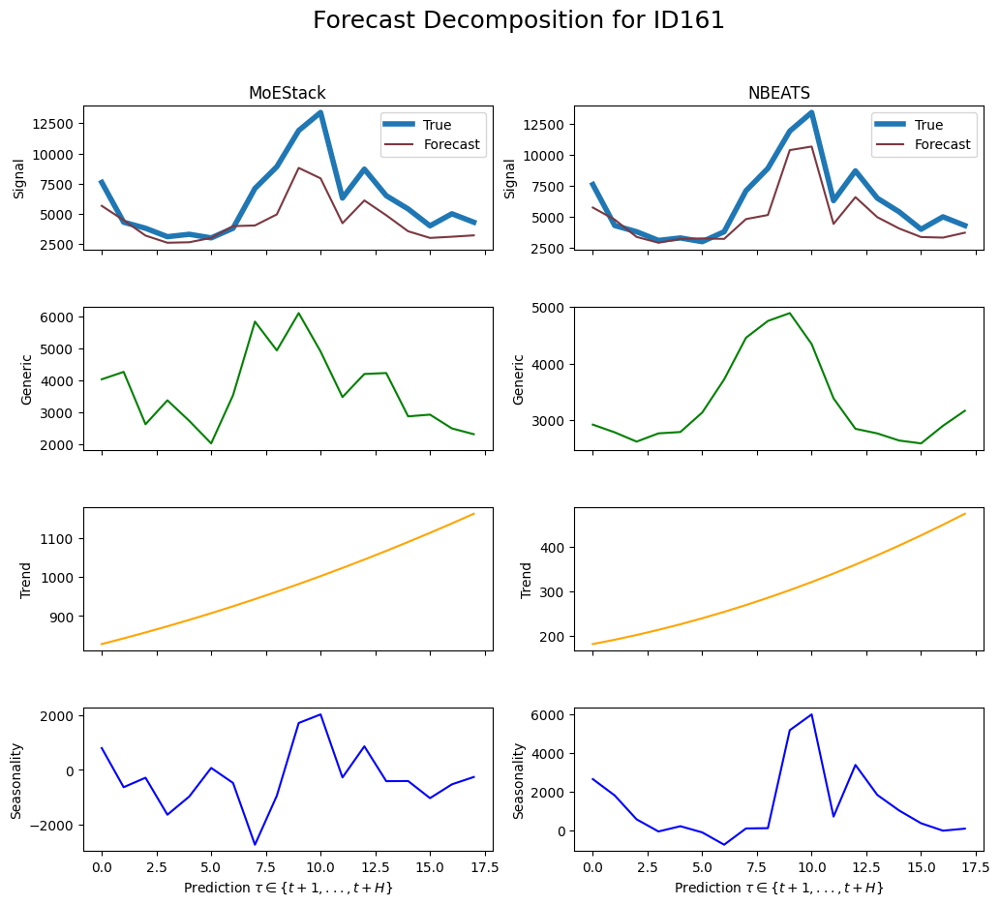

     unique_id         ds        y
1260     ID161 2004-02-29   7600.0
1261     ID161 2004-03-31   4300.0
1262     ID161 2004-04-30   3800.0
1263     ID161 2004-05-31   3100.0
1264     ID161 2004-06-30   3300.0
1265     ID161 2004-07-31   3000.0
1266     ID161 2004-08-31   3800.0
1267     ID161 2004-09-30   7100.0
1268     ID161 2004-10-31   8900.0
1269     ID161 2004-11-30  11900.0
1270     ID161 2004-12-31  13400.0
1271     ID161 2005-01-31   6300.0
1272     ID161 2005-02-28   8700.0
1273     ID161 2005-03-31   6500.0
1274     ID161 2005-04-30   5400.0
1275     ID161 2005-05-31   4000.0
1276     ID161 2005-06-30   5000.0
1277     ID161 2005-07-31   4300.0
Gate values for ID162: [0.36959335 0.19915643 0.43125018]
sMAPE for MoEStack: 0.3380720781798098
sMAPE for NBEATS: 0.3443151072455622


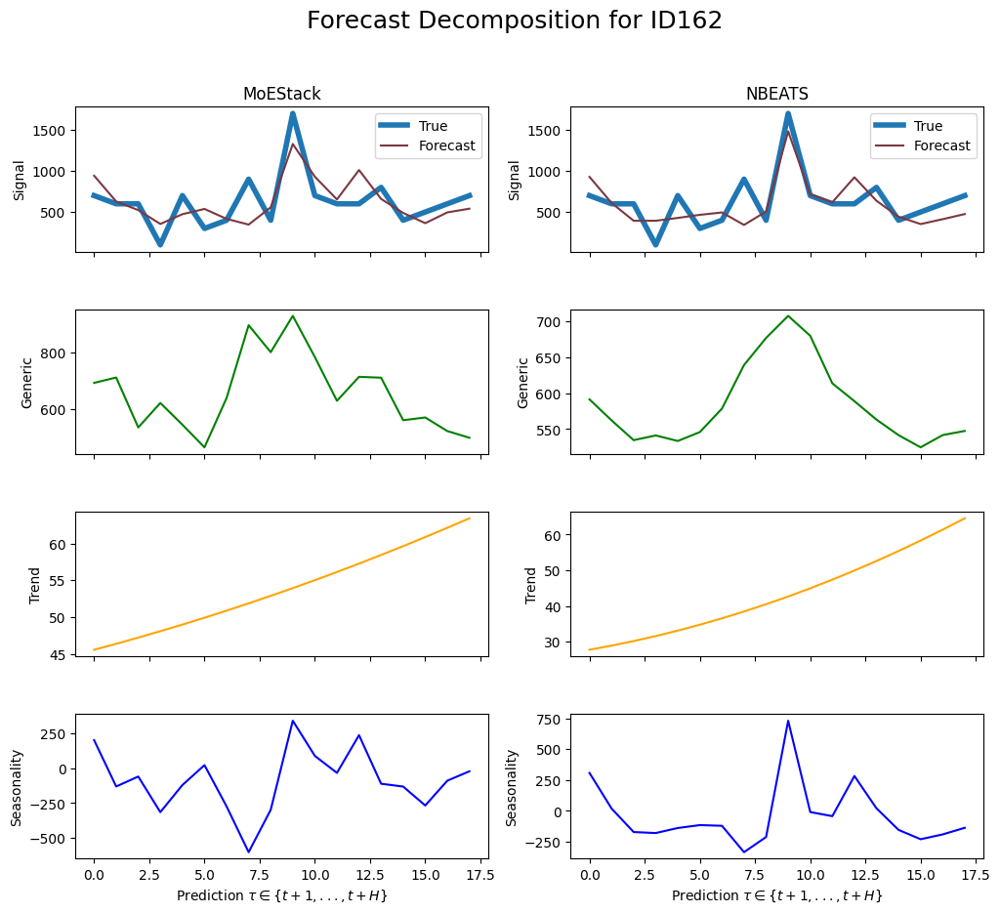

     unique_id         ds       y
1278     ID162 2004-02-29   700.0
1279     ID162 2004-03-31   600.0
1280     ID162 2004-04-30   600.0
1281     ID162 2004-05-31   100.0
1282     ID162 2004-06-30   700.0
1283     ID162 2004-07-31   300.0
1284     ID162 2004-08-31   400.0
1285     ID162 2004-09-30   900.0
1286     ID162 2004-10-31   400.0
1287     ID162 2004-11-30  1700.0
1288     ID162 2004-12-31   700.0
1289     ID162 2005-01-31   600.0
1290     ID162 2005-02-28   600.0
1291     ID162 2005-03-31   800.0
1292     ID162 2005-04-30   400.0
1293     ID162 2005-05-31   500.0
1294     ID162 2005-06-30   600.0
1295     ID162 2005-07-31   700.0
Gate values for ID163: [0.30105987 0.35320136 0.34573877]
sMAPE for MoEStack: 0.2077928391582889
sMAPE for NBEATS: 0.19357234948706692


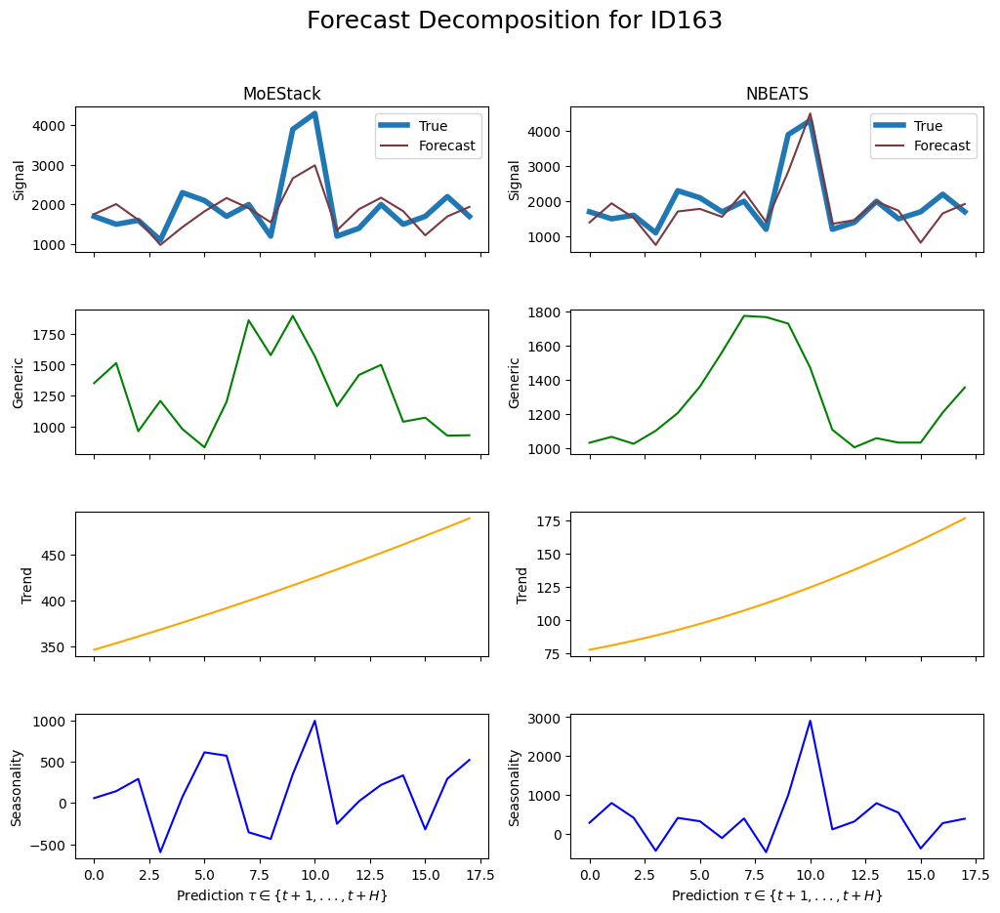

     unique_id         ds       y
1296     ID163 2004-02-29  1700.0
1297     ID163 2004-03-31  1500.0
1298     ID163 2004-04-30  1600.0
1299     ID163 2004-05-31  1100.0
1300     ID163 2004-06-30  2300.0
1301     ID163 2004-07-31  2100.0
1302     ID163 2004-08-31  1700.0
1303     ID163 2004-09-30  2000.0
1304     ID163 2004-10-31  1200.0
1305     ID163 2004-11-30  3900.0
1306     ID163 2004-12-31  4300.0
1307     ID163 2005-01-31  1200.0
1308     ID163 2005-02-28  1400.0
1309     ID163 2005-03-31  2000.0
1310     ID163 2005-04-30  1500.0
1311     ID163 2005-05-31  1700.0
1312     ID163 2005-06-30  2200.0
1313     ID163 2005-07-31  1700.0
Gate values for ID164: [0.39862087 0.26958784 0.33179125]
sMAPE for MoEStack: 0.34342997994185454
sMAPE for NBEATS: 0.34182266294062724


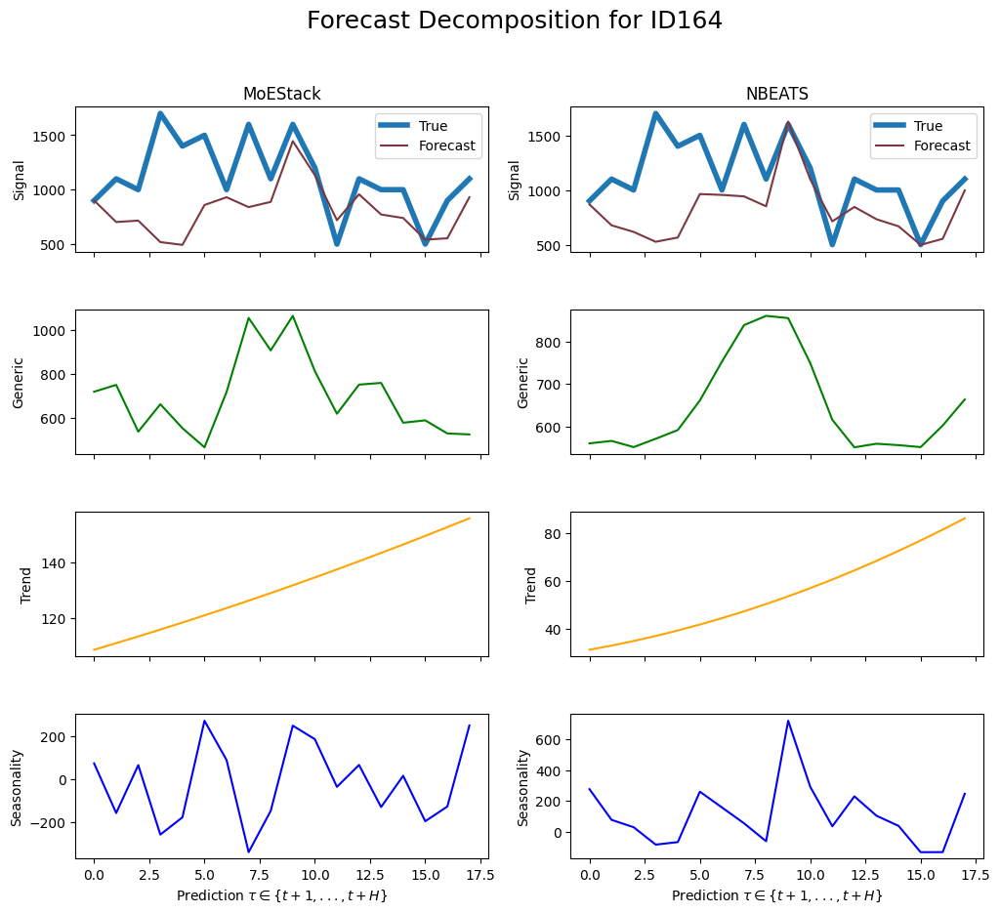

     unique_id         ds       y
1314     ID164 2004-02-29   900.0
1315     ID164 2004-03-31  1100.0
1316     ID164 2004-04-30  1000.0
1317     ID164 2004-05-31  1700.0
1318     ID164 2004-06-30  1400.0
1319     ID164 2004-07-31  1500.0
1320     ID164 2004-08-31  1000.0
1321     ID164 2004-09-30  1600.0
1322     ID164 2004-10-31  1100.0
1323     ID164 2004-11-30  1600.0
1324     ID164 2004-12-31  1200.0
1325     ID164 2005-01-31   500.0
1326     ID164 2005-02-28  1100.0
1327     ID164 2005-03-31  1000.0
1328     ID164 2005-04-30  1000.0
1329     ID164 2005-05-31   500.0
1330     ID164 2005-06-30   900.0
1331     ID164 2005-07-31  1100.0
Gate values for ID165: [0.37739208 0.28962877 0.33297908]
sMAPE for MoEStack: 0.23428281896097986
sMAPE for NBEATS: 0.17778808557812334


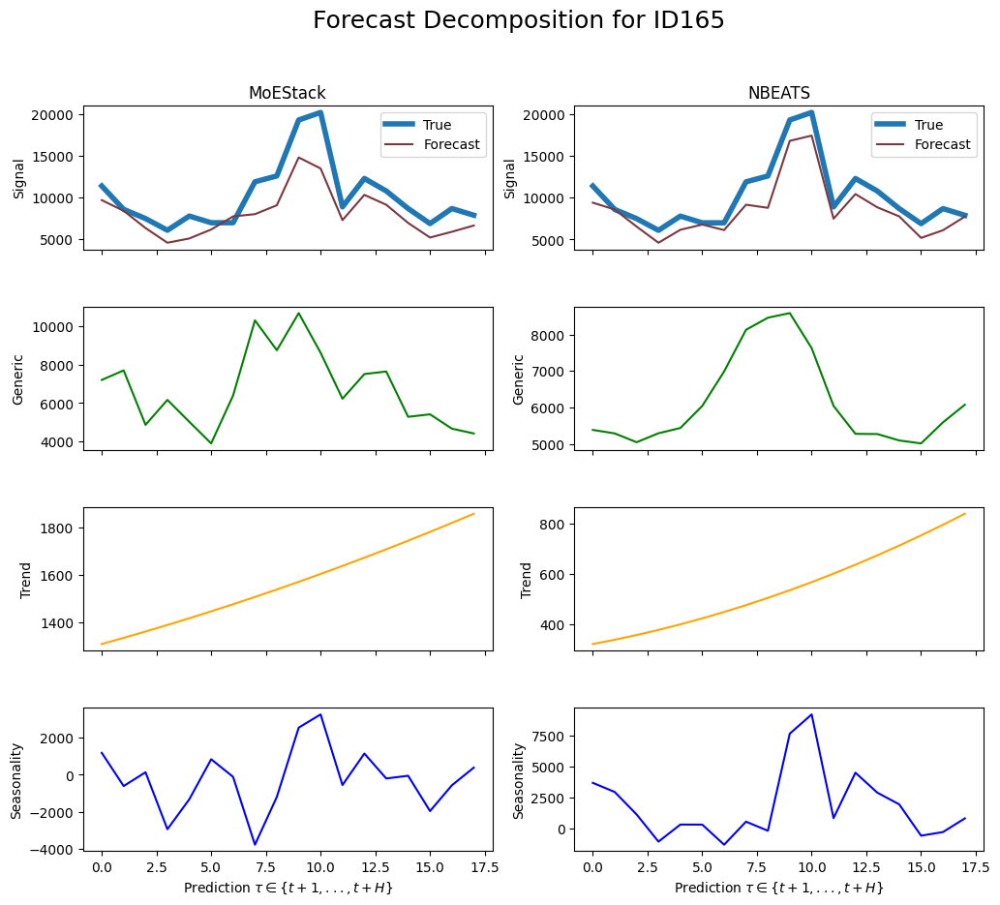

     unique_id         ds        y
1332     ID165 2004-02-29  11400.0
1333     ID165 2004-03-31   8600.0
1334     ID165 2004-04-30   7500.0
1335     ID165 2004-05-31   6100.0
1336     ID165 2004-06-30   7800.0
1337     ID165 2004-07-31   7000.0
1338     ID165 2004-08-31   7000.0
1339     ID165 2004-09-30  11900.0
1340     ID165 2004-10-31  12600.0
1341     ID165 2004-11-30  19300.0
1342     ID165 2004-12-31  20200.0
1343     ID165 2005-01-31   8900.0
1344     ID165 2005-02-28  12300.0
1345     ID165 2005-03-31  10800.0
1346     ID165 2005-04-30   8700.0
1347     ID165 2005-05-31   6900.0
1348     ID165 2005-06-30   8700.0
1349     ID165 2005-07-31   7900.0
Gate values for ID166: [0.37302247 0.29347128 0.33350632]
sMAPE for MoEStack: 0.3300699838570444
sMAPE for NBEATS: 0.3058738027067686


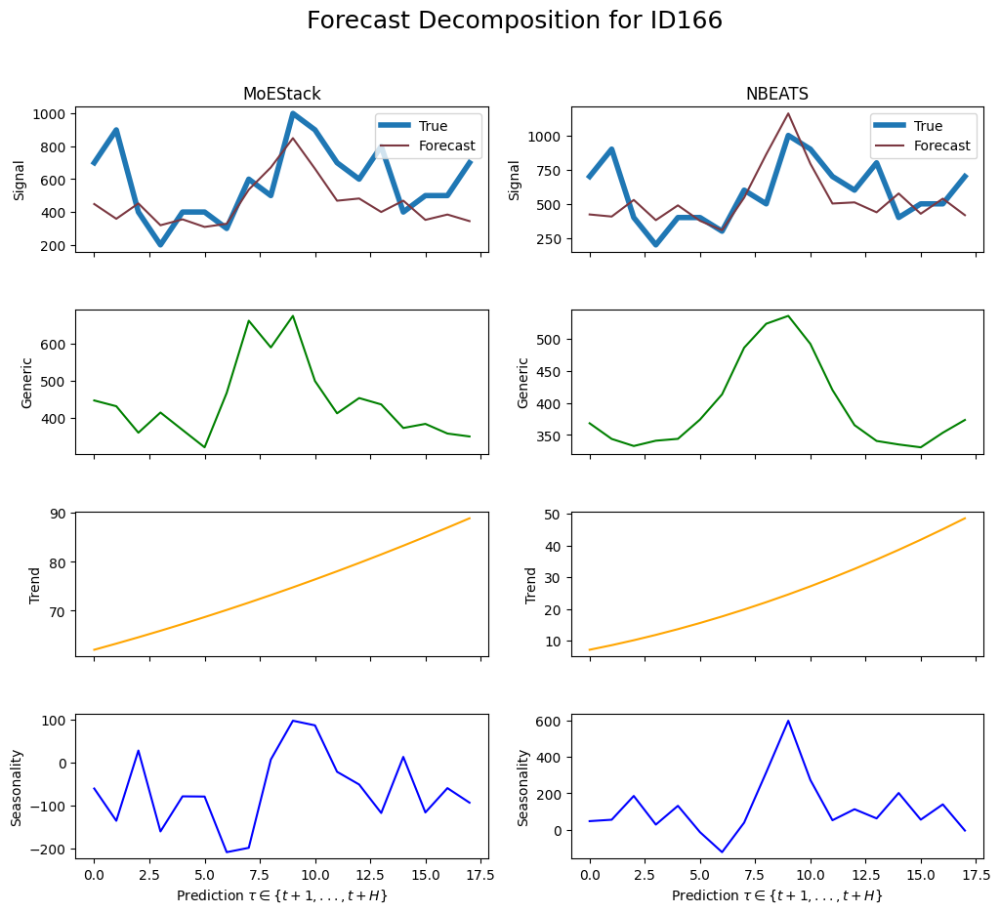

     unique_id         ds       y
1350     ID166 2004-02-29   700.0
1351     ID166 2004-03-31   900.0
1352     ID166 2004-04-30   400.0
1353     ID166 2004-05-31   200.0
1354     ID166 2004-06-30   400.0
1355     ID166 2004-07-31   400.0
1356     ID166 2004-08-31   300.0
1357     ID166 2004-09-30   600.0
1358     ID166 2004-10-31   500.0
1359     ID166 2004-11-30  1000.0
1360     ID166 2004-12-31   900.0
1361     ID166 2005-01-31   700.0
1362     ID166 2005-02-28   600.0
1363     ID166 2005-03-31   800.0
1364     ID166 2005-04-30   400.0
1365     ID166 2005-05-31   500.0
1366     ID166 2005-06-30   500.0
1367     ID166 2005-07-31   700.0
Gate values for ID167: [0.36176208 0.23510677 0.4031311 ]
sMAPE for MoEStack: 0.363075521427135
sMAPE for NBEATS: 0.390833272755978


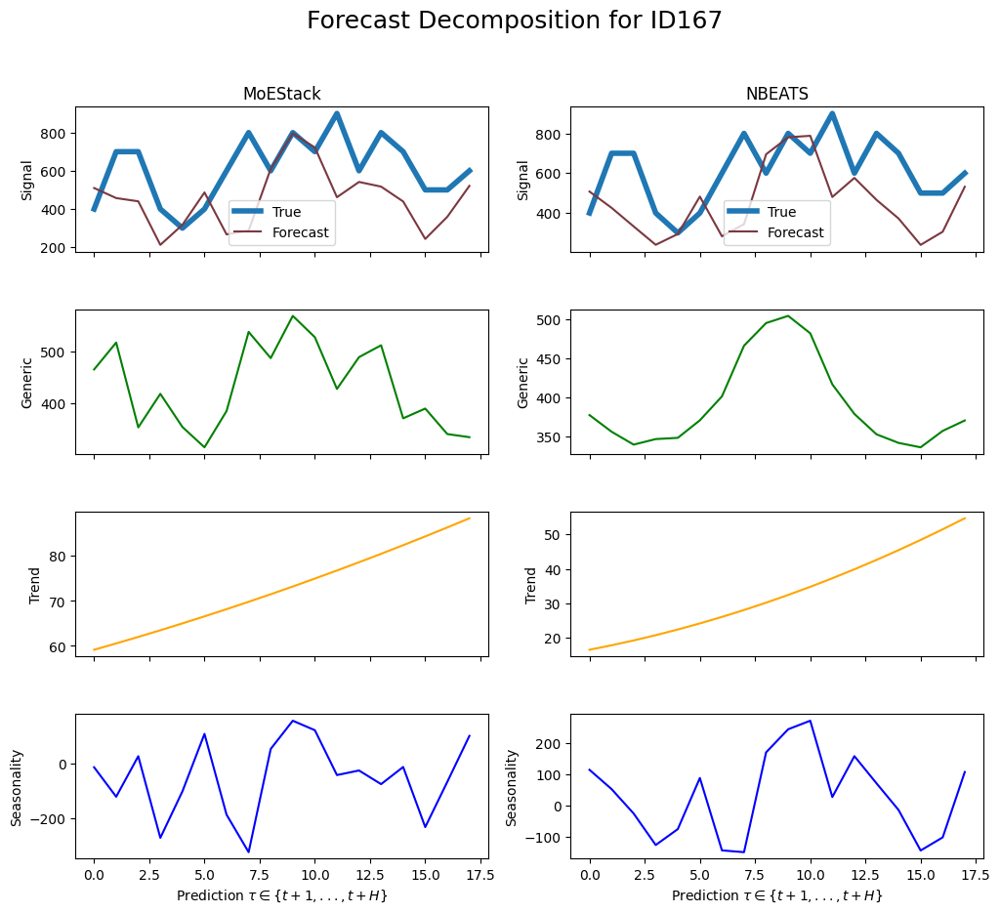

     unique_id         ds      y
1368     ID167 2004-02-29  400.0
1369     ID167 2004-03-31  700.0
1370     ID167 2004-04-30  700.0
1371     ID167 2004-05-31  400.0
1372     ID167 2004-06-30  300.0
1373     ID167 2004-07-31  400.0
1374     ID167 2004-08-31  600.0
1375     ID167 2004-09-30  800.0
1376     ID167 2004-10-31  600.0
1377     ID167 2004-11-30  800.0
1378     ID167 2004-12-31  700.0
1379     ID167 2005-01-31  900.0
1380     ID167 2005-02-28  600.0
1381     ID167 2005-03-31  800.0
1382     ID167 2005-04-30  700.0
1383     ID167 2005-05-31  500.0
1384     ID167 2005-06-30  500.0
1385     ID167 2005-07-31  600.0
Gate values for ID168: [0.17882776 0.3032978  0.51787454]
sMAPE for MoEStack: 0.15833800764370778
sMAPE for NBEATS: 0.29587485043295875


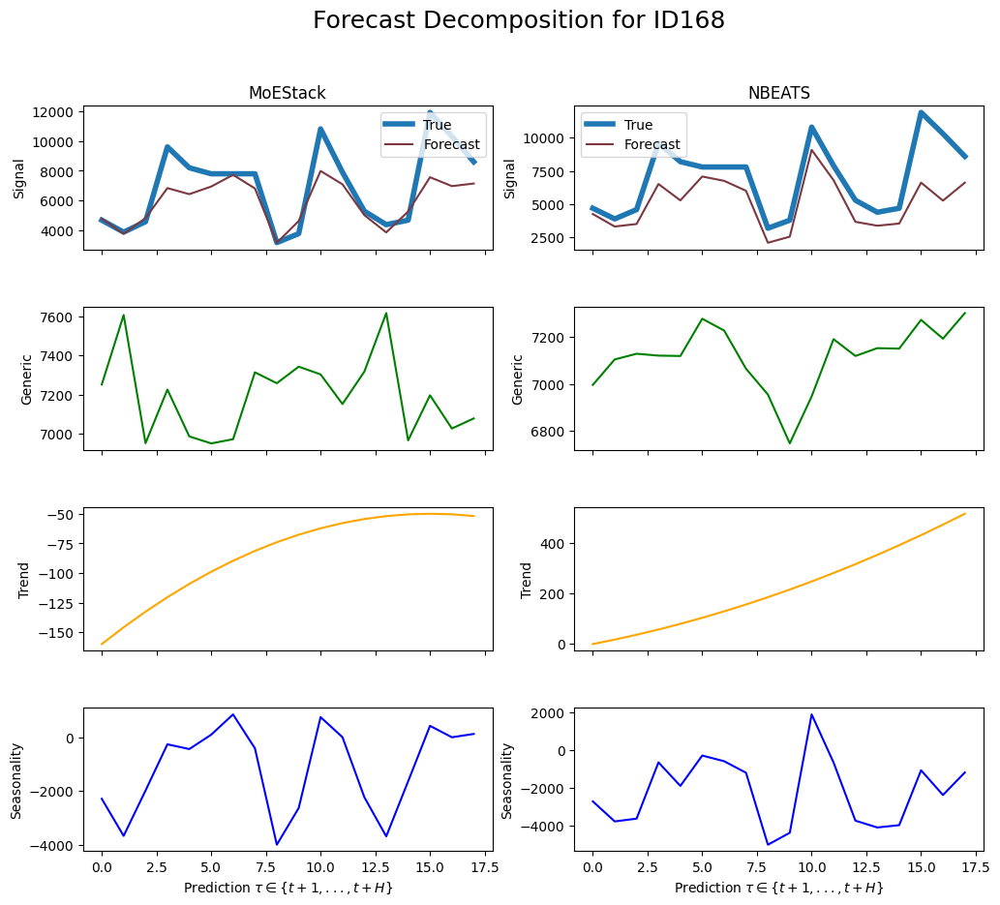

     unique_id         ds        y
1386     ID168 2004-02-29   4700.0
1387     ID168 2004-03-31   3900.0
1388     ID168 2004-04-30   4600.0
1389     ID168 2004-05-31   9600.0
1390     ID168 2004-06-30   8200.0
1391     ID168 2004-07-31   7800.0
1392     ID168 2004-08-31   7800.0
1393     ID168 2004-09-30   7800.0
1394     ID168 2004-10-31   3200.0
1395     ID168 2004-11-30   3800.0
1396     ID168 2004-12-31  10800.0
1397     ID168 2005-01-31   7900.0
1398     ID168 2005-02-28   5300.0
1399     ID168 2005-03-31   4400.0
1400     ID168 2005-04-30   4700.0
1401     ID168 2005-05-31  11900.0
1402     ID168 2005-06-30  10300.0
1403     ID168 2005-07-31   8600.0
Gate values for ID169: [0.2816329  0.34405014 0.374317  ]
sMAPE for MoEStack: 0.312473585182796
sMAPE for NBEATS: 0.33791382708105194


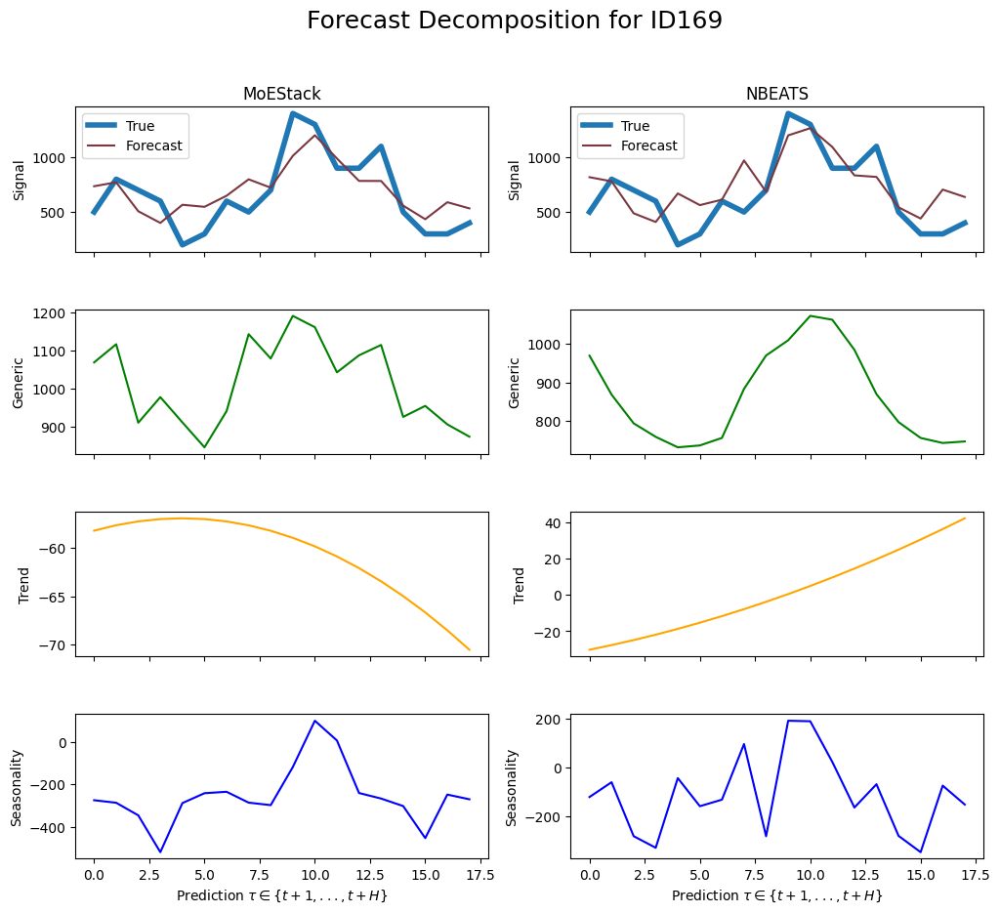

     unique_id         ds       y
1404     ID169 2004-02-29   500.0
1405     ID169 2004-03-31   800.0
1406     ID169 2004-04-30   700.0
1407     ID169 2004-05-31   600.0
1408     ID169 2004-06-30   200.0
1409     ID169 2004-07-31   300.0
1410     ID169 2004-08-31   600.0
1411     ID169 2004-09-30   500.0
1412     ID169 2004-10-31   700.0
1413     ID169 2004-11-30  1400.0
1414     ID169 2004-12-31  1300.0
1415     ID169 2005-01-31   900.0
1416     ID169 2005-02-28   900.0
1417     ID169 2005-03-31  1100.0
1418     ID169 2005-04-30   500.0
1419     ID169 2005-05-31   300.0
1420     ID169 2005-06-30   300.0
1421     ID169 2005-07-31   400.0
Gate values for ID17: [0.33835447 0.30491826 0.3567273 ]
sMAPE for MoEStack: 0.5564323788410874
sMAPE for NBEATS: 0.7593672709415947


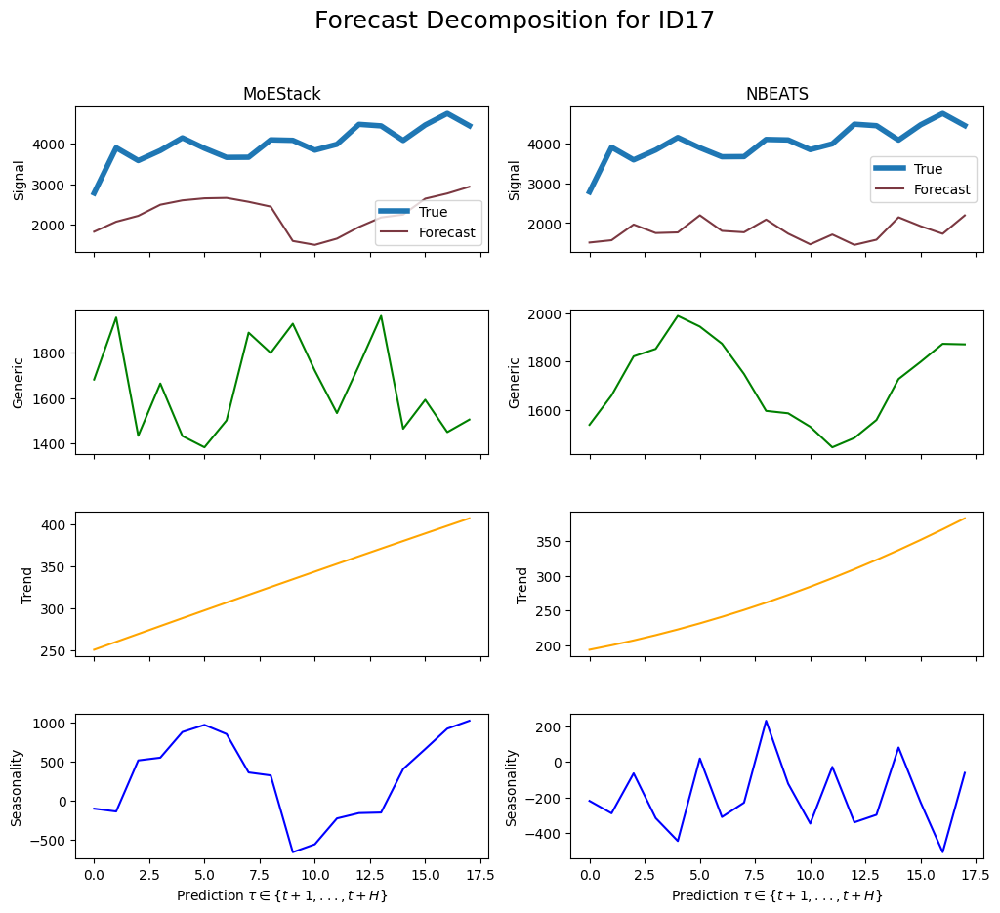

     unique_id         ds            y
1422      ID17 2003-07-31  2782.439941
1423      ID17 2003-08-31  3903.489990
1424      ID17 2003-09-30  3587.199951
1425      ID17 2003-10-31  3835.350098
1426      ID17 2003-11-30  4149.029785
1427      ID17 2003-12-31  3890.429932
1428      ID17 2004-01-31  3665.479980
1429      ID17 2004-02-29  3669.280029
1430      ID17 2004-03-31  4099.549805
1431      ID17 2004-04-30  4087.439941
1432      ID17 2004-05-31  3844.620117
1433      ID17 2004-06-30  3989.250000
1434      ID17 2004-07-31  4483.109863
1435      ID17 2004-08-31  4445.339844
1436      ID17 2004-09-30  4084.300049
1437      ID17 2004-10-31  4467.700195
1438      ID17 2004-11-30  4752.930176
1439      ID17 2004-12-31  4448.899902
Gate values for ID170: [0.27103552 0.25648668 0.4724778 ]
sMAPE for MoEStack: 0.40771421731488844
sMAPE for NBEATS: 0.4196622898341962


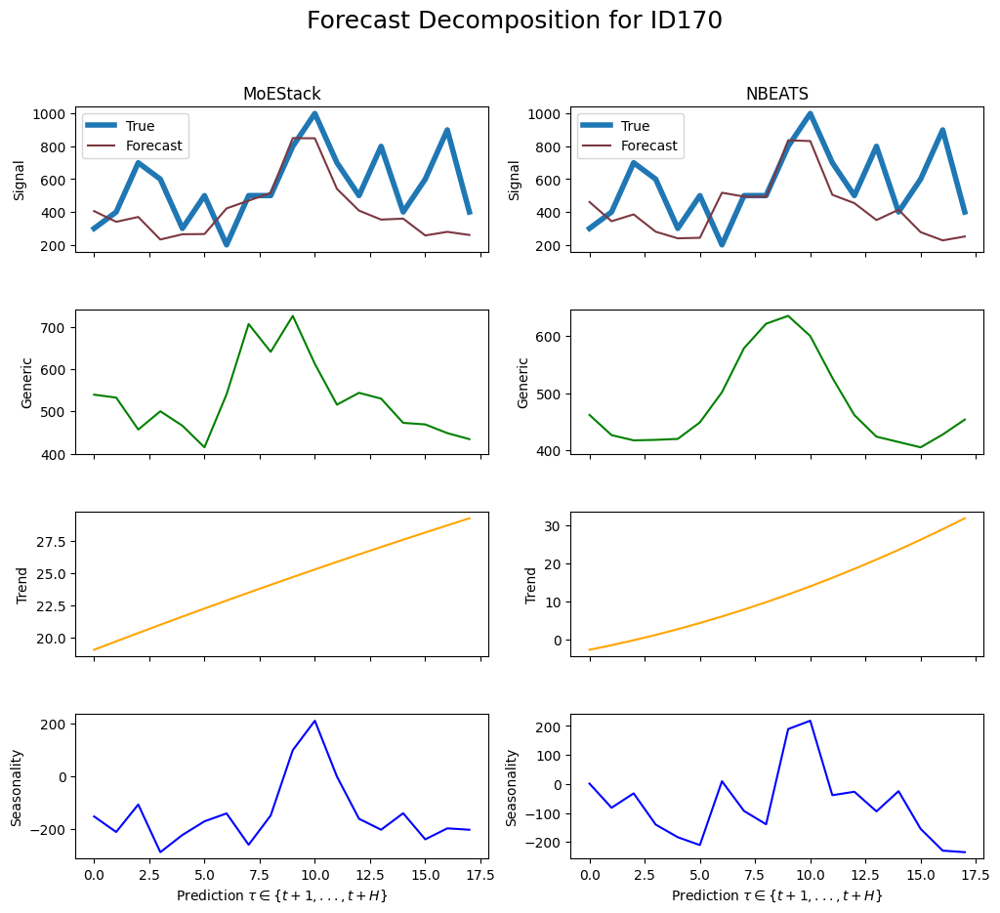

     unique_id         ds       y
1440     ID170 2004-02-29   300.0
1441     ID170 2004-03-31   400.0
1442     ID170 2004-04-30   700.0
1443     ID170 2004-05-31   600.0
1444     ID170 2004-06-30   300.0
1445     ID170 2004-07-31   500.0
1446     ID170 2004-08-31   200.0
1447     ID170 2004-09-30   500.0
1448     ID170 2004-10-31   500.0
1449     ID170 2004-11-30   800.0
1450     ID170 2004-12-31  1000.0
1451     ID170 2005-01-31   700.0
1452     ID170 2005-02-28   500.0
1453     ID170 2005-03-31   800.0
1454     ID170 2005-04-30   400.0
1455     ID170 2005-05-31   600.0
1456     ID170 2005-06-30   900.0
1457     ID170 2005-07-31   400.0
Gate values for ID171: [0.19954641 0.26662788 0.5338257 ]
sMAPE for MoEStack: 0.12177495598622985
sMAPE for NBEATS: 0.14369895113690026


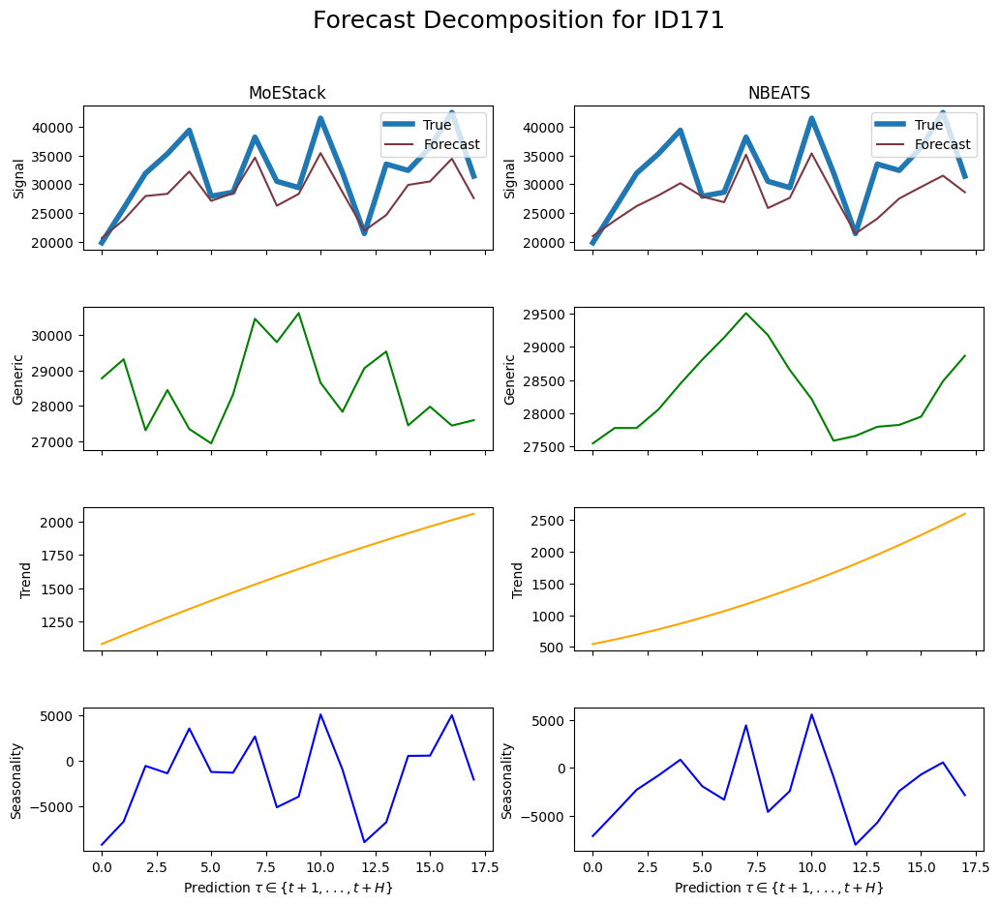

     unique_id         ds        y
1458     ID171 2004-02-29  19800.0
1459     ID171 2004-03-31  25800.0
1460     ID171 2004-04-30  31900.0
1461     ID171 2004-05-31  35300.0
1462     ID171 2004-06-30  39400.0
1463     ID171 2004-07-31  27900.0
1464     ID171 2004-08-31  28600.0
1465     ID171 2004-09-30  38200.0
1466     ID171 2004-10-31  30500.0
1467     ID171 2004-11-30  29400.0
1468     ID171 2004-12-31  41500.0
1469     ID171 2005-01-31  32000.0
1470     ID171 2005-02-28  21400.0
1471     ID171 2005-03-31  33500.0
1472     ID171 2005-04-30  32400.0
1473     ID171 2005-05-31  36400.0
1474     ID171 2005-06-30  42500.0
1475     ID171 2005-07-31  31400.0
Gate values for ID172: [0.28261188 0.31399482 0.40339333]
sMAPE for MoEStack: 0.3014464711392169
sMAPE for NBEATS: 0.2619798434403116


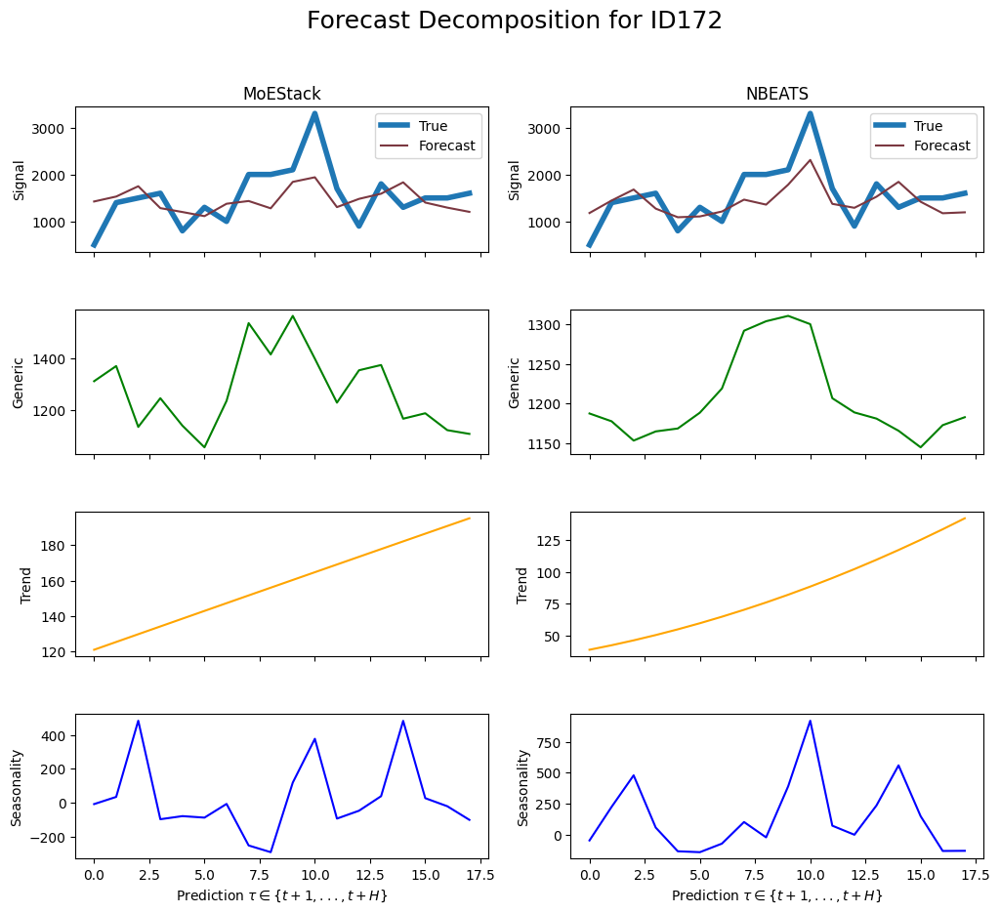

     unique_id         ds       y
1476     ID172 2004-02-29   500.0
1477     ID172 2004-03-31  1400.0
1478     ID172 2004-04-30  1500.0
1479     ID172 2004-05-31  1600.0
1480     ID172 2004-06-30   800.0
1481     ID172 2004-07-31  1300.0
1482     ID172 2004-08-31  1000.0
1483     ID172 2004-09-30  2000.0
1484     ID172 2004-10-31  2000.0
1485     ID172 2004-11-30  2100.0
1486     ID172 2004-12-31  3300.0
1487     ID172 2005-01-31  1700.0
1488     ID172 2005-02-28   900.0
1489     ID172 2005-03-31  1800.0
1490     ID172 2005-04-30  1300.0
1491     ID172 2005-05-31  1500.0
1492     ID172 2005-06-30  1500.0
1493     ID172 2005-07-31  1600.0
Gate values for ID173: [0.19112837 0.285128   0.5237436 ]
sMAPE for MoEStack: 0.1279345831846188
sMAPE for NBEATS: 0.14484296644113326


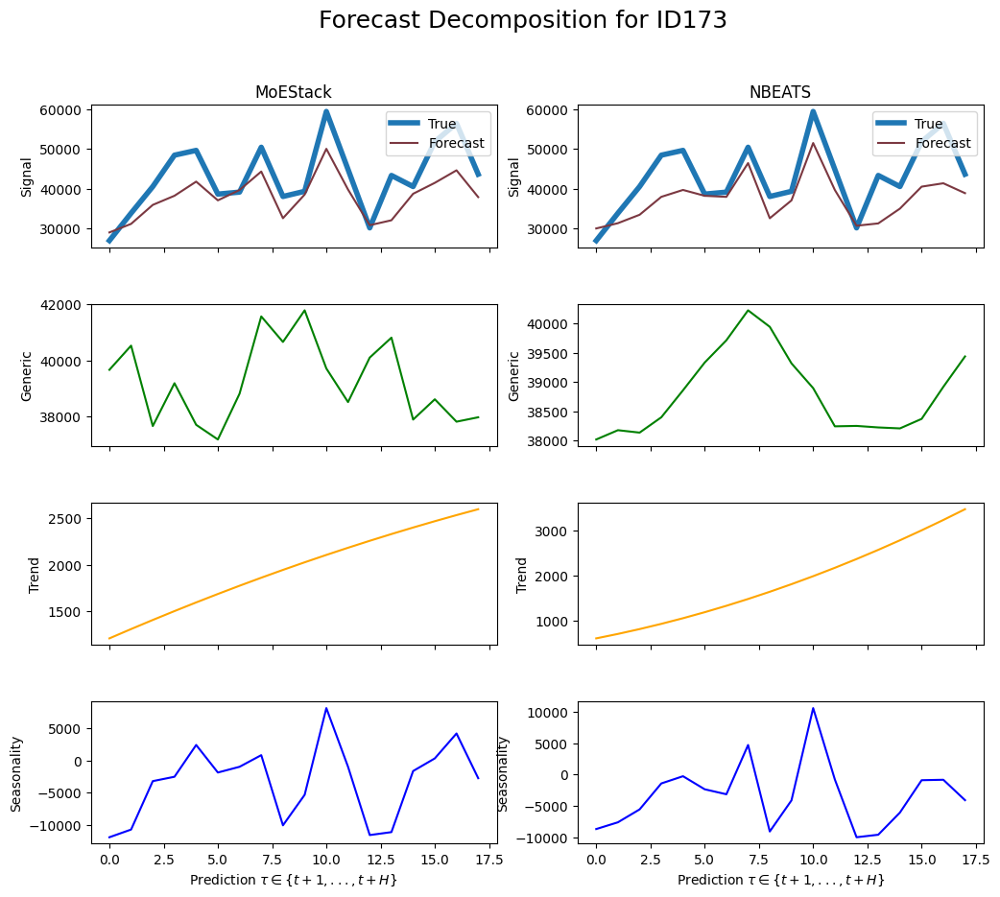

     unique_id         ds        y
1494     ID173 2004-02-29  26900.0
1495     ID173 2004-03-31  33800.0
1496     ID173 2004-04-30  40500.0
1497     ID173 2004-05-31  48400.0
1498     ID173 2004-06-30  49600.0
1499     ID173 2004-07-31  38600.0
1500     ID173 2004-08-31  39100.0
1501     ID173 2004-09-30  50400.0
1502     ID173 2004-10-31  38000.0
1503     ID173 2004-11-30  39300.0
1504     ID173 2004-12-31  59400.0
1505     ID173 2005-01-31  44800.0
1506     ID173 2005-02-28  30100.0
1507     ID173 2005-03-31  43300.0
1508     ID173 2005-04-30  40500.0
1509     ID173 2005-05-31  51800.0
1510     ID173 2005-06-30  56400.0
1511     ID173 2005-07-31  43600.0
Gate values for ID174: [0.38076675 0.34929502 0.2699382 ]
sMAPE for MoEStack: 0.6394392977588405
sMAPE for NBEATS: 0.3523713387610784


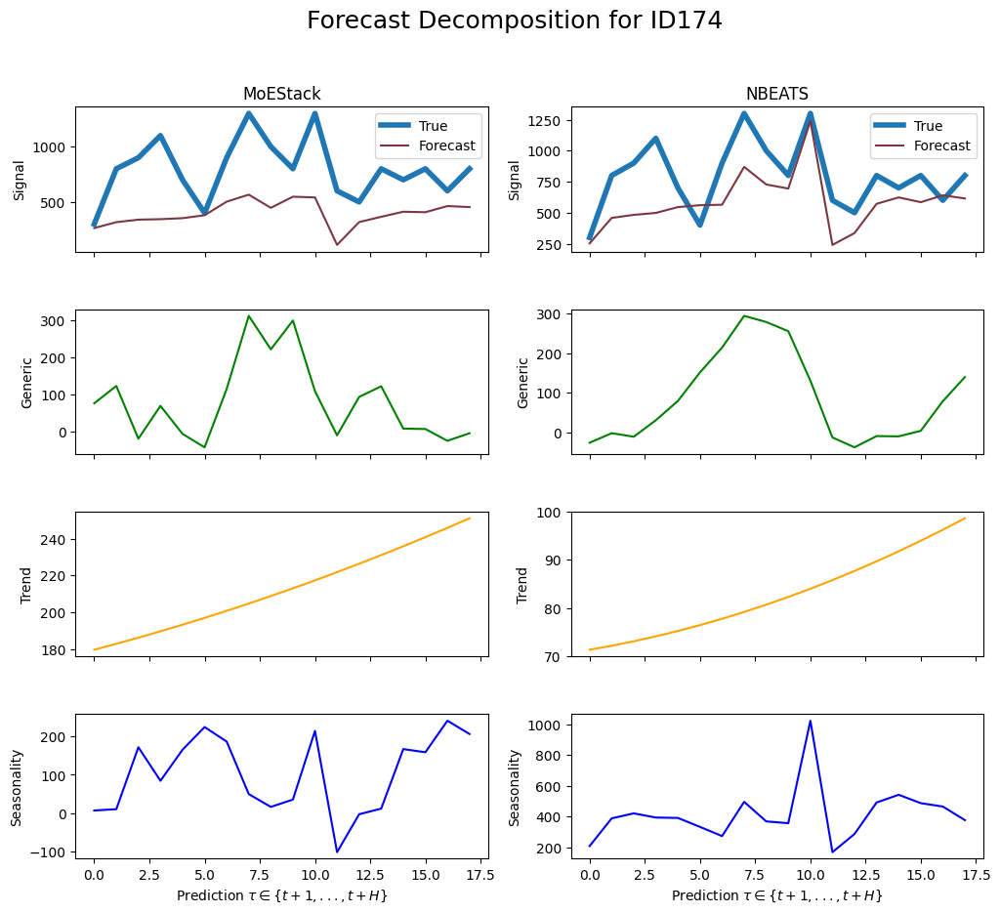

     unique_id         ds       y
1512     ID174 2004-02-29   300.0
1513     ID174 2004-03-31   800.0
1514     ID174 2004-04-30   900.0
1515     ID174 2004-05-31  1100.0
1516     ID174 2004-06-30   700.0
1517     ID174 2004-07-31   400.0
1518     ID174 2004-08-31   900.0
1519     ID174 2004-09-30  1300.0
1520     ID174 2004-10-31  1000.0
1521     ID174 2004-11-30   800.0
1522     ID174 2004-12-31  1300.0
1523     ID174 2005-01-31   600.0
1524     ID174 2005-02-28   500.0
1525     ID174 2005-03-31   800.0
1526     ID174 2005-04-30   700.0
1527     ID174 2005-05-31   800.0
1528     ID174 2005-06-30   600.0
1529     ID174 2005-07-31   800.0
Gate values for ID175: [0.3514177  0.34996998 0.2986123 ]
sMAPE for MoEStack: 0.13774641294702408
sMAPE for NBEATS: 0.13646920978653468


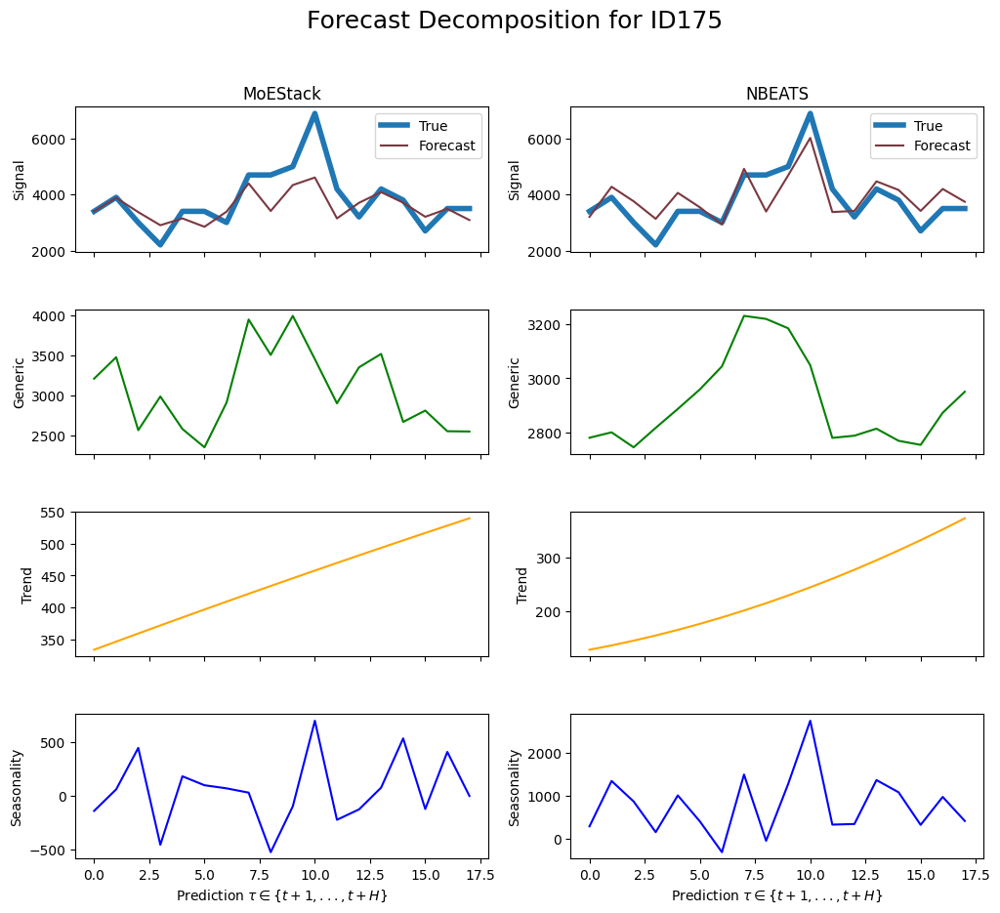

     unique_id         ds       y
1530     ID175 2004-02-29  3400.0
1531     ID175 2004-03-31  3900.0
1532     ID175 2004-04-30  3000.0
1533     ID175 2004-05-31  2200.0
1534     ID175 2004-06-30  3400.0
1535     ID175 2004-07-31  3400.0
1536     ID175 2004-08-31  3000.0
1537     ID175 2004-09-30  4700.0
1538     ID175 2004-10-31  4700.0
1539     ID175 2004-11-30  5000.0
1540     ID175 2004-12-31  6900.0
1541     ID175 2005-01-31  4200.0
1542     ID175 2005-02-28  3200.0
1543     ID175 2005-03-31  4200.0
1544     ID175 2005-04-30  3800.0
1545     ID175 2005-05-31  2700.0
1546     ID175 2005-06-30  3500.0
1547     ID175 2005-07-31  3500.0
Gate values for ID176: [0.19322298 0.16622019 0.6405569 ]
sMAPE for MoEStack: 0.14028788219642865
sMAPE for NBEATS: 0.16764874373579963


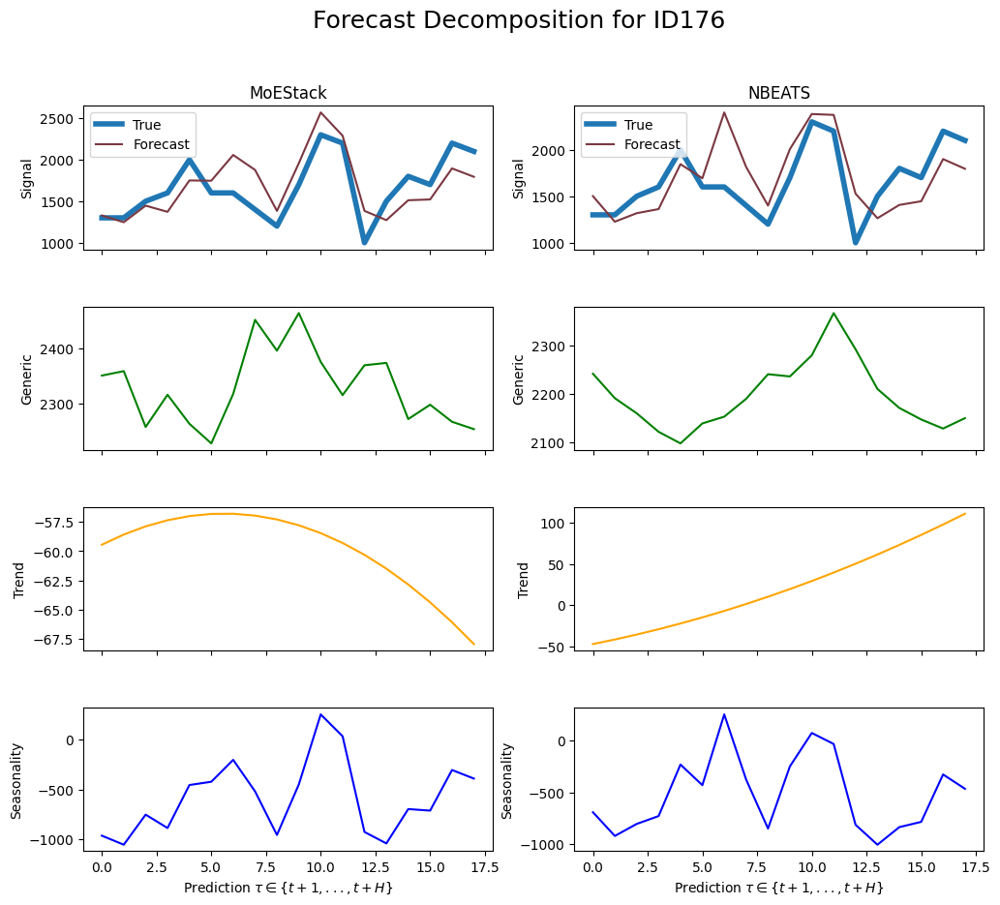

     unique_id         ds       y
1548     ID176 2004-02-29  1300.0
1549     ID176 2004-03-31  1300.0
1550     ID176 2004-04-30  1500.0
1551     ID176 2004-05-31  1600.0
1552     ID176 2004-06-30  2000.0
1553     ID176 2004-07-31  1600.0
1554     ID176 2004-08-31  1600.0
1555     ID176 2004-09-30  1400.0
1556     ID176 2004-10-31  1200.0
1557     ID176 2004-11-30  1700.0
1558     ID176 2004-12-31  2300.0
1559     ID176 2005-01-31  2200.0
1560     ID176 2005-02-28  1000.0
1561     ID176 2005-03-31  1500.0
1562     ID176 2005-04-30  1800.0
1563     ID176 2005-05-31  1700.0
1564     ID176 2005-06-30  2200.0
1565     ID176 2005-07-31  2100.0
Gate values for ID177: [0.32072663 0.31258914 0.36668426]
sMAPE for MoEStack: 0.10541223112670361
sMAPE for NBEATS: 0.08558222480598908


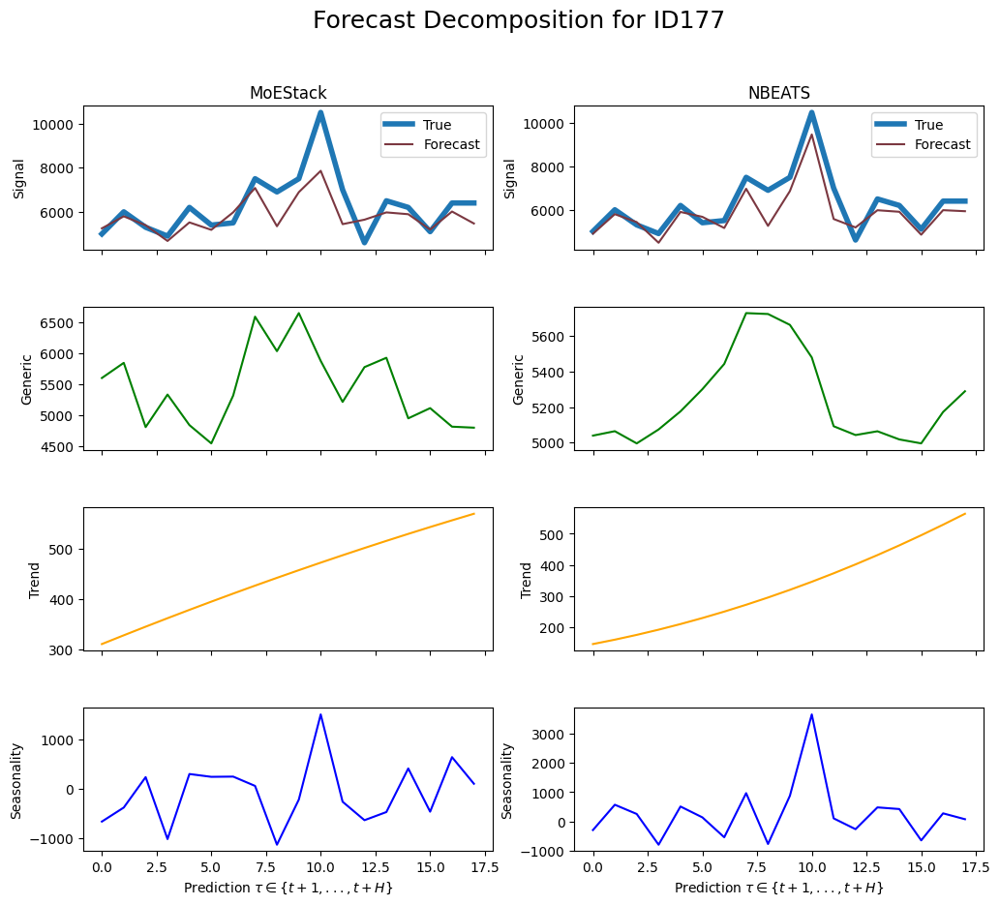

     unique_id         ds        y
1566     ID177 2004-02-29   5000.0
1567     ID177 2004-03-31   6000.0
1568     ID177 2004-04-30   5300.0
1569     ID177 2004-05-31   4900.0
1570     ID177 2004-06-30   6200.0
1571     ID177 2004-07-31   5400.0
1572     ID177 2004-08-31   5500.0
1573     ID177 2004-09-30   7500.0
1574     ID177 2004-10-31   6900.0
1575     ID177 2004-11-30   7500.0
1576     ID177 2004-12-31  10500.0
1577     ID177 2005-01-31   7000.0
1578     ID177 2005-02-28   4600.0
1579     ID177 2005-03-31   6500.0
1580     ID177 2005-04-30   6200.0
1581     ID177 2005-05-31   5100.0
1582     ID177 2005-06-30   6400.0
1583     ID177 2005-07-31   6400.0
Gate values for ID178: [0.25412163 0.33770105 0.40817735]
sMAPE for MoEStack: 0.4348297827029686
sMAPE for NBEATS: 0.4707298844104418


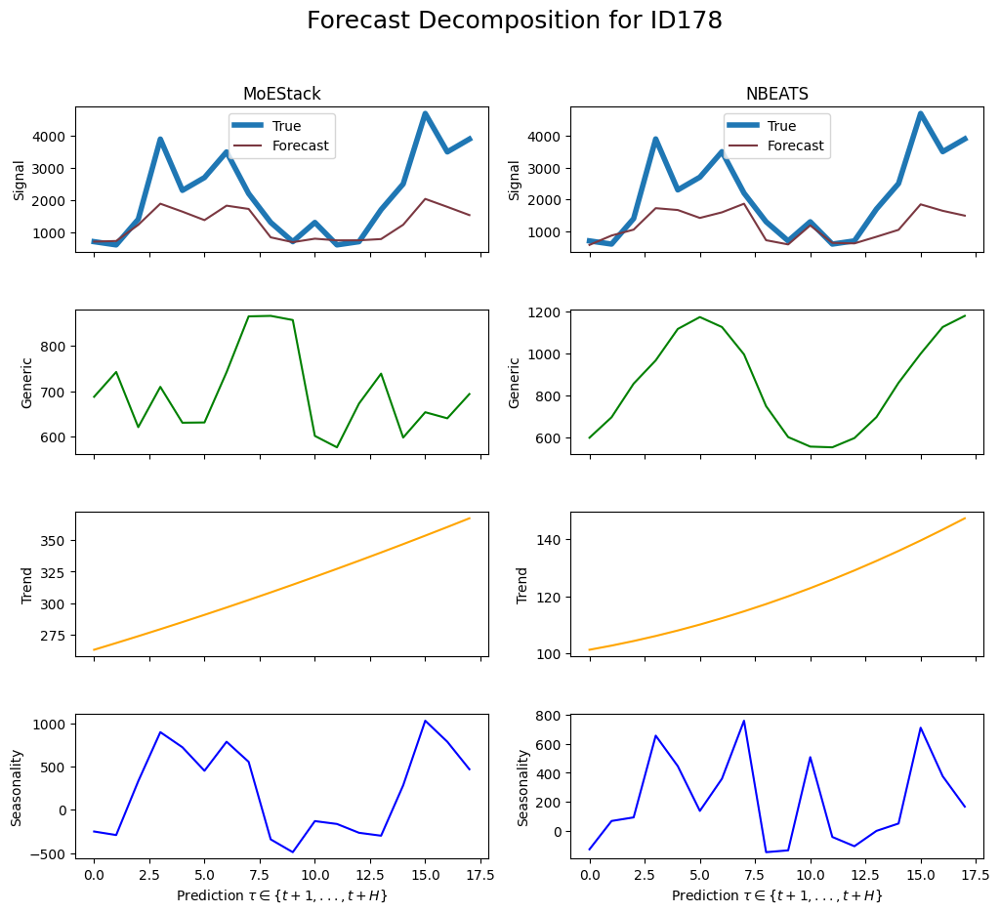

     unique_id         ds       y
1584     ID178 2004-02-29   700.0
1585     ID178 2004-03-31   600.0
1586     ID178 2004-04-30  1400.0
1587     ID178 2004-05-31  3900.0
1588     ID178 2004-06-30  2300.0
1589     ID178 2004-07-31  2700.0
1590     ID178 2004-08-31  3500.0
1591     ID178 2004-09-30  2200.0
1592     ID178 2004-10-31  1300.0
1593     ID178 2004-11-30   700.0
1594     ID178 2004-12-31  1300.0
1595     ID178 2005-01-31   600.0
1596     ID178 2005-02-28   700.0
1597     ID178 2005-03-31  1700.0
1598     ID178 2005-04-30  2500.0
1599     ID178 2005-05-31  4700.0
1600     ID178 2005-06-30  3500.0
1601     ID178 2005-07-31  3900.0
Gate values for ID179: [0.24019907 0.29580212 0.4639988 ]
sMAPE for MoEStack: 0.14362036026521735
sMAPE for NBEATS: 0.15554259712433877


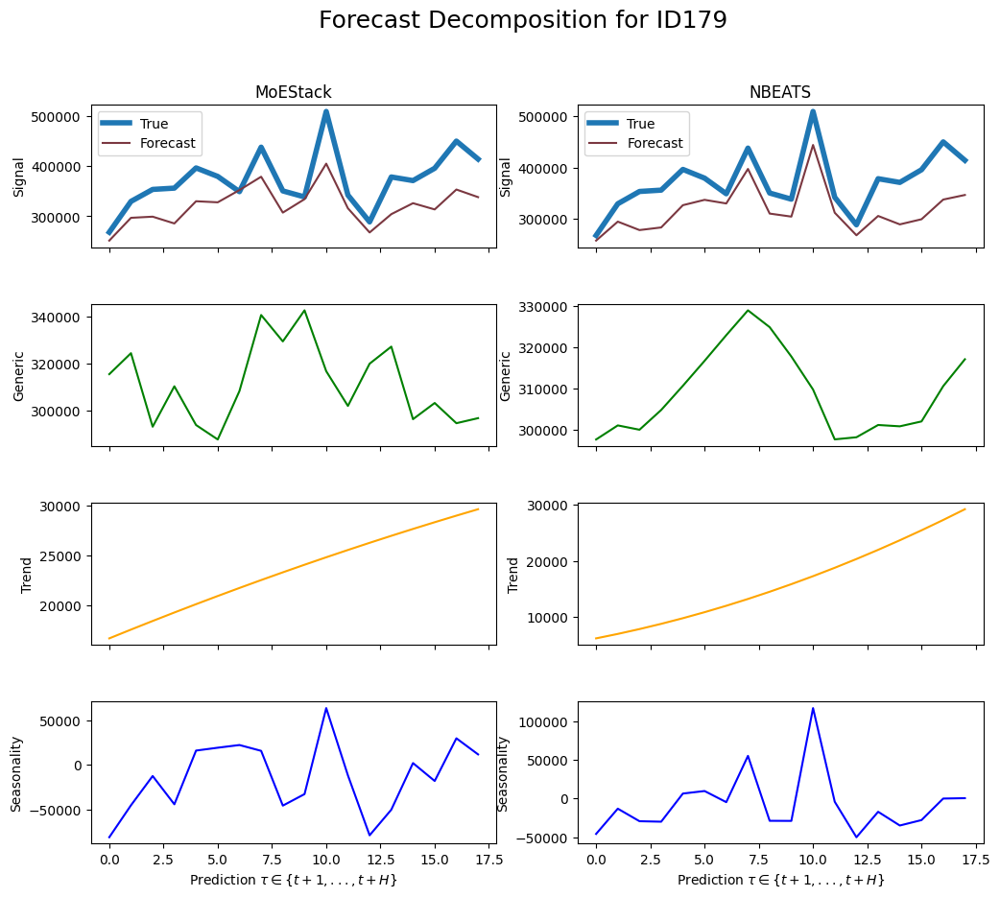

     unique_id         ds         y
1602     ID179 2004-02-29  268200.0
1603     ID179 2004-03-31  329700.0
1604     ID179 2004-04-30  353600.0
1605     ID179 2004-05-31  356200.0
1606     ID179 2004-06-30  396500.0
1607     ID179 2004-07-31  379500.0
1608     ID179 2004-08-31  349100.0
1609     ID179 2004-09-30  437900.0
1610     ID179 2004-10-31  350600.0
1611     ID179 2004-11-30  338600.0
1612     ID179 2004-12-31  509100.0
1613     ID179 2005-01-31  342300.0
1614     ID179 2005-02-28  288800.0
1615     ID179 2005-03-31  378400.0
1616     ID179 2005-04-30  371200.0
1617     ID179 2005-05-31  395800.0
1618     ID179 2005-06-30  450000.0
1619     ID179 2005-07-31  414100.0
Gate values for ID18: [0.21164173 0.18942198 0.59893626]
sMAPE for MoEStack: 0.11605832514040913
sMAPE for NBEATS: 0.133470839522147


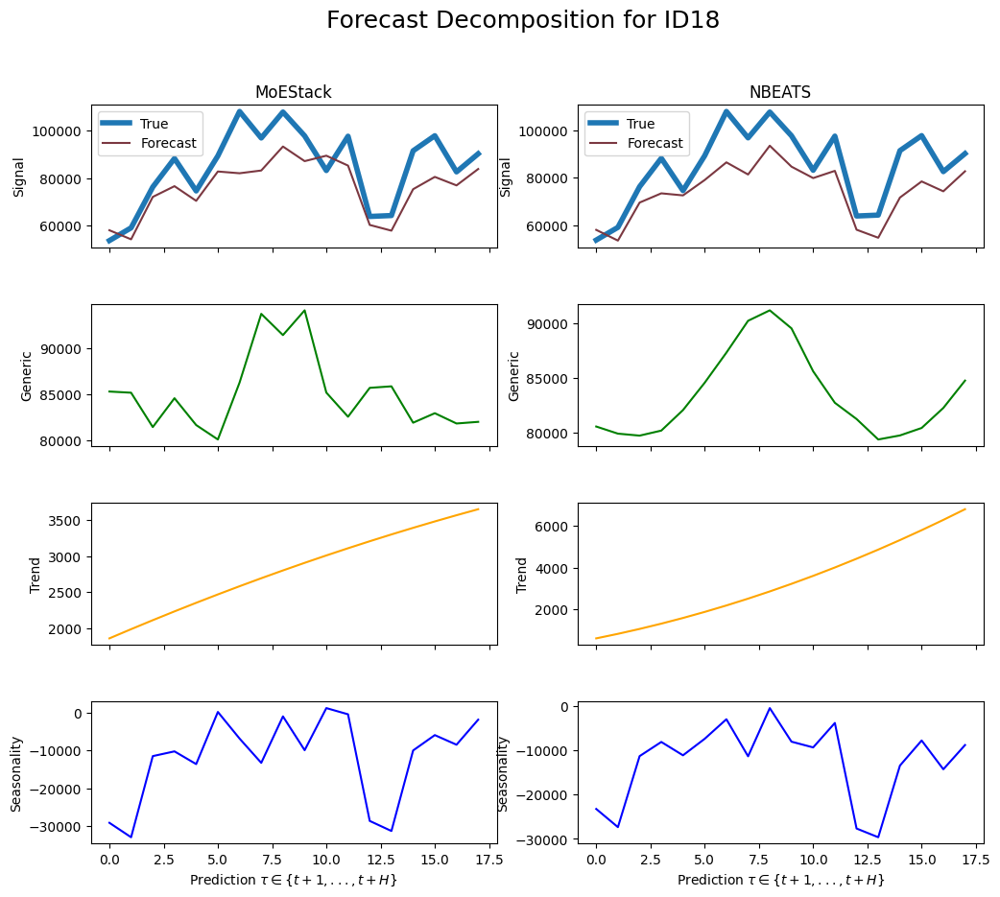

     unique_id         ds         y
1620      ID18 2004-01-31   53616.0
1621      ID18 2004-02-29   59004.0
1622      ID18 2004-03-31   76253.0
1623      ID18 2004-04-30   88301.0
1624      ID18 2004-05-31   74581.0
1625      ID18 2004-06-30   89380.0
1626      ID18 2004-07-31  108134.0
1627      ID18 2004-08-31   96925.0
1628      ID18 2004-09-30  107897.0
1629      ID18 2004-10-31   97830.0
1630      ID18 2004-11-30   83193.0
1631      ID18 2004-12-31   97686.0
1632      ID18 2005-01-31   63809.0
1633      ID18 2005-02-28   64198.0
1634      ID18 2005-03-31   91520.0
1635      ID18 2005-04-30   97894.0
1636      ID18 2005-05-31   82614.0
1637      ID18 2005-06-30   90274.0
Gate values for ID180: [0.2561281  0.17467824 0.56919366]
sMAPE for MoEStack: 0.24255401285783865
sMAPE for NBEATS: 0.2394285075849384


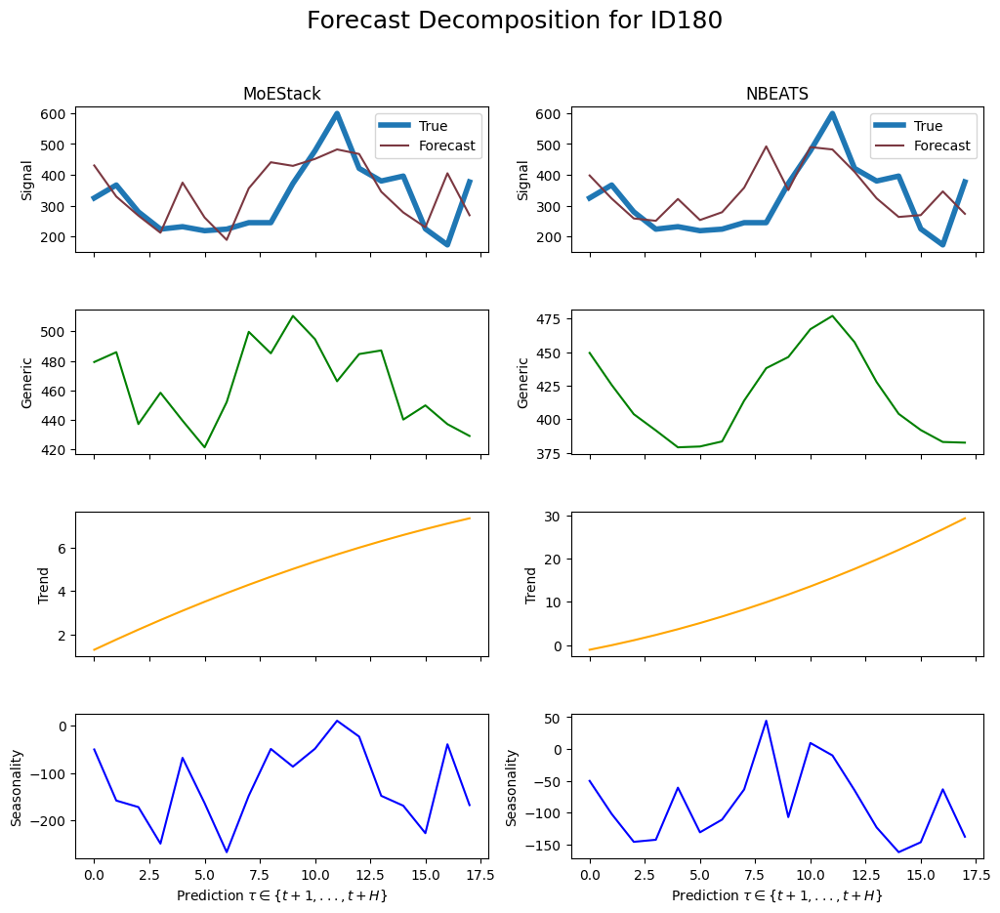

     unique_id         ds      y
1638     ID180 2004-02-29  325.0
1639     ID180 2004-03-31  367.0
1640     ID180 2004-04-30  280.0
1641     ID180 2004-05-31  224.0
1642     ID180 2004-06-30  232.0
1643     ID180 2004-07-31  219.0
1644     ID180 2004-08-31  224.0
1645     ID180 2004-09-30  245.0
1646     ID180 2004-10-31  245.0
1647     ID180 2004-11-30  372.0
1648     ID180 2004-12-31  478.0
1649     ID180 2005-01-31  599.0
1650     ID180 2005-02-28  421.0
1651     ID180 2005-03-31  380.0
1652     ID180 2005-04-30  396.0
1653     ID180 2005-05-31  225.0
1654     ID180 2005-06-30  173.0
1655     ID180 2005-07-31  377.0
Gate values for ID181: [0.22136544 0.18879788 0.5898367 ]
sMAPE for MoEStack: 0.12318362521935493
sMAPE for NBEATS: 0.12406035831948972


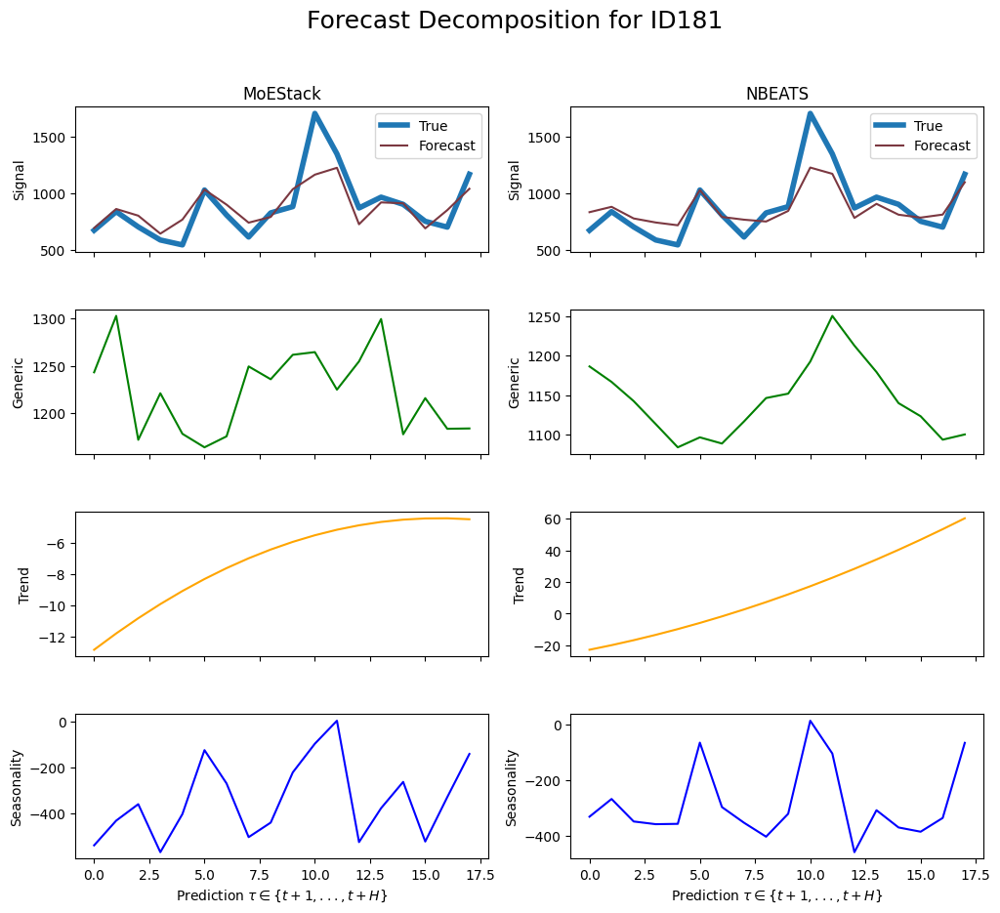

     unique_id         ds       y
1656     ID181 2004-02-29   674.0
1657     ID181 2004-03-31   838.0
1658     ID181 2004-04-30   704.0
1659     ID181 2004-05-31   589.0
1660     ID181 2004-06-30   546.0
1661     ID181 2004-07-31  1028.0
1662     ID181 2004-08-31   808.0
1663     ID181 2004-09-30   615.0
1664     ID181 2004-10-31   827.0
1665     ID181 2004-11-30   882.0
1666     ID181 2004-12-31  1700.0
1667     ID181 2005-01-31  1345.0
1668     ID181 2005-02-28   870.0
1669     ID181 2005-03-31   965.0
1670     ID181 2005-04-30   902.0
1671     ID181 2005-05-31   753.0
1672     ID181 2005-06-30   702.0
1673     ID181 2005-07-31  1166.0
Gate values for ID182: [0.23929518 0.24156916 0.51913565]
sMAPE for MoEStack: 0.25608839788226573
sMAPE for NBEATS: 0.23950656188354585


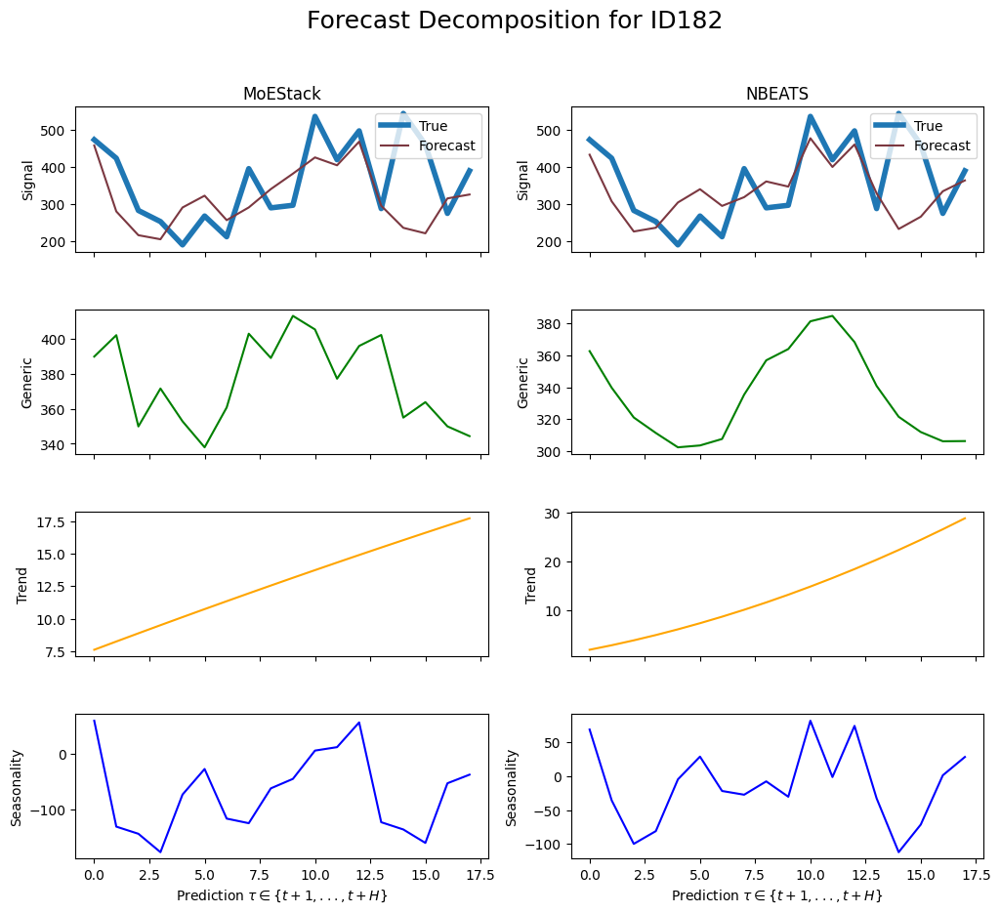

     unique_id         ds      y
1674     ID182 2004-02-29  473.0
1675     ID182 2004-03-31  423.0
1676     ID182 2004-04-30  282.0
1677     ID182 2004-05-31  252.0
1678     ID182 2004-06-30  189.0
1679     ID182 2004-07-31  267.0
1680     ID182 2004-08-31  211.0
1681     ID182 2004-09-30  395.0
1682     ID182 2004-10-31  289.0
1683     ID182 2004-11-30  296.0
1684     ID182 2004-12-31  536.0
1685     ID182 2005-01-31  419.0
1686     ID182 2005-02-28  497.0
1687     ID182 2005-03-31  287.0
1688     ID182 2005-04-30  544.0
1689     ID182 2005-05-31  460.0
1690     ID182 2005-06-30  274.0
1691     ID182 2005-07-31  389.0
Gate values for ID183: [0.46897456 0.2868366  0.24418882]
sMAPE for MoEStack: 0.4690845081967498
sMAPE for NBEATS: 0.394078103518496


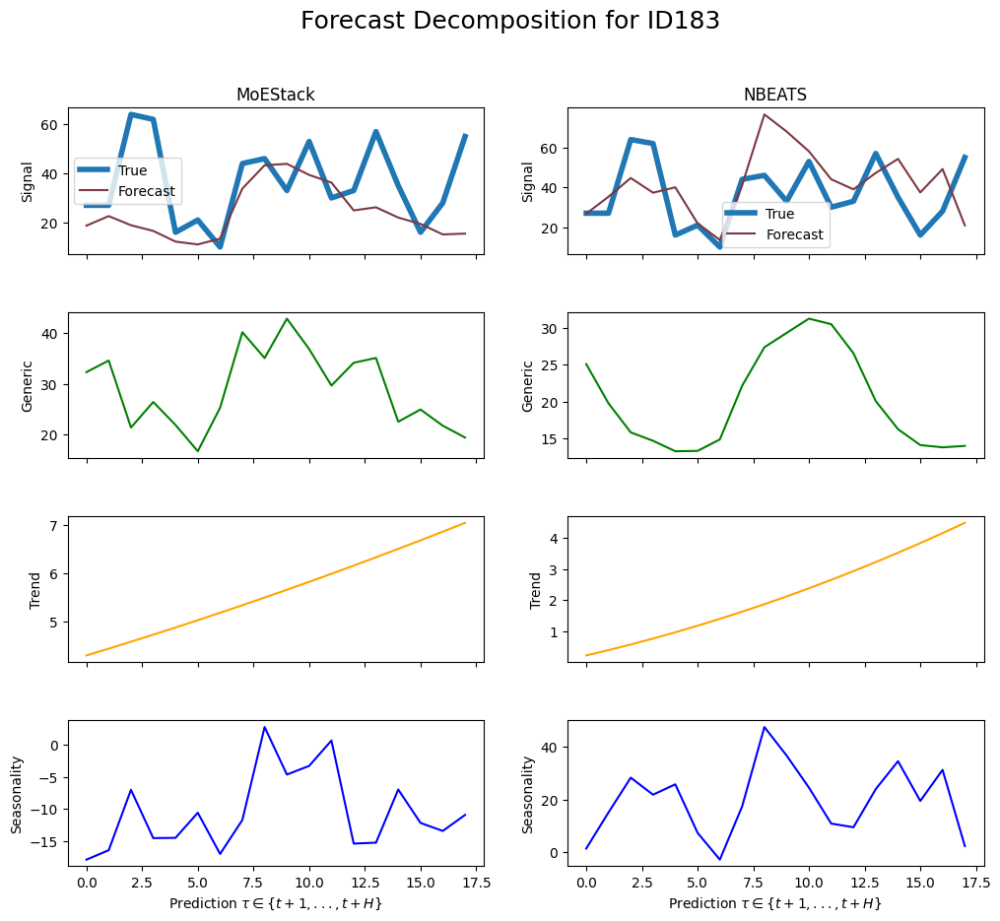

     unique_id         ds     y
1692     ID183 2004-02-29  27.0
1693     ID183 2004-03-31  27.0
1694     ID183 2004-04-30  64.0
1695     ID183 2004-05-31  62.0
1696     ID183 2004-06-30  16.0
1697     ID183 2004-07-31  21.0
1698     ID183 2004-08-31  10.0
1699     ID183 2004-09-30  44.0
1700     ID183 2004-10-31  46.0
1701     ID183 2004-11-30  33.0
1702     ID183 2004-12-31  53.0
1703     ID183 2005-01-31  30.0
1704     ID183 2005-02-28  33.0
1705     ID183 2005-03-31  57.0
1706     ID183 2005-04-30  35.0
1707     ID183 2005-05-31  16.0
1708     ID183 2005-06-30  28.0
1709     ID183 2005-07-31  55.0
Gate values for ID184: [0.29872495 0.3093545  0.3919206 ]
sMAPE for MoEStack: 0.26828871516155584
sMAPE for NBEATS: 0.20216606874808574


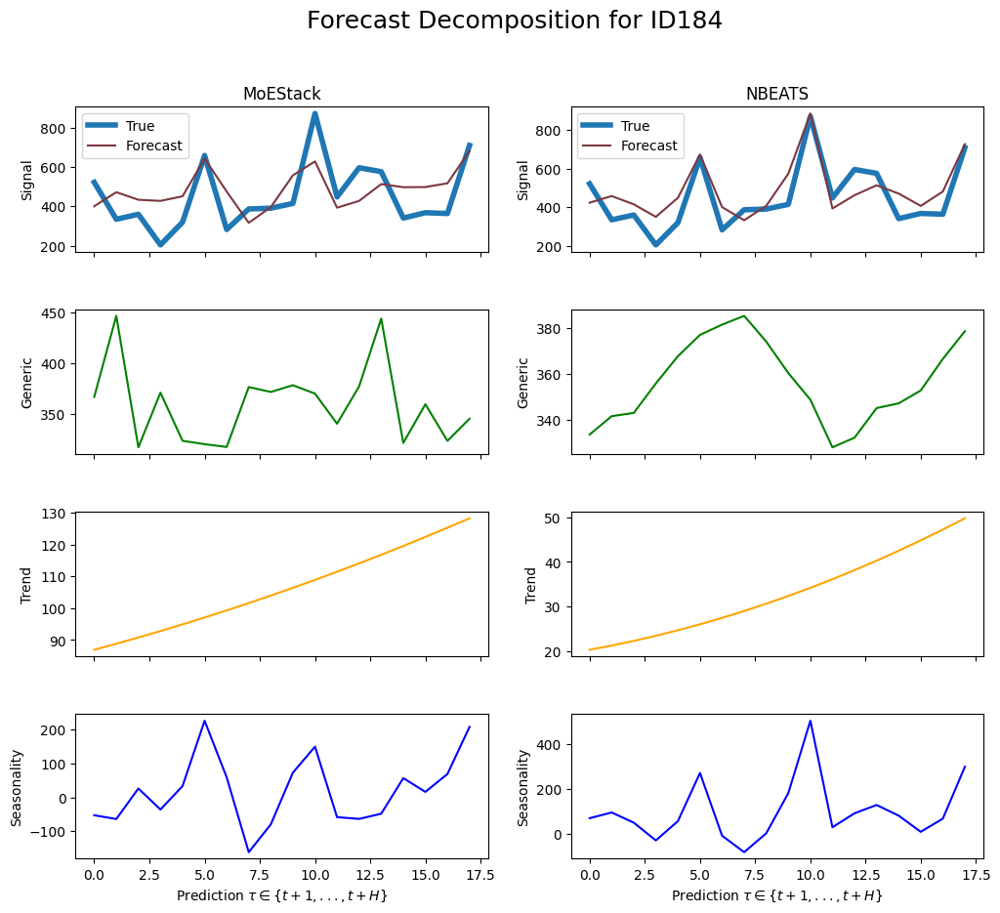

     unique_id         ds      y
1710     ID184 2004-02-29  522.0
1711     ID184 2004-03-31  335.0
1712     ID184 2004-04-30  360.0
1713     ID184 2004-05-31  205.0
1714     ID184 2004-06-30  320.0
1715     ID184 2004-07-31  658.0
1716     ID184 2004-08-31  283.0
1717     ID184 2004-09-30  387.0
1718     ID184 2004-10-31  391.0
1719     ID184 2004-11-30  415.0
1720     ID184 2004-12-31  871.0
1721     ID184 2005-01-31  448.0
1722     ID184 2005-02-28  596.0
1723     ID184 2005-03-31  576.0
1724     ID184 2005-04-30  341.0
1725     ID184 2005-05-31  368.0
1726     ID184 2005-06-30  364.0
1727     ID184 2005-07-31  709.0
Gate values for ID185: [0.252253   0.21381669 0.5339303 ]
sMAPE for MoEStack: 0.13714139130654818
sMAPE for NBEATS: 0.11845152409229898


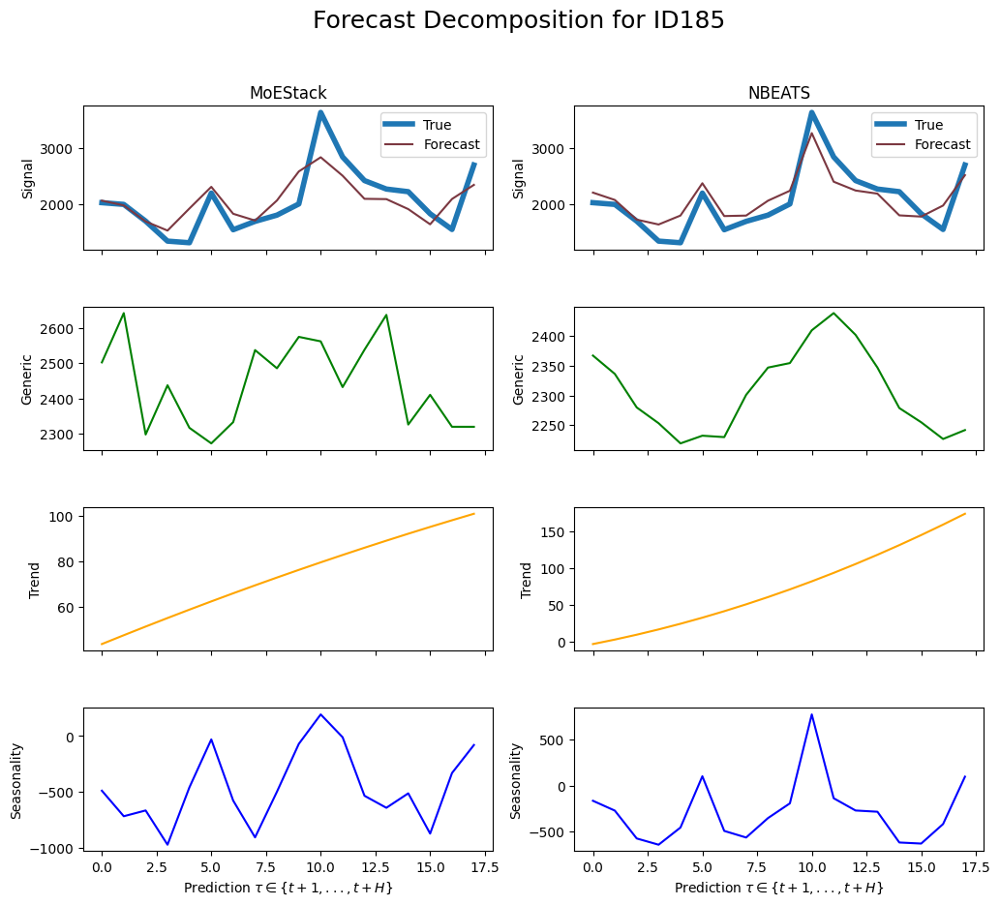

     unique_id         ds       y
1728     ID185 2004-02-29  2021.0
1729     ID185 2004-03-31  1990.0
1730     ID185 2004-04-30  1690.0
1731     ID185 2004-05-31  1332.0
1732     ID185 2004-06-30  1303.0
1733     ID185 2004-07-31  2193.0
1734     ID185 2004-08-31  1536.0
1735     ID185 2004-09-30  1686.0
1736     ID185 2004-10-31  1798.0
1737     ID185 2004-11-30  1998.0
1738     ID185 2004-12-31  3638.0
1739     ID185 2005-01-31  2841.0
1740     ID185 2005-02-28  2417.0
1741     ID185 2005-03-31  2265.0
1742     ID185 2005-04-30  2218.0
1743     ID185 2005-05-31  1822.0
1744     ID185 2005-06-30  1541.0
1745     ID185 2005-07-31  2696.0
Gate values for ID186: [0.25742522 0.1531248  0.58944994]
sMAPE for MoEStack: 0.10661425667839224
sMAPE for NBEATS: 0.09623278318081462


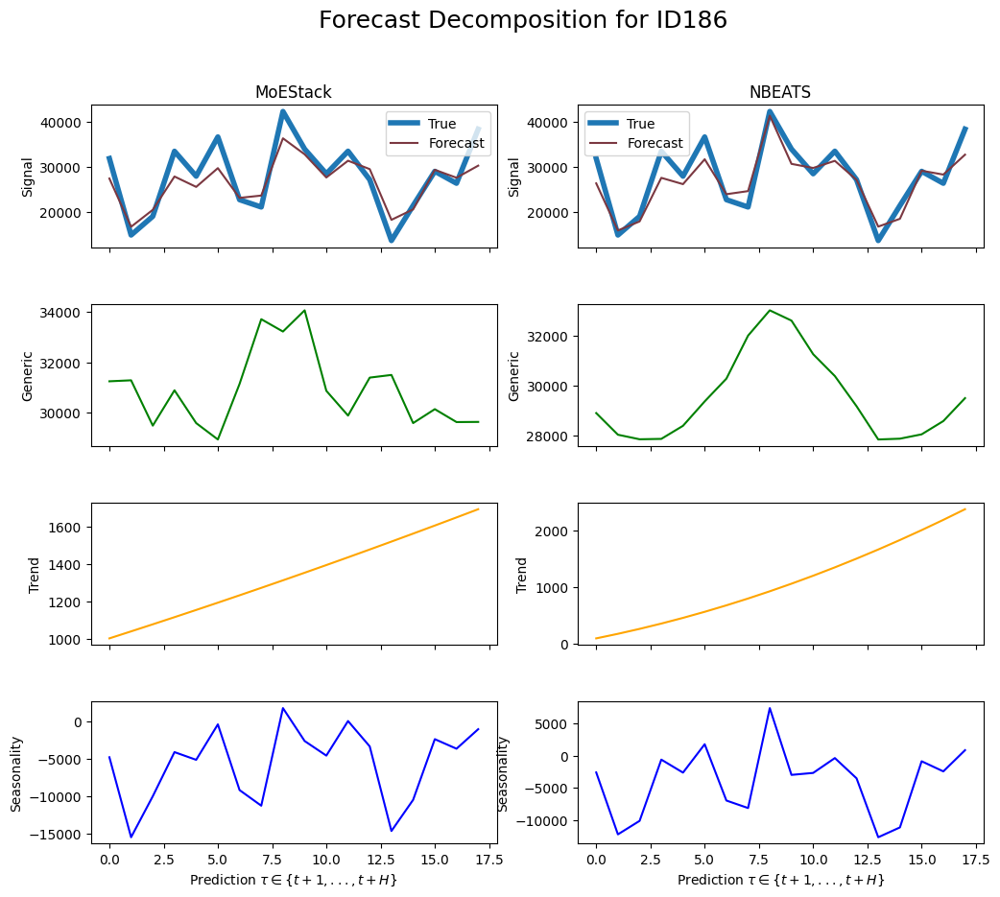

     unique_id         ds        y
1746     ID186 2004-04-30  31857.0
1747     ID186 2004-05-31  14994.0
1748     ID186 2004-06-30  19120.0
1749     ID186 2004-07-31  33460.0
1750     ID186 2004-08-31  27962.0
1751     ID186 2004-09-30  36620.0
1752     ID186 2004-10-31  22785.0
1753     ID186 2004-11-30  21168.0
1754     ID186 2004-12-31  42225.0
1755     ID186 2005-01-31  33930.0
1756     ID186 2005-02-28  28490.0
1757     ID186 2005-03-31  33475.0
1758     ID186 2005-04-30  27192.0
1759     ID186 2005-05-31  13775.0
1760     ID186 2005-06-30  21489.0
1761     ID186 2005-07-31  29040.0
1762     ID186 2005-08-31  26397.0
1763     ID186 2005-09-30  38324.0
Gate values for ID187: [0.33818492 0.17396156 0.48785353]
sMAPE for MoEStack: 0.10402651432325345
sMAPE for NBEATS: 0.09239690709610802


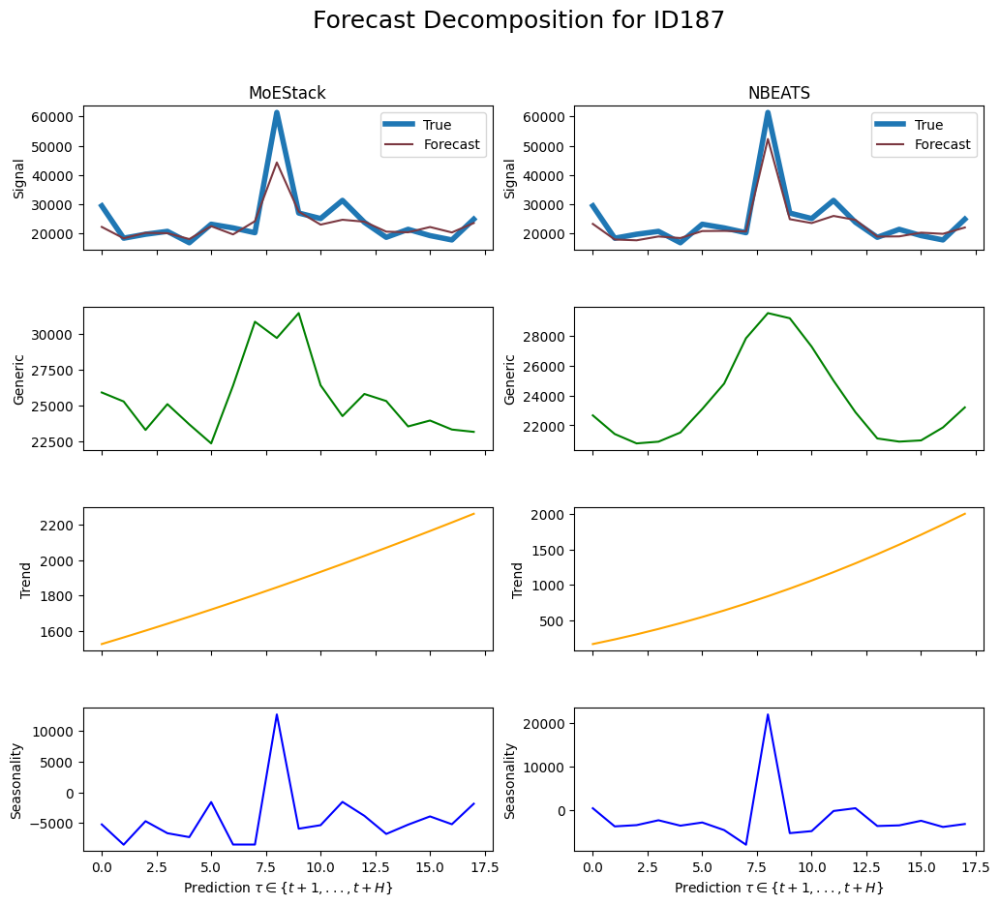

     unique_id         ds        y
1764     ID187 2004-04-30  29421.0
1765     ID187 2004-05-31  18360.0
1766     ID187 2004-06-30  19712.0
1767     ID187 2004-07-31  20700.0
1768     ID187 2004-08-31  16808.0
1769     ID187 2004-09-30  23140.0
1770     ID187 2004-10-31  21882.0
1771     ID187 2004-11-30  20244.0
1772     ID187 2004-12-31  61375.0
1773     ID187 2005-01-31  26970.0
1774     ID187 2005-02-28  25080.0
1775     ID187 2005-03-31  31300.0
1776     ID187 2005-04-30  23808.0
1777     ID187 2005-05-31  18658.0
1778     ID187 2005-06-30  21394.0
1779     ID187 2005-07-31  19248.0
1780     ID187 2005-08-31  17766.0
1781     ID187 2005-09-30  24860.0
Gate values for ID188: [0.15850474 0.2560147  0.5854806 ]
sMAPE for MoEStack: 0.08166568263747746
sMAPE for NBEATS: 0.078057538410376


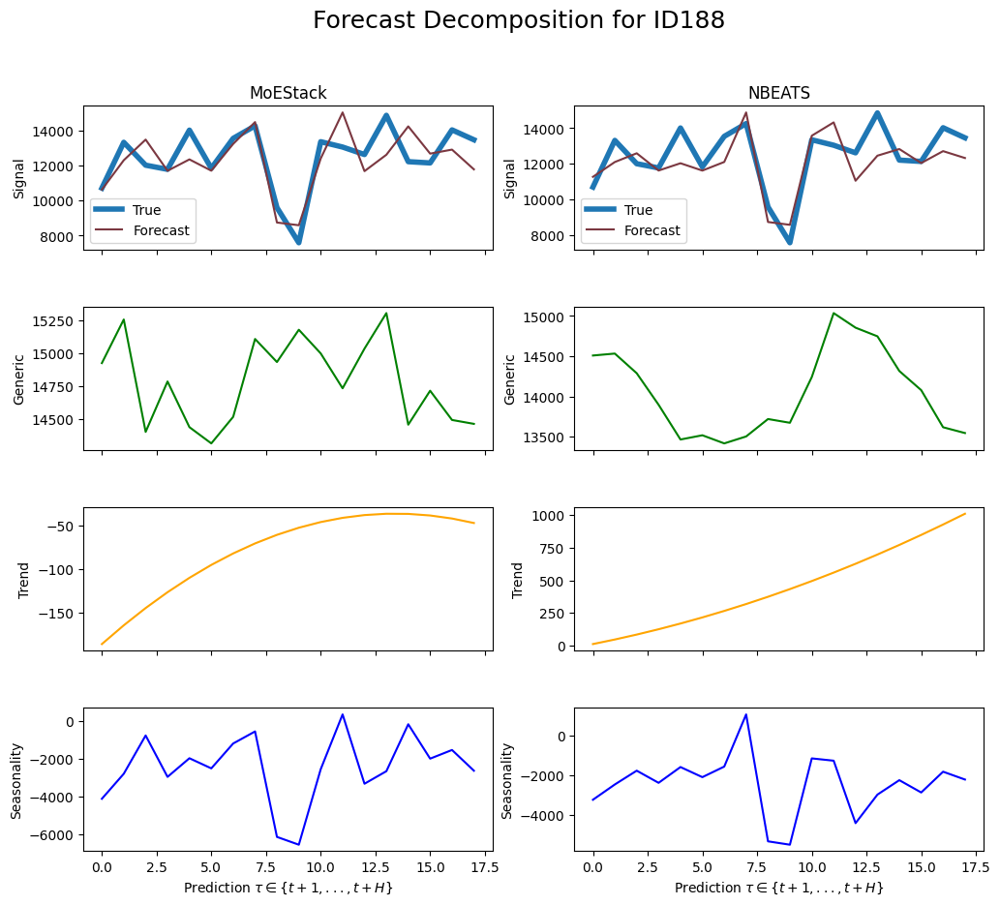

     unique_id         ds        y
1782     ID188 2004-04-30  10710.0
1783     ID188 2004-05-31  13320.0
1784     ID188 2004-06-30  12016.0
1785     ID188 2004-07-31  11780.0
1786     ID188 2004-08-31  14014.0
1787     ID188 2004-09-30  11840.0
1788     ID188 2004-10-31  13545.0
1789     ID188 2004-11-30  14259.0
1790     ID188 2004-12-31   9600.0
1791     ID188 2005-01-31   7598.0
1792     ID188 2005-02-28  13354.0
1793     ID188 2005-03-31  13050.0
1794     ID188 2005-04-30  12624.0
1795     ID188 2005-05-31  14858.0
1796     ID188 2005-06-30  12217.0
1797     ID188 2005-07-31  12144.0
1798     ID188 2005-08-31  14028.0
1799     ID188 2005-09-30  13464.0
Gate values for ID189: [0.18516237 0.20269945 0.6121382 ]
sMAPE for MoEStack: 0.07083147560335538
sMAPE for NBEATS: 0.05358449011484292


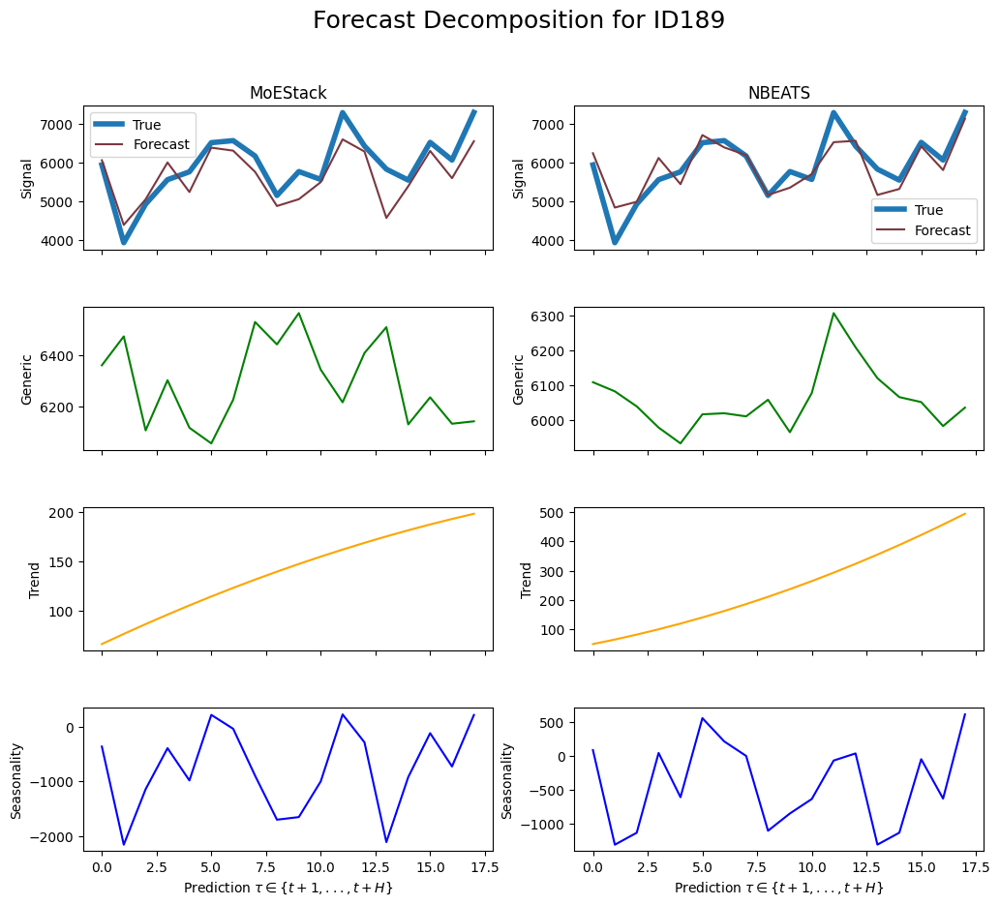

     unique_id         ds       y
1800     ID189 2004-04-30  5943.0
1801     ID189 2004-05-31  3924.0
1802     ID189 2004-06-30  4928.0
1803     ID189 2004-07-31  5560.0
1804     ID189 2004-08-31  5764.0
1805     ID189 2004-09-30  6520.0
1806     ID189 2004-10-31  6573.0
1807     ID189 2004-11-30  6174.0
1808     ID189 2004-12-31  5150.0
1809     ID189 2005-01-31  5771.0
1810     ID189 2005-02-28  5566.0
1811     ID189 2005-03-31  7300.0
1812     ID189 2005-04-30  6432.0
1813     ID189 2005-05-31  5833.0
1814     ID189 2005-06-30  5548.0
1815     ID189 2005-07-31  6528.0
1816     ID189 2005-08-31  6069.0
1817     ID189 2005-09-30  7304.0
Gate values for ID19: [0.26995414 0.2799094  0.45013636]
sMAPE for MoEStack: 0.05861394657426216
sMAPE for NBEATS: 0.07311683102427276


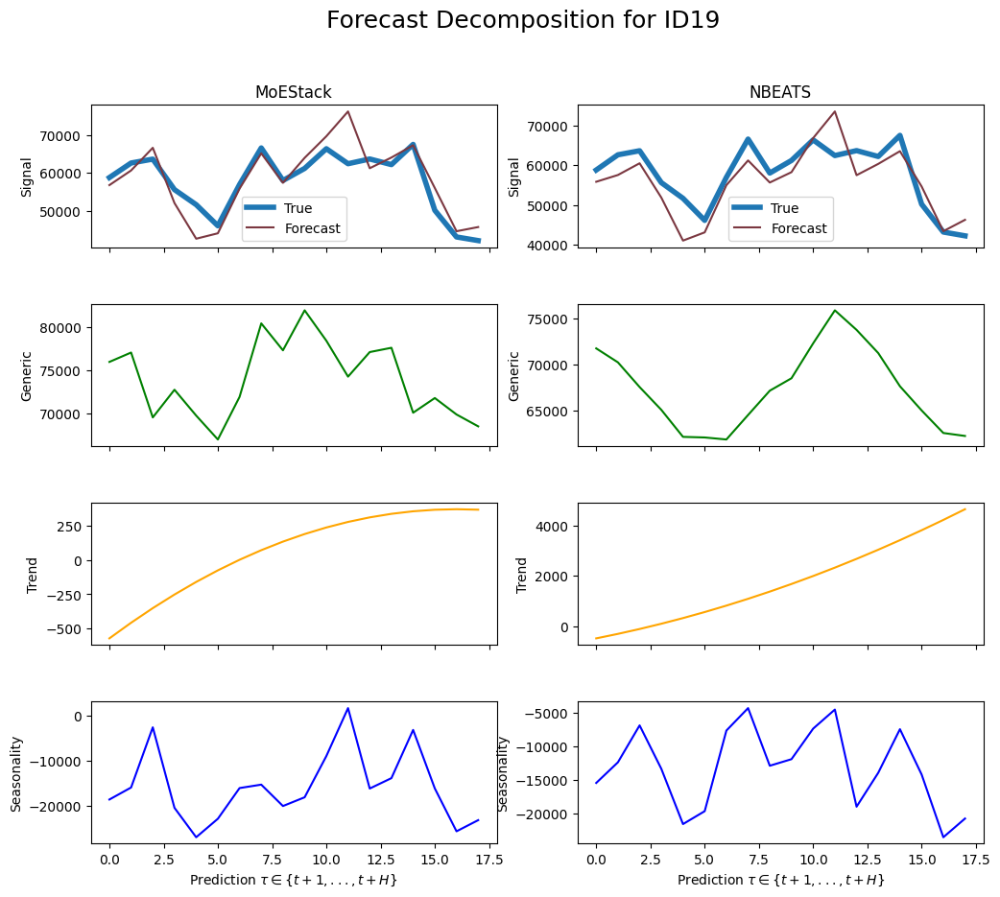

     unique_id         ds        y
1818      ID19 2004-01-31  58818.0
1819      ID19 2004-02-29  62666.0
1820      ID19 2004-03-31  63691.0
1821      ID19 2004-04-30  55630.0
1822      ID19 2004-05-31  51656.0
1823      ID19 2004-06-30  46077.0
1824      ID19 2004-07-31  56974.0
1825      ID19 2004-08-31  66641.0
1826      ID19 2004-09-30  58044.0
1827      ID19 2004-10-31  61233.0
1828      ID19 2004-11-30  66436.0
1829      ID19 2004-12-31  62474.0
1830      ID19 2005-01-31  63725.0
1831      ID19 2005-02-28  62238.0
1832      ID19 2005-03-31  67584.0
1833      ID19 2005-04-30  50167.0
1834      ID19 2005-05-31  43127.0
1835      ID19 2005-06-30  42167.0
Gate values for ID190: [0.27142027 0.15368268 0.57489705]
sMAPE for MoEStack: 0.07232289186135396
sMAPE for NBEATS: 0.0629210739130961


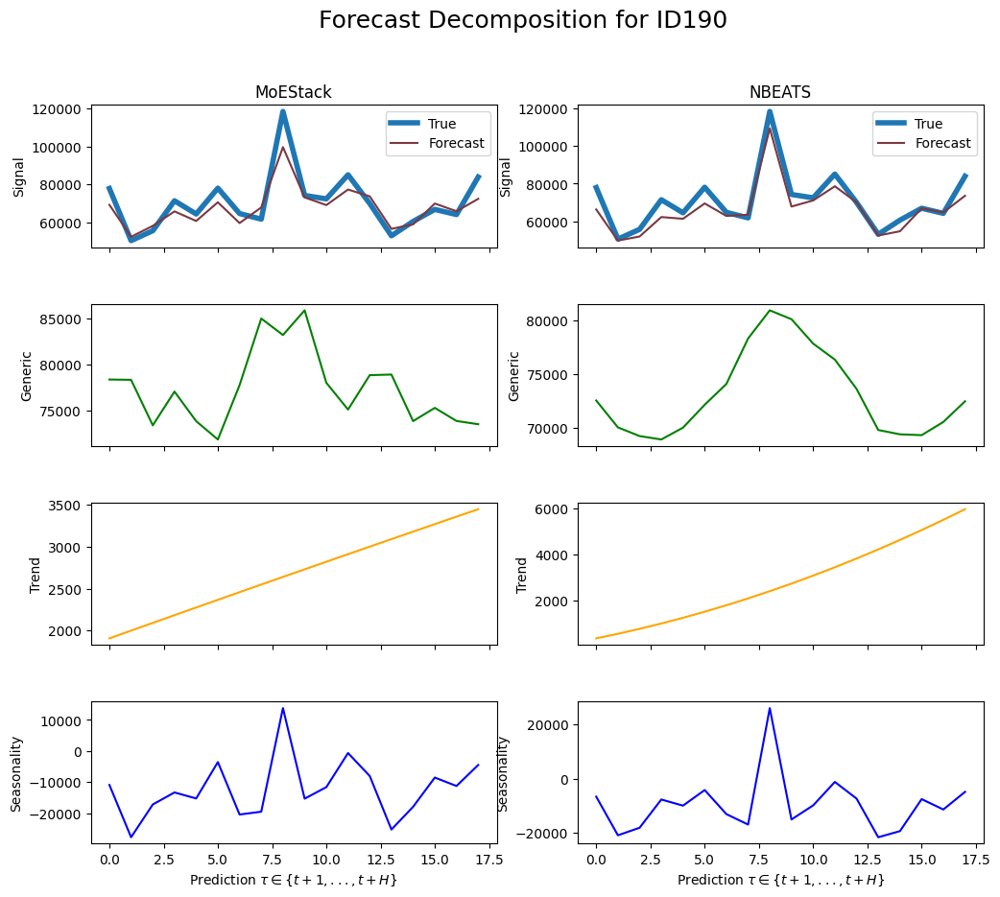

     unique_id         ds         y
1836     ID190 2004-04-30   77931.0
1837     ID190 2004-05-31   50598.0
1838     ID190 2004-06-30   55776.0
1839     ID190 2004-07-31   71500.0
1840     ID190 2004-08-31   64548.0
1841     ID190 2004-09-30   78120.0
1842     ID190 2004-10-31   64785.0
1843     ID190 2004-11-30   61845.0
1844     ID190 2004-12-31  118350.0
1845     ID190 2005-01-31   74269.0
1846     ID190 2005-02-28   72490.0
1847     ID190 2005-03-31   85125.0
1848     ID190 2005-04-30   70056.0
1849     ID190 2005-05-31   53124.0
1850     ID190 2005-06-30   60648.0
1851     ID190 2005-07-31   66960.0
1852     ID190 2005-08-31   64260.0
1853     ID190 2005-09-30   83952.0
Gate values for ID191: [0.338059   0.2262095  0.43573147]
sMAPE for MoEStack: 0.09736983682587247
sMAPE for NBEATS: 0.09420111546772113


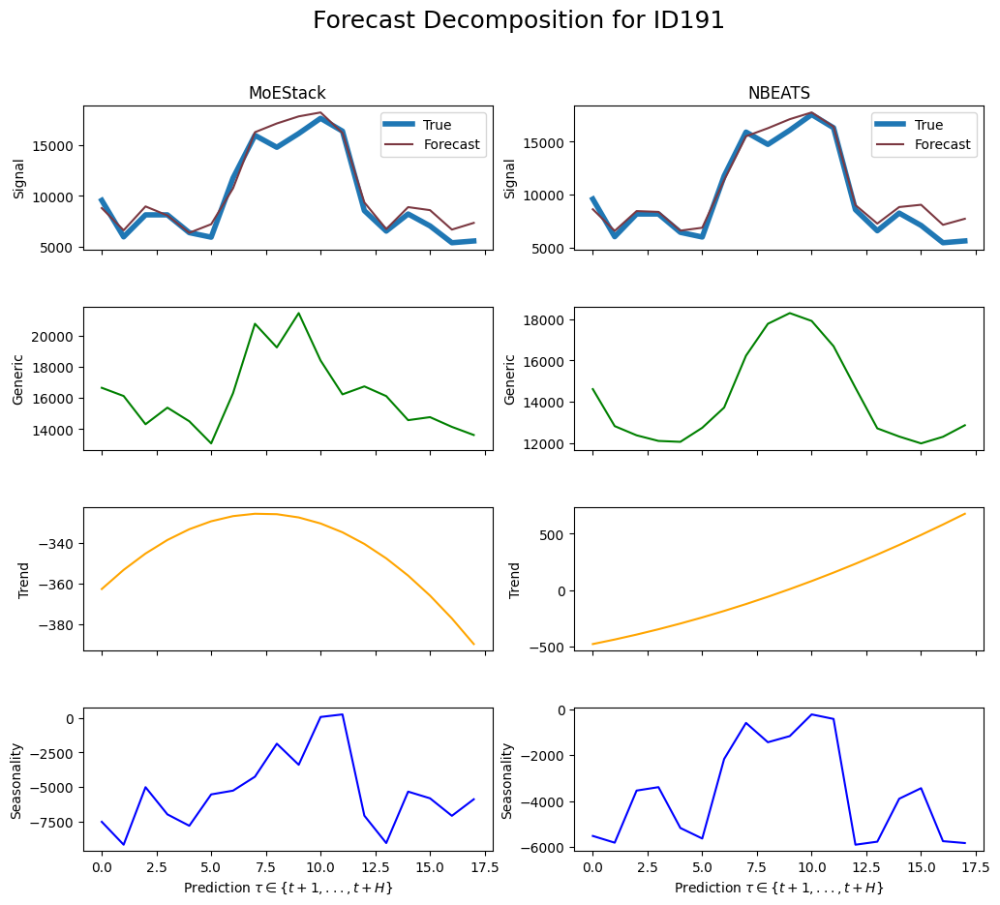

     unique_id         ds        y
1854     ID191 2004-04-30   9576.0
1855     ID191 2004-05-31   6012.0
1856     ID191 2004-06-30   8160.0
1857     ID191 2004-07-31   8160.0
1858     ID191 2004-08-31   6424.0
1859     ID191 2004-09-30   5980.0
1860     ID191 2004-10-31  11760.0
1861     ID191 2004-11-30  15918.0
1862     ID191 2004-12-31  14750.0
1863     ID191 2005-01-31  16095.0
1864     ID191 2005-02-28  17578.0
1865     ID191 2005-03-31  16325.0
1866     ID191 2005-04-30   8568.0
1867     ID191 2005-05-31   6574.0
1868     ID191 2005-06-30   8246.0
1869     ID191 2005-07-31   7080.0
1870     ID191 2005-08-31   5439.0
1871     ID191 2005-09-30   5610.0
Gate values for ID192: [0.3288218  0.18119742 0.48998076]
sMAPE for MoEStack: 0.1148881092103935
sMAPE for NBEATS: 0.0961601516764004


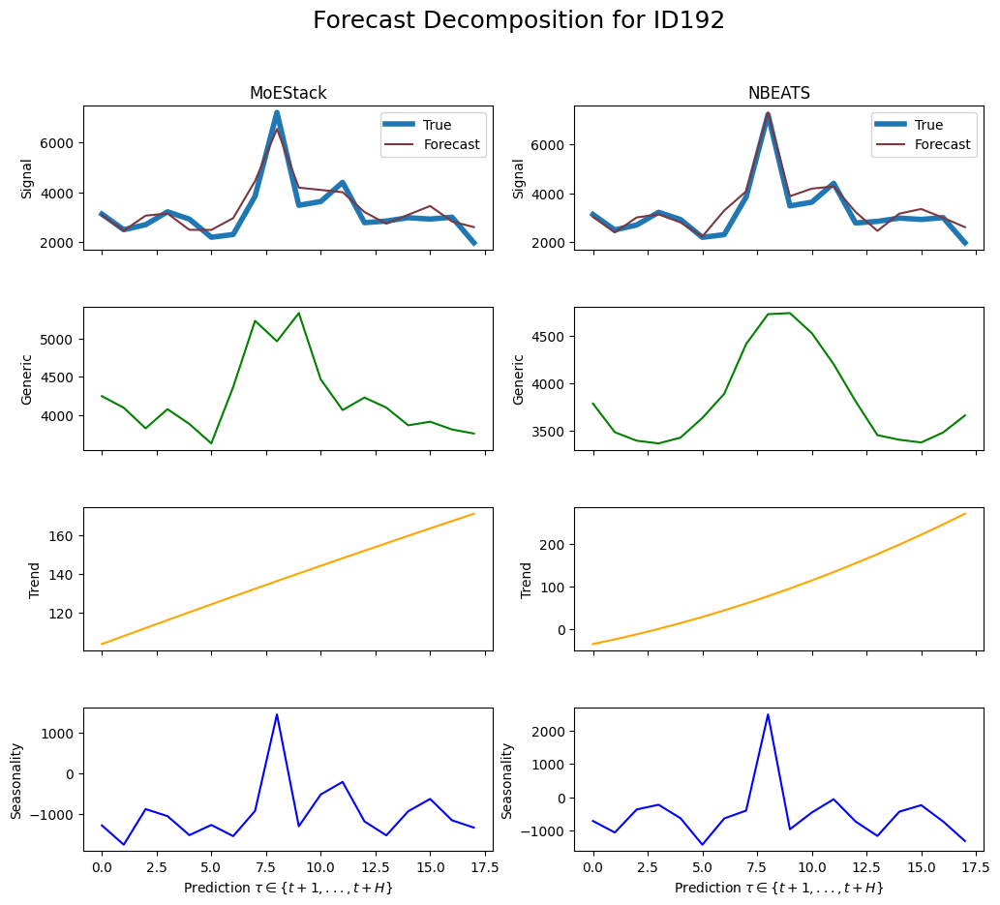

     unique_id         ds       y
1872     ID192 2004-04-30  3129.0
1873     ID192 2004-05-31  2502.0
1874     ID192 2004-06-30  2704.0
1875     ID192 2004-07-31  3220.0
1876     ID192 2004-08-31  2926.0
1877     ID192 2004-09-30  2200.0
1878     ID192 2004-10-31  2310.0
1879     ID192 2004-11-30  3843.0
1880     ID192 2004-12-31  7200.0
1881     ID192 2005-01-31  3480.0
1882     ID192 2005-02-28  3630.0
1883     ID192 2005-03-31  4400.0
1884     ID192 2005-04-30  2784.0
1885     ID192 2005-05-31  2850.0
1886     ID192 2005-06-30  2983.0
1887     ID192 2005-07-31  2928.0
1888     ID192 2005-08-31  3003.0
1889     ID192 2005-09-30  1980.0
Gate values for ID193: [0.21312177 0.28631392 0.5005644 ]
sMAPE for MoEStack: 0.09853161378442839
sMAPE for NBEATS: 0.10995109536500994


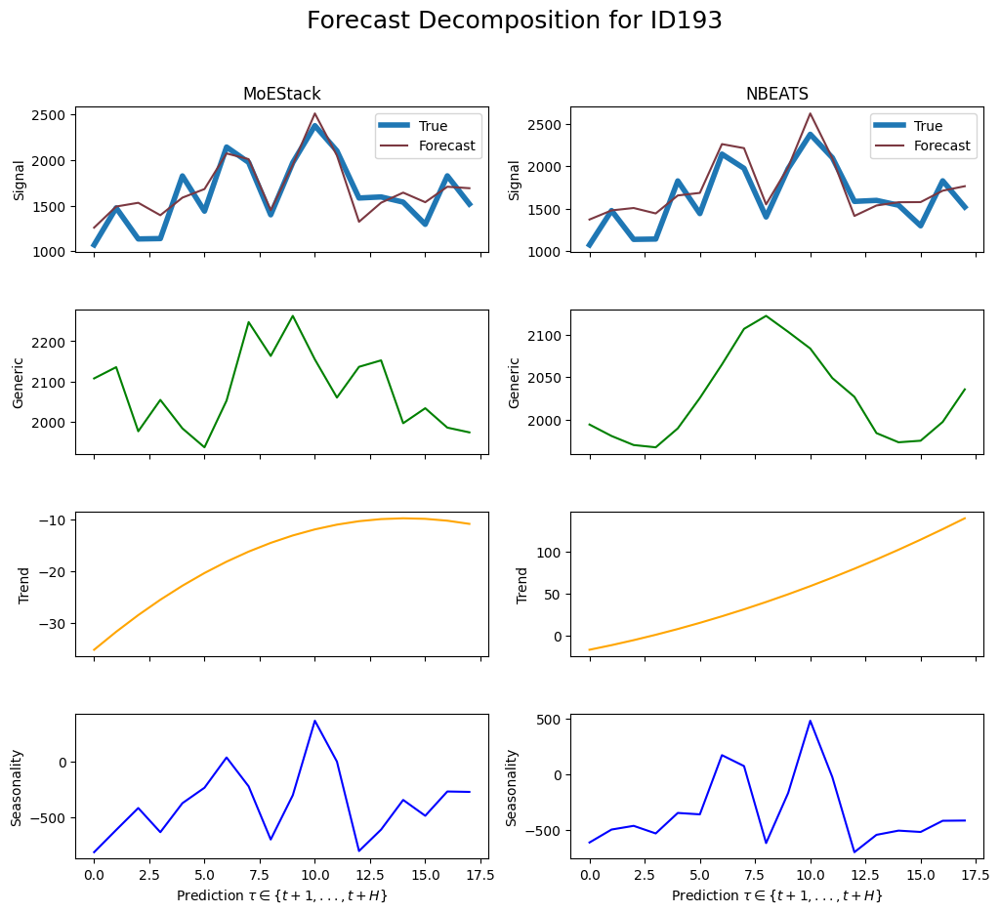

     unique_id         ds       y
1890     ID193 2004-04-30  1071.0
1891     ID193 2004-05-31  1476.0
1892     ID193 2004-06-30  1136.0
1893     ID193 2004-07-31  1140.0
1894     ID193 2004-08-31  1826.0
1895     ID193 2004-09-30  1440.0
1896     ID193 2004-10-31  2142.0
1897     ID193 2004-11-30  1974.0
1898     ID193 2004-12-31  1400.0
1899     ID193 2005-01-31  1972.0
1900     ID193 2005-02-28  2376.0
1901     ID193 2005-03-31  2100.0
1902     ID193 2005-04-30  1584.0
1903     ID193 2005-05-31  1596.0
1904     ID193 2005-06-30  1539.0
1905     ID193 2005-07-31  1296.0
1906     ID193 2005-08-31  1827.0
1907     ID193 2005-09-30  1518.0
Gate values for ID194: [0.26545608 0.23453687 0.50000703]
sMAPE for MoEStack: 0.14516048385631375
sMAPE for NBEATS: 0.18425719061774995


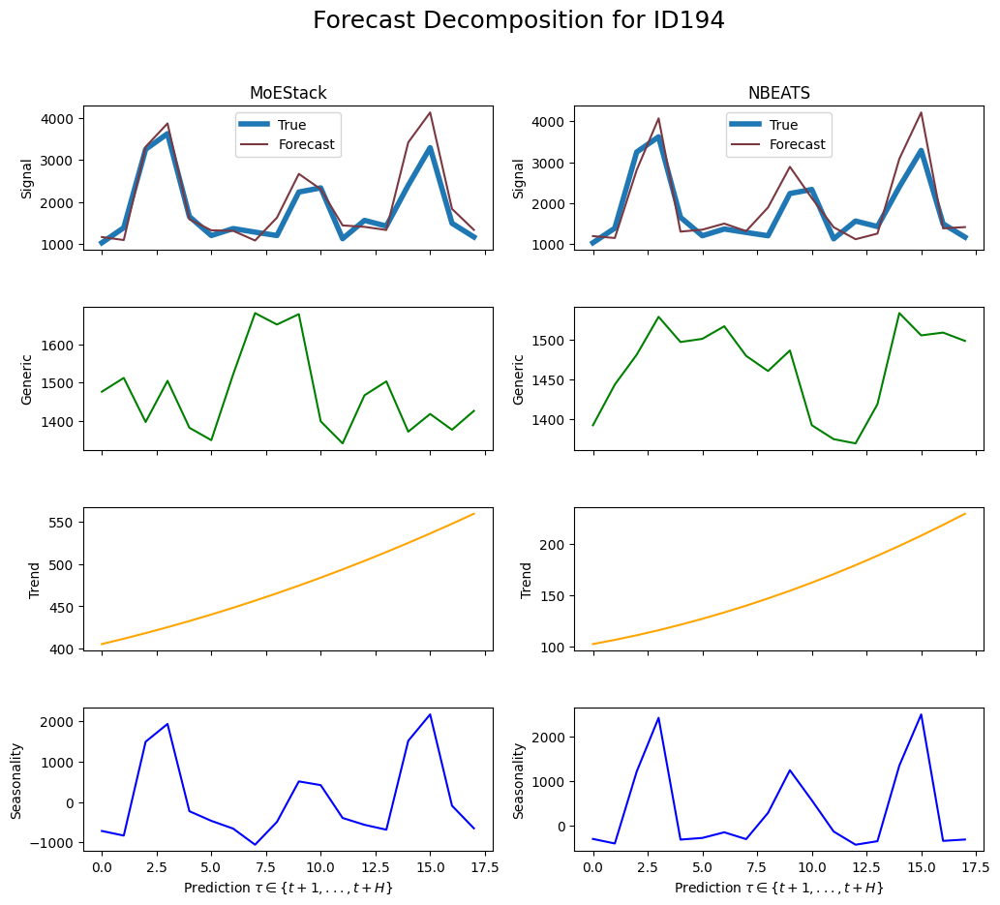

     unique_id         ds       y
1908     ID194 2004-04-30  1029.0
1909     ID194 2004-05-31  1386.0
1910     ID194 2004-06-30  3248.0
1911     ID194 2004-07-31  3620.0
1912     ID194 2004-08-31  1650.0
1913     ID194 2004-09-30  1200.0
1914     ID194 2004-10-31  1365.0
1915     ID194 2004-11-30  1281.0
1916     ID194 2004-12-31  1200.0
1917     ID194 2005-01-31  2233.0
1918     ID194 2005-02-28  2332.0
1919     ID194 2005-03-31  1125.0
1920     ID194 2005-04-30  1560.0
1921     ID194 2005-05-31  1425.0
1922     ID194 2005-06-30  2394.0
1923     ID194 2005-07-31  3288.0
1924     ID194 2005-08-31  1491.0
1925     ID194 2005-09-30  1166.0
Gate values for ID195: [0.3248186  0.21303135 0.46215004]
sMAPE for MoEStack: 0.07444559942782153
sMAPE for NBEATS: 0.06676265828411981


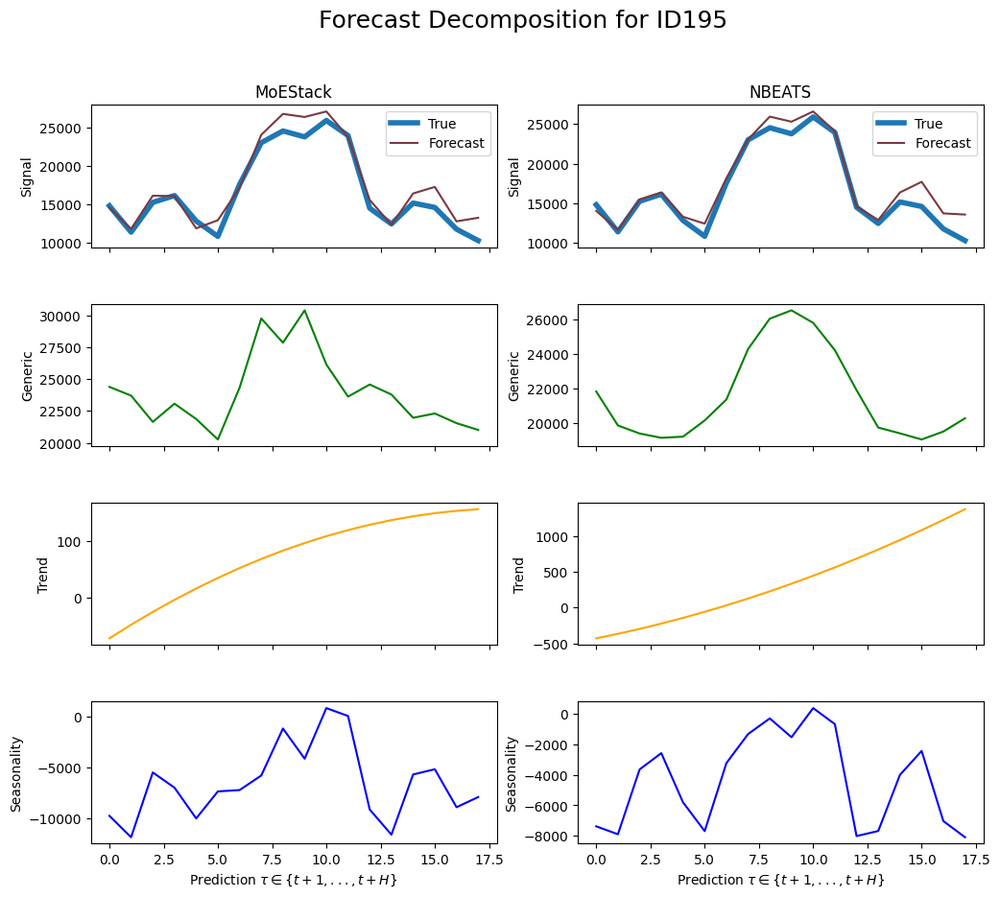

     unique_id         ds        y
1926     ID195 2004-04-30  14805.0
1927     ID195 2004-05-31  11376.0
1928     ID195 2004-06-30  15248.0
1929     ID195 2004-07-31  16140.0
1930     ID195 2004-08-31  12826.0
1931     ID195 2004-09-30  10820.0
1932     ID195 2004-10-31  17577.0
1933     ID195 2004-11-30  23016.0
1934     ID195 2004-12-31  24550.0
1935     ID195 2005-01-31  23780.0
1936     ID195 2005-02-28  25916.0
1937     ID195 2005-03-31  23950.0
1938     ID195 2005-04-30  14496.0
1939     ID195 2005-05-31  12445.0
1940     ID195 2005-06-30  15162.0
1941     ID195 2005-07-31  14592.0
1942     ID195 2005-08-31  11760.0
1943     ID195 2005-09-30  10274.0
Gate values for ID196: [0.36019942 0.23635033 0.40345025]
sMAPE for MoEStack: 0.18185763350947595
sMAPE for NBEATS: 0.14312397185854125


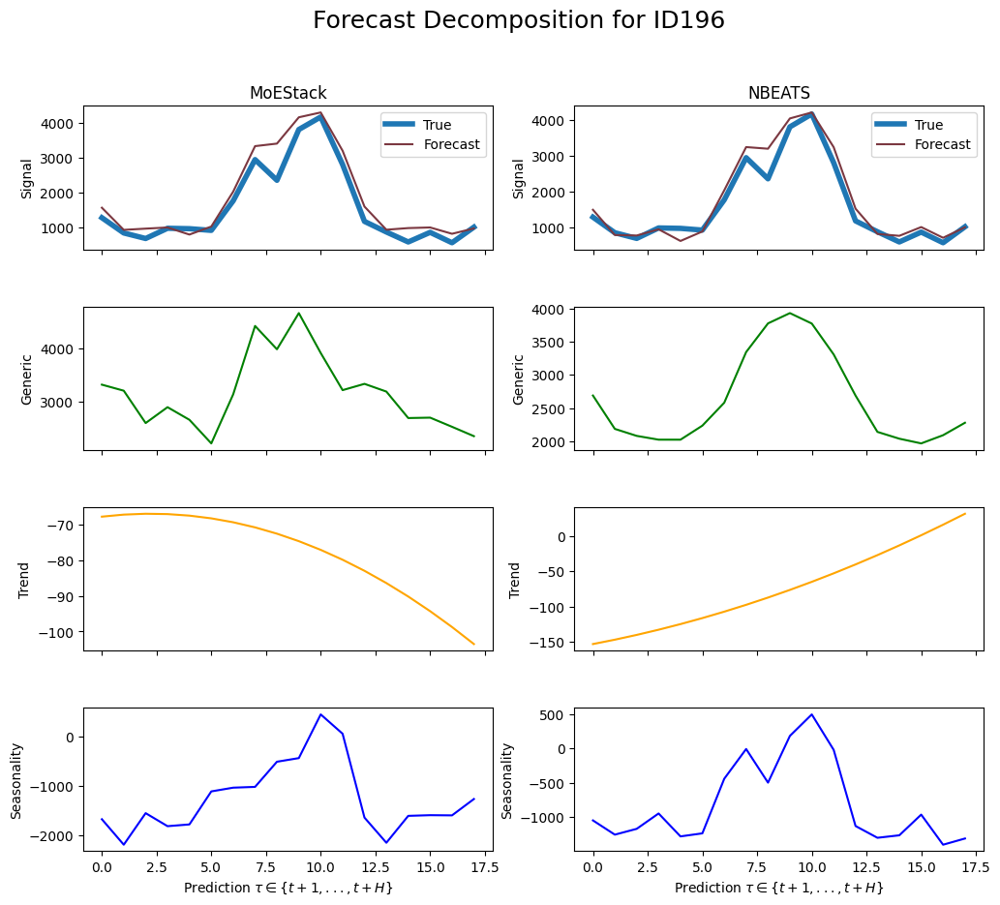

     unique_id         ds       y
1944     ID196 2004-04-30  1281.0
1945     ID196 2004-05-31   846.0
1946     ID196 2004-06-30   688.0
1947     ID196 2004-07-31   980.0
1948     ID196 2004-08-31   968.0
1949     ID196 2004-09-30   920.0
1950     ID196 2004-10-31  1764.0
1951     ID196 2004-11-30  2940.0
1952     ID196 2004-12-31  2350.0
1953     ID196 2005-01-31  3799.0
1954     ID196 2005-02-28  4158.0
1955     ID196 2005-03-31  2800.0
1956     ID196 2005-04-30  1176.0
1957     ID196 2005-05-31   874.0
1958     ID196 2005-06-30   589.0
1959     ID196 2005-07-31   864.0
1960     ID196 2005-08-31   567.0
1961     ID196 2005-09-30  1012.0
Gate values for ID197: [0.35417655 0.19289891 0.45292452]
sMAPE for MoEStack: 0.2261892109782836
sMAPE for NBEATS: 0.19068137255235496


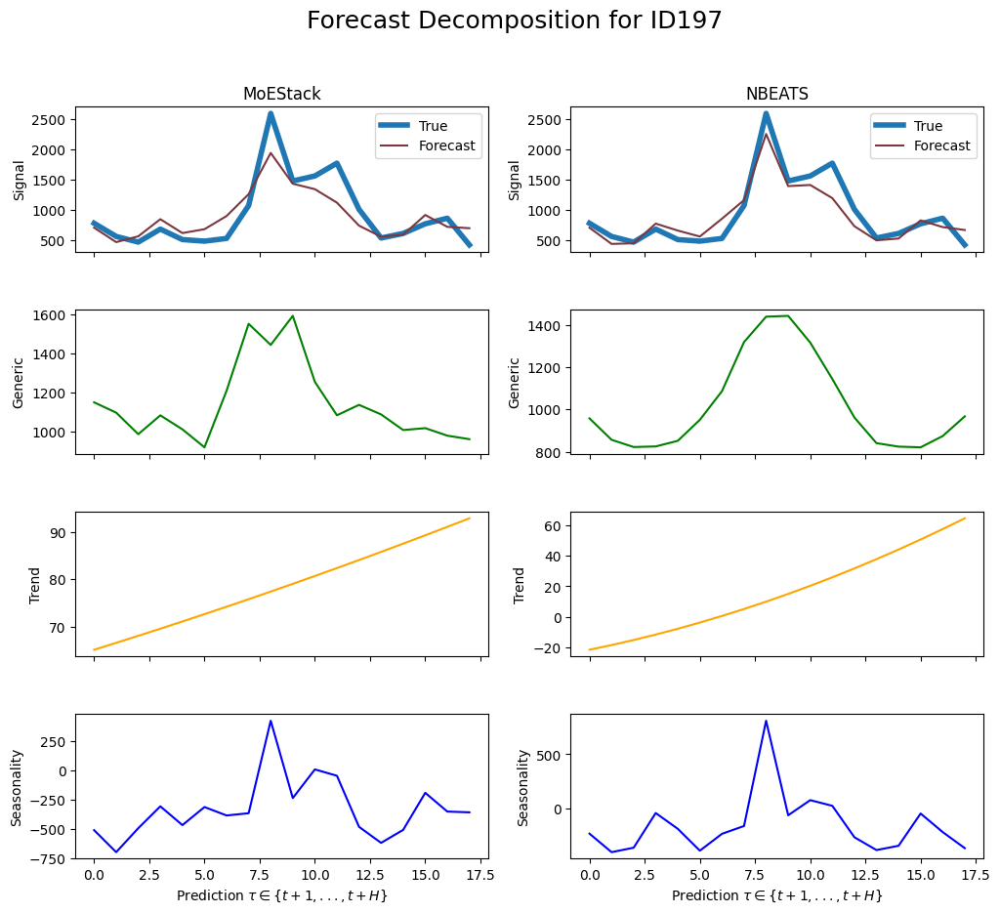

     unique_id         ds       y
1962     ID197 2004-04-30   777.0
1963     ID197 2004-05-31   558.0
1964     ID197 2004-06-30   464.0
1965     ID197 2004-07-31   680.0
1966     ID197 2004-08-31   506.0
1967     ID197 2004-09-30   480.0
1968     ID197 2004-10-31   525.0
1969     ID197 2004-11-30  1071.0
1970     ID197 2004-12-31  2600.0
1971     ID197 2005-01-31  1479.0
1972     ID197 2005-02-28  1562.0
1973     ID197 2005-03-31  1775.0
1974     ID197 2005-04-30  1008.0
1975     ID197 2005-05-31   532.0
1976     ID197 2005-06-30   608.0
1977     ID197 2005-07-31   768.0
1978     ID197 2005-08-31   861.0
1979     ID197 2005-09-30   418.0
Gate values for ID198: [0.33766404 0.24505699 0.41727903]
sMAPE for MoEStack: 0.2903284551269435
sMAPE for NBEATS: 0.28041215511999934


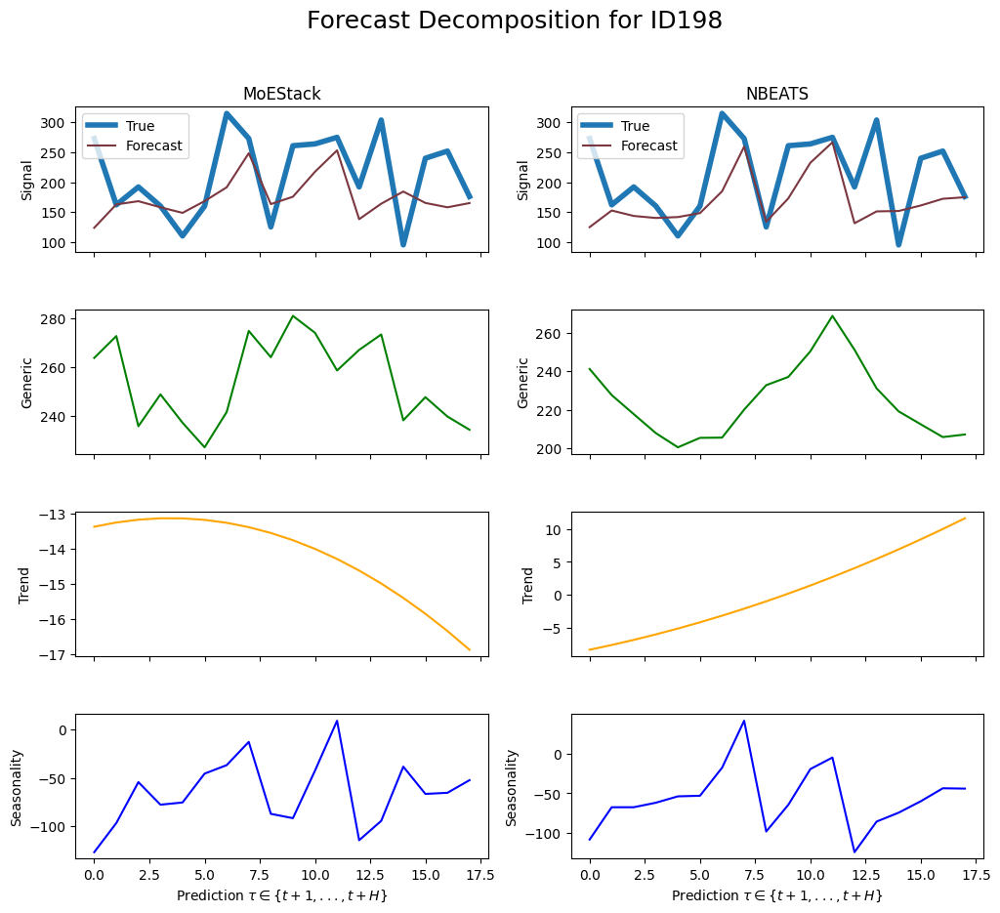

     unique_id         ds      y
1980     ID198 2004-04-30  273.0
1981     ID198 2004-05-31  162.0
1982     ID198 2004-06-30  192.0
1983     ID198 2004-07-31  160.0
1984     ID198 2004-08-31  110.0
1985     ID198 2004-09-30  160.0
1986     ID198 2004-10-31  315.0
1987     ID198 2004-11-30  273.0
1988     ID198 2004-12-31  125.0
1989     ID198 2005-01-31  261.0
1990     ID198 2005-02-28  264.0
1991     ID198 2005-03-31  275.0
1992     ID198 2005-04-30  192.0
1993     ID198 2005-05-31  304.0
1994     ID198 2005-06-30   95.0
1995     ID198 2005-07-31  240.0
1996     ID198 2005-08-31  252.0
1997     ID198 2005-09-30  176.0
Gate values for ID199: [0.27240074 0.19165279 0.5359465 ]
sMAPE for MoEStack: 0.3471932461568344
sMAPE for NBEATS: 0.36025831972070316


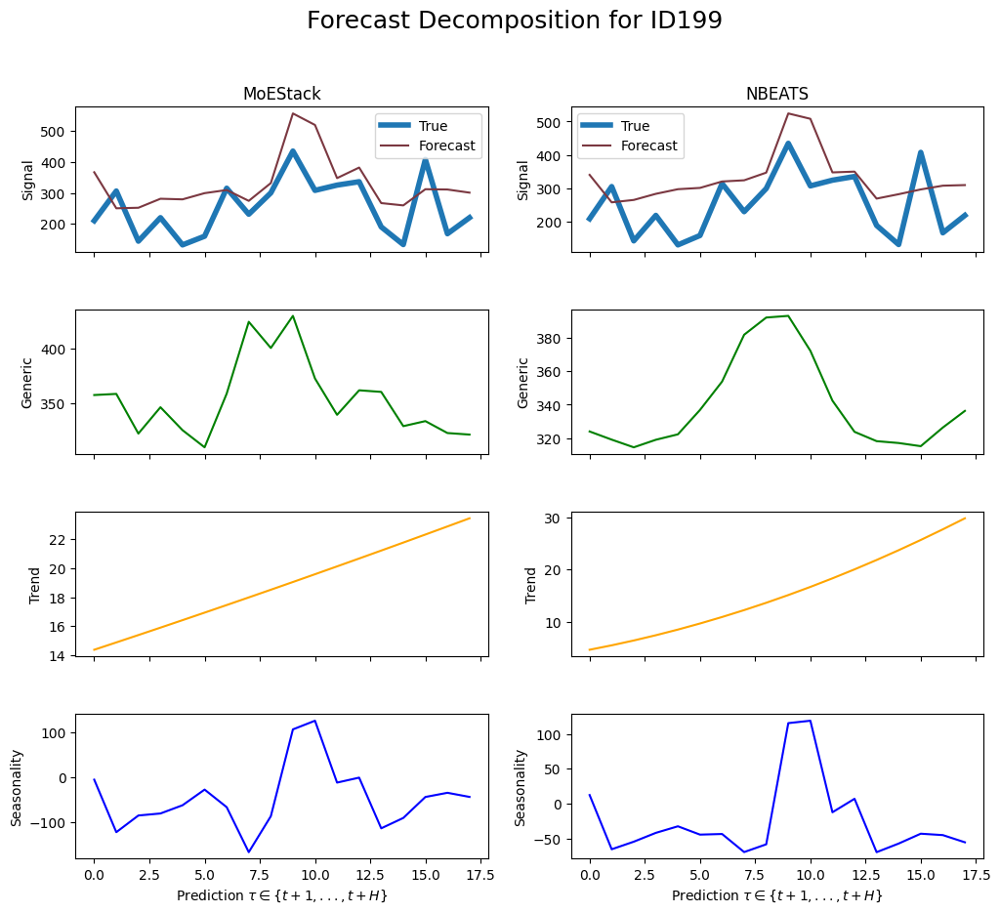

     unique_id         ds      y
1998     ID199 2004-04-30  210.0
1999     ID199 2004-05-31  306.0
2000     ID199 2004-06-30  144.0
2001     ID199 2004-07-31  220.0
2002     ID199 2004-08-31  132.0
2003     ID199 2004-09-30  160.0
2004     ID199 2004-10-31  315.0
2005     ID199 2004-11-30  231.0
2006     ID199 2004-12-31  300.0
2007     ID199 2005-01-31  435.0
2008     ID199 2005-02-28  308.0
2009     ID199 2005-03-31  325.0
2010     ID199 2005-04-30  336.0
2011     ID199 2005-05-31  190.0
2012     ID199 2005-06-30  133.0
2013     ID199 2005-07-31  408.0
2014     ID199 2005-08-31  168.0
2015     ID199 2005-09-30  220.0
Gate values for ID2: [0.39011434 0.32312393 0.28676176]
sMAPE for MoEStack: 0.7086816776919175
sMAPE for NBEATS: 1.0184047097507714


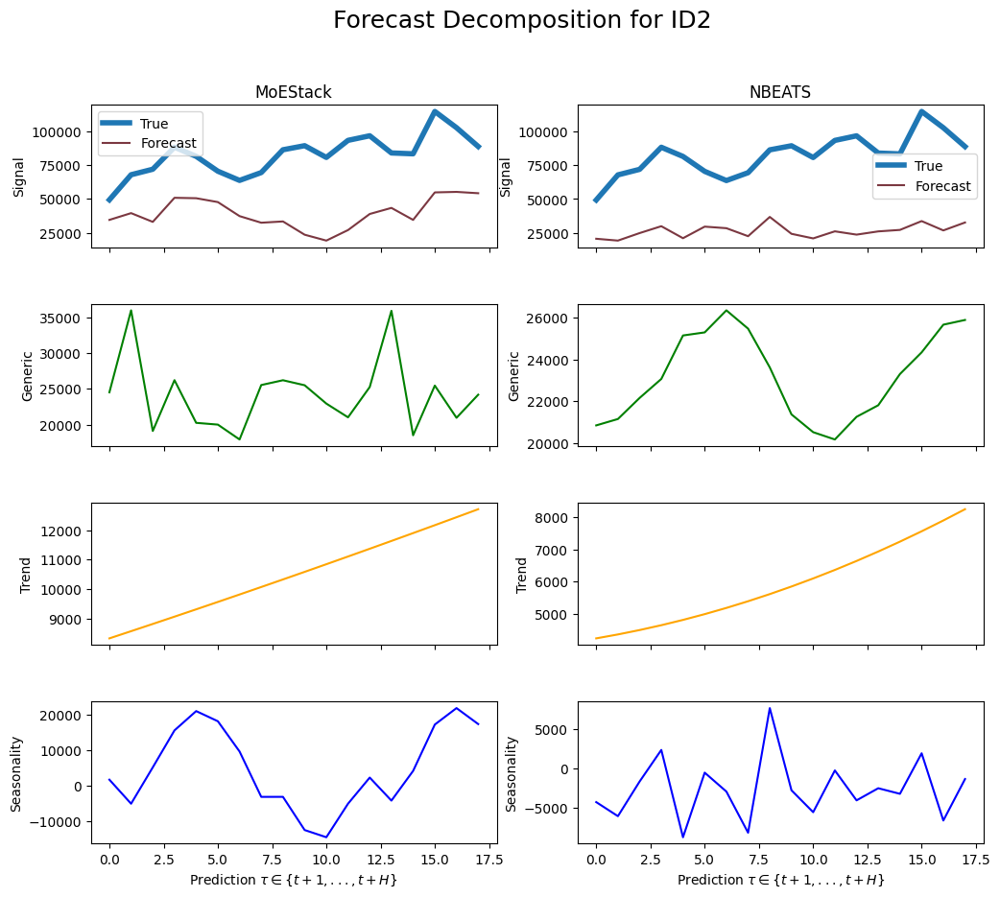

     unique_id         ds         y
2016       ID2 2003-07-31   49302.0
2017       ID2 2003-08-31   67804.0
2018       ID2 2003-09-30   71877.0
2019       ID2 2003-10-31   88143.0
2020       ID2 2003-11-30   81385.0
2021       ID2 2003-12-31   70398.0
2022       ID2 2004-01-31   63632.0
2023       ID2 2004-02-29   69411.0
2024       ID2 2004-03-31   86238.0
2025       ID2 2004-04-30   89248.0
2026       ID2 2004-05-31   80577.0
2027       ID2 2004-06-30   93187.0
2028       ID2 2004-07-31   96569.0
2029       ID2 2004-08-31   83880.0
2030       ID2 2004-09-30   83259.0
2031       ID2 2004-10-31  114520.0
2032       ID2 2004-11-30  102524.0
2033       ID2 2004-12-31   88651.0
Gate values for ID20: [0.2926576  0.31194583 0.39539656]
sMAPE for MoEStack: 0.1398823482448109
sMAPE for NBEATS: 0.13078120998299314


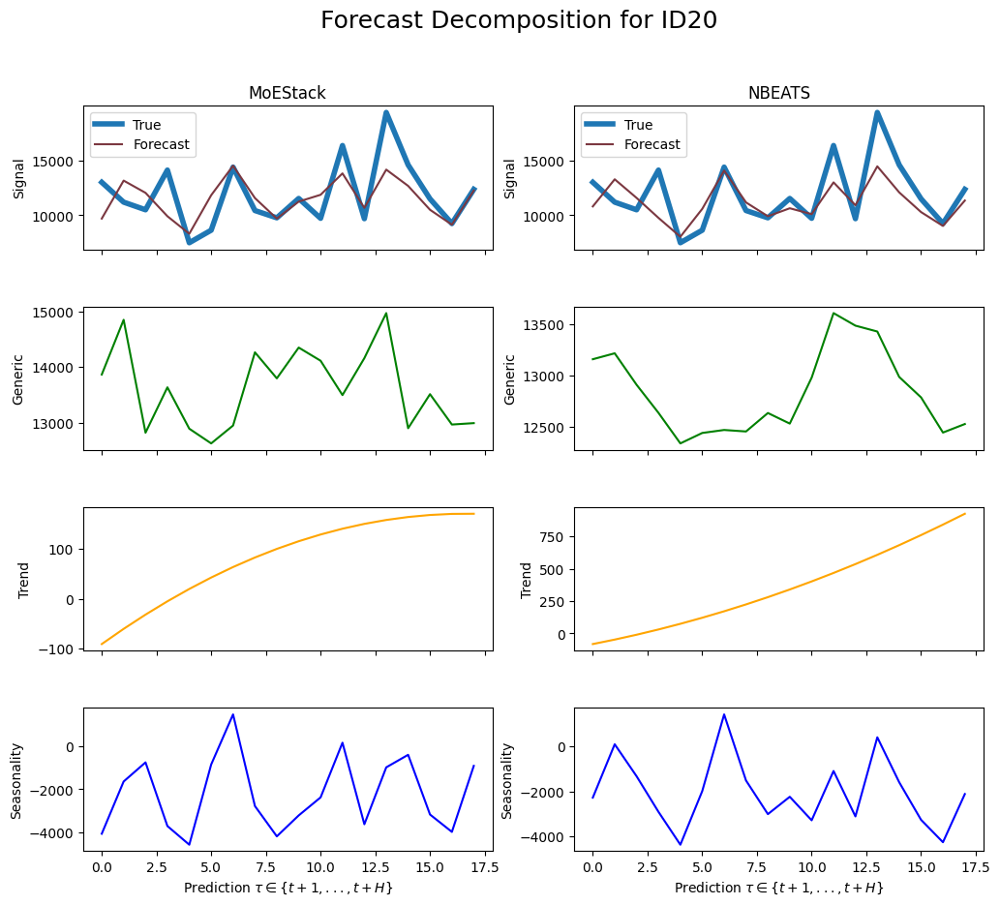

     unique_id         ds        y
2034      ID20 2004-01-31  13003.0
2035      ID20 2004-02-29  11199.0
2036      ID20 2004-03-31  10504.0
2037      ID20 2004-04-30  14116.0
2038      ID20 2004-05-31   7509.0
2039      ID20 2004-06-30   8649.0
2040      ID20 2004-07-31  14385.0
2041      ID20 2004-08-31  10435.0
2042      ID20 2004-09-30   9773.0
2043      ID20 2004-10-31  11534.0
2044      ID20 2004-11-30   9729.0
2045      ID20 2004-12-31  16345.0
2046      ID20 2005-01-31   9694.0
2047      ID20 2005-02-28  19352.0
2048      ID20 2005-03-31  14587.0
2049      ID20 2005-04-30  11497.0
2050      ID20 2005-05-31   9252.0
2051      ID20 2005-06-30  12361.0
Gate values for ID200: [0.35888192 0.21969086 0.42142722]
sMAPE for MoEStack: 0.09421885619834845
sMAPE for NBEATS: 0.06030255947965727


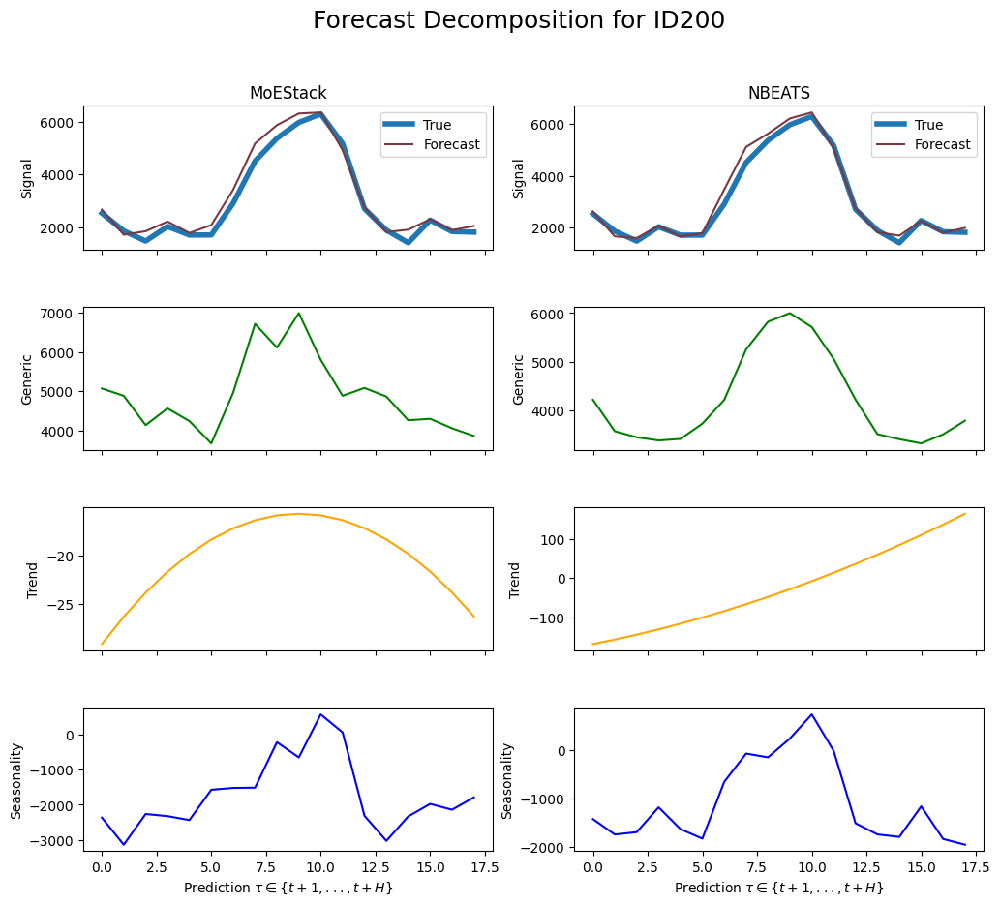

     unique_id         ds       y
2052     ID200 2004-04-30  2541.0
2053     ID200 2004-05-31  1872.0
2054     ID200 2004-06-30  1488.0
2055     ID200 2004-07-31  2040.0
2056     ID200 2004-08-31  1716.0
2057     ID200 2004-09-30  1720.0
2058     ID200 2004-10-31  2919.0
2059     ID200 2004-11-30  4515.0
2060     ID200 2004-12-31  5375.0
2061     ID200 2005-01-31  5974.0
2062     ID200 2005-02-28  6292.0
2063     ID200 2005-03-31  5175.0
2064     ID200 2005-04-30  2712.0
2065     ID200 2005-05-31  1900.0
2066     ID200 2005-06-30  1425.0
2067     ID200 2005-07-31  2280.0
2068     ID200 2005-08-31  1848.0
2069     ID200 2005-09-30  1826.0
Gate values for ID201: [0.34740213 0.19141462 0.4611833 ]
sMAPE for MoEStack: 0.22589969668923734
sMAPE for NBEATS: 0.22503643784567556


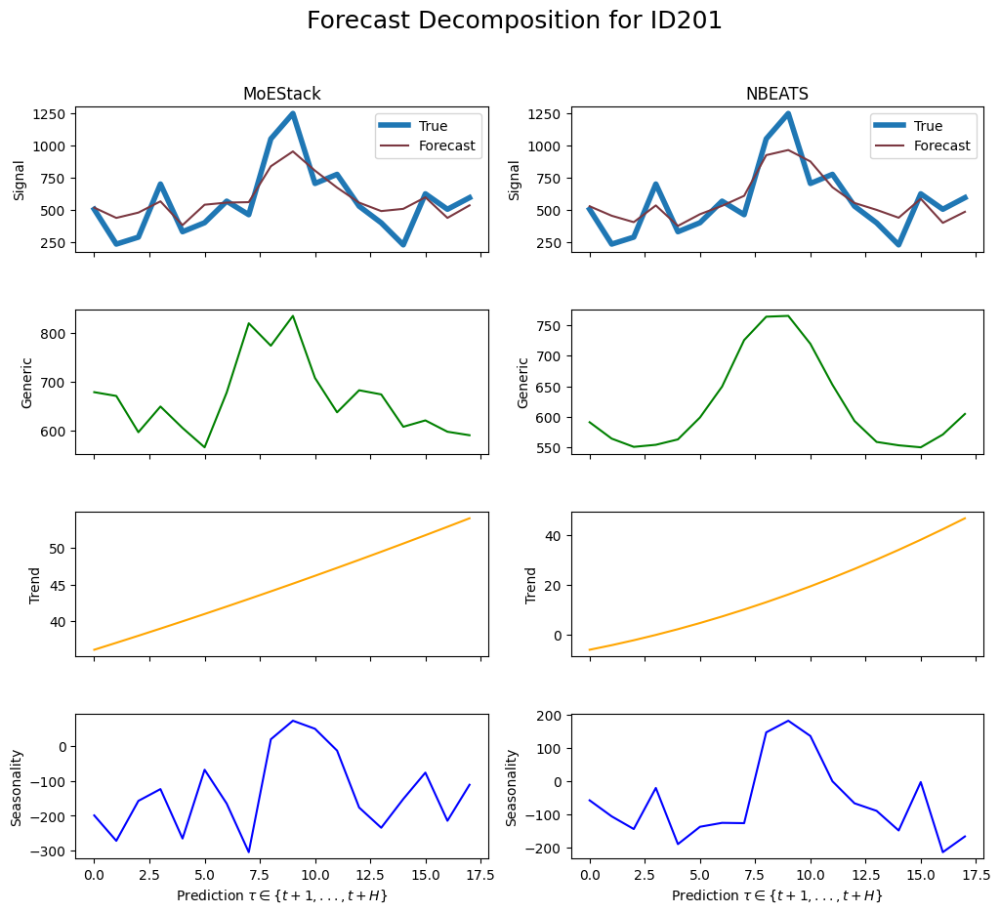

     unique_id         ds       y
2070     ID201 2004-04-30   504.0
2071     ID201 2004-05-31   234.0
2072     ID201 2004-06-30   288.0
2073     ID201 2004-07-31   700.0
2074     ID201 2004-08-31   330.0
2075     ID201 2004-09-30   400.0
2076     ID201 2004-10-31   567.0
2077     ID201 2004-11-30   462.0
2078     ID201 2004-12-31  1050.0
2079     ID201 2005-01-31  1247.0
2080     ID201 2005-02-28   704.0
2081     ID201 2005-03-31   775.0
2082     ID201 2005-04-30   528.0
2083     ID201 2005-05-31   399.0
2084     ID201 2005-06-30   228.0
2085     ID201 2005-07-31   624.0
2086     ID201 2005-08-31   504.0
2087     ID201 2005-09-30   594.0
Gate values for ID202: [0.32648462 0.21196166 0.46155372]
sMAPE for MoEStack: 0.25033876128583243
sMAPE for NBEATS: 0.18013722340692448


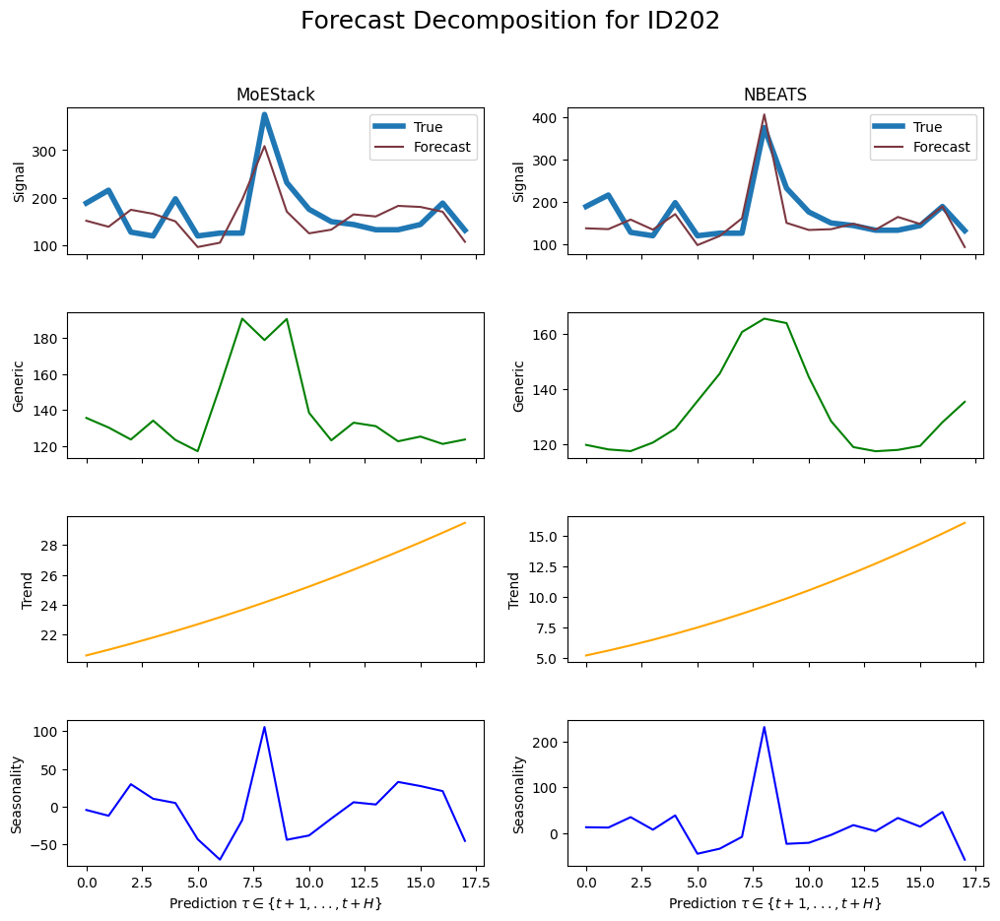

     unique_id         ds      y
2088     ID202 2004-04-30  189.0
2089     ID202 2004-05-31  216.0
2090     ID202 2004-06-30  128.0
2091     ID202 2004-07-31  120.0
2092     ID202 2004-08-31  198.0
2093     ID202 2004-09-30  120.0
2094     ID202 2004-10-31  126.0
2095     ID202 2004-11-30  126.0
2096     ID202 2004-12-31  375.0
2097     ID202 2005-01-31  232.0
2098     ID202 2005-02-28  176.0
2099     ID202 2005-03-31  150.0
2100     ID202 2005-04-30  144.0
2101     ID202 2005-05-31  133.0
2102     ID202 2005-06-30  133.0
2103     ID202 2005-07-31  144.0
2104     ID202 2005-08-31  189.0
2105     ID202 2005-09-30  132.0
Gate values for ID203: [0.45693967 0.23356898 0.30949134]
sMAPE for MoEStack: 0.25725609988576686
sMAPE for NBEATS: 0.2825136350370271


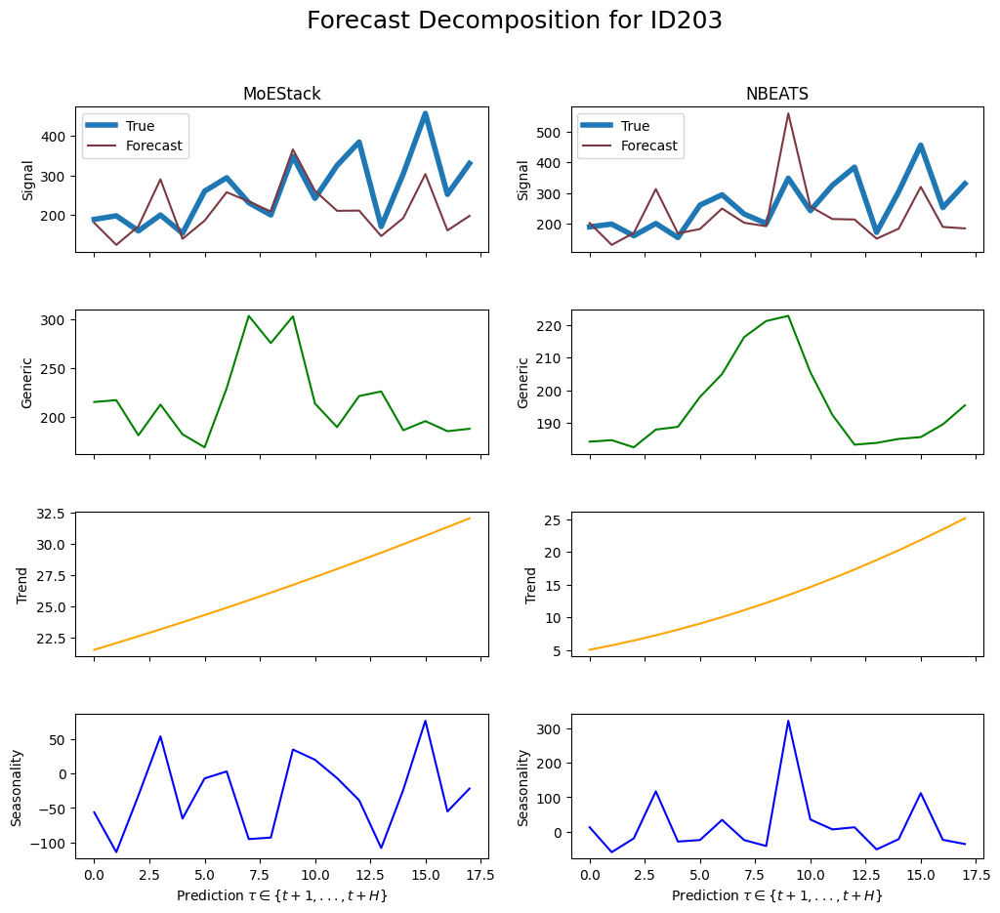

     unique_id         ds      y
2106     ID203 2004-04-30  189.0
2107     ID203 2004-05-31  198.0
2108     ID203 2004-06-30  160.0
2109     ID203 2004-07-31  200.0
2110     ID203 2004-08-31  154.0
2111     ID203 2004-09-30  260.0
2112     ID203 2004-10-31  294.0
2113     ID203 2004-11-30  231.0
2114     ID203 2004-12-31  200.0
2115     ID203 2005-01-31  348.0
2116     ID203 2005-02-28  242.0
2117     ID203 2005-03-31  325.0
2118     ID203 2005-04-30  384.0
2119     ID203 2005-05-31  171.0
2120     ID203 2005-06-30  304.0
2121     ID203 2005-07-31  456.0
2122     ID203 2005-08-31  252.0
2123     ID203 2005-09-30  330.0
Gate values for ID204: [0.39690888 0.19195376 0.4111374 ]
sMAPE for MoEStack: 0.10190625952525129
sMAPE for NBEATS: 0.10149187110549458


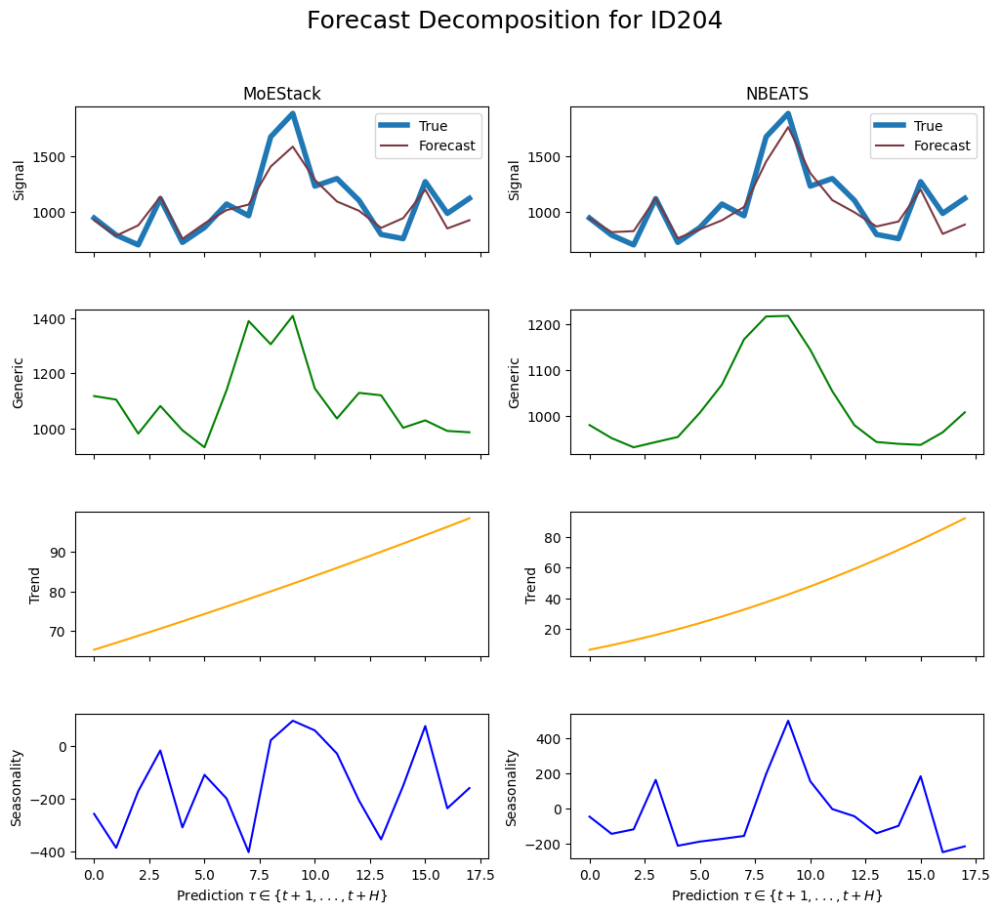

     unique_id         ds       y
2124     ID204 2004-04-30   945.0
2125     ID204 2004-05-31   792.0
2126     ID204 2004-06-30   704.0
2127     ID204 2004-07-31  1120.0
2128     ID204 2004-08-31   726.0
2129     ID204 2004-09-30   860.0
2130     ID204 2004-10-31  1071.0
2131     ID204 2004-11-30   966.0
2132     ID204 2004-12-31  1675.0
2133     ID204 2005-01-31  1885.0
2134     ID204 2005-02-28  1232.0
2135     ID204 2005-03-31  1300.0
2136     ID204 2005-04-30  1104.0
2137     ID204 2005-05-31   798.0
2138     ID204 2005-06-30   760.0
2139     ID204 2005-07-31  1272.0
2140     ID204 2005-08-31   987.0
2141     ID204 2005-09-30  1122.0
Gate values for ID205: [0.33221212 0.14195494 0.52583295]
sMAPE for MoEStack: 0.39239881739413546
sMAPE for NBEATS: 0.30079762623316886


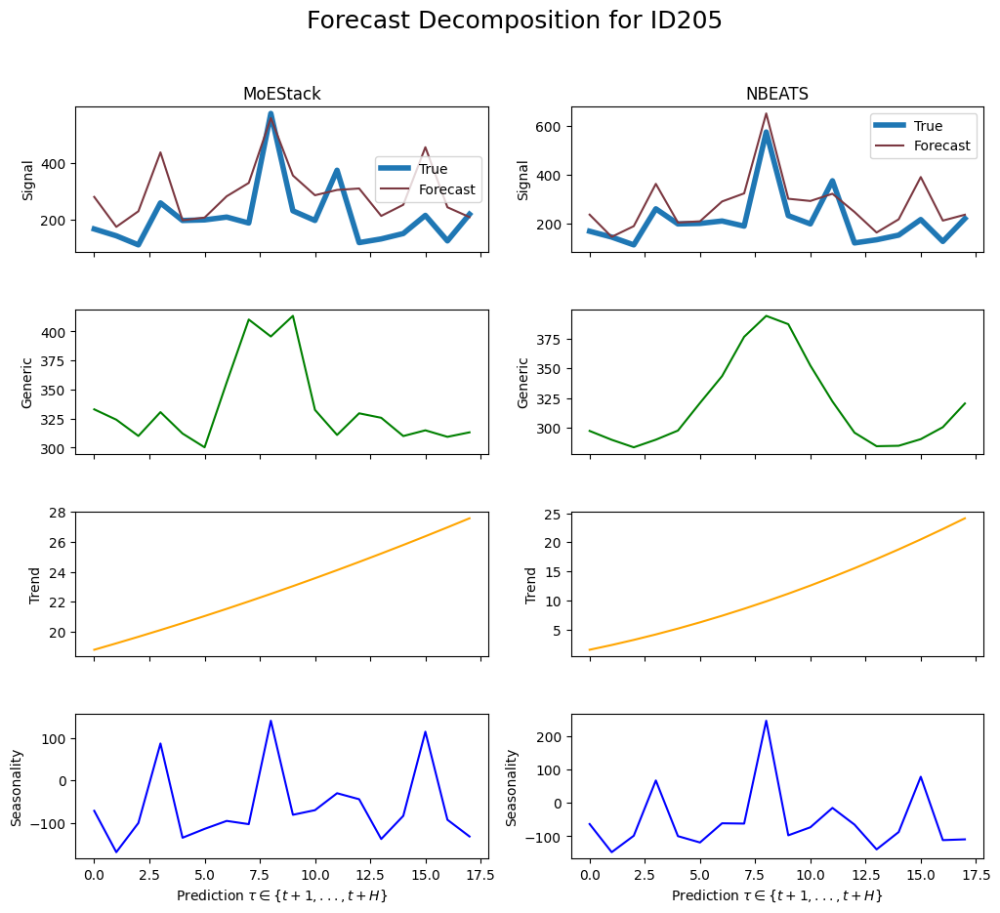

     unique_id         ds      y
2142     ID205 2004-04-30  168.0
2143     ID205 2004-05-31  144.0
2144     ID205 2004-06-30  112.0
2145     ID205 2004-07-31  260.0
2146     ID205 2004-08-31  198.0
2147     ID205 2004-09-30  200.0
2148     ID205 2004-10-31  210.0
2149     ID205 2004-11-30  189.0
2150     ID205 2004-12-31  575.0
2151     ID205 2005-01-31  232.0
2152     ID205 2005-02-28  198.0
2153     ID205 2005-03-31  375.0
2154     ID205 2005-04-30  120.0
2155     ID205 2005-05-31  133.0
2156     ID205 2005-06-30  152.0
2157     ID205 2005-07-31  216.0
2158     ID205 2005-08-31  126.0
2159     ID205 2005-09-30  220.0
Gate values for ID206: [0.3703097  0.16233273 0.4673576 ]
sMAPE for MoEStack: 0.2169932289414398
sMAPE for NBEATS: 0.17674744837228032


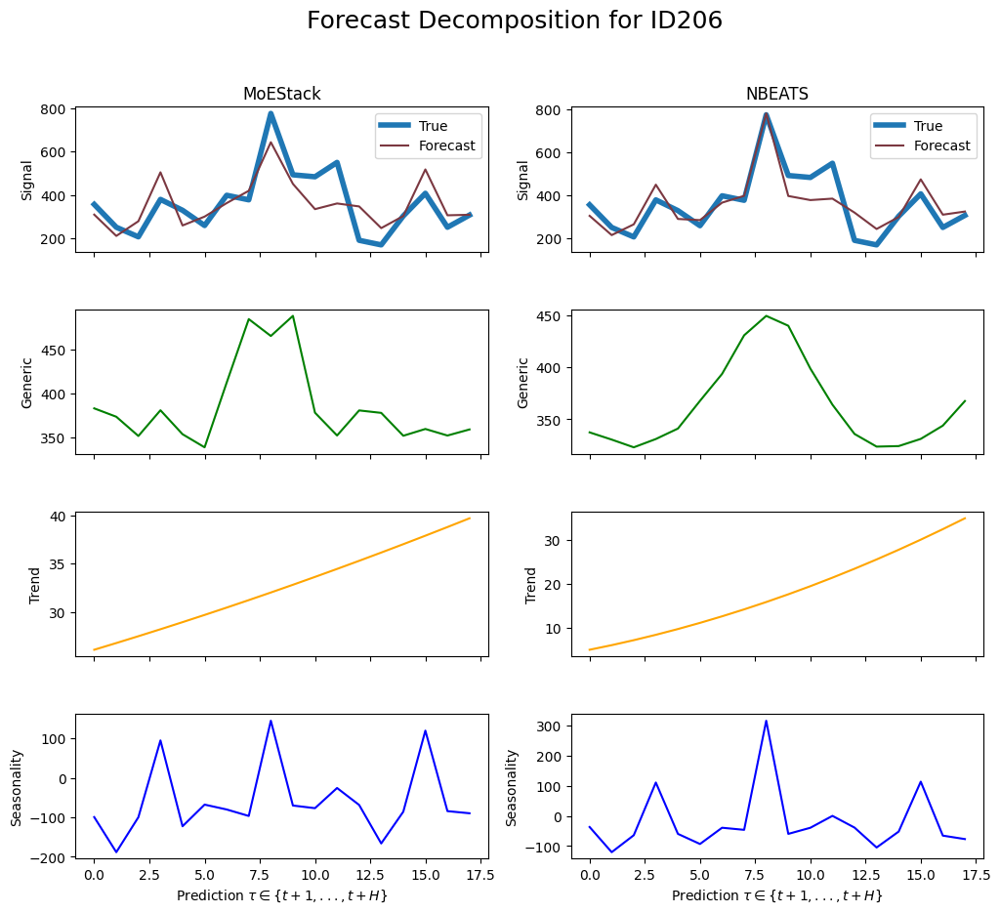

     unique_id         ds      y
2160     ID206 2004-04-30  357.0
2161     ID206 2004-05-31  252.0
2162     ID206 2004-06-30  208.0
2163     ID206 2004-07-31  380.0
2164     ID206 2004-08-31  330.0
2165     ID206 2004-09-30  260.0
2166     ID206 2004-10-31  399.0
2167     ID206 2004-11-30  378.0
2168     ID206 2004-12-31  775.0
2169     ID206 2005-01-31  493.0
2170     ID206 2005-02-28  484.0
2171     ID206 2005-03-31  550.0
2172     ID206 2005-04-30  192.0
2173     ID206 2005-05-31  171.0
2174     ID206 2005-06-30  304.0
2175     ID206 2005-07-31  408.0
2176     ID206 2005-08-31  252.0
2177     ID206 2005-09-30  308.0
Gate values for ID207: [0.34428358 0.22432135 0.4313951 ]
sMAPE for MoEStack: 0.09914954550979244
sMAPE for NBEATS: 0.08186152708909819


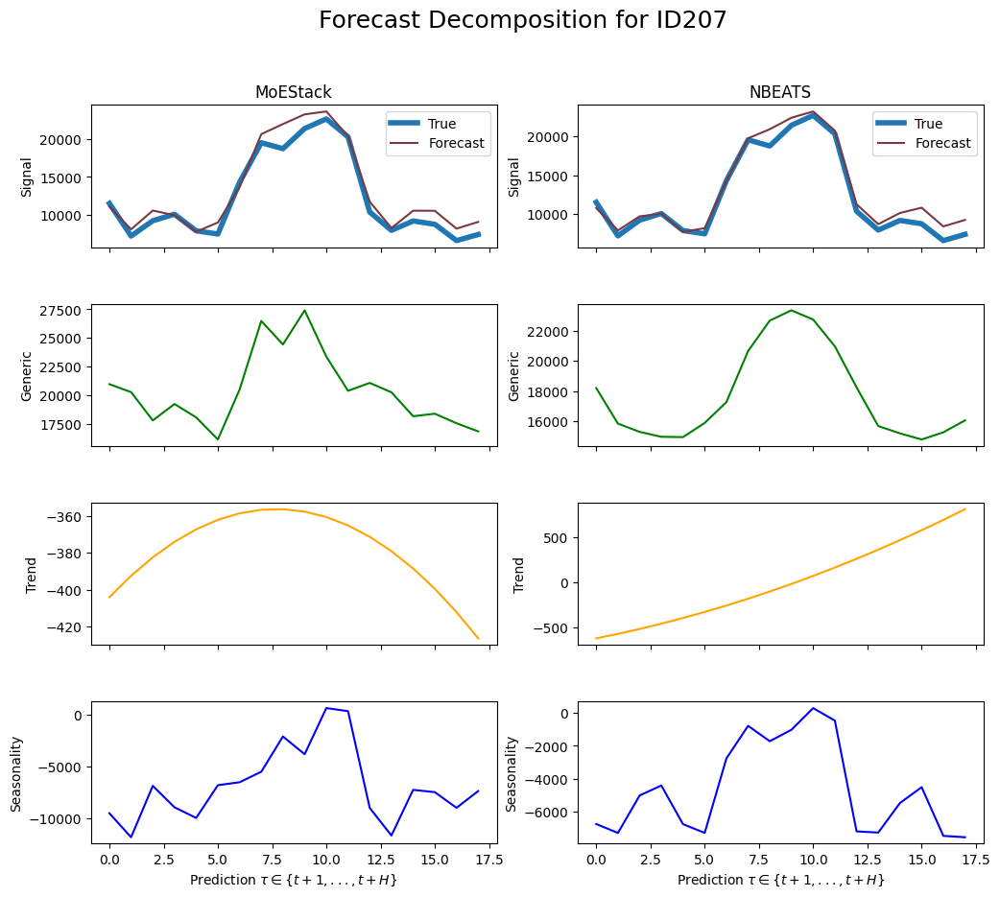

     unique_id         ds        y
2178     ID207 2004-04-30  11529.0
2179     ID207 2004-05-31   7236.0
2180     ID207 2004-06-30   9248.0
2181     ID207 2004-07-31  10100.0
2182     ID207 2004-08-31   7920.0
2183     ID207 2004-09-30   7500.0
2184     ID207 2004-10-31  14301.0
2185     ID207 2004-11-30  19509.0
2186     ID207 2004-12-31  18725.0
2187     ID207 2005-01-31  21373.0
2188     ID207 2005-02-28  22638.0
2189     ID207 2005-03-31  20275.0
2190     ID207 2005-04-30  10392.0
2191     ID207 2005-05-31   7980.0
2192     ID207 2005-06-30   9215.0
2193     ID207 2005-07-31   8784.0
2194     ID207 2005-08-31   6636.0
2195     ID207 2005-09-30   7436.0
Gate values for ID208: [0.33738703 0.18335217 0.4792608 ]
sMAPE for MoEStack: 0.11515564736084001
sMAPE for NBEATS: 0.08647419426163808


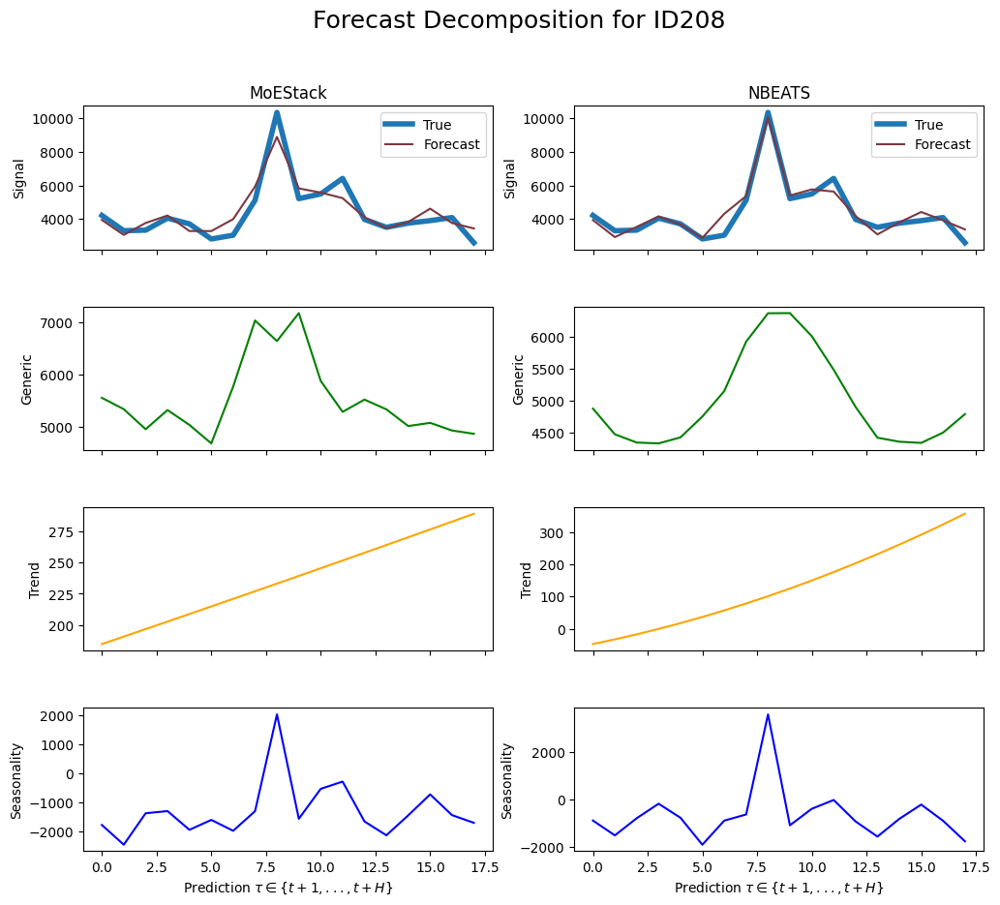

     unique_id         ds        y
2196     ID208 2004-04-30   4221.0
2197     ID208 2004-05-31   3312.0
2198     ID208 2004-06-30   3344.0
2199     ID208 2004-07-31   4060.0
2200     ID208 2004-08-31   3718.0
2201     ID208 2004-09-30   2820.0
2202     ID208 2004-10-31   3045.0
2203     ID208 2004-11-30   5124.0
2204     ID208 2004-12-31  10350.0
2205     ID208 2005-01-31   5220.0
2206     ID208 2005-02-28   5500.0
2207     ID208 2005-03-31   6425.0
2208     ID208 2005-04-30   3984.0
2209     ID208 2005-05-31   3515.0
2210     ID208 2005-06-30   3762.0
2211     ID208 2005-07-31   3912.0
2212     ID208 2005-08-31   4095.0
2213     ID208 2005-09-30   2596.0
Gate values for ID209: [0.22318204 0.28560036 0.49121764]
sMAPE for MoEStack: 0.08669040117665126
sMAPE for NBEATS: 0.09182683942653


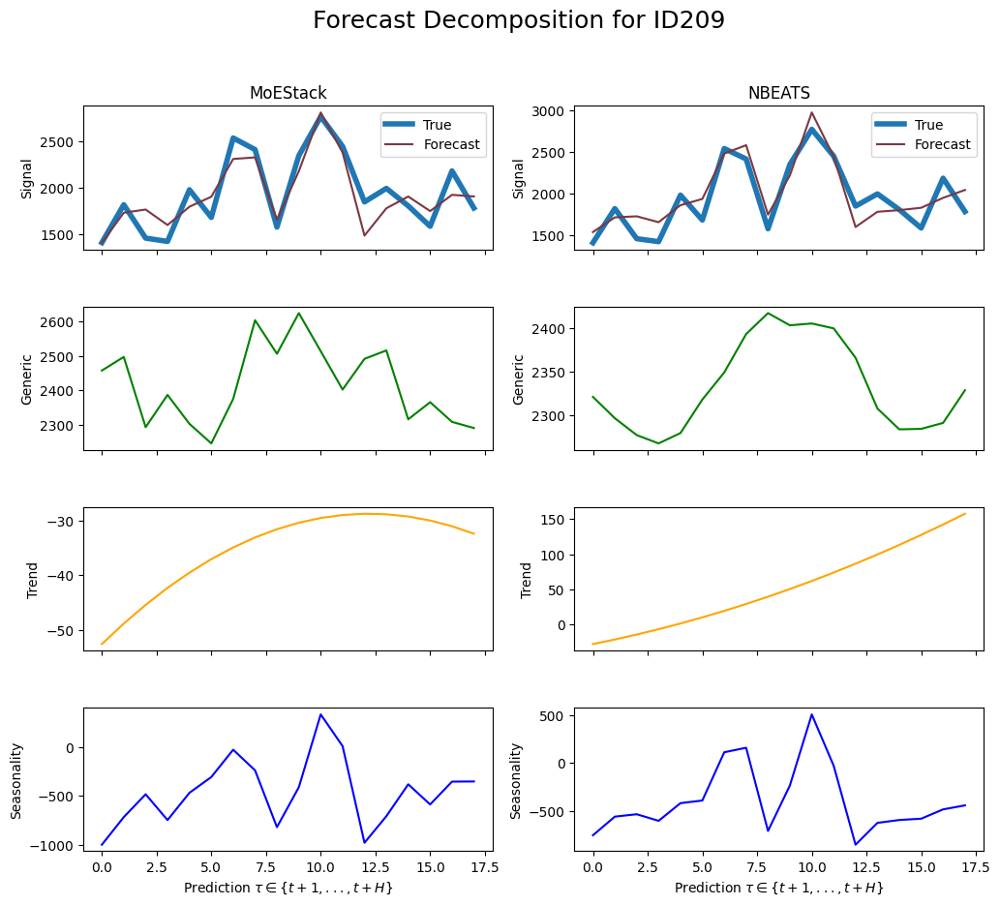

     unique_id         ds       y
2214     ID209 2004-04-30  1407.0
2215     ID209 2004-05-31  1818.0
2216     ID209 2004-06-30  1456.0
2217     ID209 2004-07-31  1420.0
2218     ID209 2004-08-31  1980.0
2219     ID209 2004-09-30  1680.0
2220     ID209 2004-10-31  2541.0
2221     ID209 2004-11-30  2415.0
2222     ID209 2004-12-31  1575.0
2223     ID209 2005-01-31  2349.0
2224     ID209 2005-02-28  2772.0
2225     ID209 2005-03-31  2450.0
2226     ID209 2005-04-30  1848.0
2227     ID209 2005-05-31  1995.0
2228     ID209 2005-06-30  1805.0
2229     ID209 2005-07-31  1584.0
2230     ID209 2005-08-31  2184.0
2231     ID209 2005-09-30  1782.0
Gate values for ID21: [0.23085152 0.20452316 0.5646253 ]
sMAPE for MoEStack: 0.1559842282410838
sMAPE for NBEATS: 0.1381376764854827


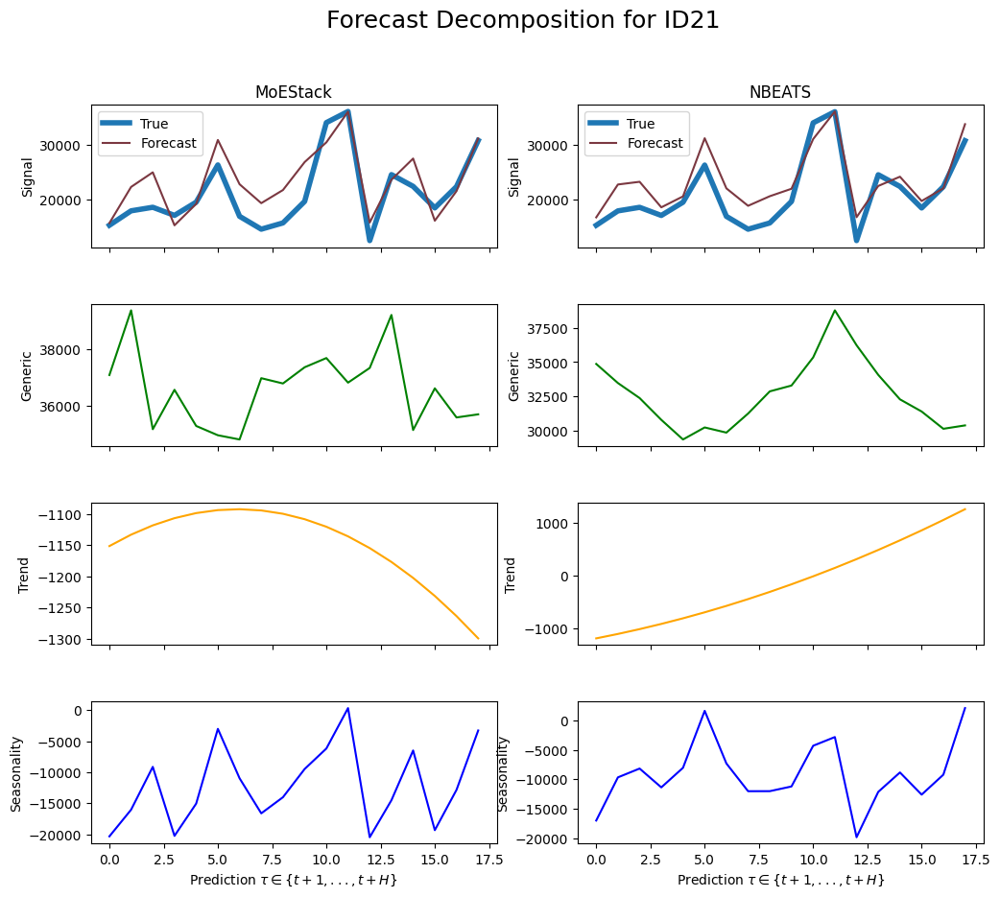

     unique_id         ds        y
2232      ID21 2004-01-31  15250.0
2233      ID21 2004-02-29  17885.0
2234      ID21 2004-03-31  18534.0
2235      ID21 2004-04-30  17050.0
2236      ID21 2004-05-31  19465.0
2237      ID21 2004-06-30  26268.0
2238      ID21 2004-07-31  16881.0
2239      ID21 2004-08-31  14534.0
2240      ID21 2004-09-30  15675.0
2241      ID21 2004-10-31  19604.0
2242      ID21 2004-11-30  33989.0
2243      ID21 2004-12-31  36029.0
2244      ID21 2005-01-31  12449.0
2245      ID21 2005-02-28  24499.0
2246      ID21 2005-03-31  22353.0
2247      ID21 2005-04-30  18417.0
2248      ID21 2005-05-31  22305.0
2249      ID21 2005-06-30  30724.0
Gate values for ID210: [0.285046   0.23017047 0.48478347]
sMAPE for MoEStack: 0.12610617797837761
sMAPE for NBEATS: 0.1433715052907393


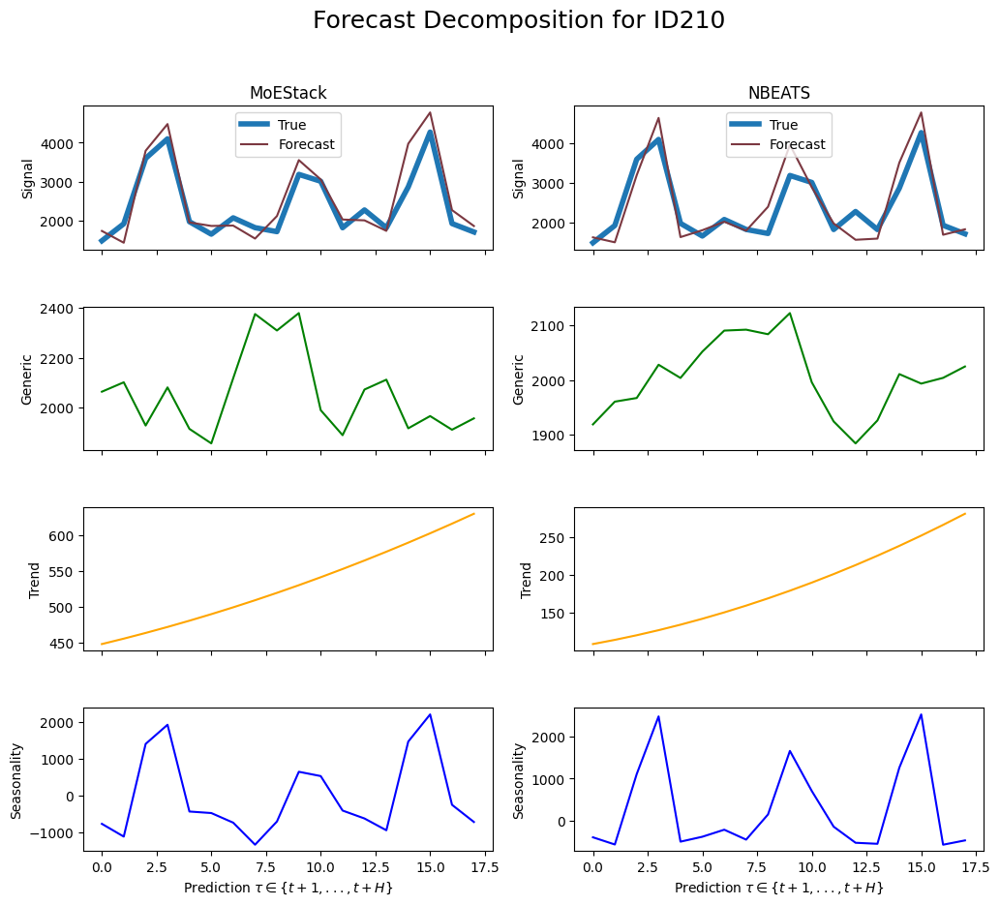

     unique_id         ds       y
2250     ID210 2004-04-30  1491.0
2251     ID210 2004-05-31  1926.0
2252     ID210 2004-06-30  3600.0
2253     ID210 2004-07-31  4100.0
2254     ID210 2004-08-31  1980.0
2255     ID210 2004-09-30  1660.0
2256     ID210 2004-10-31  2079.0
2257     ID210 2004-11-30  1827.0
2258     ID210 2004-12-31  1725.0
2259     ID210 2005-01-31  3190.0
2260     ID210 2005-02-28  3014.0
2261     ID210 2005-03-31  1825.0
2262     ID210 2005-04-30  2280.0
2263     ID210 2005-05-31  1824.0
2264     ID210 2005-06-30  2869.0
2265     ID210 2005-07-31  4272.0
2266     ID210 2005-08-31  1932.0
2267     ID210 2005-09-30  1716.0
Gate values for ID211: [0.33643088 0.2117049  0.4518642 ]
sMAPE for MoEStack: 0.0653665037674543
sMAPE for NBEATS: 0.05626523510631978


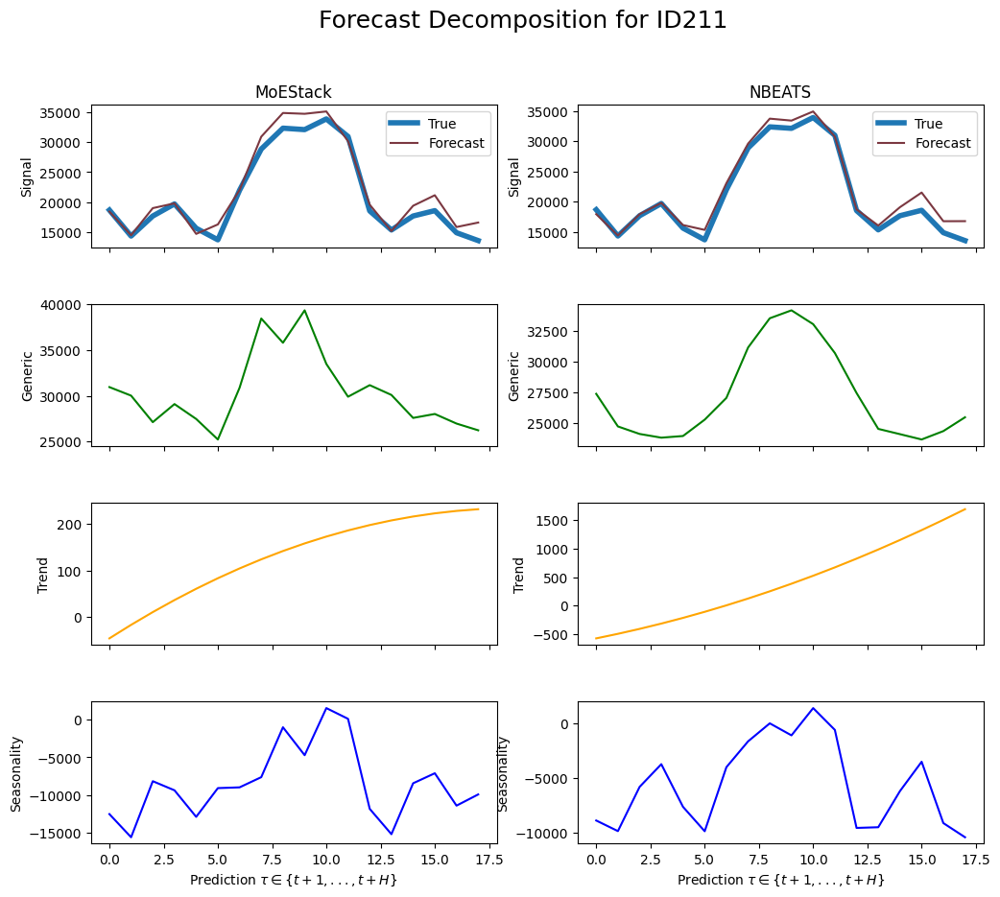

     unique_id         ds        y
2268     ID211 2004-04-30  18648.0
2269     ID211 2004-05-31  14292.0
2270     ID211 2004-06-30  17648.0
2271     ID211 2004-07-31  19680.0
2272     ID211 2004-08-31  15598.0
2273     ID211 2004-09-30  13660.0
2274     ID211 2004-10-31  21966.0
2275     ID211 2004-11-30  28875.0
2276     ID211 2004-12-31  32375.0
2277     ID211 2005-01-31  32132.0
2278     ID211 2005-02-28  33924.0
2279     ID211 2005-03-31  30975.0
2280     ID211 2005-04-30  18504.0
2281     ID211 2005-05-31  15314.0
2282     ID211 2005-06-30  17651.0
2283     ID211 2005-07-31  18552.0
2284     ID211 2005-08-31  14847.0
2285     ID211 2005-09-30  13530.0
Gate values for ID212: [0.3148186  0.25615722 0.4290242 ]
sMAPE for MoEStack: 0.15325047392968552
sMAPE for NBEATS: 0.1857718096438008


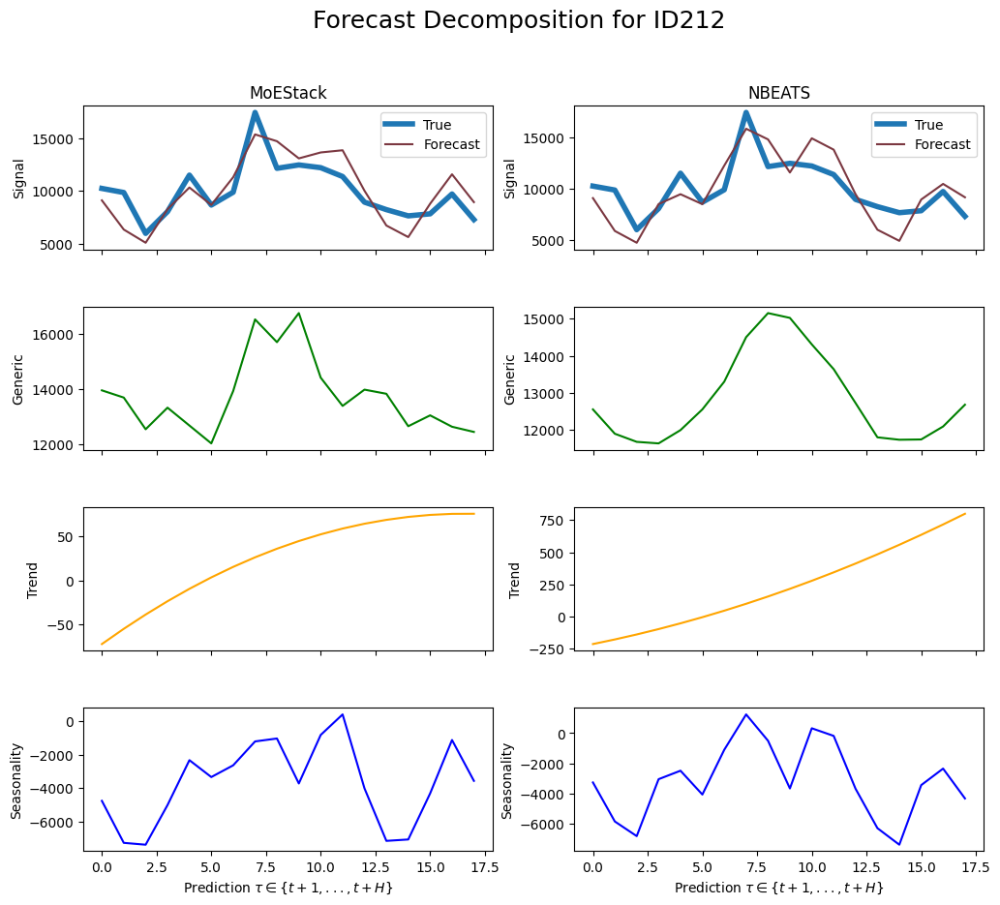

     unique_id         ds        y
2286     ID212 2004-04-30  10248.0
2287     ID212 2004-05-31   9864.0
2288     ID212 2004-06-30   6000.0
2289     ID212 2004-07-31   8060.0
2290     ID212 2004-08-31  11506.0
2291     ID212 2004-09-30   8680.0
2292     ID212 2004-10-31   9891.0
2293     ID212 2004-11-30  17430.0
2294     ID212 2004-12-31  12150.0
2295     ID212 2005-01-31  12470.0
2296     ID212 2005-02-28  12210.0
2297     ID212 2005-03-31  11375.0
2298     ID212 2005-04-30   8952.0
2299     ID212 2005-05-31   8246.0
2300     ID212 2005-06-30   7657.0
2301     ID212 2005-07-31   7848.0
2302     ID212 2005-08-31   9723.0
2303     ID212 2005-09-30   7304.0
Gate values for ID213: [0.22592106 0.10795012 0.6661288 ]
sMAPE for MoEStack: 0.318208733531766
sMAPE for NBEATS: 0.21408842433348002


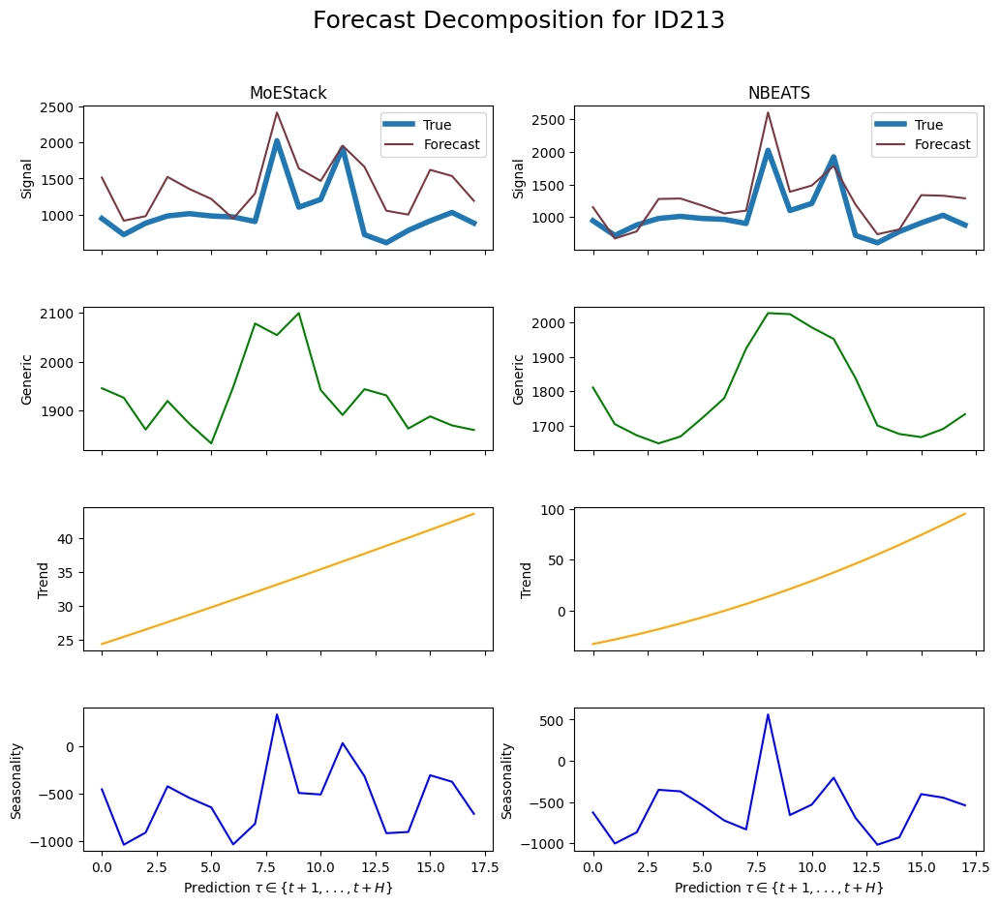

     unique_id         ds       y
2304     ID213 2004-04-30   945.0
2305     ID213 2004-05-31   720.0
2306     ID213 2004-06-30   880.0
2307     ID213 2004-07-31   980.0
2308     ID213 2004-08-31  1012.0
2309     ID213 2004-09-30   980.0
2310     ID213 2004-10-31   966.0
2311     ID213 2004-11-30   903.0
2312     ID213 2004-12-31  2025.0
2313     ID213 2005-01-31  1102.0
2314     ID213 2005-02-28  1210.0
2315     ID213 2005-03-31  1925.0
2316     ID213 2005-04-30   720.0
2317     ID213 2005-05-31   608.0
2318     ID213 2005-06-30   779.0
2319     ID213 2005-07-31   912.0
2320     ID213 2005-08-31  1029.0
2321     ID213 2005-09-30   880.0
Gate values for ID214: [0.46367142 0.2443565  0.29197207]
sMAPE for MoEStack: 0.1332864078861996
sMAPE for NBEATS: 0.16499386344823255


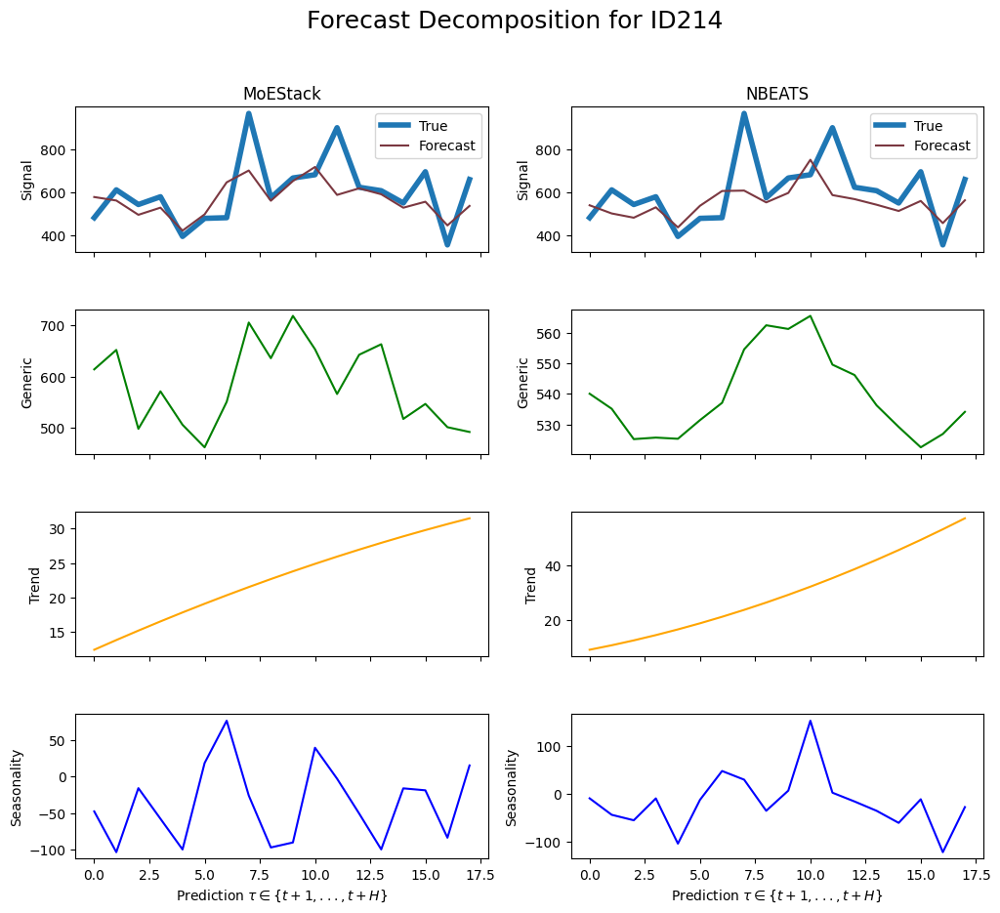

     unique_id         ds      y
2322     ID214 2004-04-30  483.0
2323     ID214 2004-05-31  612.0
2324     ID214 2004-06-30  544.0
2325     ID214 2004-07-31  580.0
2326     ID214 2004-08-31  396.0
2327     ID214 2004-09-30  480.0
2328     ID214 2004-10-31  483.0
2329     ID214 2004-11-30  966.0
2330     ID214 2004-12-31  575.0
2331     ID214 2005-01-31  667.0
2332     ID214 2005-02-28  682.0
2333     ID214 2005-03-31  900.0
2334     ID214 2005-04-30  624.0
2335     ID214 2005-05-31  608.0
2336     ID214 2005-06-30  551.0
2337     ID214 2005-07-31  696.0
2338     ID214 2005-08-31  357.0
2339     ID214 2005-09-30  660.0
Gate values for ID215: [0.25868973 0.1962758  0.5450344 ]
sMAPE for MoEStack: 0.22947514362453106
sMAPE for NBEATS: 0.2397554333976183


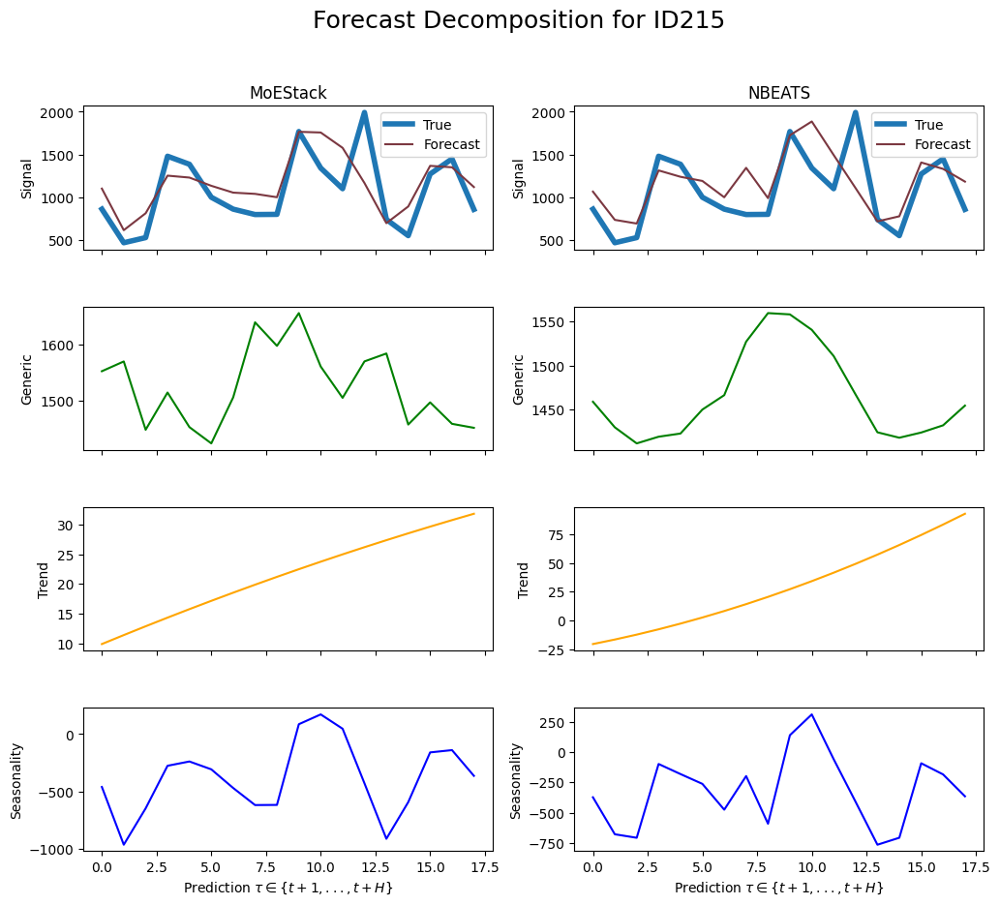

     unique_id         ds       y
2340     ID215 2004-04-30   861.0
2341     ID215 2004-05-31   468.0
2342     ID215 2004-06-30   528.0
2343     ID215 2004-07-31  1480.0
2344     ID215 2004-08-31  1386.0
2345     ID215 2004-09-30  1000.0
2346     ID215 2004-10-31   861.0
2347     ID215 2004-11-30   798.0
2348     ID215 2004-12-31   800.0
2349     ID215 2005-01-31  1769.0
2350     ID215 2005-02-28  1342.0
2351     ID215 2005-03-31  1100.0
2352     ID215 2005-04-30  1992.0
2353     ID215 2005-05-31   741.0
2354     ID215 2005-06-30   551.0
2355     ID215 2005-07-31  1272.0
2356     ID215 2005-08-31  1449.0
2357     ID215 2005-09-30   858.0
Gate values for ID216: [0.30942515 0.22938485 0.46119002]
sMAPE for MoEStack: 0.1269219778114297
sMAPE for NBEATS: 0.15240790337525043


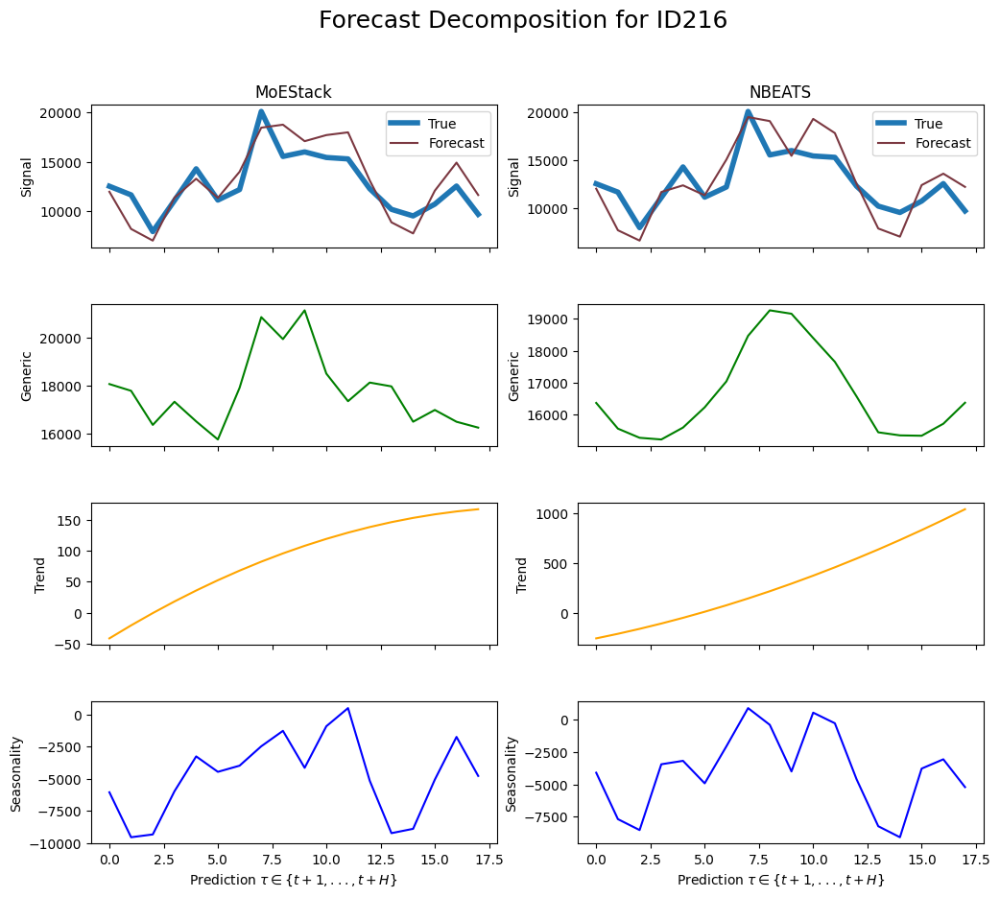

     unique_id         ds        y
2358     ID216 2004-04-30  12537.0
2359     ID216 2004-05-31  11664.0
2360     ID216 2004-06-30   7952.0
2361     ID216 2004-07-31  11100.0
2362     ID216 2004-08-31  14300.0
2363     ID216 2004-09-30  11140.0
2364     ID216 2004-10-31  12201.0
2365     ID216 2004-11-30  20097.0
2366     ID216 2004-12-31  15550.0
2367     ID216 2005-01-31  16008.0
2368     ID216 2005-02-28  15444.0
2369     ID216 2005-03-31  15300.0
2370     ID216 2005-04-30  12288.0
2371     ID216 2005-05-31  10203.0
2372     ID216 2005-06-30   9538.0
2373     ID216 2005-07-31  10728.0
2374     ID216 2005-08-31  12558.0
2375     ID216 2005-09-30   9702.0
Gate values for ID217: [0.44544557 0.23875807 0.31579635]
sMAPE for MoEStack: 0.19083534073810676
sMAPE for NBEATS: 0.2517685728618129


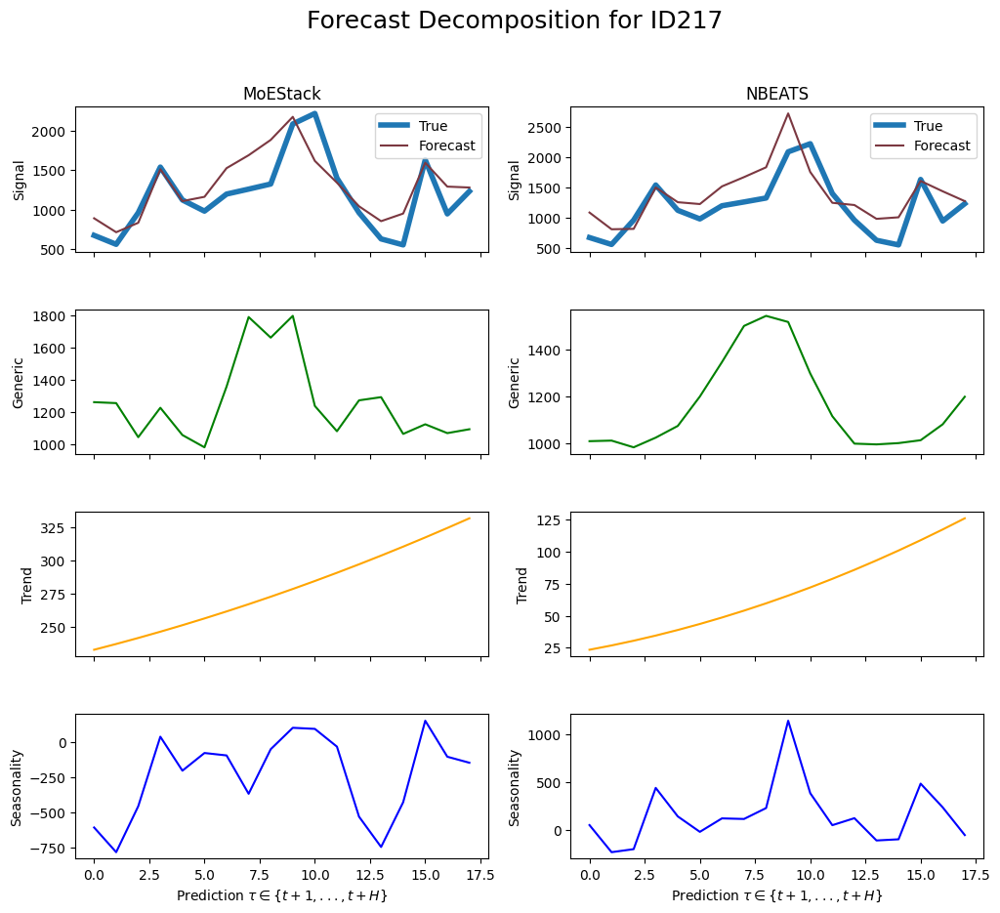

     unique_id         ds       y
2376     ID217 2004-04-30   672.0
2377     ID217 2004-05-31   558.0
2378     ID217 2004-06-30   960.0
2379     ID217 2004-07-31  1540.0
2380     ID217 2004-08-31  1122.0
2381     ID217 2004-09-30   980.0
2382     ID217 2004-10-31  1197.0
2383     ID217 2004-11-30  1260.0
2384     ID217 2004-12-31  1325.0
2385     ID217 2005-01-31  2088.0
2386     ID217 2005-02-28  2222.0
2387     ID217 2005-03-31  1400.0
2388     ID217 2005-04-30   960.0
2389     ID217 2005-05-31   627.0
2390     ID217 2005-06-30   551.0
2391     ID217 2005-07-31  1632.0
2392     ID217 2005-08-31   945.0
2393     ID217 2005-09-30  1232.0
Gate values for ID218: [0.31614336 0.20746168 0.47639495]
sMAPE for MoEStack: 0.25241653907127776
sMAPE for NBEATS: 0.2670434397590739


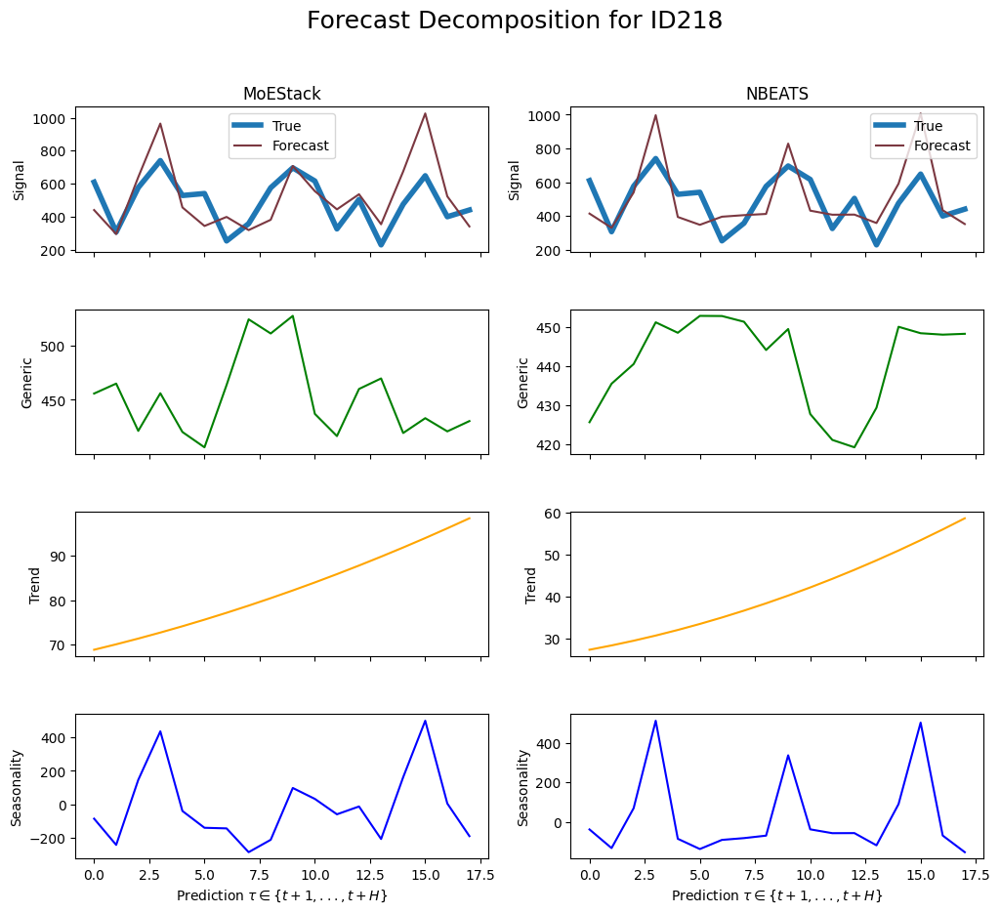

     unique_id         ds      y
2394     ID218 2004-04-30  609.0
2395     ID218 2004-05-31  306.0
2396     ID218 2004-06-30  576.0
2397     ID218 2004-07-31  740.0
2398     ID218 2004-08-31  528.0
2399     ID218 2004-09-30  540.0
2400     ID218 2004-10-31  252.0
2401     ID218 2004-11-30  357.0
2402     ID218 2004-12-31  575.0
2403     ID218 2005-01-31  696.0
2404     ID218 2005-02-28  616.0
2405     ID218 2005-03-31  325.0
2406     ID218 2005-04-30  504.0
2407     ID218 2005-05-31  228.0
2408     ID218 2005-06-30  475.0
2409     ID218 2005-07-31  648.0
2410     ID218 2005-08-31  399.0
2411     ID218 2005-09-30  440.0
Gate values for ID219: [0.23806757 0.22101575 0.54091674]
sMAPE for MoEStack: 0.6672371709982434
sMAPE for NBEATS: 0.6511673276758919


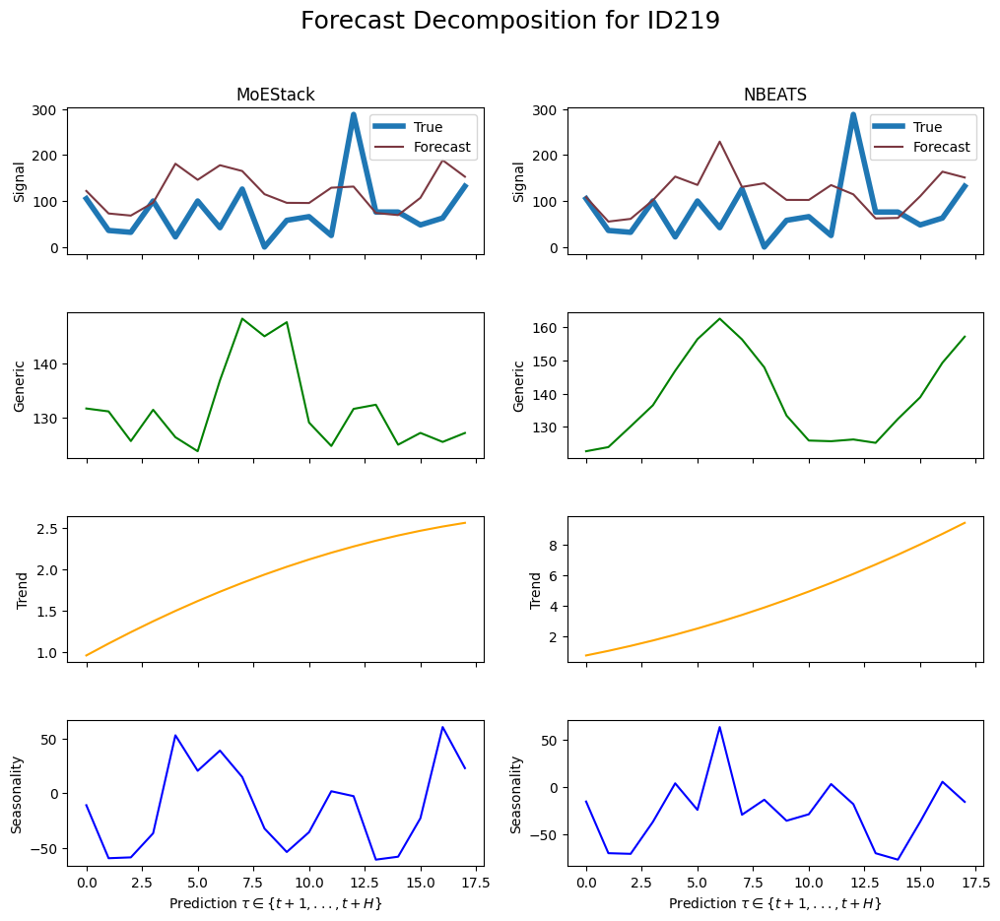

     unique_id         ds      y
2412     ID219 2004-04-30  105.0
2413     ID219 2004-05-31   36.0
2414     ID219 2004-06-30   32.0
2415     ID219 2004-07-31  100.0
2416     ID219 2004-08-31   22.0
2417     ID219 2004-09-30  100.0
2418     ID219 2004-10-31   42.0
2419     ID219 2004-11-30  126.0
2420     ID219 2004-12-31    0.0
2421     ID219 2005-01-31   58.0
2422     ID219 2005-02-28   66.0
2423     ID219 2005-03-31   25.0
2424     ID219 2005-04-30  288.0
2425     ID219 2005-05-31   76.0
2426     ID219 2005-06-30   76.0
2427     ID219 2005-07-31   48.0
2428     ID219 2005-08-31   63.0
2429     ID219 2005-09-30  132.0
Gate values for ID22: [0.3165253  0.20830162 0.47517306]
sMAPE for MoEStack: 0.13017626017753053
sMAPE for NBEATS: 0.14223361917139285


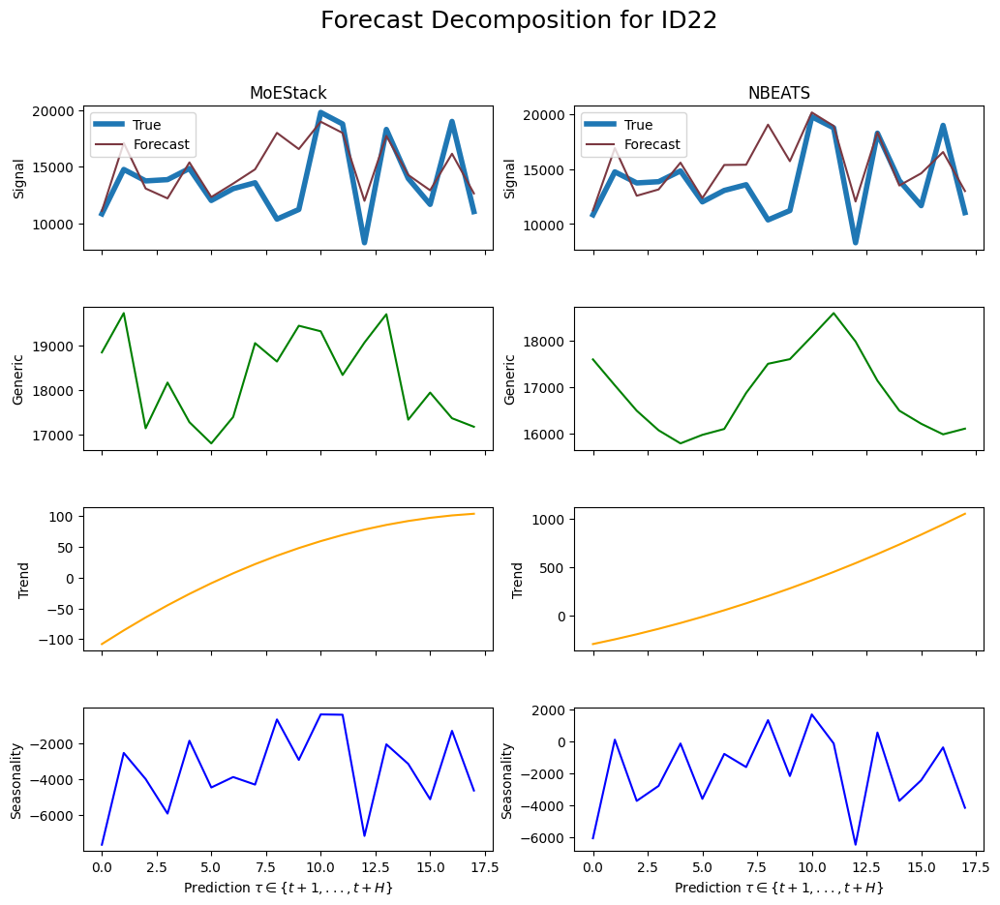

     unique_id         ds        y
2430      ID22 2004-01-31  10842.0
2431      ID22 2004-02-29  14753.0
2432      ID22 2004-03-31  13743.0
2433      ID22 2004-04-30  13856.0
2434      ID22 2004-05-31  14839.0
2435      ID22 2004-06-30  12019.0
2436      ID22 2004-07-31  13060.0
2437      ID22 2004-08-31  13582.0
2438      ID22 2004-09-30  10377.0
2439      ID22 2004-10-31  11228.0
2440      ID22 2004-11-30  19773.0
2441      ID22 2004-12-31  18759.0
2442      ID22 2005-01-31   8298.0
2443      ID22 2005-02-28  18276.0
2444      ID22 2005-03-31  13957.0
2445      ID22 2005-04-30  11673.0
2446      ID22 2005-05-31  18984.0
2447      ID22 2005-06-30  11042.0
Gate values for ID220: [0.34303686 0.26747325 0.38948986]
sMAPE for MoEStack: 0.5154075657113597
sMAPE for NBEATS: 0.43563618586715197


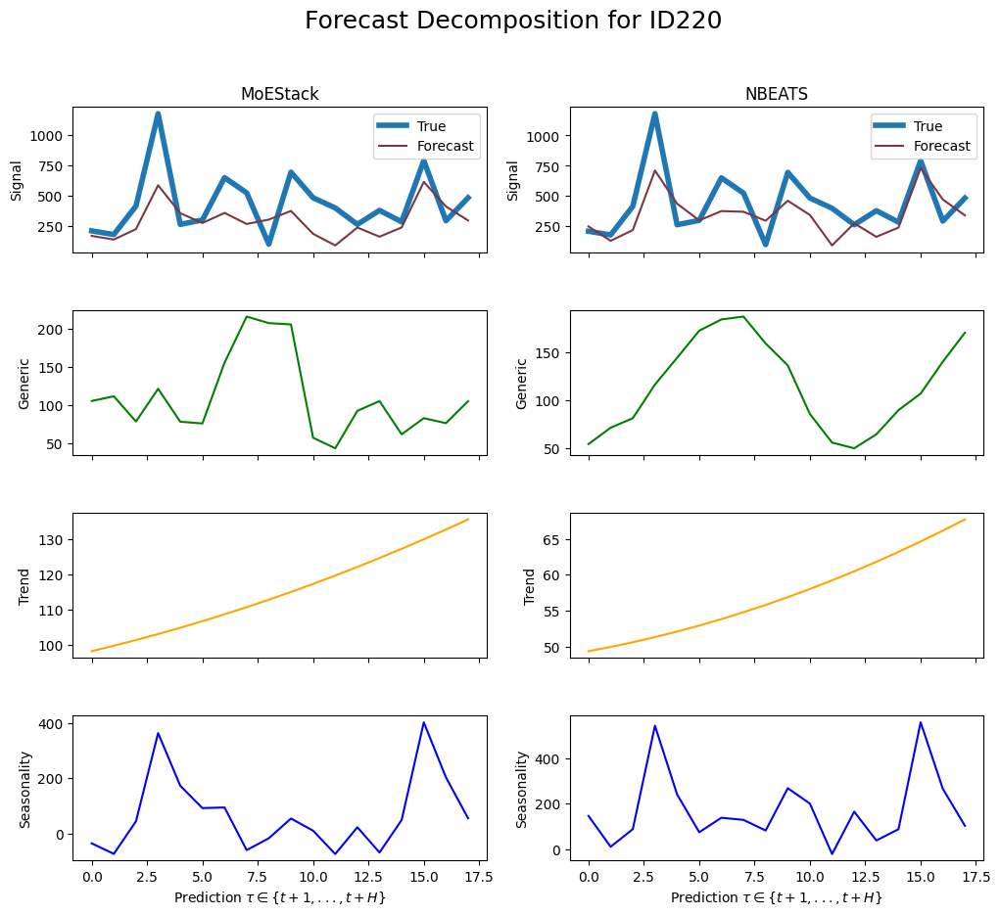

     unique_id         ds       y
2448     ID220 2004-04-30   210.0
2449     ID220 2004-05-31   180.0
2450     ID220 2004-06-30   416.0
2451     ID220 2004-07-31  1180.0
2452     ID220 2004-08-31   264.0
2453     ID220 2004-09-30   300.0
2454     ID220 2004-10-31   651.0
2455     ID220 2004-11-30   525.0
2456     ID220 2004-12-31   100.0
2457     ID220 2005-01-31   696.0
2458     ID220 2005-02-28   484.0
2459     ID220 2005-03-31   400.0
2460     ID220 2005-04-30   264.0
2461     ID220 2005-05-31   380.0
2462     ID220 2005-06-30   285.0
2463     ID220 2005-07-31   792.0
2464     ID220 2005-08-31   294.0
2465     ID220 2005-09-30   484.0
Gate values for ID221: [0.41924903 0.23105857 0.3496924 ]
sMAPE for MoEStack: 0.12590573039907257
sMAPE for NBEATS: 0.15799021421605494


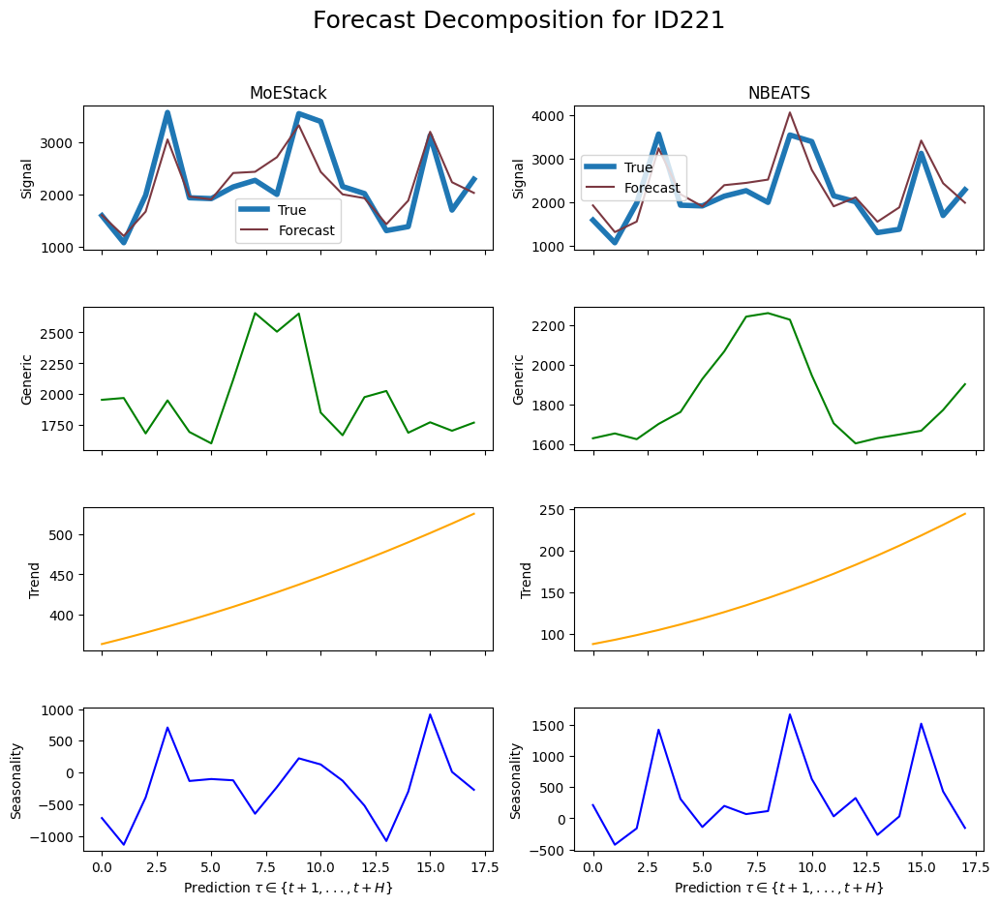

     unique_id         ds       y
2466     ID221 2004-04-30  1596.0
2467     ID221 2004-05-31  1080.0
2468     ID221 2004-06-30  1984.0
2469     ID221 2004-07-31  3560.0
2470     ID221 2004-08-31  1936.0
2471     ID221 2004-09-30  1920.0
2472     ID221 2004-10-31  2142.0
2473     ID221 2004-11-30  2268.0
2474     ID221 2004-12-31  2000.0
2475     ID221 2005-01-31  3538.0
2476     ID221 2005-02-28  3388.0
2477     ID221 2005-03-31  2150.0
2478     ID221 2005-04-30  2016.0
2479     ID221 2005-05-31  1311.0
2480     ID221 2005-06-30  1387.0
2481     ID221 2005-07-31  3120.0
2482     ID221 2005-08-31  1701.0
2483     ID221 2005-09-30  2288.0
Gate values for ID222: [0.42658618 0.16776665 0.40564722]
sMAPE for MoEStack: 0.3799552449112682
sMAPE for NBEATS: 0.33635441107495107


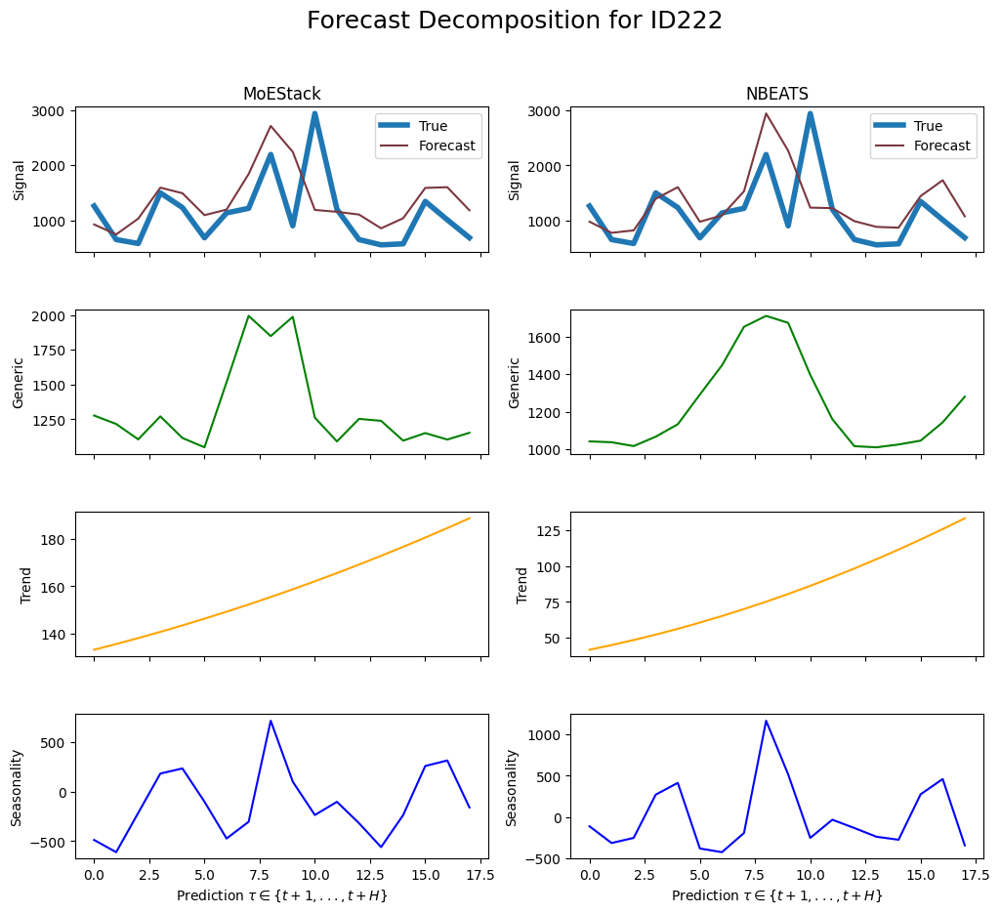

     unique_id         ds       y
2484     ID222 2004-04-30  1260.0
2485     ID222 2004-05-31   648.0
2486     ID222 2004-06-30   576.0
2487     ID222 2004-07-31  1500.0
2488     ID222 2004-08-31  1232.0
2489     ID222 2004-09-30   680.0
2490     ID222 2004-10-31  1134.0
2491     ID222 2004-11-30  1218.0
2492     ID222 2004-12-31  2200.0
2493     ID222 2005-01-31   899.0
2494     ID222 2005-02-28  2948.0
2495     ID222 2005-03-31  1200.0
2496     ID222 2005-04-30   648.0
2497     ID222 2005-05-31   551.0
2498     ID222 2005-06-30   570.0
2499     ID222 2005-07-31  1344.0
2500     ID222 2005-08-31  1008.0
2501     ID222 2005-09-30   682.0
Gate values for ID223: [0.38903725 0.22669867 0.3842641 ]
sMAPE for MoEStack: 0.3060756346771594
sMAPE for NBEATS: 0.27354253801536776


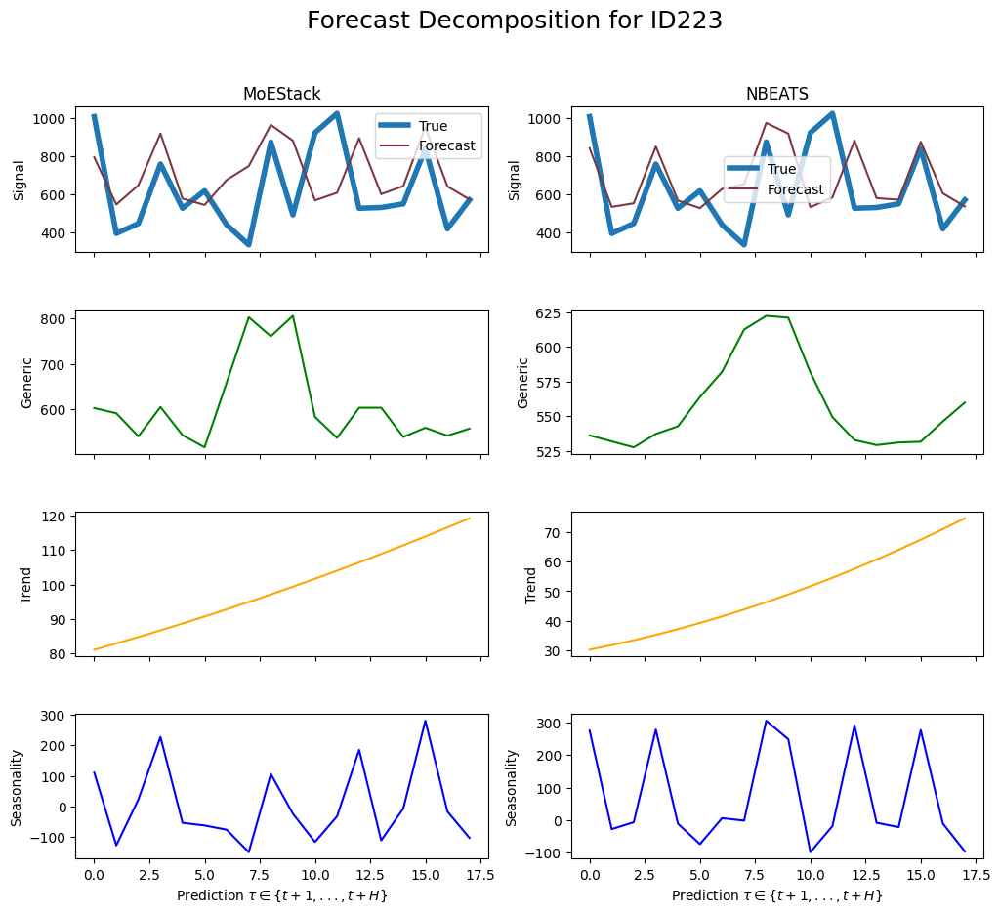

     unique_id         ds       y
2502     ID223 2004-04-30  1008.0
2503     ID223 2004-05-31   396.0
2504     ID223 2004-06-30   448.0
2505     ID223 2004-07-31   760.0
2506     ID223 2004-08-31   528.0
2507     ID223 2004-09-30   620.0
2508     ID223 2004-10-31   441.0
2509     ID223 2004-11-30   336.0
2510     ID223 2004-12-31   875.0
2511     ID223 2005-01-31   493.0
2512     ID223 2005-02-28   924.0
2513     ID223 2005-03-31  1025.0
2514     ID223 2005-04-30   528.0
2515     ID223 2005-05-31   532.0
2516     ID223 2005-06-30   551.0
2517     ID223 2005-07-31   840.0
2518     ID223 2005-08-31   420.0
2519     ID223 2005-09-30   572.0
Gate values for ID224: [0.28798258 0.27332258 0.4386948 ]
sMAPE for MoEStack: 0.38040596788669817
sMAPE for NBEATS: 0.4084622478190464


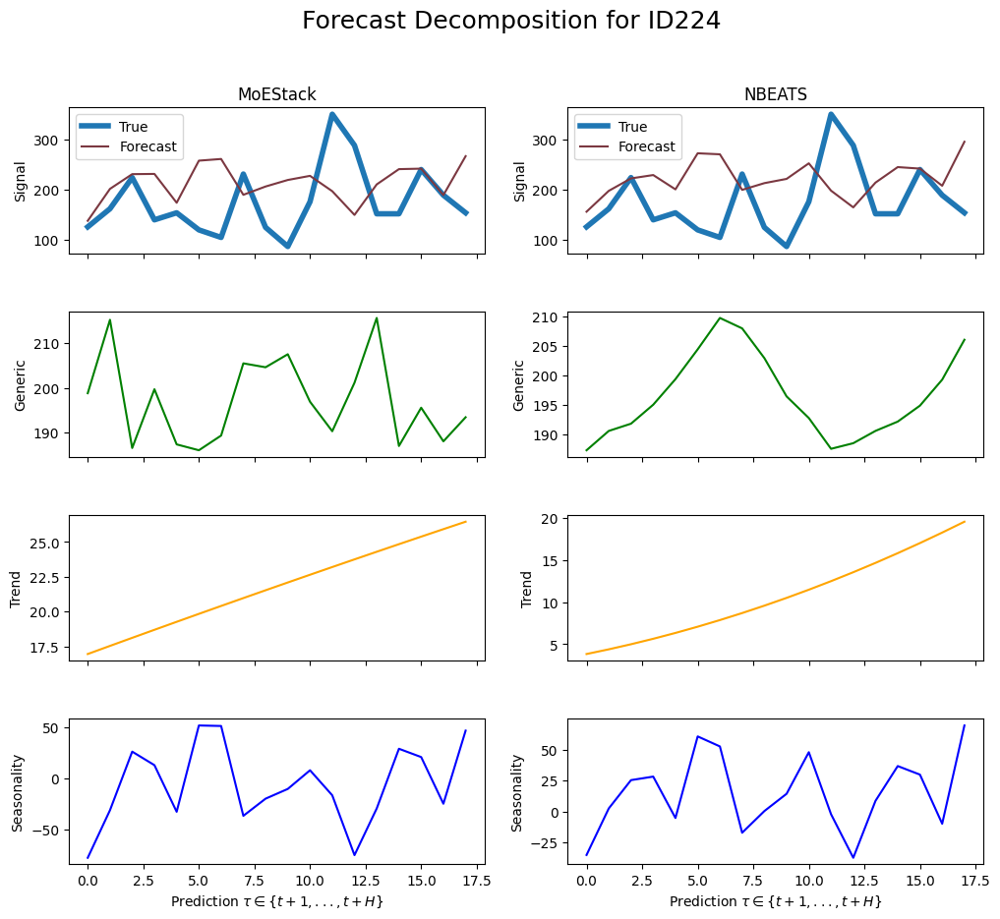

     unique_id         ds      y
2520     ID224 2004-04-30  126.0
2521     ID224 2004-05-31  162.0
2522     ID224 2004-06-30  224.0
2523     ID224 2004-07-31  140.0
2524     ID224 2004-08-31  154.0
2525     ID224 2004-09-30  120.0
2526     ID224 2004-10-31  105.0
2527     ID224 2004-11-30  231.0
2528     ID224 2004-12-31  125.0
2529     ID224 2005-01-31   87.0
2530     ID224 2005-02-28  176.0
2531     ID224 2005-03-31  350.0
2532     ID224 2005-04-30  288.0
2533     ID224 2005-05-31  152.0
2534     ID224 2005-06-30  152.0
2535     ID224 2005-07-31  240.0
2536     ID224 2005-08-31  189.0
2537     ID224 2005-09-30  154.0
Gate values for ID225: [0.42387488 0.17675485 0.3993703 ]
sMAPE for MoEStack: 0.29779109874417936
sMAPE for NBEATS: 0.27225921022642685


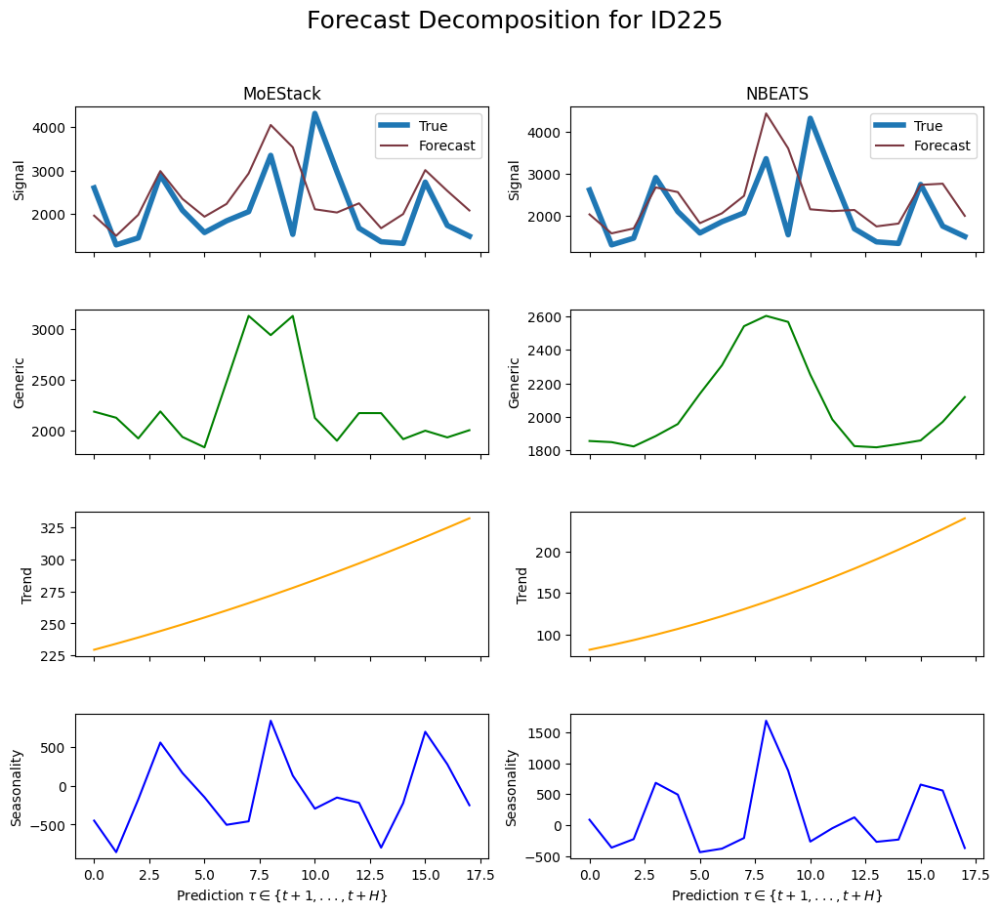

     unique_id         ds       y
2538     ID225 2004-04-30  2604.0
2539     ID225 2004-05-31  1296.0
2540     ID225 2004-06-30  1456.0
2541     ID225 2004-07-31  2900.0
2542     ID225 2004-08-31  2090.0
2543     ID225 2004-09-30  1580.0
2544     ID225 2004-10-31  1848.0
2545     ID225 2004-11-30  2058.0
2546     ID225 2004-12-31  3350.0
2547     ID225 2005-01-31  1537.0
2548     ID225 2005-02-28  4312.0
2549     ID225 2005-03-31  2975.0
2550     ID225 2005-04-30  1680.0
2551     ID225 2005-05-31  1368.0
2552     ID225 2005-06-30  1330.0
2553     ID225 2005-07-31  2736.0
2554     ID225 2005-08-31  1743.0
2555     ID225 2005-09-30  1496.0
Gate values for ID226: [0.36228266 0.22042648 0.41729087]
sMAPE for MoEStack: 0.1421089424373703
sMAPE for NBEATS: 0.11594509118885818


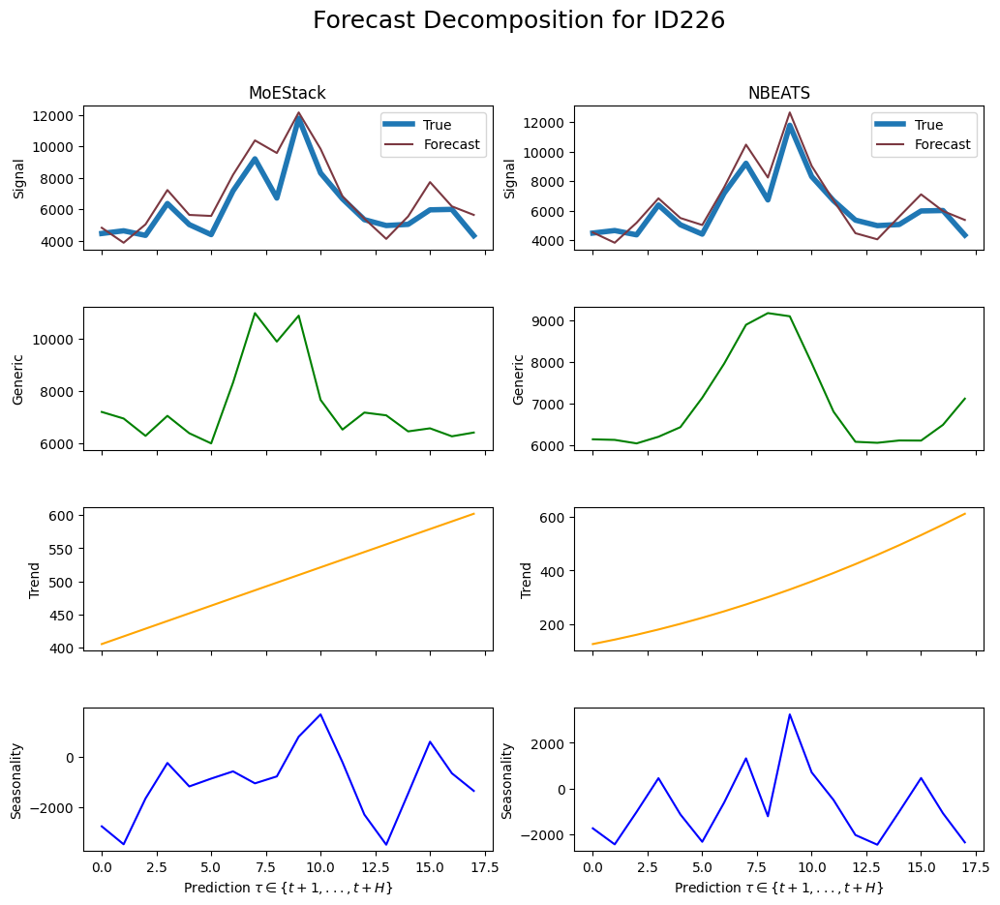

     unique_id         ds        y
2556     ID226 2004-04-30   4473.0
2557     ID226 2004-05-31   4644.0
2558     ID226 2004-06-30   4352.0
2559     ID226 2004-07-31   6380.0
2560     ID226 2004-08-31   5038.0
2561     ID226 2004-09-30   4400.0
2562     ID226 2004-10-31   7182.0
2563     ID226 2004-11-30   9219.0
2564     ID226 2004-12-31   6725.0
2565     ID226 2005-01-31  11803.0
2566     ID226 2005-02-28   8316.0
2567     ID226 2005-03-31   6675.0
2568     ID226 2005-04-30   5352.0
2569     ID226 2005-05-31   4978.0
2570     ID226 2005-06-30   5054.0
2571     ID226 2005-07-31   5976.0
2572     ID226 2005-08-31   6006.0
2573     ID226 2005-09-30   4334.0
Gate values for ID227: [0.41955206 0.19833182 0.3821161 ]
sMAPE for MoEStack: 0.2827094222829076
sMAPE for NBEATS: 0.25347479817217455


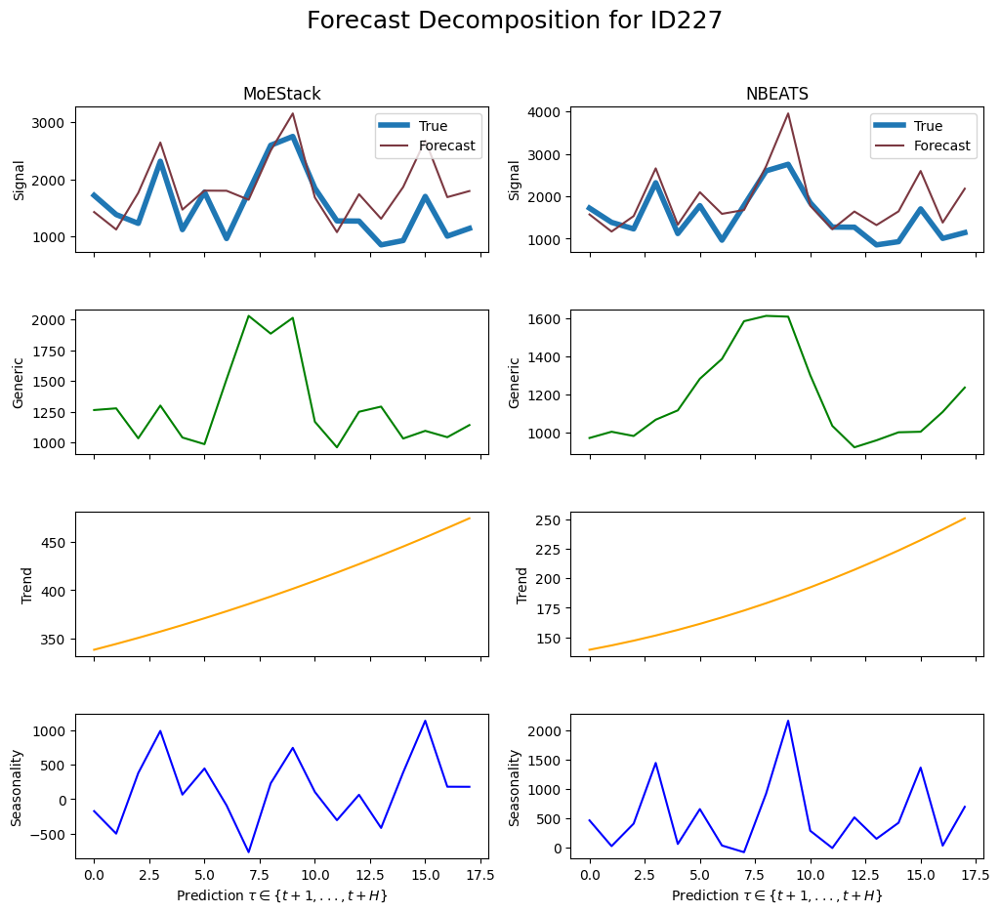

     unique_id         ds       y
2574     ID227 2004-04-30  1722.0
2575     ID227 2004-05-31  1386.0
2576     ID227 2004-06-30  1232.0
2577     ID227 2004-07-31  2320.0
2578     ID227 2004-08-31  1122.0
2579     ID227 2004-09-30  1780.0
2580     ID227 2004-10-31   966.0
2581     ID227 2004-11-30  1785.0
2582     ID227 2004-12-31  2600.0
2583     ID227 2005-01-31  2755.0
2584     ID227 2005-02-28  1848.0
2585     ID227 2005-03-31  1275.0
2586     ID227 2005-04-30  1272.0
2587     ID227 2005-05-31   855.0
2588     ID227 2005-06-30   931.0
2589     ID227 2005-07-31  1704.0
2590     ID227 2005-08-31  1008.0
2591     ID227 2005-09-30  1144.0
Gate values for ID228: [0.25493866 0.46945024 0.27561104]
sMAPE for MoEStack: 0.25342166758537116
sMAPE for NBEATS: 0.28042519769209684


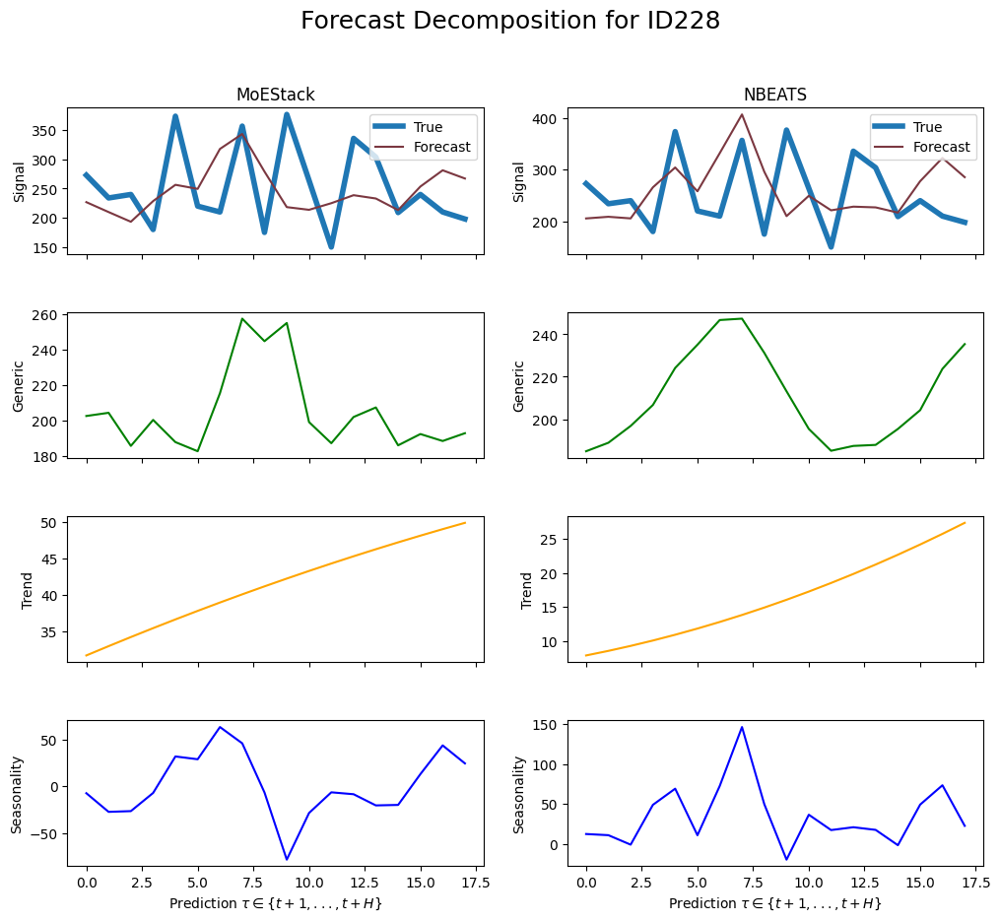

     unique_id         ds      y
2592     ID228 2004-04-30  273.0
2593     ID228 2004-05-31  234.0
2594     ID228 2004-06-30  240.0
2595     ID228 2004-07-31  180.0
2596     ID228 2004-08-31  374.0
2597     ID228 2004-09-30  220.0
2598     ID228 2004-10-31  210.0
2599     ID228 2004-11-30  357.0
2600     ID228 2004-12-31  175.0
2601     ID228 2005-01-31  377.0
2602     ID228 2005-02-28  264.0
2603     ID228 2005-03-31  150.0
2604     ID228 2005-04-30  336.0
2605     ID228 2005-05-31  304.0
2606     ID228 2005-06-30  209.0
2607     ID228 2005-07-31  240.0
2608     ID228 2005-08-31  210.0
2609     ID228 2005-09-30  198.0
Gate values for ID229: [0.40012634 0.24868053 0.3511931 ]
sMAPE for MoEStack: 0.26019783014012954
sMAPE for NBEATS: 0.2578413314825091


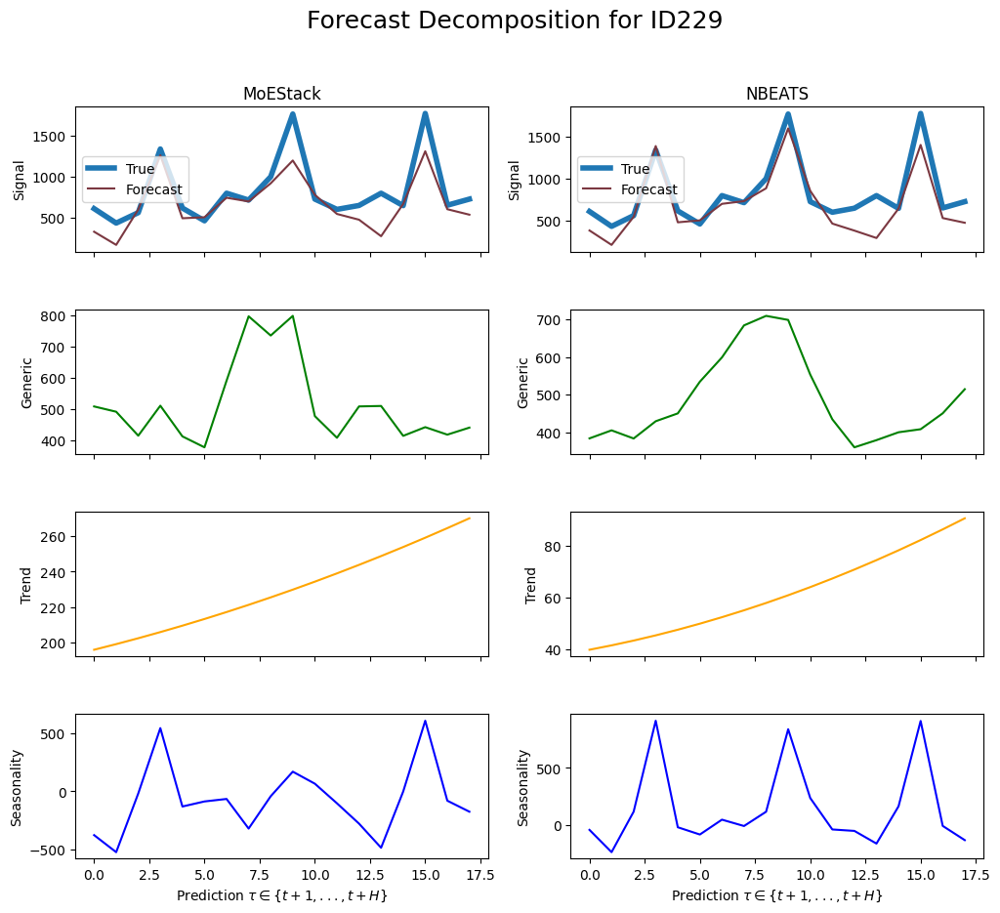

     unique_id         ds       y
2610     ID229 2004-04-30   609.0
2611     ID229 2004-05-31   432.0
2612     ID229 2004-06-30   560.0
2613     ID229 2004-07-31  1340.0
2614     ID229 2004-08-31   616.0
2615     ID229 2004-09-30   460.0
2616     ID229 2004-10-31   798.0
2617     ID229 2004-11-30   714.0
2618     ID229 2004-12-31  1000.0
2619     ID229 2005-01-31  1769.0
2620     ID229 2005-02-28   726.0
2621     ID229 2005-03-31   600.0
2622     ID229 2005-04-30   648.0
2623     ID229 2005-05-31   798.0
2624     ID229 2005-06-30   646.0
2625     ID229 2005-07-31  1776.0
2626     ID229 2005-08-31   651.0
2627     ID229 2005-09-30   726.0
Gate values for ID23: [0.17918728 0.25530145 0.5655113 ]
sMAPE for MoEStack: 0.18442494487394323
sMAPE for NBEATS: 0.2703401446635767


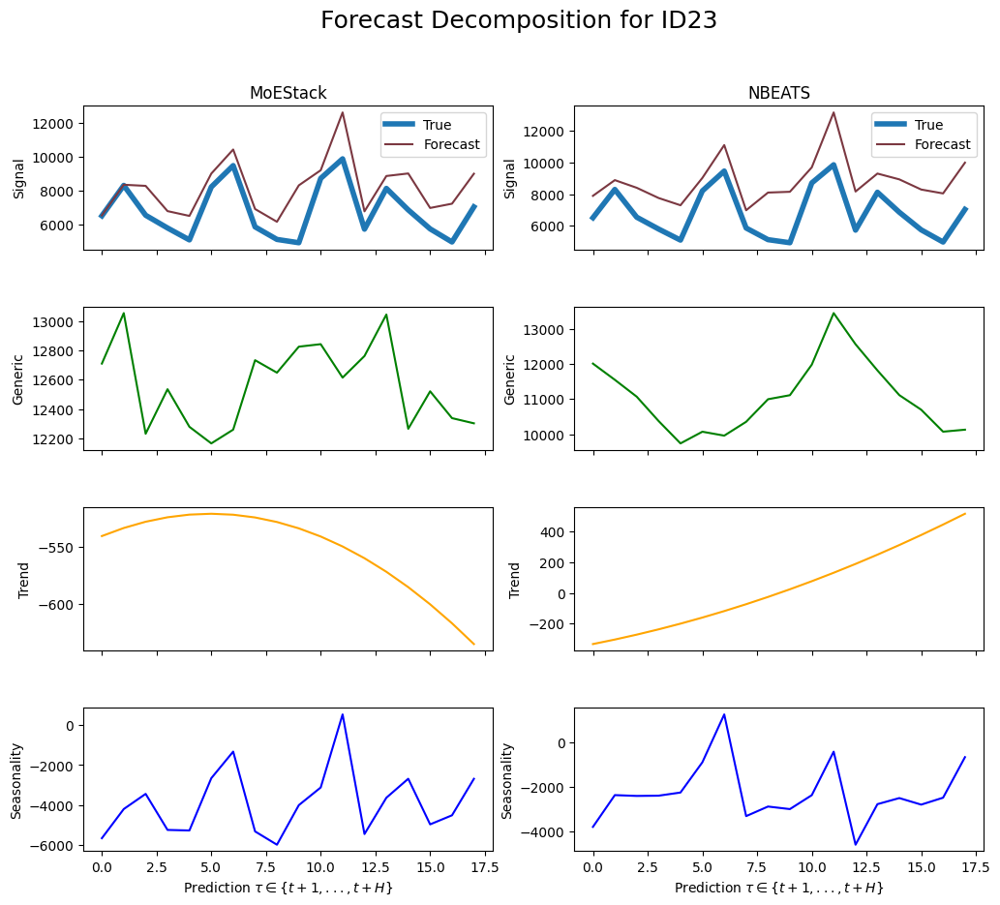

     unique_id         ds       y
2628      ID23 2004-01-31  6506.0
2629      ID23 2004-02-29  8297.0
2630      ID23 2004-03-31  6540.0
2631      ID23 2004-04-30  5790.0
2632      ID23 2004-05-31  5088.0
2633      ID23 2004-06-30  8205.0
2634      ID23 2004-07-31  9463.0
2635      ID23 2004-08-31  5855.0
2636      ID23 2004-09-30  5117.0
2637      ID23 2004-10-31  4922.0
2638      ID23 2004-11-30  8710.0
2639      ID23 2004-12-31  9861.0
2640      ID23 2005-01-31  5719.0
2641      ID23 2005-02-28  8120.0
2642      ID23 2005-03-31  6854.0
2643      ID23 2005-04-30  5738.0
2644      ID23 2005-05-31  4966.0
2645      ID23 2005-06-30  7031.0
Gate values for ID230: [0.3863235  0.21811245 0.39556405]
sMAPE for MoEStack: 0.1452221046571209
sMAPE for NBEATS: 0.1204150464728117


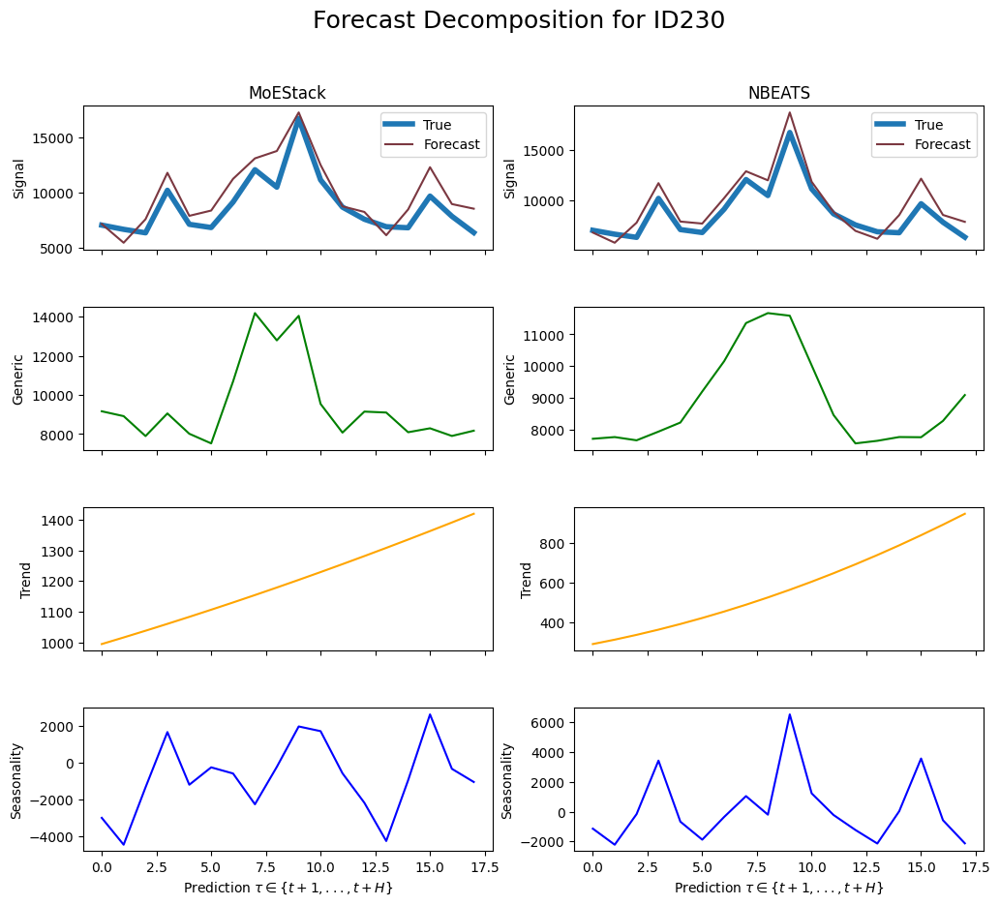

     unique_id         ds        y
2646     ID230 2004-04-30   7077.0
2647     ID230 2004-05-31   6696.0
2648     ID230 2004-06-30   6384.0
2649     ID230 2004-07-31  10220.0
2650     ID230 2004-08-31   7150.0
2651     ID230 2004-09-30   6860.0
2652     ID230 2004-10-31   9156.0
2653     ID230 2004-11-30  12075.0
2654     ID230 2004-12-31  10500.0
2655     ID230 2005-01-31  16704.0
2656     ID230 2005-02-28  11154.0
2657     ID230 2005-03-31   8700.0
2658     ID230 2005-04-30   7608.0
2659     ID230 2005-05-31   6935.0
2660     ID230 2005-06-30   6840.0
2661     ID230 2005-07-31   9696.0
2662     ID230 2005-08-31   7875.0
2663     ID230 2005-09-30   6402.0
Gate values for ID231: [0.4114797  0.18974613 0.39877424]
sMAPE for MoEStack: 0.47375759068251966
sMAPE for NBEATS: 0.5326832799510717


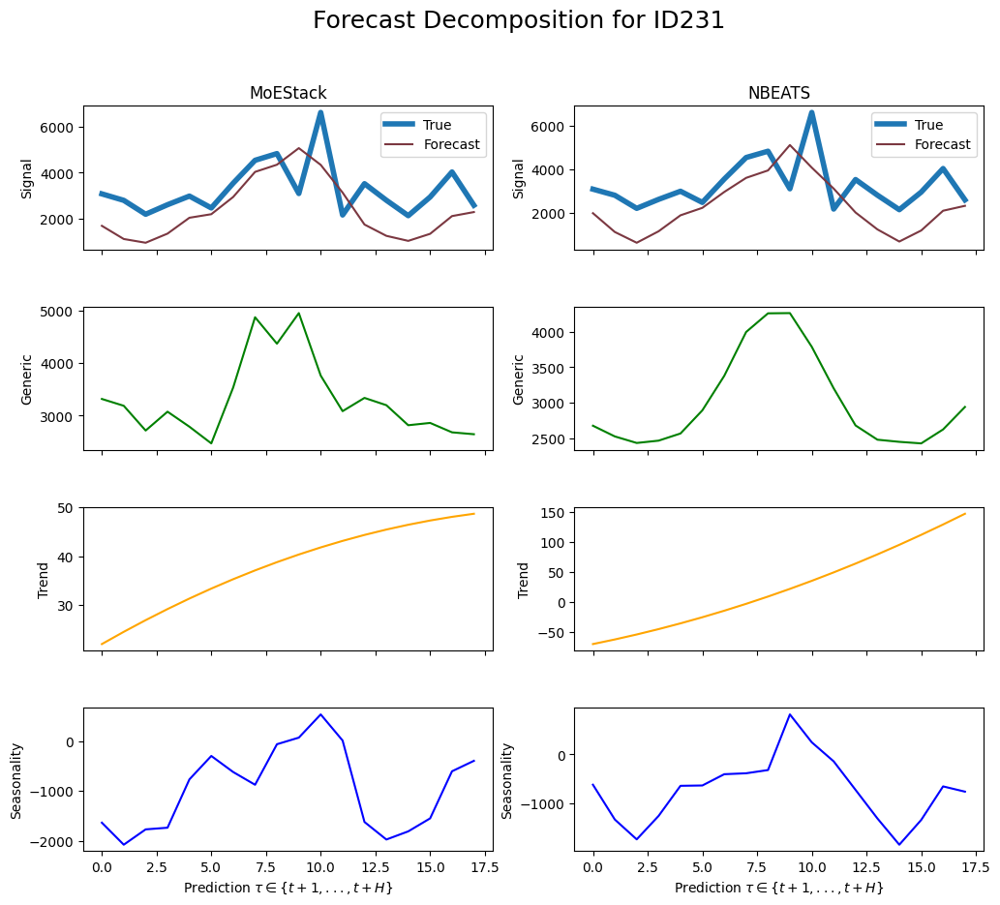

     unique_id         ds       y
2664     ID231 2004-04-30  3087.0
2665     ID231 2004-05-31  2808.0
2666     ID231 2004-06-30  2208.0
2667     ID231 2004-07-31  2620.0
2668     ID231 2004-08-31  2992.0
2669     ID231 2004-09-30  2480.0
2670     ID231 2004-10-31  3549.0
2671     ID231 2004-11-30  4536.0
2672     ID231 2004-12-31  4825.0
2673     ID231 2005-01-31  3103.0
2674     ID231 2005-02-28  6600.0
2675     ID231 2005-03-31  2175.0
2676     ID231 2005-04-30  3528.0
2677     ID231 2005-05-31  2812.0
2678     ID231 2005-06-30  2147.0
2679     ID231 2005-07-31  2952.0
2680     ID231 2005-08-31  4032.0
2681     ID231 2005-09-30  2596.0
Gate values for ID232: [0.43203774 0.20832905 0.3596332 ]
sMAPE for MoEStack: 0.27774928665918747
sMAPE for NBEATS: 0.2442497875329751


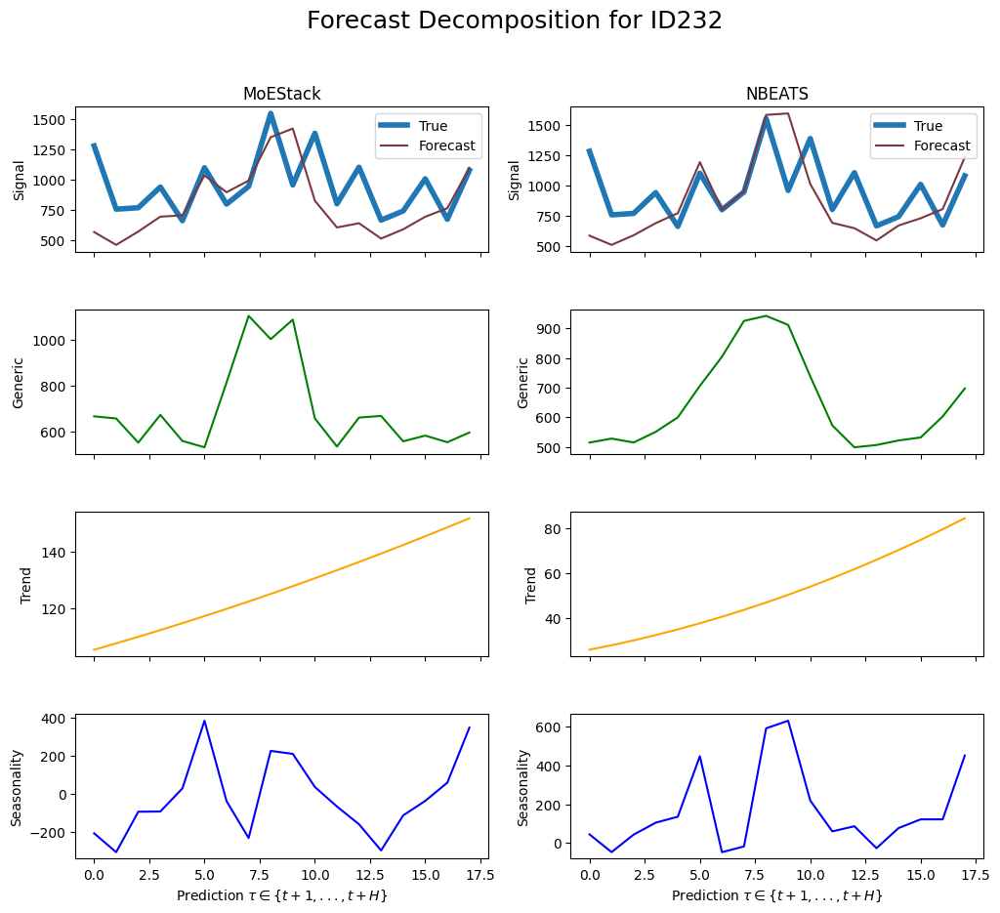

     unique_id         ds       y
2682     ID232 2004-04-30  1281.0
2683     ID232 2004-05-31   756.0
2684     ID232 2004-06-30   768.0
2685     ID232 2004-07-31   940.0
2686     ID232 2004-08-31   660.0
2687     ID232 2004-09-30  1100.0
2688     ID232 2004-10-31   798.0
2689     ID232 2004-11-30   945.0
2690     ID232 2004-12-31  1550.0
2691     ID232 2005-01-31   957.0
2692     ID232 2005-02-28  1386.0
2693     ID232 2005-03-31   800.0
2694     ID232 2005-04-30  1104.0
2695     ID232 2005-05-31   665.0
2696     ID232 2005-06-30   741.0
2697     ID232 2005-07-31  1008.0
2698     ID232 2005-08-31   672.0
2699     ID232 2005-09-30  1078.0
Gate values for ID233: [0.30791292 0.21071453 0.4813725 ]
sMAPE for MoEStack: 0.22992732289254747
sMAPE for NBEATS: 0.2050150614185301


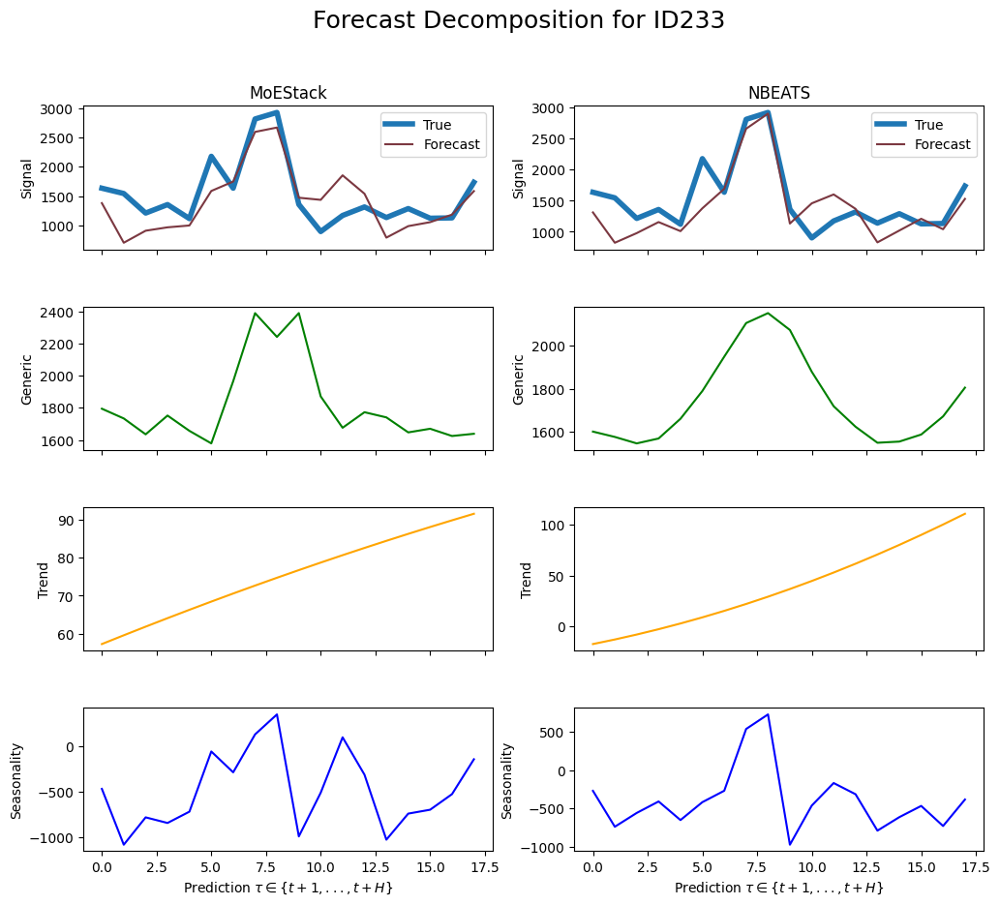

     unique_id         ds       y
2700     ID233 2004-04-30  1638.0
2701     ID233 2004-05-31  1548.0
2702     ID233 2004-06-30  1216.0
2703     ID233 2004-07-31  1360.0
2704     ID233 2004-08-31  1122.0
2705     ID233 2004-09-30  2180.0
2706     ID233 2004-10-31  1638.0
2707     ID233 2004-11-30  2814.0
2708     ID233 2004-12-31  2925.0
2709     ID233 2005-01-31  1363.0
2710     ID233 2005-02-28   902.0
2711     ID233 2005-03-31  1175.0
2712     ID233 2005-04-30  1320.0
2713     ID233 2005-05-31  1140.0
2714     ID233 2005-06-30  1292.0
2715     ID233 2005-07-31  1128.0
2716     ID233 2005-08-31  1134.0
2717     ID233 2005-09-30  1738.0
Gate values for ID234: [0.35293972 0.2506267  0.39643353]
sMAPE for MoEStack: 0.22994353750392302
sMAPE for NBEATS: 0.24737431177049732


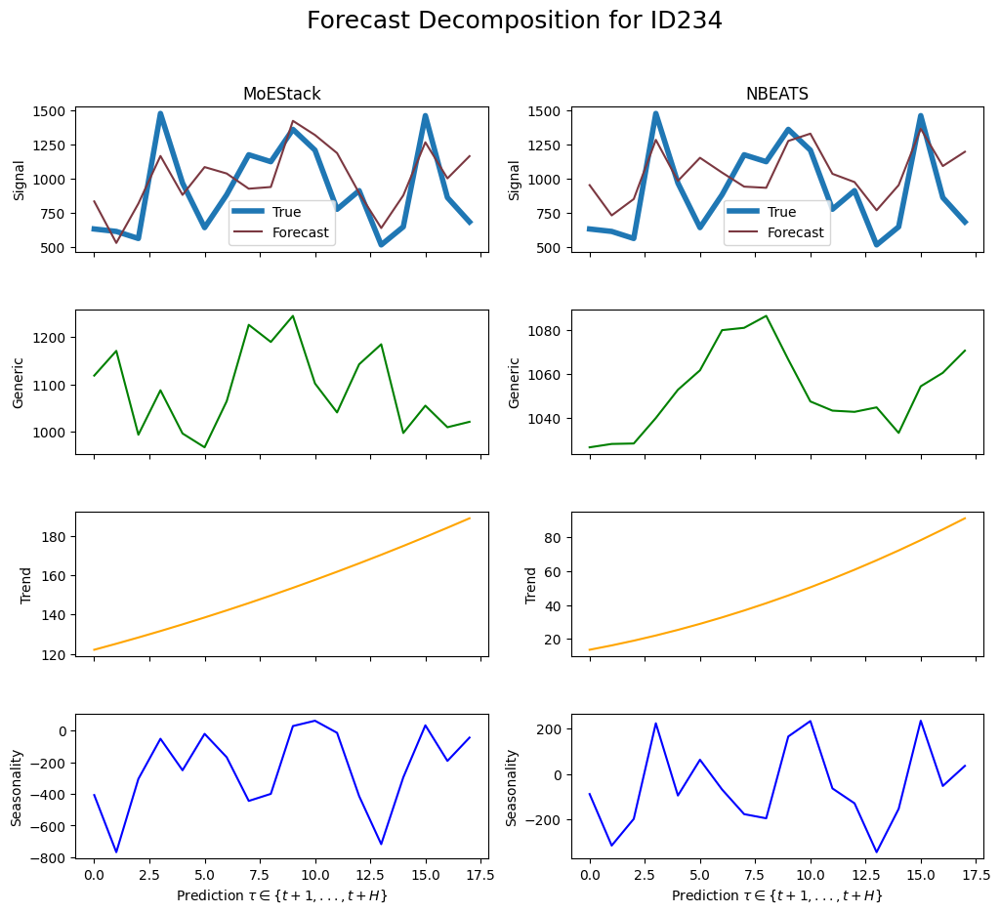

     unique_id         ds       y
2718     ID234 2004-04-30   630.0
2719     ID234 2004-05-31   612.0
2720     ID234 2004-06-30   560.0
2721     ID234 2004-07-31  1480.0
2722     ID234 2004-08-31   968.0
2723     ID234 2004-09-30   640.0
2724     ID234 2004-10-31   882.0
2725     ID234 2004-11-30  1176.0
2726     ID234 2004-12-31  1125.0
2727     ID234 2005-01-31  1363.0
2728     ID234 2005-02-28  1210.0
2729     ID234 2005-03-31   775.0
2730     ID234 2005-04-30   912.0
2731     ID234 2005-05-31   513.0
2732     ID234 2005-06-30   646.0
2733     ID234 2005-07-31  1464.0
2734     ID234 2005-08-31   861.0
2735     ID234 2005-09-30   682.0
Gate values for ID235: [0.40517712 0.1898998  0.40492308]
sMAPE for MoEStack: 0.2868736875916855
sMAPE for NBEATS: 0.24189220047510102


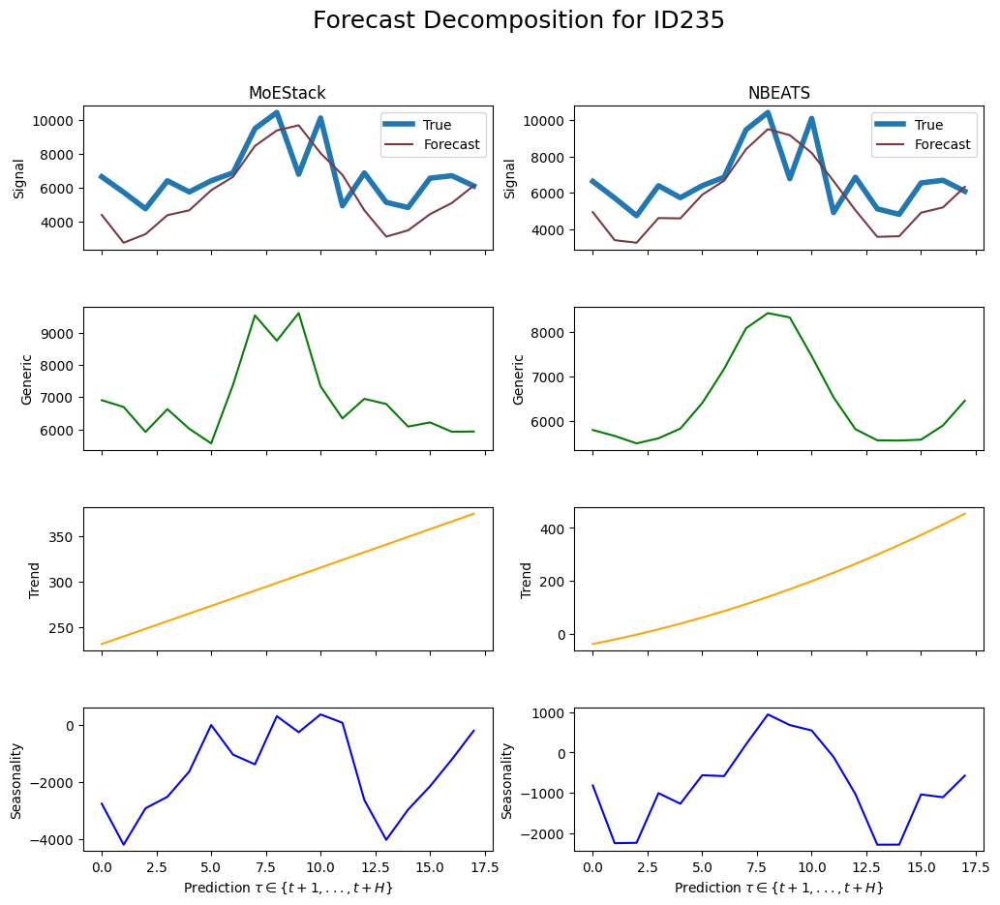

     unique_id         ds        y
2736     ID235 2004-04-30   6636.0
2737     ID235 2004-05-31   5724.0
2738     ID235 2004-06-30   4752.0
2739     ID235 2004-07-31   6400.0
2740     ID235 2004-08-31   5742.0
2741     ID235 2004-09-30   6400.0
2742     ID235 2004-10-31   6867.0
2743     ID235 2004-11-30   9471.0
2744     ID235 2004-12-31  10425.0
2745     ID235 2005-01-31   6786.0
2746     ID235 2005-02-28  10098.0
2747     ID235 2005-03-31   4925.0
2748     ID235 2005-04-30   6864.0
2749     ID235 2005-05-31   5130.0
2750     ID235 2005-06-30   4826.0
2751     ID235 2005-07-31   6552.0
2752     ID235 2005-08-31   6699.0
2753     ID235 2005-09-30   6094.0
Gate values for ID236: [0.37452856 0.21912767 0.40634373]
sMAPE for MoEStack: 0.5891818303399764
sMAPE for NBEATS: 0.5729130302971122


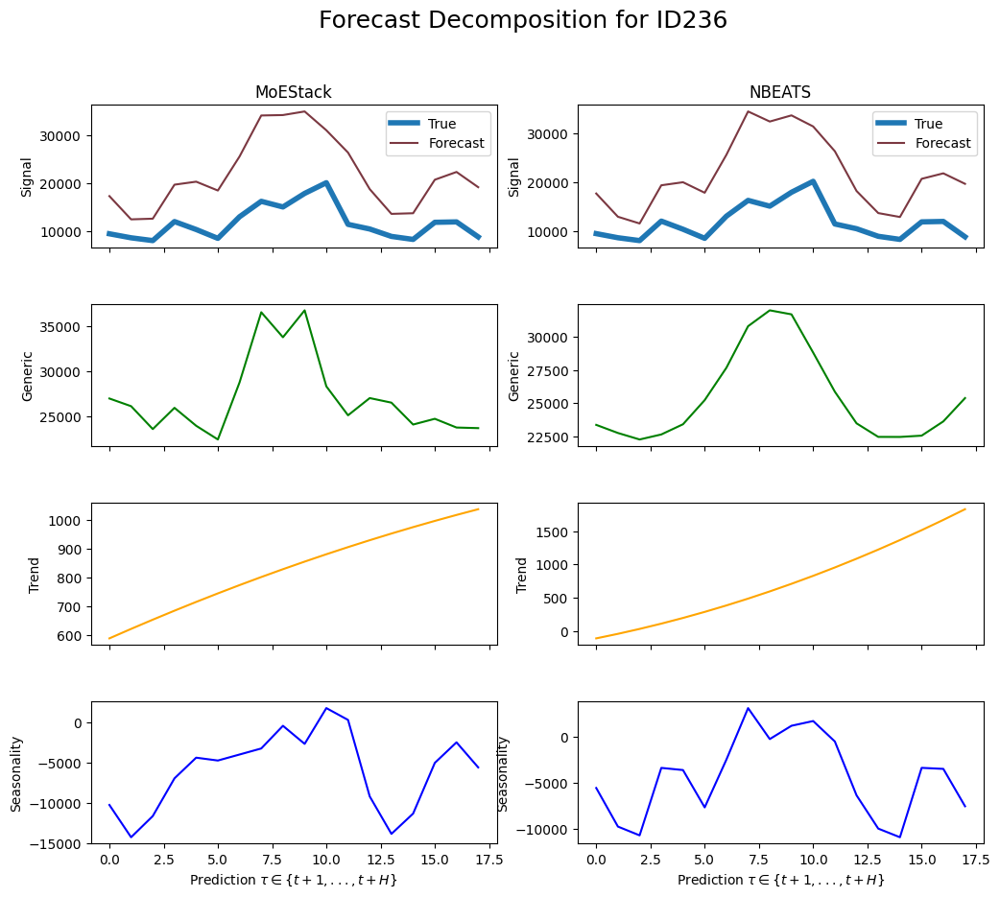

     unique_id         ds        y
2754     ID236 2004-04-30   9513.0
2755     ID236 2004-05-31   8676.0
2756     ID236 2004-06-30   8096.0
2757     ID236 2004-07-31  12060.0
2758     ID236 2004-08-31  10406.0
2759     ID236 2004-09-30   8560.0
2760     ID236 2004-10-31  13062.0
2761     ID236 2004-11-30  16275.0
2762     ID236 2004-12-31  15100.0
2763     ID236 2005-01-31  17922.0
2764     ID236 2005-02-28  20152.0
2765     ID236 2005-03-31  11475.0
2766     ID236 2005-04-30  10512.0
2767     ID236 2005-05-31   8968.0
2768     ID236 2005-06-30   8341.0
2769     ID236 2005-07-31  11904.0
2770     ID236 2005-08-31  11991.0
2771     ID236 2005-09-30   8866.0
Gate values for ID237: [0.3799893  0.16316347 0.45684728]
sMAPE for MoEStack: 0.3892841887803942
sMAPE for NBEATS: 0.3734446599647001


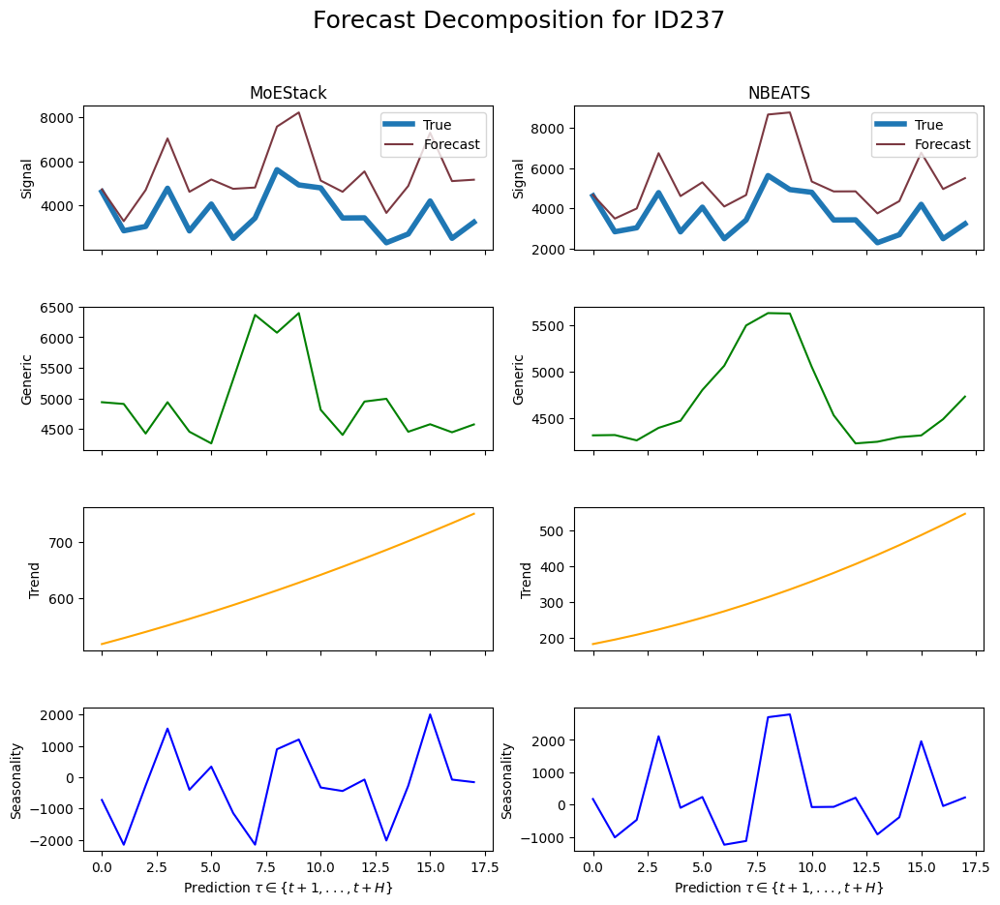

     unique_id         ds       y
2772     ID237 2004-04-30  4620.0
2773     ID237 2004-05-31  2844.0
2774     ID237 2004-06-30  3040.0
2775     ID237 2004-07-31  4780.0
2776     ID237 2004-08-31  2838.0
2777     ID237 2004-09-30  4060.0
2778     ID237 2004-10-31  2499.0
2779     ID237 2004-11-30  3423.0
2780     ID237 2004-12-31  5625.0
2781     ID237 2005-01-31  4930.0
2782     ID237 2005-02-28  4796.0
2783     ID237 2005-03-31  3425.0
2784     ID237 2005-04-30  3432.0
2785     ID237 2005-05-31  2299.0
2786     ID237 2005-06-30  2698.0
2787     ID237 2005-07-31  4200.0
2788     ID237 2005-08-31  2499.0
2789     ID237 2005-09-30  3234.0
Gate values for ID238: [0.32968715 0.22999488 0.440318  ]
sMAPE for MoEStack: 0.24666022989842004
sMAPE for NBEATS: 0.25686384052718536


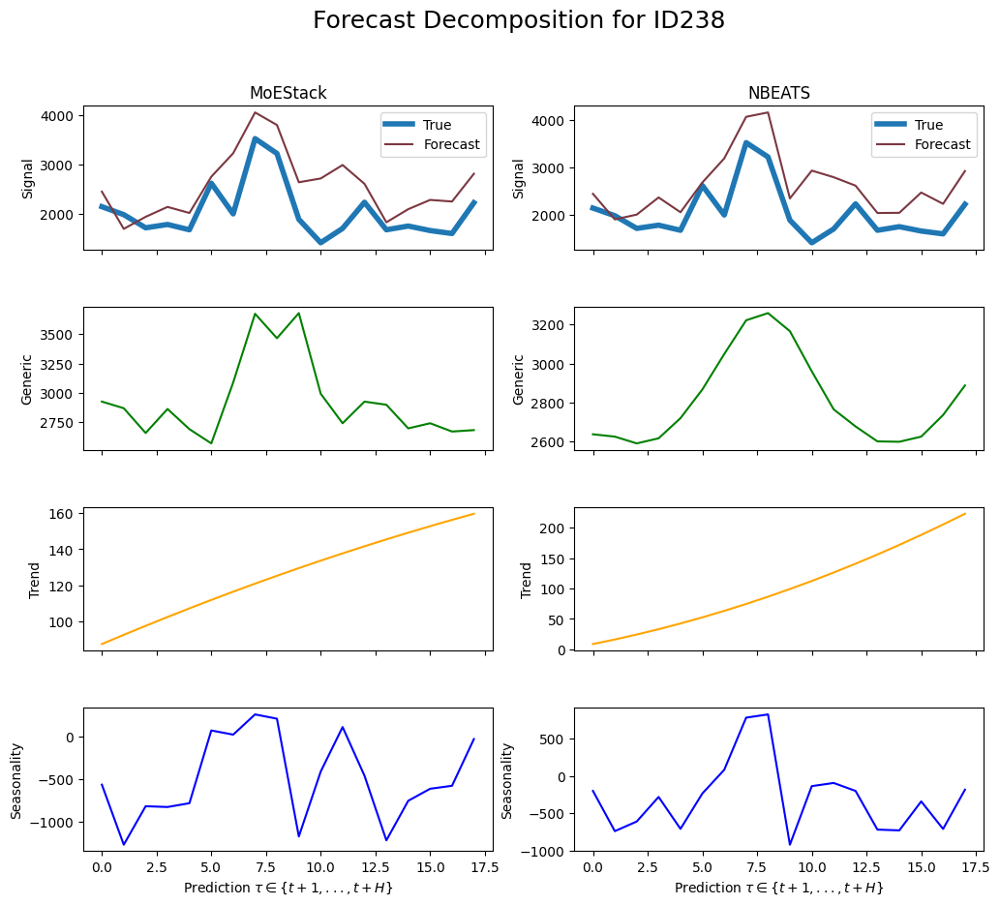

     unique_id         ds       y
2790     ID238 2004-04-30  2142.0
2791     ID238 2004-05-31  1980.0
2792     ID238 2004-06-30  1712.0
2793     ID238 2004-07-31  1780.0
2794     ID238 2004-08-31  1672.0
2795     ID238 2004-09-30  2620.0
2796     ID238 2004-10-31  1995.0
2797     ID238 2004-11-30  3528.0
2798     ID238 2004-12-31  3225.0
2799     ID238 2005-01-31  1885.0
2800     ID238 2005-02-28  1408.0
2801     ID238 2005-03-31  1700.0
2802     ID238 2005-04-30  2232.0
2803     ID238 2005-05-31  1672.0
2804     ID238 2005-06-30  1748.0
2805     ID238 2005-07-31  1656.0
2806     ID238 2005-08-31  1596.0
2807     ID238 2005-09-30  2222.0
Gate values for ID239: [0.3536925  0.23466343 0.41164407]
sMAPE for MoEStack: 0.34222867638704696
sMAPE for NBEATS: 0.36526013006040525


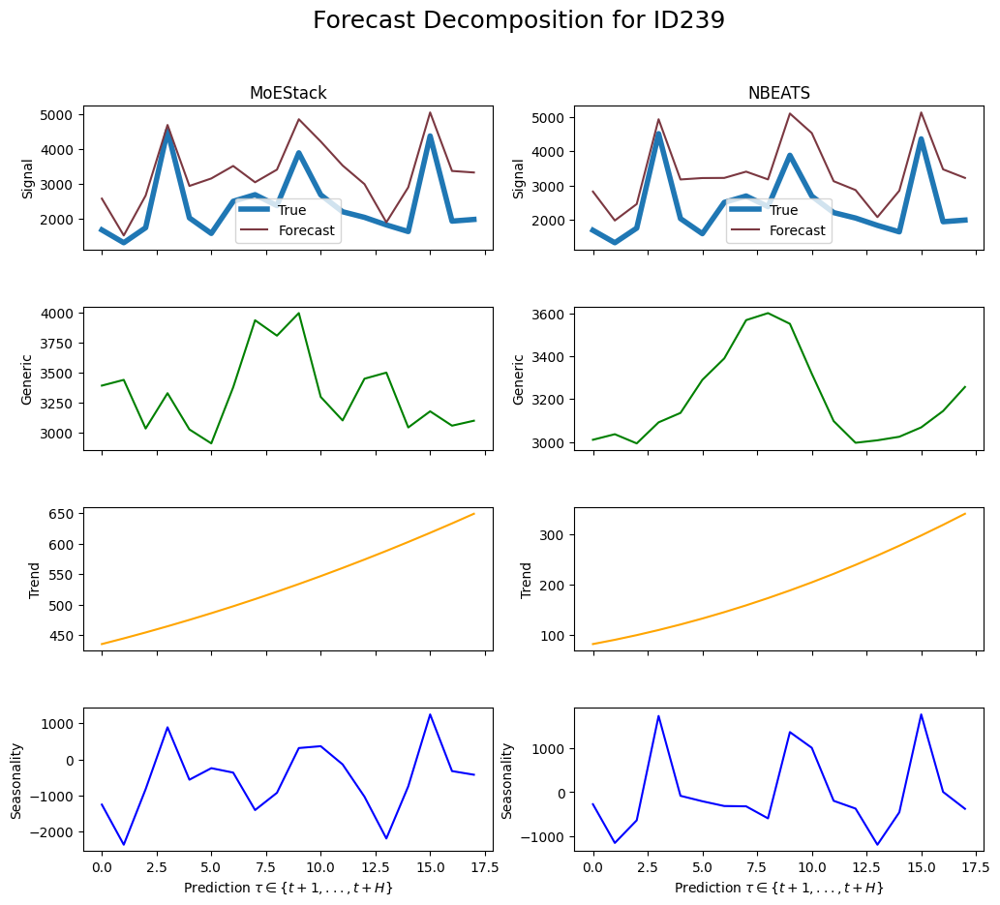

     unique_id         ds       y
2808     ID239 2004-04-30  1680.0
2809     ID239 2004-05-31  1314.0
2810     ID239 2004-06-30  1744.0
2811     ID239 2004-07-31  4520.0
2812     ID239 2004-08-31  2024.0
2813     ID239 2004-09-30  1580.0
2814     ID239 2004-10-31  2499.0
2815     ID239 2004-11-30  2688.0
2816     ID239 2004-12-31  2375.0
2817     ID239 2005-01-31  3886.0
2818     ID239 2005-02-28  2684.0
2819     ID239 2005-03-31  2200.0
2820     ID239 2005-04-30  2040.0
2821     ID239 2005-05-31  1824.0
2822     ID239 2005-06-30  1634.0
2823     ID239 2005-07-31  4368.0
2824     ID239 2005-08-31  1932.0
2825     ID239 2005-09-30  1980.0
Gate values for ID24: [0.39260975 0.30395663 0.30343363]
sMAPE for MoEStack: 0.20355930321677465
sMAPE for NBEATS: 0.24329522097489178


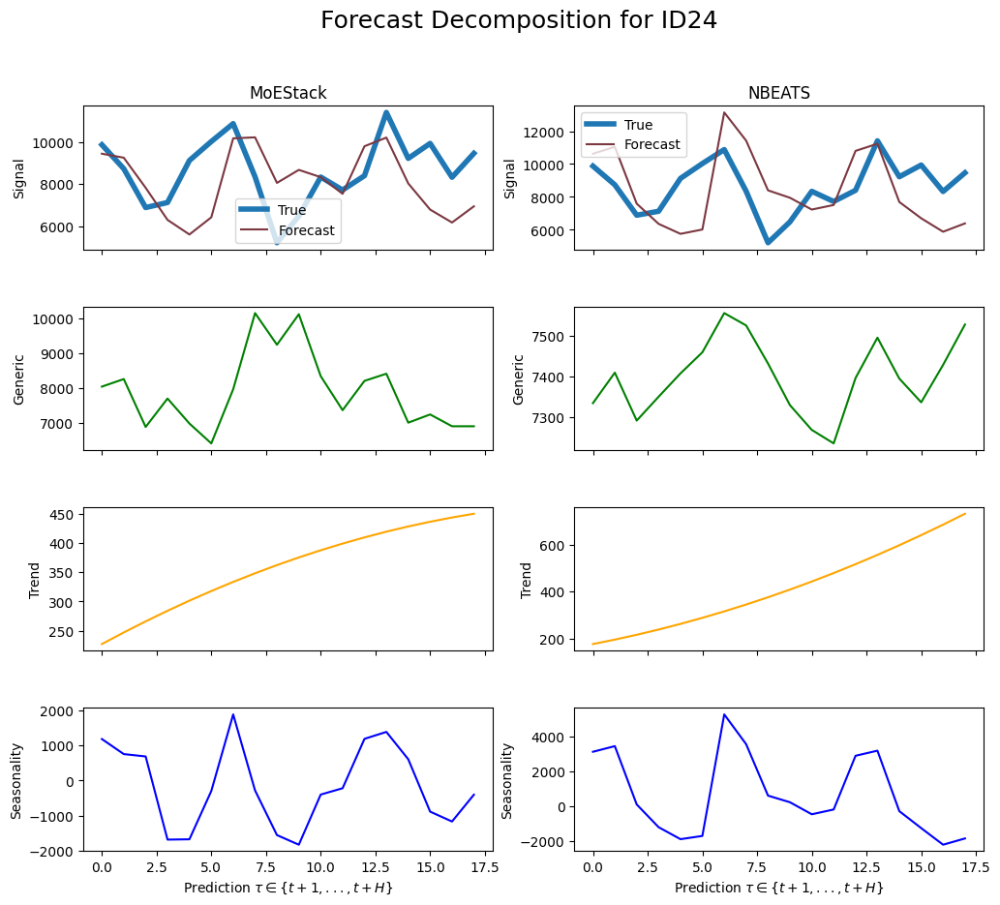

     unique_id         ds        y
2826      ID24 2004-01-31   9876.0
2827      ID24 2004-02-29   8738.0
2828      ID24 2004-03-31   6889.0
2829      ID24 2004-04-30   7129.0
2830      ID24 2004-05-31   9128.0
2831      ID24 2004-06-30  10031.0
2832      ID24 2004-07-31  10882.0
2833      ID24 2004-08-31   8349.0
2834      ID24 2004-09-30   5215.0
2835      ID24 2004-10-31   6482.0
2836      ID24 2004-11-30   8342.0
2837      ID24 2004-12-31   7724.0
2838      ID24 2005-01-31   8405.0
2839      ID24 2005-02-28  11414.0
2840      ID24 2005-03-31   9227.0
2841      ID24 2005-04-30   9941.0
2842      ID24 2005-05-31   8330.0
2843      ID24 2005-06-30   9469.0
Gate values for ID240: [0.3810702  0.20575343 0.4131764 ]
sMAPE for MoEStack: 0.49820005524307664
sMAPE for NBEATS: 0.4842763144420323


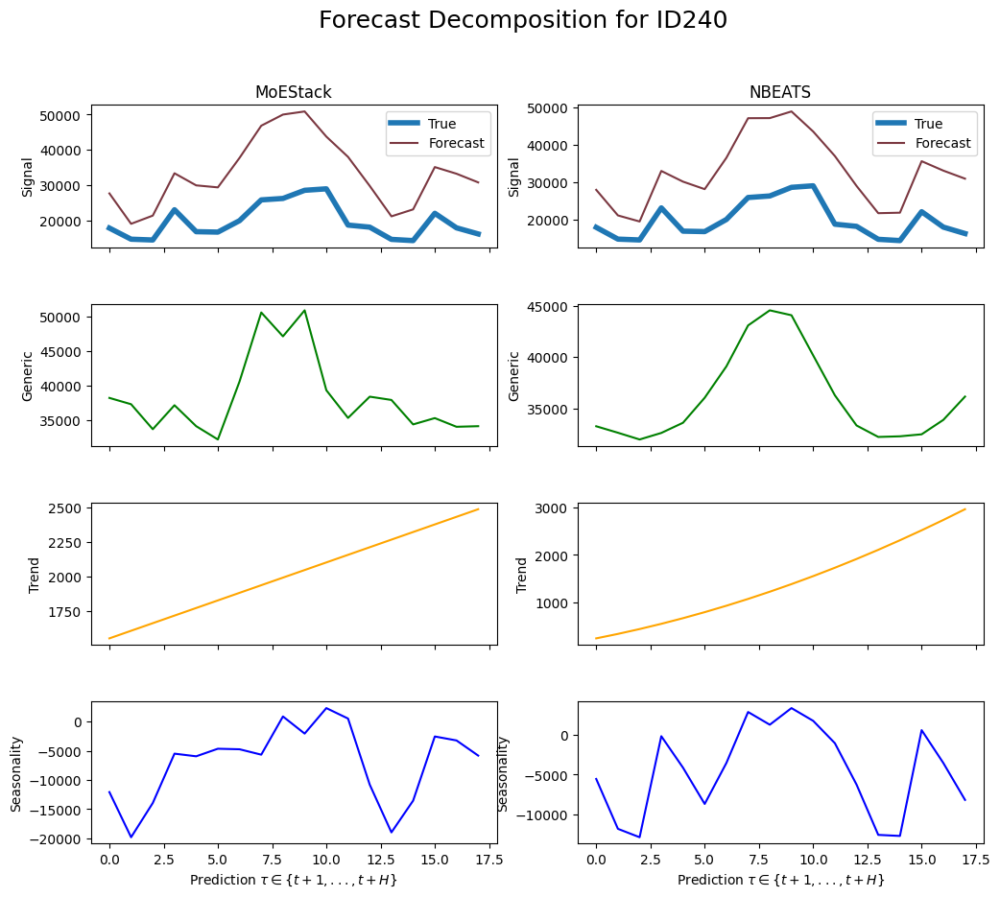

     unique_id         ds        y
2844     ID240 2004-04-30  17955.0
2845     ID240 2004-05-31  14814.0
2846     ID240 2004-06-30  14592.0
2847     ID240 2004-07-31  23140.0
2848     ID240 2004-08-31  16940.0
2849     ID240 2004-09-30  16820.0
2850     ID240 2004-10-31  20055.0
2851     ID240 2004-11-30  25914.0
2852     ID240 2004-12-31  26325.0
2853     ID240 2005-01-31  28623.0
2854     ID240 2005-02-28  29040.0
2855     ID240 2005-03-31  18800.0
2856     ID240 2005-04-30  18216.0
2857     ID240 2005-05-31  14763.0
2858     ID240 2005-06-30  14421.0
2859     ID240 2005-07-31  22128.0
2860     ID240 2005-08-31  18018.0
2861     ID240 2005-09-30  16302.0
Gate values for ID241: [0.35003638 0.2304762  0.41948736]
sMAPE for MoEStack: 0.3749748502519203
sMAPE for NBEATS: 0.35209870051922126


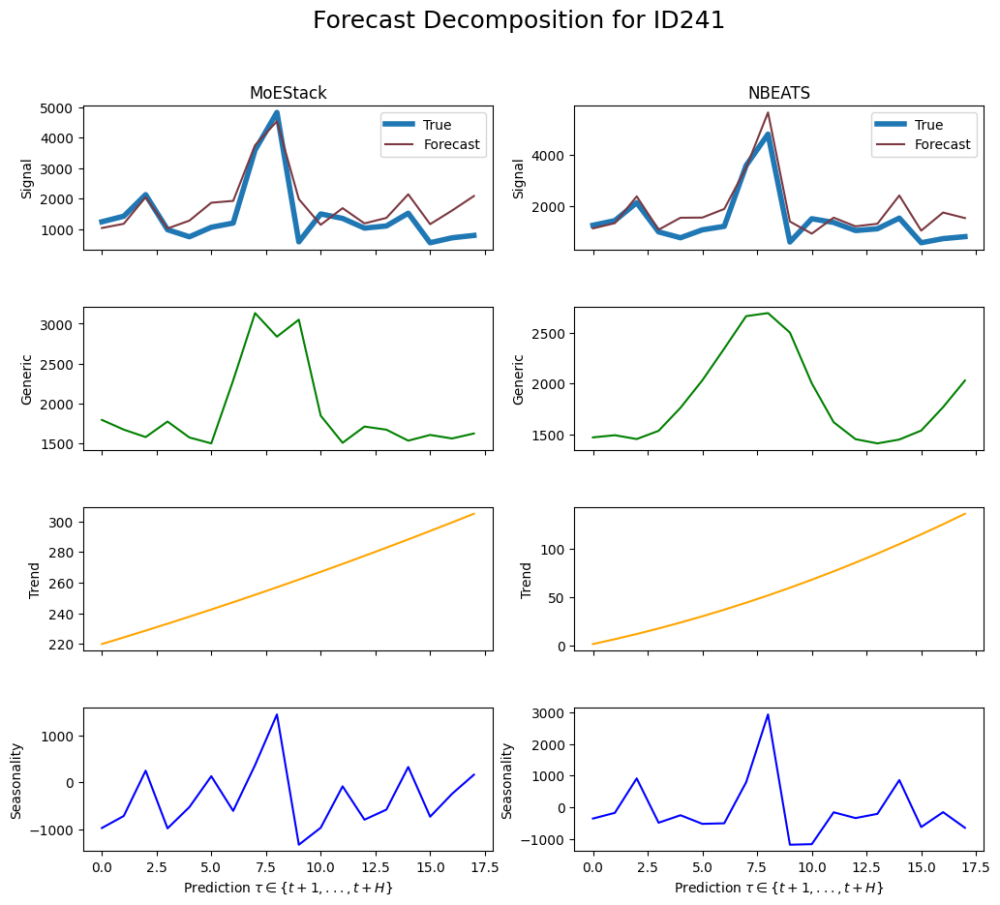

     unique_id         ds       y
2862     ID241 2004-04-30  1239.0
2863     ID241 2004-05-31  1422.0
2864     ID241 2004-06-30  2128.0
2865     ID241 2004-07-31   980.0
2866     ID241 2004-08-31   748.0
2867     ID241 2004-09-30  1060.0
2868     ID241 2004-10-31  1197.0
2869     ID241 2004-11-30  3591.0
2870     ID241 2004-12-31  4825.0
2871     ID241 2005-01-31   580.0
2872     ID241 2005-02-28  1496.0
2873     ID241 2005-03-31  1350.0
2874     ID241 2005-04-30  1032.0
2875     ID241 2005-05-31  1102.0
2876     ID241 2005-06-30  1520.0
2877     ID241 2005-07-31   552.0
2878     ID241 2005-08-31   714.0
2879     ID241 2005-09-30   792.0
Gate values for ID242: [0.3117574  0.22505215 0.46319047]
sMAPE for MoEStack: 0.27420019697867315
sMAPE for NBEATS: 0.2709988671192469


KeyboardInterrupt: 

In [11]:
to_check_ids = y_test['unique_id'].unique().tolist()
# to_check_ids = ['M548', 'M59', "M64", "M1", "M100"]

enumerate_models = ['MoEStack', 'NBEATS']
unique_ids = y_test['unique_id'].unique().tolist()

gate_values = np.load('gate_values_stack0_epoch_0.npy', allow_pickle=True)

for i, id in enumerate(to_check_ids):

    # select unique_id M1
    m_id = y_test[y_test['unique_id'] == id]
    m_idex = unique_ids.index(id)

    # Shared figure: 4 rows (plot types) x N models (columns)
    fig, ax = plt.subplots(4, len(enumerate_models), figsize=(12, 10), sharex=True)
    fig.suptitle(f'Forecast Decomposition for {id}', fontsize=18)
    fig.subplots_adjust(hspace=0.4)

    print(f"Gate values for {id}: {gate_values[m_idex]}")

    for j, model_name in enumerate(enumerate_models):
        y_hat = y_hats[j]  # Get the model-specific predictions


        # Optional: add model title at top
        ax[0, j].set_title(model_name)

        ax[0, j].plot(m_id['y'].values, label='True', linewidth=4)
        ax[0, j].plot(y_hat[m_idex].sum(axis=0).flatten(), label='Forecast', color="#7B3841")
        ax[0, j].legend()
        ax[0, j].set_ylabel('Signal')

        ax[1, j].plot(y_hat[m_idex, 1] + y_hat[m_idex, 0], label='stack1', color="green")
        ax[1, j].set_ylabel('Generic')

        ax[2, j].plot(y_hat[m_idex, 2], label='stack2', color="orange")
        ax[2, j].set_ylabel('Trend')

        ax[3, j].plot(y_hat[m_idex, 3], label='stack3', color="blue")
        ax[3, j].set_ylabel('Seasonality')
        ax[3, j].set_xlabel(r'Prediction $\tau \in \{t+1,..., t+H\}$')

        # Calculate sMAPE
        smape_value = calculate_smape(m_id, y_hat[m_idex].sum(axis=0).flatten(), model_name)
        print(f'sMAPE for {model_name}: {smape_value}')

    plt.show()

    # Debug output
    print(m_id)
